In [1]:
import os
import csv
import optuna
import numpy as np
import pandas as pd
from tensorflow import keras
from tensorflow.keras.optimizers import Adam, RMSprop, SGD
import tensorflow as tf
from keras.models import Sequential
from keras.layers import Input, LSTM, Dense, Activation, Dropout
from pandas import DataFrame
from pandas import Series
from pandas import concat
from pandas import read_csv
from datetime import datetime
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import KFold
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from math import sqrt
from matplotlib import pyplot as plt
from matplotlib.patches import Patch
from numpy import array
import keras.backend as K
import itertools
#!pip install pydot

# date-time parsing function for loading the dataset
def parser(x):
    return datetime.strptime('190'+x, '%Y-%m')
    
def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))
    
def mape (y_true, y_pred):
    return 100*K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def pearson (y_true, y_pred):
    return (K.square(K.mean((y_true - K.mean(y_true))*(y_pred - K.mean(y_pred)))))/(K.mean(K.square(y_true - K.mean(y_true)))*K.mean(K.square(y_pred - K.mean(y_pred))))
    
# convert time series into a supervised learning problem
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
# convert time series into a supervised learning problem
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):

    n_vars = 1 if type(data) is list else data.shape[1]
    cols, names = list(), list()
    df = DataFrame(data)
    # input sequence (t-n, ... t-1)
    for i in range(n_in, 0, -1):
    	cols.append(df.shift(i))
    	names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
    # forecast sequence (t, t+1, ... t+n)
    for i in range(0, n_out):
        cols.append(df[0].shift(-i)) # df[0] for specific humidity
        if i == 0:
            names += [('var%d(t)' % (1))] # % (1) for specific humidity
        else:            
            names += [('var%d(t+%d)' % (1, i))] # % (1) for specific humidity
    
    # put it all together
    agg = concat(cols, axis=1)

    if dropnan:
        #Drop rows containing NaN
        agg.dropna(inplace=True)

    agg.columns = names

    return agg
     
# create a differenced series
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def difference(dataset, interval=1):
    diff = list()
    for i in range(interval, len(dataset)):
        value = dataset[i] - dataset[i - interval]
        diff.append(value)
    return Series(diff)
     
# transform series into training sets for supervised learning
def prepare_training_data(data, n_lag, n_seq, n_time_steps):
    
    #Prepare data for time series forecasting.
        
    #Parameters:
    #x (array-like): Input features.
    #y (array-like): Target values.
    #n_test (int): Number of test samples (rows).
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations.
    #n_train (int): Number of training samples (rows).
        
    #Returns:
    #tuple: Training and test datasets.
    
    n_vars = len(data[0][0])

    # Each weather station has 227 time steps (the first 180 have no nan values)
    # Loop through data, grabbing one weather station (ws) at a time, 
    # differencing on each ws and separating by training (first 226-n_lag-n_seq-n_test time steps) 
    # and testing (n_test time steps) to scale data on training only.
    # We then recombine the training and testing datasets to change each ws to a supervised learning problem by taking all the first 180 time steps for all 12 predictors
    # and changing these to (t-n_lag) to (t-1) since we lose one row through differencing. We then shift forward only one dependent variable (temperature or specific humidity)
    # for time steps t to (t+n_seq)


    diff_values = []
    
    for ws in range(84):
        
        # transform data to be stationary
        diff_series = difference(data[ws], 1)
        for i in range(len(diff_series)):
            diff_values_row = []
            for j in range(len(diff_series[0])):
                diff_values_row.append(diff_series[i][j])
            diff_values.append(diff_values_row)
    
    # rescale values to 0, 1
    scaler_all_features =  MinMaxScaler(feature_range=(0, 1))
    scaler =  MinMaxScaler(feature_range=(0, 1))
    train_scaled_values = scaler_all_features.fit_transform(diff_values)
    response_train_values = []
    for i in range(len(diff_values)):
        response_train_values.append(diff_values[i][0]) # Uses first column (specific_humidity) as response variable
    response_train_values = np.array(response_train_values)
    response_train_values = response_train_values.reshape(len(response_train_values), 1)

    # Fit the scaler for just the response variable for use later when forecasting
    response_scaled_values = scaler.fit_transform(response_train_values) 
    scaled_values = scaler_all_features.transform(diff_values)

    train = []

    # Transform each weather station as a separate "batch"
    for ws in range(84):
        # transform into supervised learning problem X, y
        first = (n_time_steps-1)*ws
        last = (n_time_steps-1)*ws+(n_time_steps-2)
        scaled_values_batch = scaled_values[first:last]
        supervised = series_to_supervised(scaled_values_batch, n_lag, n_seq)
        supervised_values = supervised.values
        train.append([supervised_values])
    
    return scaler, scaler_all_features, train

# transform series into testing and validation sets for supervised learning
def prepare_testing_and_validation_data(data, n_lag, n_seq, n_time_steps, scaler_all_features):
    
    #Prepare data for time series forecasting.
        
    #Parameters:
    #x (array-like): Input features.
    #y (array-like): Target values.
    #n_test (int): Number of test samples (rows).
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations.
    #n_train (int): Number of training samples (rows).
        
    #Returns:
    #tuple: Training and test datasets.
    
    n_vars = len(data[0][0])

    # Each weather station has 227 time steps (the first 180 have no nan values)
    # Loop through data, grabbing one weather station (ws) at a time, 
    # differencing on each ws and separating by training (first 226-n_lag-n_seq-n_test time steps) 
    # and testing (n_test time steps) to scale data on training only.
    # We then recombine the training and testing datasets to change each ws to a supervised learning problem by taking all the first 180 time steps for all 12 predictors
    # and changing these to (t-n_lag) to (t-1) since we lose one row through differencing. We then shift forward only one dependent variable (temperature or specific humidity)
    # for time steps t to (t+n_seq)


    diff_values = []
    
    for ws in range(21):
        
        # transform data to be stationary
        diff_series = difference(data[ws], 1)
        for i in range(len(diff_series)):
            diff_values_row = []
            for j in range(len(diff_series[0])):
                diff_values_row.append(diff_series[i][j])
            diff_values.append(diff_values_row)

    # rescale values to 0, 1
    scaled_values = scaler_all_features.transform(diff_values)

    validation = []
    test = []

    # Transform each weather station as a separate "batch"
    for ws in range(21):
        # transform into supervised learning problem X, y
        first = (n_time_steps-1)*ws
        last = (n_time_steps-1)*ws+(n_time_steps-2)
        scaled_values_batch = scaled_values[first:last]
        supervised = series_to_supervised(scaled_values_batch, n_lag, n_seq)
        supervised_values = supervised.values
        # training/test/validation split is 80%/10%/10%
        if ws < 11:
            test.append([supervised_values])
        else:
            validation.append([supervised_values])
    
    return validation, test
    
def plot_kfold(cv, X, y, ax, n_splits, xlim_max=105):
    
    #Plots the indices for a cross-validation object.
    #Taken from https://www.geeksforgeeks.org/cross-validation-using-k-fold-with-scikit-learn/
    
    #Parameters:
    #cv: Cross-validation object
    #X: Feature set
    #y: Target variable
    #ax: Matplotlib axis object
    #n_splits: Number of folds in the cross-validation
    #xlim_max: Maximum limit for the x-axis
        
    # Set color map for the plot
    cmap_cv = plt.cm.coolwarm
    cv_split = cv.split(X=X, y=y)
        
    for i_split, (train_idx, test_idx) in enumerate(cv_split):
        # Create an array of NaNs and fill in training/testing indices
        indices = np.full(len(X), np.nan)
        indices[test_idx], indices[train_idx] = 1, 0
            
        # Plot the training and testing indices
        ax_x = range(len(indices))
        ax_y = [i_split + 0.5] * len(indices)
        ax.scatter(ax_x, ax_y, c=indices, marker="_", 
                   lw=10, cmap=cmap_cv, vmin=-0.2, vmax=1.2)
    
        # Set y-ticks and labels
        y_ticks = np.arange(n_splits) + 0.5
        ax.set(yticks=y_ticks, yticklabels=range(n_splits),
               xlabel="Weather Station index (file_id)", ylabel="Fold",
               ylim=[n_splits, -0.2], xlim=[0, xlim_max])
    
        # Set plot title and create legend
        ax.set_title("KFold", fontsize=14)
        legend_patches = [Patch(color=cmap_cv(0.8), label="Testing set"), 
                          Patch(color=cmap_cv(0.02), label="Training set")]
        ax.legend(handles=legend_patches, loc=(1.03, 0.8))
    
#Main

#Configure
n_seq = 60
if n_seq > 46:
    n_lag = 179 - n_seq + 46
else:
    n_lag = 179
n_time_steps = 227
n_test = 1

print("Model Parameters:")
print("n_lag (number of input time steps): "+str(n_lag))
print("n_seq (number of output/future prediction time steps): "+str(n_seq))

# Create 2D array with file_ids to use for sample creation
array = np.array([
    6501, 6541, 6640, 6668, 6678, 
    6687, 6697, 6714, 6744, 6772, 
    6783, 6840, 6844, 6854, 6870, 
    6891, 6895, 6899, 6901, 6909, 
    6929, 6950, 6963, 6969, 6994, 
    7032, 7057, 7094, 7095, 7100, 
    7108, 7116, 7119, 7131, 7139, 
    7152, 7155, 7156, 7182, 7193, 
    7202, 7239, 7280, 7286, 7287, 
    7311, 7321, 7329, 7347, 7350, 
    7354, 7357, 7361, 7414, 7423, 
    7424, 7432, 7463, 7482, 7489, 
    7528, 7531, 7534, 7538, 7549, 
    7553, 7555, 7562, 7571, 7573, 
    7574, 7575, 7585, 7599, 7603, 
    7606, 7622, 7652, 7671, 7704, 
    7786, 7805, 7816, 7838, 7861, 
    7862, 7863, 7870, 7892, 7907, 
    7938, 7962, 7979, 7987, 7999, 
    8000, 8034, 8083, 8120, 8133, 
    8184, 8186, 8247, 8248, 9858])
    
#Create arrays holding the 5-fold cross-validation indices gathered for consistency across models
train_array = []
test_array = []
    
train_array.append([1, 2, 3, 5, 6, 7, 8, 9, 11, 13, 14, 15, 16, 17, 19, 20, 21, 22, 
                        23, 24, 25, 27, 28, 29, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 
                        43, 44, 46, 48, 49, 50, 51, 52, 54, 55, 56, 57, 58, 59, 60, 61, 
                        62, 63, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 78, 79, 81, 
                        82, 83, 84, 85, 86, 87, 88, 90, 91, 92, 93, 95, 97, 98, 100, 101, 102, 103])
test_array.append([0, 4, 10, 12, 18, 26, 30, 31, 33, 45, 47, 53, 64, 65, 77, 80, 89, 94, 96, 99, 104])
    
train_array.append([0, 1, 2, 3, 4, 6, 7, 8, 10, 12, 13, 14, 17, 18, 19, 20, 21, 23, 
                        24, 25, 26, 27, 29, 30, 31, 32, 33, 34, 36, 37, 38, 41, 43, 45, 
                        46, 47, 48, 49, 50, 51, 52, 53, 54, 57, 58, 59, 60, 61, 63, 64, 
                        65, 66, 67, 68, 69, 70, 71, 73, 74, 75, 77, 80, 81, 82, 83, 84, 
                        86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 104])
test_array.append([5, 9, 11, 15, 16, 22, 28, 35, 39, 40, 42, 44, 55, 56, 62, 72, 76, 78, 79, 85, 103])
    
train_array.append([0, 1, 2, 4, 5, 9, 10, 11, 12, 14, 15, 16, 18, 20, 21, 22, 23, 26, 
                    28, 29, 30, 31, 32, 33, 35, 36, 37, 39, 40, 41, 42, 44, 45, 46, 47, 
                    48, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 
                    70, 71, 72, 74, 75, 76, 77, 78, 79, 80, 82, 83, 85, 86, 87, 88, 89, 
                    90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104])
test_array.append([3, 6, 7, 8, 13, 17, 19, 24, 25, 27, 34, 38, 43, 49, 66, 67, 68, 69, 73, 81, 84])
    
train_array.append([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 
                        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 33, 34, 
                        35, 37, 38, 39, 40, 42, 43, 44, 45, 47, 49, 51, 52, 53, 55, 56, 
                        60, 62, 64, 65, 66, 67, 68, 69, 71, 72, 73, 74, 76, 77, 78, 79, 
                        80, 81, 82, 84, 85, 86, 87, 88, 89, 92, 93, 94, 95, 96, 99, 102, 103, 104])
test_array.append([32, 36, 41, 46, 48, 50, 54, 57, 58, 59, 61, 63, 70, 75, 83, 90, 91, 97, 98, 100, 101])
    
train_array.append([0, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 15, 16, 17, 18, 19, 22,
                        24, 25, 26, 27, 28, 30, 31, 32, 33, 34, 35, 36, 38, 39, 40, 41, 
                        42, 43, 44, 45, 46, 47, 48, 49, 50, 53, 54, 55, 56, 57, 58, 59, 
                        61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 72, 73, 75, 76, 77, 78, 
                        79, 80, 81, 83, 84, 85, 89, 90, 91, 94, 96, 97, 98, 99, 100, 101, 103, 104])
test_array.append([1, 2, 14, 20, 21, 23, 29, 37, 51, 52, 60, 71, 74, 82, 86, 87, 88, 92, 93, 95, 102])
    
# Equations for three Principal Components from PCA using response variables combined with other predictors
#PC1=-0.0002714X1+0.02612X2+0.03858X3-0.007658X4+0.001592X5-0.02087X6+0.8564X7-0.1468X8+0.01192X9-0.0001049X10+0.01913X11+0.02076X12
#PC2=0.0003944X1+0.002204X2+0.01052X3+0.3248X4-0.0009976X5-0.04421X6+2.3406X7+0.06103X8+0.08841X9+0.00009018X10+0.05678X11-0.002022X12
#PC3=-0.00007998X1-0.0006124X2-0.001063X3-0.01855X4+0.00001956X5+0.01170X6+0.6076X7+0.4664X8-0.002995X9+0.008185X10+0.8815X11-0.0004730X12
    
# Equations for three Principal Components from PCA omitting both response variables,
#PC-1=-0.0004514X1+0.03194X2-0.04343X3+0.002243X4-0.02252X5+0.9877X6-0.2265X7+0.006144X8-0.0001488X9+0.02943X10
#PC-2=0.0001702X1+0.005484X2+0.2057X3-0.0003188X4-0.02584X5+1.6963X6-0.05890X7+0.05809X8+1.9748X9+0.03686X10
#PC-3=-0.00006323X1-0.001180X2-0.02384X3-0.00002833X4+0.01170X5+0.5204X6+0.4791X7-0.004318X8+0.008271X9+0.8765X10
    
# Get the current working directory 
current_directory = os.getcwd() 
    
# Print the current working directory 
print(current_directory)
    
# Define the directory containing the files 
path = current_directory+"\\Modeling\\"
print(path)
    
filename = path + 'Final_Monthly_Dataset.csv'
    
# load dataset
df = read_csv(filename, header=0, parse_dates=[0], index_col=0, date_format='%Y-%m')

# Swap columns 'temperatures' and 'specific_humidity' directly
df['A'] = df['temperatures']
df['temperatures'] = df['specific_humidity']
df['specific_humidity'] = df['A']
df = df.drop(columns=['A'])
# Rename columns
df = df.rename(columns={'temperatures': 'specific_humidity', 'specific_humidity': 'temperatures'})

print(df)
    
df = df.rename(columns={'Unnamed: 0' : 'indices'})
    
#Remove unused columns
df = df.drop(['Day', 'vapor_pressure'], axis=1)
    
# Round numbers in columns to reasonable precision,
df['temperatures'] = np.round(df['temperatures'], 2)
df['slp'] = np.round(df['slp'], 2)
df['wet_bulb_temperature'] = np.round(df['wet_bulb_temperature'], 2)
df['specific_humidity'] = np.round(df['specific_humidity'], 2)
df['GHI'] = np.round(df['GHI'], 2)
df['PRCP'] = np.round(df['PRCP'], 2)
df['SNDP'] = np.round(df['SNDP'], 2)
df['solar_activity'] = np.round(df['solar_activity'], 2)
df['ONI'] = np.round(df['ONI'], 2)
df['water'] = np.round(df['water'], 0)
df['region'] = np.round(df['region'], 0)
    
df_trimmed = df[df['file_id'] != 7533] # Remove file_id 7533 so there are 105 weather stations for 5-fold CV
df_trimmed = df_trimmed.drop(['Year', 'Month', 'date', 'latitude', 'longitude', 'elevation'], axis=1)

#Test model and accuracy when solar activity is removed as a predictor
df_trimmed = df_trimmed.drop(['ONI'], axis=1)

n_vars = df_trimmed.shape[1]-1
    
X = []
y = []
    
for i in array:
    add_to_X = [] # create list to store each column to add to X
    new_df = df_trimmed[df_trimmed['file_id'] == i].drop(['file_id'], axis=1)
    #new_df = new_df.iloc[:180, :]
    add_to_y = []
    for j in range(new_df.shape[0]):
        add_to_y.append(new_df['specific_humidity'].iloc[j])
    y.append(add_to_y)
    #new_df = new_df.drop(['specific_humidity'], axis=1)
    columns_list = new_df.columns.tolist()
    for j in range(new_df.shape[0]):
        l=0
        new_row = []
        for m in columns_list:
            new_row.append(new_df.iloc[j, l])
            l += 1
        add_to_X.append(new_row)
    X.append(add_to_X)
    
#Perform k-fold cross-validation
#Taken from: https://www.geeksforgeeks.org/cross-validation-using-k-fold-with-scikit-learn/
    
#k = 5  # Number of folds
#kf = KFold(n_splits=k, shuffle=True, random_state=42)
    
#for i, (train_index, test_index) in enumerate(kf.split(X)):
#    print(f"Fold {i}:")
#    print(f"  Training dataset index: {train_index}")
#    print(f"  Test dataset index: {test_index}")
    
#for train_indices, test_indices in kf.split(X):
#    print('Train: %s | test: %s' % (train_indices, test_indices))
    
# Create figure and axis
#fig, ax = plt.subplots(figsize=(6, 3))
#plot_kfold(kf, X, y, ax, k)
#plt.tight_layout()
#fig.subplots_adjust(right=0.6)
    
#Create train and test sets for each cross-validation split
train_X = []
train_y = []
val_X = []
val_y = []
for i in range(5):
    print(f"Fold {i+1}")
    #Add each corresponding sample for each entry of train index 
    train_X_rows = [] # Stores all the samples for one fold of train_X
    train_y_rows = [] # Stores all the samples for one fold of train_y
    for j in train_array[i]:
        train_X_rows.append(X[j])
        train_y_rows.append(y[j])
    # Stores one fold of train dataset
    train_X.append(train_X_rows)
    train_y.append(train_y_rows)
    #Add each corresponding sample for each entry of the validation index 
    val_X_rows = [] # Stores all the samples for one fold of val_X
    val_y_rows = [] # Stores all the samples for one fold of val_y
    for j in test_array[i]: 
            val_X_rows.append(X[j])
            val_y_rows.append(y[j])
    # Stores one fold of validation dataset
    val_X.append(val_X_rows)
    val_y.append(val_y_rows) 
    
#Convert 3D arrays to DataFrames
df_X = []
df_y = []
val_df_X = []
val_df_y = []
dataset = []
dataset_test = []
scaler = []
scaler_all_features = []
train = []
test = []
validation = []

for i in range(5):
    dataset_scaling = [] # Holds all 84 weather station rows to train the scaling function
    dataset_testing = [] # Holds remaining 21 weather station rows for testing and validation
    print("Fold "+str(i+1)+":")
    #Transform train_X to the correct format
    df1 = []
    dataset_df = [] # captures each weather station's dataset as values for training scaler mapping
    df_X.append(pd.DataFrame(train_X[i]))
    X_t = df_X[i].transpose()
    for k in range(84):
        X = np.array(X_t.iloc[:, k])
        df = pd.DataFrame()
        for j in range(n_time_steps):
            new_row = pd.DataFrame(X[j]).transpose()
            new_row.columns = new_df.columns
            # Add the new row
            df = pd.concat([df, new_row], ignore_index=True)
        df.columns = new_df.columns
        df1.append(df)
        dataset_df.append(df.values)
        dataset_scaling.append(df.values)
    df_X[i] = df1
    dataset.append(dataset_df)

    #print(len(dataset))
    #print(len(dataset[0]))
    #print(len(dataset_scaling))
    #print(len(dataset_scaling[:][0]))
    #print("Stop")
    
    #Transform train_y to the correct format
    df2 = []
    df_y.append(pd.DataFrame(train_y[i]))
    y_t = df_y[i].transpose()
    
    for j in range(84):
        y = np.array(y_t.iloc[:, j])
        y = pd.DataFrame(y)
        y.columns = ['specific_humidity']
        df2.append(y)
    df_y[i] = df2

    #Transform val_X to the correct format
    df3 = []
    dataset_vl_df = [] # captures each weather station's dataset as values for training scaler mapping
    val_df_X.append(pd.DataFrame(val_X[i]))
    val_X_t = val_df_X[i].transpose()
    for k in range(21):
        vl_X = np.array(val_X_t.iloc[:, k])
        vl_df = pd.DataFrame()
        for j in range(n_time_steps):
            new1_row = pd.DataFrame(vl_X[j]).transpose()
            new1_row.columns = new_df.columns
            # Add the new row
            vl_df = pd.concat([vl_df, new1_row], ignore_index=True)
        vl_df.columns = new_df.columns
        df3.append(vl_df)
        dataset_vl_df.append(vl_df.values)
        dataset_testing.append(vl_df.values)
    val_df_X[i] = df3
    dataset_test.append(dataset_vl_df)

    #Transform val_y to the correct format
    df4 = []
    val_df_y.append(pd.DataFrame(train_y[i]))
    val_y_t = val_df_y[i].transpose()
    
    for j in range(21):
        v_y = np.array(val_y_t.iloc[:, j])
        v_y = pd.DataFrame(v_y)
        v_y.columns = ['specific_humidity']
        df4.append(v_y)
    val_df_y[i] = df4
    
    scaler.append(MinMaxScaler(feature_range=(0, 1)))
    scaler_all_features.append(MinMaxScaler(feature_range=(0, 1)))
    train.append([1])
    test.append([1])
    validation.append([1])
    
    # prepare data
    scaler[i], scaler_all_features[i], train[i] = prepare_training_data(dataset_scaling, n_lag, n_seq, n_time_steps)

    validation[i], test[i] = prepare_testing_and_validation_data(dataset_testing, n_lag, n_seq, n_time_steps, scaler_all_features[i])

    #Reshape dimensionality
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]
    print(np.array(train1).shape)
    print(np.array(test1).shape)
    print(np.array(validation1).shape)
    train2 = []
    test2 = []
    validation2 = []

    for k in range(84):
        train2.append(train1[k][0])
        
    for k in range(11):
        test2.append(test1[k][0])

    for k in range(10):
        validation2.append(validation1[k][0])

    print(np.array(train2).shape)
    print(np.array(test2).shape)
    print(np.array(validation2).shape)

    train[i] = train2
    test[i] = test2
    validation[i] = validation2

    #Reshape dimensionality (again)
    dim_size = n_seq + n_vars*n_lag
    train1 = np.array(train[i]).reshape(84, dim_size)
    test1 = np.array(test[i]).reshape(11, dim_size)
    validation1 = np.array(validation[i]).reshape(10, dim_size)
    train2 = pd.DataFrame(train1).values
    test2 = pd.DataFrame(test1).values
    validation2 = pd.DataFrame(validation1).values
    print(np.array(train2).shape)
    print(np.array(test2).shape)
    print(np.array(validation2).shape)

    print(train2)

    train[i] = train2
    test[i] = test2
    validation[i] = validation2
    
    #X_train = train1[:][:-n_seq]
    #y_train = train1[:][-n_seq:]
    #X_test = test1[:][:-n_seq]
    #y_test = test1[:][-n_seq:]

print("Finished")

Model Parameters:
n_lag (number of input time steps): 165
n_seq (number of output/future prediction time steps): 60
C:\Users\User
C:\Users\User\Modeling\
             date  file_id  specific_humidity          slp  vapor_pressure  \
0      2006-01-31     6501           5.386935  1018.534543        8.674922   
1      2006-02-28     6501           4.299929  1021.230347        6.942276   
2      2006-03-31     6501           6.505135  1018.968548       10.468176   
3      2006-04-30     6501          10.211263  1014.686944       16.358802   
4      2006-05-31     6501          11.737971  1014.236828       18.798749   
...           ...      ...                ...          ...             ...   
24057  2024-07-31     9858          15.211417  1013.969355       23.769169   
24058  2024-08-31     9858          15.149811  1015.112097       23.699154   
24059  2024-09-30     9858          10.720199  1014.393750       16.790240   
24060  2024-10-31     9858           6.989922  1018.230376       1

In [2]:
print(n_seq)
print(n_lag)
print(np.array(train[1]).shape)
print(np.array(test[1]).shape)

60
165
(84, 1875)
(11, 1875)


[I 2025-05-18 22:52:19,220] A new study created in memory with name: no-name-210ad2fd-4865-423e-8776-a4ad9fc214c6
[I 2025-05-18 22:53:27,907] Trial 0 finished with value: 0.08850545585155487 and parameters: {'lr': 0.0019797728931041053, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.4337255130044828}. Best is trial 0 with value: 0.08850545585155487.


Cross Validation Accuracies:
[0.07784299552440643, 0.06895681470632553, 0.08681223541498184, 0.12237873673439026, 0.08653649687767029]
Mean Cross Validation Accuracy:
0.08850545585155487
Standard Deviation of Cross Validation Accuracy:
0.01816579413903008


[I 2025-05-18 22:57:32,188] Trial 1 finished with value: 83.77085571289062 and parameters: {'lr': 0.8448898786514286, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.4004353109068377}. Best is trial 0 with value: 0.08850545585155487.


Cross Validation Accuracies:
[74.42605590820312, 99.86941528320312, 74.81466674804688, 78.44951629638672, 91.29462432861328]
Mean Cross Validation Accuracy:
83.77085571289062
Standard Deviation of Cross Validation Accuracy:
10.115591646277029


[I 2025-05-18 23:00:33,870] Trial 2 finished with value: 0.06799892708659172 and parameters: {'lr': 0.013627539374885752, 'optimizer': 'SGD', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.2961598750896137}. Best is trial 2 with value: 0.06799892708659172.


Cross Validation Accuracies:
[0.06093469634652138, 0.0670737475156784, 0.07413828372955322, 0.07561131566762924, 0.062236592173576355]
Mean Cross Validation Accuracy:
0.06799892708659172
Standard Deviation of Cross Validation Accuracy:
0.005993395977829797


[I 2025-05-18 23:03:06,854] Trial 3 finished with value: 0.07130037397146224 and parameters: {'lr': 0.1554424463815832, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.10468877771702632}. Best is trial 2 with value: 0.06799892708659172.


Cross Validation Accuracies:
[0.07017072290182114, 0.06643190234899521, 0.080623097717762, 0.07265756279230118, 0.06661858409643173]
Mean Cross Validation Accuracy:
0.07130037397146224
Standard Deviation of Cross Validation Accuracy:
0.005208693184611236


[I 2025-05-18 23:08:12,145] Trial 4 finished with value: 0.07368918359279633 and parameters: {'lr': 0.27843019274024156, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.42833816318866214}. Best is trial 2 with value: 0.06799892708659172.


Cross Validation Accuracies:
[0.063840851187706, 0.09886367619037628, 0.07228691875934601, 0.07321630418300629, 0.06023816764354706]
Mean Cross Validation Accuracy:
0.07368918359279633
Standard Deviation of Cross Validation Accuracy:
0.013519352945855458


[I 2025-05-18 23:12:50,729] Trial 5 finished with value: 0.2109609693288803 and parameters: {'lr': 0.11273970531717253, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.4060784472689275}. Best is trial 2 with value: 0.06799892708659172.


Cross Validation Accuracies:
[0.1952895075082779, 0.20957230031490326, 0.18482305109500885, 0.252559632062912, 0.21256035566329956]
Mean Cross Validation Accuracy:
0.2109609693288803
Standard Deviation of Cross Validation Accuracy:
0.023081250679856898


[I 2025-05-18 23:18:40,103] Trial 6 finished with value: 0.06441056430339813 and parameters: {'lr': 0.02375841095369353, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.15848608978948345}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.05777902528643608, 0.06045781075954437, 0.07208502292633057, 0.07354380190372467, 0.05818716064095497]
Mean Cross Validation Accuracy:
0.06441056430339813
Standard Deviation of Cross Validation Accuracy:
0.006937516380907074


[I 2025-05-18 23:23:57,901] Trial 7 finished with value: 0.06642598733305931 and parameters: {'lr': 0.998629179646183, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.11279815445498068}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.057266321033239365, 0.06160710006952286, 0.07323745638132095, 0.07592891156673431, 0.06409014761447906]
Mean Cross Validation Accuracy:
0.06642598733305931
Standard Deviation of Cross Validation Accuracy:
0.007060863799281532


[I 2025-05-18 23:29:06,560] Trial 8 finished with value: 0.06564545035362243 and parameters: {'lr': 0.20232944749134935, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.25618240993259006}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.05603090673685074, 0.06222930923104286, 0.07229801267385483, 0.07570313662290573, 0.06196588650345802]
Mean Cross Validation Accuracy:
0.06564545035362243
Standard Deviation of Cross Validation Accuracy:
0.007253444668177002


[I 2025-05-18 23:34:25,673] Trial 9 finished with value: 0.4281385004520416 and parameters: {'lr': 0.006242762821409688, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.4676247415729281}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.4179121255874634, 0.4471282660961151, 0.47600317001342773, 0.39342641830444336, 0.40622252225875854]
Mean Cross Validation Accuracy:
0.4281385004520416
Standard Deviation of Cross Validation Accuracy:
0.02980421205634688


[I 2025-05-18 23:38:38,525] Trial 10 finished with value: 0.06521697342395782 and parameters: {'lr': 0.042215888371494995, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.1986023134272739}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.05994383990764618, 0.061454594135284424, 0.07221393287181854, 0.07313510030508041, 0.059337399899959564]
Mean Cross Validation Accuracy:
0.06521697342395782
Standard Deviation of Cross Validation Accuracy:
0.006134900074774692


[I 2025-05-18 23:42:51,629] Trial 11 finished with value: 0.06529370695352554 and parameters: {'lr': 0.03574589636988901, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.20186283757680182}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.060994211584329605, 0.06141318380832672, 0.07305340468883514, 0.07310405373573303, 0.057903680950403214]
Mean Cross Validation Accuracy:
0.06529370695352554
Standard Deviation of Cross Validation Accuracy:
0.006471028209468617


[I 2025-05-18 23:48:16,634] Trial 12 finished with value: 0.06501268744468688 and parameters: {'lr': 0.037578885880626176, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.1833200970060171}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.05818478763103485, 0.06156729534268379, 0.07356426864862442, 0.07374529540538788, 0.058001790195703506]
Mean Cross Validation Accuracy:
0.06501268744468688
Standard Deviation of Cross Validation Accuracy:
0.007169820161209813


[I 2025-05-18 23:53:45,007] Trial 13 finished with value: 0.06707095578312874 and parameters: {'lr': 0.009579752204991056, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.17784225137266807}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.05641699209809303, 0.06265166401863098, 0.07893504947423935, 0.0731077492237091, 0.06424332410097122]
Mean Cross Validation Accuracy:
0.06707095578312874
Standard Deviation of Cross Validation Accuracy:
0.007977871608235406


[I 2025-05-19 00:00:36,964] Trial 14 finished with value: 0.0677410751581192 and parameters: {'lr': 0.0024493554735312917, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.16065316602400437}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.06793472915887833, 0.06187426671385765, 0.07404903322458267, 0.07407615333795547, 0.060771193355321884]
Mean Cross Validation Accuracy:
0.0677410751581192
Standard Deviation of Cross Validation Accuracy:
0.005708935908758007


[I 2025-05-19 00:06:41,834] Trial 15 finished with value: 0.13194771856069565 and parameters: {'lr': 0.06312978020669528, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.26037098328288344}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.11422262340784073, 0.1503588855266571, 0.11062312871217728, 0.16105782985687256, 0.12347612529993057]
Mean Cross Validation Accuracy:
0.13194771856069565
Standard Deviation of Cross Validation Accuracy:
0.020134818953670534


[I 2025-05-19 00:12:29,233] Trial 16 finished with value: 0.06536540314555168 and parameters: {'lr': 0.017775306878485907, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.34781376200680136}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.060289278626441956, 0.061433568596839905, 0.07251331210136414, 0.07227366417646408, 0.06031719222664833]
Mean Cross Validation Accuracy:
0.06536540314555168
Standard Deviation of Cross Validation Accuracy:
0.005753737384439652


[I 2025-05-19 00:17:05,600] Trial 17 finished with value: 0.06733646392822265 and parameters: {'lr': 0.005774025281830985, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.2382875961371297}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.06528934091329575, 0.06457198411226273, 0.07431101053953171, 0.07310865074396133, 0.05940133333206177]
Mean Cross Validation Accuracy:
0.06733646392822265
Standard Deviation of Cross Validation Accuracy:
0.005599317814490117


[I 2025-05-19 00:23:14,471] Trial 18 finished with value: 1.5803259134292602 and parameters: {'lr': 0.02204374450660398, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.143164442429536}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[1.5553393363952637, 1.6639846563339233, 1.6682921648025513, 1.3816413879394531, 1.6323720216751099]
Mean Cross Validation Accuracy:
1.5803259134292602
Standard Deviation of Cross Validation Accuracy:
0.10728048632401131


[I 2025-05-19 00:29:24,676] Trial 19 finished with value: 0.6158635377883911 and parameters: {'lr': 0.0010510720508121703, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.3000327948717044}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.6266083717346191, 0.6500259637832642, 0.6346497535705566, 0.6124241948127747, 0.555609405040741]
Mean Cross Validation Accuracy:
0.6158635377883911
Standard Deviation of Cross Validation Accuracy:
0.03248948846342966


[I 2025-05-19 00:34:58,757] Trial 20 finished with value: 0.06495470851659775 and parameters: {'lr': 0.08753807277618567, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.21889666940047903}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.05957579240202904, 0.060244593769311905, 0.07261180132627487, 0.07368901371955872, 0.05865234136581421]
Mean Cross Validation Accuracy:
0.06495470851659775
Standard Deviation of Cross Validation Accuracy:
0.006719477790392972


[I 2025-05-19 00:40:34,067] Trial 21 finished with value: 0.06491391435265541 and parameters: {'lr': 0.06819371829065236, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.21982639324790693}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.055660877376794815, 0.062161121517419815, 0.07356707751750946, 0.07410436868667603, 0.05907612666487694]
Mean Cross Validation Accuracy:
0.06491391435265541
Standard Deviation of Cross Validation Accuracy:
0.007571235175072176


[I 2025-05-19 00:44:17,961] Trial 22 finished with value: 0.06519856899976731 and parameters: {'lr': 0.0753857227912344, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.2288527210808421}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.05624981224536896, 0.062404338270425797, 0.07217045873403549, 0.07443379610776901, 0.06073443964123726]
Mean Cross Validation Accuracy:
0.06519856899976731
Standard Deviation of Cross Validation Accuracy:
0.006952885587308913


[I 2025-05-19 00:48:30,633] Trial 23 finished with value: 0.07290330529212952 and parameters: {'lr': 0.4251537933343611, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.14450583312209636}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.06197310984134674, 0.06793758273124695, 0.07358517497777939, 0.07120620459318161, 0.0898144543170929]
Mean Cross Validation Accuracy:
0.07290330529212952
Standard Deviation of Cross Validation Accuracy:
0.009310849924030225


[I 2025-05-19 00:53:20,664] Trial 24 finished with value: 0.06485862135887147 and parameters: {'lr': 0.08789991635650451, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.2937436530315551}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.05810227245092392, 0.05970114842057228, 0.0736873522400856, 0.07552748918533325, 0.057274844497442245]
Mean Cross Validation Accuracy:
0.06485862135887147
Standard Deviation of Cross Validation Accuracy:
0.008019135599683761


[I 2025-05-19 00:58:44,225] Trial 25 finished with value: 0.0647823080420494 and parameters: {'lr': 0.05276141583277225, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.30633644956307055}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.06009778007864952, 0.06091459095478058, 0.07178504765033722, 0.07333492487668991, 0.05777919664978981]
Mean Cross Validation Accuracy:
0.0647823080420494
Standard Deviation of Cross Validation Accuracy:
0.006451871412560576


[I 2025-05-19 01:01:57,290] Trial 26 finished with value: 0.06461329385638237 and parameters: {'lr': 0.021678420555258933, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.34501811281911327}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.05831043794751167, 0.060873642563819885, 0.07263284921646118, 0.07268688082695007, 0.05856265872716904]
Mean Cross Validation Accuracy:
0.06461329385638237
Standard Deviation of Cross Validation Accuracy:
0.006630493867118955


[I 2025-05-19 01:06:06,231] Trial 27 finished with value: 0.06735793948173523 and parameters: {'lr': 0.00857636007942587, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.3561385791483366}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.060751233249902725, 0.06911015510559082, 0.07400385290384293, 0.07370807975530624, 0.05921637639403343]
Mean Cross Validation Accuracy:
0.06735793948173523
Standard Deviation of Cross Validation Accuracy:
0.006284844040156069


[I 2025-05-19 01:09:55,305] Trial 28 finished with value: 0.06788042411208153 and parameters: {'lr': 0.023800888827707877, 'optimizer': 'SGD', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.34093634451200333}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.061763469129800797, 0.06639692932367325, 0.0757458508014679, 0.0737728625535965, 0.0617230087518692]
Mean Cross Validation Accuracy:
0.06788042411208153
Standard Deviation of Cross Validation Accuracy:
0.00590114271567494


[I 2025-05-19 01:14:11,232] Trial 29 finished with value: 0.08155812919139863 and parameters: {'lr': 0.013374905357768665, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.3694070996947302}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.07629148662090302, 0.07212936878204346, 0.10010693222284317, 0.08685196191072464, 0.07241089642047882]
Mean Cross Validation Accuracy:
0.08155812919139863
Standard Deviation of Cross Validation Accuracy:
0.010699473565996622


[I 2025-05-19 01:18:30,231] Trial 30 finished with value: 0.08139348700642586 and parameters: {'lr': 0.004638981932381097, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.31882689844534073}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.07080414891242981, 0.07307959347963333, 0.07935087382793427, 0.12354862689971924, 0.06018419191241264]
Mean Cross Validation Accuracy:
0.08139348700642586
Standard Deviation of Cross Validation Accuracy:
0.021965050390330608


[I 2025-05-19 01:22:18,648] Trial 31 finished with value: 0.06555078476667404 and parameters: {'lr': 0.05260764251408103, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.2704367235044101}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.0621175616979599, 0.06128588691353798, 0.0727299228310585, 0.07243654876947403, 0.0591840036213398]
Mean Cross Validation Accuracy:
0.06555078476667404
Standard Deviation of Cross Validation Accuracy:
0.005821787453000481


[I 2025-05-19 01:26:13,742] Trial 32 finished with value: 0.06522930487990379 and parameters: {'lr': 0.13256808979061144, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.3813576624801033}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.057969894260168076, 0.06009634584188461, 0.07392425090074539, 0.07617661356925964, 0.05797941982746124]
Mean Cross Validation Accuracy:
0.06522930487990379
Standard Deviation of Cross Validation Accuracy:
0.008087679496010455


[I 2025-05-19 01:32:31,258] Trial 33 finished with value: 0.06503057852387428 and parameters: {'lr': 0.024602707560853927, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.3136207311485879}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.05764378234744072, 0.06166456639766693, 0.07243691384792328, 0.0738944336771965, 0.05951319634914398]
Mean Cross Validation Accuracy:
0.06503057852387428
Standard Deviation of Cross Validation Accuracy:
0.006778761429041635


[I 2025-05-19 01:36:44,238] Trial 34 finished with value: 0.11018554419279099 and parameters: {'lr': 0.015068514887592708, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.2830048615144854}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.10779903084039688, 0.12211553752422333, 0.09773721545934677, 0.12254738062620163, 0.10072855651378632]
Mean Cross Validation Accuracy:
0.11018554419279099
Standard Deviation of Cross Validation Accuracy:
0.010442515895054344


[I 2025-05-19 01:40:27,751] Trial 35 finished with value: 0.06785811930894851 and parameters: {'lr': 0.3456064092387638, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.3284171416525914}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.0641975849866867, 0.06215788424015045, 0.07625509053468704, 0.07209900766611099, 0.06458102911710739]
Mean Cross Validation Accuracy:
0.06785811930894851
Standard Deviation of Cross Validation Accuracy:
0.005387499815559539


[I 2025-05-19 01:44:22,417] Trial 36 finished with value: 0.06808181330561638 and parameters: {'lr': 0.20342068820473522, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.44627401612218753}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.06276556104421616, 0.06918209791183472, 0.07369399070739746, 0.07365800440311432, 0.06110941246151924]
Mean Cross Validation Accuracy:
0.06808181330561638
Standard Deviation of Cross Validation Accuracy:
0.0053042997690019


[I 2025-05-19 01:51:00,809] Trial 37 finished with value: 0.20484291017055511 and parameters: {'lr': 0.09950352298346725, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.40464504381383753}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.24090123176574707, 0.19364209473133087, 0.19776321947574615, 0.22298561036586761, 0.16892239451408386]
Mean Cross Validation Accuracy:
0.20484291017055511
Standard Deviation of Cross Validation Accuracy:
0.02488061035627464


[I 2025-05-19 01:55:12,778] Trial 38 finished with value: 0.06994137018918992 and parameters: {'lr': 0.04584306172911192, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.28491827035674777}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.06418199837207794, 0.06841710954904556, 0.08011587709188461, 0.0778980478644371, 0.059093818068504333]
Mean Cross Validation Accuracy:
0.06994137018918992
Standard Deviation of Cross Validation Accuracy:
0.007999905394172937


[I 2025-05-19 01:59:22,498] Trial 39 finished with value: 0.06721499562263489 and parameters: {'lr': 0.030448271334953876, 'optimizer': 'SGD', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.3826639614514885}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.06024035066366196, 0.062136050313711166, 0.07477525621652603, 0.07804428040981293, 0.06087904050946236]
Mean Cross Validation Accuracy:
0.06721499562263489
Standard Deviation of Cross Validation Accuracy:
0.007602849915659929


[I 2025-05-19 02:03:29,813] Trial 40 finished with value: 0.06601099371910095 and parameters: {'lr': 0.010759306120971705, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.4234984009580787}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.05856895074248314, 0.061279889196157455, 0.07658226788043976, 0.07375117391347885, 0.05987268686294556]
Mean Cross Validation Accuracy:
0.06601099371910095
Standard Deviation of Cross Validation Accuracy:
0.0075777093051765535


[I 2025-05-19 02:07:43,641] Trial 41 finished with value: 0.0651339791715145 and parameters: {'lr': 0.06726983120016829, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.24711967661242595}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.059011414647102356, 0.06019799783825874, 0.07258103042840958, 0.07262535393238068, 0.061254099011421204]
Mean Cross Validation Accuracy:
0.0651339791715145
Standard Deviation of Cross Validation Accuracy:
0.0061397466782448


[I 2025-05-19 02:11:58,187] Trial 42 finished with value: 0.0668929599225521 and parameters: {'lr': 0.1722277967254484, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.12185001371228288}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.060707174241542816, 0.06483200937509537, 0.07417742908000946, 0.07451050728559494, 0.06023767963051796]
Mean Cross Validation Accuracy:
0.0668929599225521
Standard Deviation of Cross Validation Accuracy:
0.0062911801142572325


[I 2025-05-19 02:16:13,313] Trial 43 finished with value: 0.06535632982850074 and parameters: {'lr': 0.03066276048552094, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.30518596062300074}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.06002049520611763, 0.06134256348013878, 0.07240089029073715, 0.07303006947040558, 0.0599876306951046]
Mean Cross Validation Accuracy:
0.06535632982850074
Standard Deviation of Cross Validation Accuracy:
0.006031856994316759


[I 2025-05-19 02:20:22,383] Trial 44 finished with value: 0.06439708396792412 and parameters: {'lr': 0.052705732844320695, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.21137011289649238}. Best is trial 44 with value: 0.06439708396792412.


Cross Validation Accuracies:
[0.057386115193367004, 0.06116658076643944, 0.07242511212825775, 0.07238777726888657, 0.05861983448266983]
Mean Cross Validation Accuracy:
0.06439708396792412
Standard Deviation of Cross Validation Accuracy:
0.0066523208172884225


[I 2025-05-19 02:24:39,739] Trial 45 finished with value: 0.06507403180003166 and parameters: {'lr': 0.04293509134574188, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.19713685165791775}. Best is trial 44 with value: 0.06439708396792412.


Cross Validation Accuracies:
[0.05994515120983124, 0.061958346515893936, 0.07232174277305603, 0.07332684099674225, 0.05781807750463486]
Mean Cross Validation Accuracy:
0.06507403180003166
Standard Deviation of Cross Validation Accuracy:
0.006469929792834278


[I 2025-05-19 02:28:26,303] Trial 46 finished with value: 0.06494389101862907 and parameters: {'lr': 0.019873152576186246, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.164565403728298}. Best is trial 44 with value: 0.06439708396792412.


Cross Validation Accuracies:
[0.059566497802734375, 0.060530439019203186, 0.07314912974834442, 0.0736120268702507, 0.057861361652612686]
Mean Cross Validation Accuracy:
0.06494389101862907
Standard Deviation of Cross Validation Accuracy:
0.0069429051602893175


[I 2025-05-19 02:34:49,431] Trial 47 finished with value: 0.0744969055056572 and parameters: {'lr': 0.5626344325973673, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.28135293812950707}. Best is trial 44 with value: 0.06439708396792412.


Cross Validation Accuracies:
[0.08444465696811676, 0.06040884554386139, 0.08164561539888382, 0.078032948076725, 0.067952461540699]
Mean Cross Validation Accuracy:
0.0744969055056572
Standard Deviation of Cross Validation Accuracy:
0.008987419981934952


[I 2025-05-19 02:39:01,565] Trial 48 finished with value: 0.24923871755599974 and parameters: {'lr': 0.14123582729395373, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.10024847359998088}. Best is trial 44 with value: 0.06439708396792412.


Cross Validation Accuracies:
[0.18927989900112152, 0.2621156573295593, 0.33447083830833435, 0.18477533757686615, 0.27555185556411743]
Mean Cross Validation Accuracy:
0.24923871755599974
Standard Deviation of Cross Validation Accuracy:
0.05634411859020894


[I 2025-05-19 02:43:52,845] Trial 49 finished with value: 0.06583662778139114 and parameters: {'lr': 0.10889638612220132, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.48529498342243993}. Best is trial 44 with value: 0.06439708396792412.


Cross Validation Accuracies:
[0.059418823570013046, 0.06260476261377335, 0.07166430354118347, 0.07319308817386627, 0.06230216100811958]
Mean Cross Validation Accuracy:
0.06583662778139114
Standard Deviation of Cross Validation Accuracy:
0.0055173350994104165


[I 2025-05-19 02:49:39,741] Trial 50 finished with value: 0.06784451976418496 and parameters: {'lr': 0.033335214677265274, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.12358619550350783}. Best is trial 44 with value: 0.06439708396792412.


Cross Validation Accuracies:
[0.06054280698299408, 0.06658659875392914, 0.07748834788799286, 0.07483705878257751, 0.05976778641343117]
Mean Cross Validation Accuracy:
0.06784451976418496
Standard Deviation of Cross Validation Accuracy:
0.007239199116359742


[I 2025-05-19 02:53:42,990] Trial 51 finished with value: 0.06438639014959335 and parameters: {'lr': 0.05715638154675971, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.20122798500129074}. Best is trial 51 with value: 0.06438639014959335.


Cross Validation Accuracies:
[0.05450945720076561, 0.06121572479605675, 0.07256989926099777, 0.07347422093153, 0.06016264855861664]
Mean Cross Validation Accuracy:
0.06438639014959335
Standard Deviation of Cross Validation Accuracy:
0.007416271381019675


[I 2025-05-19 02:57:49,844] Trial 52 finished with value: 0.06499075517058372 and parameters: {'lr': 0.053153241946398797, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.20883148710542637}. Best is trial 51 with value: 0.06438639014959335.


Cross Validation Accuracies:
[0.06095843017101288, 0.060249920934438705, 0.07244246453046799, 0.0729663297533989, 0.05833663046360016]
Mean Cross Validation Accuracy:
0.06499075517058372
Standard Deviation of Cross Validation Accuracy:
0.006358463526404661


[I 2025-05-19 03:01:43,326] Trial 53 finished with value: 0.06475016251206397 and parameters: {'lr': 0.08191243419530012, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.18353524264562282}. Best is trial 51 with value: 0.06438639014959335.


Cross Validation Accuracies:
[0.05739344656467438, 0.05996518209576607, 0.07731223851442337, 0.07126148790121078, 0.0578184574842453]
Mean Cross Validation Accuracy:
0.06475016251206397
Standard Deviation of Cross Validation Accuracy:
0.00806559301626383


[I 2025-05-19 03:06:13,114] Trial 54 finished with value: 0.06534881368279458 and parameters: {'lr': 0.05507382189910071, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.17729263668877862}. Best is trial 51 with value: 0.06438639014959335.


Cross Validation Accuracies:
[0.05929509550333023, 0.06301125884056091, 0.0731116384267807, 0.07365410774946213, 0.05767196789383888]
Mean Cross Validation Accuracy:
0.06534881368279458
Standard Deviation of Cross Validation Accuracy:
0.006786530560513235


[I 2025-05-19 03:10:42,972] Trial 55 finished with value: 0.06559562385082245 and parameters: {'lr': 0.01591164772201236, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.15132133256590752}. Best is trial 51 with value: 0.06438639014959335.


Cross Validation Accuracies:
[0.05985057353973389, 0.06172997131943703, 0.07223210483789444, 0.07342619448900223, 0.06073927506804466]
Mean Cross Validation Accuracy:
0.06559562385082245
Standard Deviation of Cross Validation Accuracy:
0.00594800323607215


[I 2025-05-19 03:15:24,934] Trial 56 finished with value: 0.149796062707901 and parameters: {'lr': 0.02815558555021302, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.18774042216389628}. Best is trial 51 with value: 0.06438639014959335.


Cross Validation Accuracies:
[0.18598617613315582, 0.15055903792381287, 0.12789474427700043, 0.16091415286064148, 0.12362620234489441]
Mean Cross Validation Accuracy:
0.149796062707901
Standard Deviation of Cross Validation Accuracy:
0.022796700243624464


[I 2025-05-19 03:21:23,697] Trial 57 finished with value: 0.06595162227749825 and parameters: {'lr': 0.038646789065547145, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.13634269766369672}. Best is trial 51 with value: 0.06438639014959335.


Cross Validation Accuracies:
[0.060871001332998276, 0.061901673674583435, 0.0726078525185585, 0.07361005246639252, 0.060767531394958496]
Mean Cross Validation Accuracy:
0.06595162227749825
Standard Deviation of Cross Validation Accuracy:
0.005865944853585778


[I 2025-05-19 03:26:21,479] Trial 58 finished with value: 0.06551028713583947 and parameters: {'lr': 0.011425773646098042, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.17065973313239655}. Best is trial 51 with value: 0.06438639014959335.


Cross Validation Accuracies:
[0.061330270022153854, 0.061164941638708115, 0.07263710349798203, 0.07256153970956802, 0.059857580810785294]
Mean Cross Validation Accuracy:
0.06551028713583947
Standard Deviation of Cross Validation Accuracy:
0.005810668355286993


[I 2025-05-19 03:32:11,673] Trial 59 finished with value: 0.0682367280125618 and parameters: {'lr': 0.2321052108810267, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.22926298251921007}. Best is trial 51 with value: 0.06438639014959335.


Cross Validation Accuracies:
[0.0657578781247139, 0.06245143711566925, 0.07631184905767441, 0.07345432043075562, 0.06320815533399582]
Mean Cross Validation Accuracy:
0.0682367280125618
Standard Deviation of Cross Validation Accuracy:
0.00560948627322299


[I 2025-05-19 03:37:28,157] Trial 60 finished with value: 0.12979267984628678 and parameters: {'lr': 0.07031455165575129, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.2595752290164069}. Best is trial 51 with value: 0.06438639014959335.


Cross Validation Accuracies:
[0.1286434531211853, 0.13582688570022583, 0.10850619524717331, 0.14195190370082855, 0.13403496146202087]
Mean Cross Validation Accuracy:
0.12979267984628678
Standard Deviation of Cross Validation Accuracy:
0.011460283303598981


[I 2025-05-19 03:42:20,521] Trial 61 finished with value: 0.06618219465017319 and parameters: {'lr': 0.07845524552320718, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.1957898607251}. Best is trial 51 with value: 0.06438639014959335.


Cross Validation Accuracies:
[0.06159164011478424, 0.06275677680969238, 0.07225076109170914, 0.07338593900203705, 0.06092585623264313]
Mean Cross Validation Accuracy:
0.06618219465017319
Standard Deviation of Cross Validation Accuracy:
0.005461816606701719


[I 2025-05-19 03:46:33,434] Trial 62 finished with value: 0.06415709778666497 and parameters: {'lr': 0.09825191604018559, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.3346525619313015}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.05739310756325722, 0.06071412190794945, 0.07280246168375015, 0.07271604984998703, 0.057159747928380966]
Mean Cross Validation Accuracy:
0.06415709778666497
Standard Deviation of Cross Validation Accuracy:
0.007135356039025223


[I 2025-05-19 03:50:51,300] Trial 63 finished with value: 0.06562887281179428 and parameters: {'lr': 0.1168898083297491, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.32808074186918545}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.06216864287853241, 0.059578608721494675, 0.07237648218870163, 0.07383912801742554, 0.060181502252817154]
Mean Cross Validation Accuracy:
0.06562887281179428
Standard Deviation of Cross Validation Accuracy:
0.006183708524908726


[I 2025-05-19 03:55:12,582] Trial 64 finished with value: 0.06448448672890664 and parameters: {'lr': 0.0459931089683652, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.34498399305923644}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.05791795253753662, 0.06090792641043663, 0.07220273464918137, 0.07197515666484833, 0.05941866338253021]
Mean Cross Validation Accuracy:
0.06448448672890664
Standard Deviation of Cross Validation Accuracy:
0.006281006419720077


[I 2025-05-19 03:59:58,633] Trial 65 finished with value: 0.06517916694283485 and parameters: {'lr': 0.021917193355900984, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.3591271973456269}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.05838042125105858, 0.0612841360270977, 0.07256408035755157, 0.07365807145833969, 0.060009125620126724]
Mean Cross Validation Accuracy:
0.06517916694283485
Standard Deviation of Cross Validation Accuracy:
0.006550607666780474


[I 2025-05-19 04:05:02,896] Trial 66 finished with value: 0.06564360558986664 and parameters: {'lr': 0.09079581012895496, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.3368077919292376}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.06076916679739952, 0.0611053965985775, 0.0729275569319725, 0.07535068690776825, 0.05806522071361542]
Mean Cross Validation Accuracy:
0.06564360558986664
Standard Deviation of Cross Validation Accuracy:
0.007057914516190167


[I 2025-05-19 04:09:46,486] Trial 67 finished with value: 0.06840621307492256 and parameters: {'lr': 0.04071280948072039, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.38765677032356494}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.06838151067495346, 0.06063242256641388, 0.0768810287117958, 0.0739087387919426, 0.062227364629507065]
Mean Cross Validation Accuracy:
0.06840621307492256
Standard Deviation of Cross Validation Accuracy:
0.006335785453053402


[I 2025-05-19 04:14:40,272] Trial 68 finished with value: 0.08522874116897583 and parameters: {'lr': 0.008115236360991766, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.15802141630961103}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.07342904061079025, 0.07794496417045593, 0.09070666134357452, 0.098387710750103, 0.08567532896995544]
Mean Cross Validation Accuracy:
0.08522874116897583
Standard Deviation of Cross Validation Accuracy:
0.008895525517554338


[I 2025-05-19 04:18:53,367] Trial 69 finished with value: 0.06784704327583313 and parameters: {'lr': 0.06167075595691882, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.3534805725511638}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.06154358759522438, 0.06646932661533356, 0.0740148052573204, 0.07519872486591339, 0.06200877204537392]
Mean Cross Validation Accuracy:
0.06784704327583313
Standard Deviation of Cross Validation Accuracy:
0.005793195624810704


[I 2025-05-19 04:22:42,095] Trial 70 finished with value: 0.06480378136038781 and parameters: {'lr': 0.16246655333218057, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.21240158516173474}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.055887725204229355, 0.0620296448469162, 0.07370603829622269, 0.07245072722434998, 0.059944771230220795]
Mean Cross Validation Accuracy:
0.06480378136038781
Standard Deviation of Cross Validation Accuracy:
0.007050217440876578


[I 2025-05-19 04:26:46,754] Trial 71 finished with value: 0.06498918607831002 and parameters: {'lr': 0.045833820071487966, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.36898786231096287}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.06088121980428696, 0.06059969961643219, 0.07236063480377197, 0.07362529635429382, 0.05747907981276512]
Mean Cross Validation Accuracy:
0.06498918607831002
Standard Deviation of Cross Validation Accuracy:
0.00665530362099828


[I 2025-05-19 04:30:35,714] Trial 72 finished with value: 0.06517959162592887 and parameters: {'lr': 0.0530411949897141, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.3161814061467309}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.059900593012571335, 0.06096829101443291, 0.07239589095115662, 0.07243433594703674, 0.06019884720444679]
Mean Cross Validation Accuracy:
0.06517959162592887
Standard Deviation of Cross Validation Accuracy:
0.005918056865361658


[I 2025-05-19 04:34:42,926] Trial 73 finished with value: 0.06469650492072106 and parameters: {'lr': 0.02682659797224809, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.3364123092860013}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.058333441615104675, 0.060425642877817154, 0.0727737620472908, 0.07283031940460205, 0.05911935865879059]
Mean Cross Validation Accuracy:
0.06469650492072106
Standard Deviation of Cross Validation Accuracy:
0.00665183310666583


[I 2025-05-19 04:38:56,880] Trial 74 finished with value: 0.06472251564264297 and parameters: {'lr': 0.01915237700832972, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.3425428392445951}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.05876121670007706, 0.06113407388329506, 0.07283610850572586, 0.07285072654485703, 0.05803045257925987]
Mean Cross Validation Accuracy:
0.06472251564264297
Standard Deviation of Cross Validation Accuracy:
0.006709633507217914


[I 2025-05-19 04:43:00,342] Trial 75 finished with value: 0.06473469138145446 and parameters: {'lr': 0.017719597982007614, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.3426374205149498}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.058424387127161026, 0.06115984544157982, 0.07249559462070465, 0.0723571851849556, 0.059236444532871246]
Mean Cross Validation Accuracy:
0.06473469138145446
Standard Deviation of Cross Validation Accuracy:
0.006342936426560881


[I 2025-05-19 04:49:30,748] Trial 76 finished with value: 0.06512387543916702 and parameters: {'lr': 0.02732198933746147, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.36739089538852754}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.06077171862125397, 0.06002365052700043, 0.07255742698907852, 0.07289248704910278, 0.059374094009399414]
Mean Cross Validation Accuracy:
0.06512387543916702
Standard Deviation of Cross Validation Accuracy:
0.006222902290791856


[I 2025-05-19 04:54:05,466] Trial 77 finished with value: 0.07798087373375892 and parameters: {'lr': 0.03455283927604443, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.3331233480666448}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.09696178883314133, 0.07118218392133713, 0.07992317527532578, 0.08068091422319412, 0.06115630641579628]
Mean Cross Validation Accuracy:
0.07798087373375892
Standard Deviation of Cross Validation Accuracy:
0.011837450236728431


[I 2025-05-19 04:59:01,248] Trial 78 finished with value: 0.06524433866143227 and parameters: {'lr': 0.013923269412620802, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.39648235182630465}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.05972512811422348, 0.061302974820137024, 0.07235937565565109, 0.07328702509403229, 0.05954718962311745]
Mean Cross Validation Accuracy:
0.06524433866143227
Standard Deviation of Cross Validation Accuracy:
0.006225144137140805


[I 2025-05-19 05:03:29,220] Trial 79 finished with value: 0.06489155292510987 and parameters: {'lr': 0.019460603802648618, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.3210367604985344}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.05303284153342247, 0.06195215880870819, 0.0734163150191307, 0.07582679390907288, 0.06022965535521507]
Mean Cross Validation Accuracy:
0.06489155292510987
Standard Deviation of Cross Validation Accuracy:
0.008523537138208094


[I 2025-05-19 05:08:30,914] Trial 80 finished with value: 0.06561558321118355 and parameters: {'lr': 0.02352048880186839, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.3453222901734201}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.05895042046904564, 0.06242087110877037, 0.0728331208229065, 0.07394180446863174, 0.05993169918656349]
Mean Cross Validation Accuracy:
0.06561558321118355
Standard Deviation of Cross Validation Accuracy:
0.006455322253868311


[I 2025-05-19 05:12:56,780] Trial 81 finished with value: 0.06554496809840202 and parameters: {'lr': 0.01716961748006944, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.34489784127344986}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.0590268149971962, 0.062382448464632034, 0.07278259843587875, 0.07443445175886154, 0.05909852683544159]
Mean Cross Validation Accuracy:
0.06554496809840202
Standard Deviation of Cross Validation Accuracy:
0.006714918732093174


[I 2025-05-19 05:16:58,316] Trial 82 finished with value: 0.06564367413520814 and parameters: {'lr': 0.012893251709890063, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.291417747859764}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.06087181344628334, 0.06132034957408905, 0.07321377843618393, 0.07246943563222885, 0.06034299358725548]
Mean Cross Validation Accuracy:
0.06564367413520814
Standard Deviation of Cross Validation Accuracy:
0.005889932140671703


[I 2025-05-19 05:21:24,370] Trial 83 finished with value: 0.06993205696344376 and parameters: {'lr': 0.0064379748063935986, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.3584699402301817}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.06361123919487, 0.06525567919015884, 0.07768189907073975, 0.07637546956539154, 0.06673599779605865]
Mean Cross Validation Accuracy:
0.06993205696344376
Standard Deviation of Cross Validation Accuracy:
0.005892599752068263


[I 2025-05-19 05:25:24,713] Trial 84 finished with value: 0.06543377041816711 and parameters: {'lr': 0.026287352996682806, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.30794814727668696}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.059646476060152054, 0.06296912580728531, 0.07258876413106918, 0.0727202370762825, 0.059244249016046524]
Mean Cross Validation Accuracy:
0.06543377041816711
Standard Deviation of Cross Validation Accuracy:
0.00603595817783831


[I 2025-05-19 05:30:04,332] Trial 85 finished with value: 0.06479885578155517 and parameters: {'lr': 0.019063271554230075, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.32202134154588363}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.058448825031518936, 0.06178469583392143, 0.07222341001033783, 0.07255162298679352, 0.05898572504520416]
Mean Cross Validation Accuracy:
0.06479885578155517
Standard Deviation of Cross Validation Accuracy:
0.006299681650829471


[I 2025-05-19 05:35:09,919] Trial 86 finished with value: 0.18507553935050963 and parameters: {'lr': 0.03371447302787671, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.36872512859114226}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.181934654712677, 0.1584945172071457, 0.1588190495967865, 0.19083890318870544, 0.23529057204723358]
Mean Cross Validation Accuracy:
0.18507553935050963
Standard Deviation of Cross Validation Accuracy:
0.02814457326074078


[I 2025-05-19 05:39:58,152] Trial 87 finished with value: 0.32945281863212583 and parameters: {'lr': 0.010103953610488292, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.41807362427894634}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.2984240651130676, 0.37422946095466614, 0.30199384689331055, 0.3359215557575226, 0.3366951644420624]
Mean Cross Validation Accuracy:
0.32945281863212583
Standard Deviation of Cross Validation Accuracy:
0.0276261561003641


[I 2025-05-19 05:45:25,090] Trial 88 finished with value: 0.07691801488399505 and parameters: {'lr': 0.0033085930672362446, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.3370017825545297}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.07216926664113998, 0.08662386238574982, 0.07652070373296738, 0.07842765003442764, 0.07084859162569046]
Mean Cross Validation Accuracy:
0.07691801488399505
Standard Deviation of Cross Validation Accuracy:
0.0055862122896993376


[I 2025-05-19 05:50:33,975] Trial 89 finished with value: 0.06534010544419289 and parameters: {'lr': 0.016217430416746365, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.3777217986417947}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.058733727782964706, 0.06176701560616493, 0.0721898302435875, 0.07303029298782349, 0.06097966060042381]
Mean Cross Validation Accuracy:
0.06534010544419289
Standard Deviation of Cross Validation Accuracy:
0.006024655845981551


[I 2025-05-19 05:55:21,324] Trial 90 finished with value: 0.09193076640367508 and parameters: {'lr': 0.04634400917902604, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.2742791029982887}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.09847032278776169, 0.08949964493513107, 0.09654474258422852, 0.09794282168149948, 0.07719630002975464]
Mean Cross Validation Accuracy:
0.09193076640367508
Standard Deviation of Cross Validation Accuracy:
0.00804007753044691


[I 2025-05-19 05:59:39,911] Trial 91 finished with value: 0.06424649208784103 and parameters: {'lr': 0.06338613075784658, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.3515077300586162}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.056972622871398926, 0.062017980962991714, 0.07215557992458344, 0.07221075892448425, 0.05787551775574684]
Mean Cross Validation Accuracy:
0.06424649208784103
Standard Deviation of Cross Validation Accuracy:
0.006699969638830402


[I 2025-05-19 06:04:06,108] Trial 92 finished with value: 0.0650154784321785 and parameters: {'lr': 0.05964285560595035, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.32762388482834287}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.05980671942234039, 0.060658909380435944, 0.07249651104211807, 0.07360877841711044, 0.058506473898887634]
Mean Cross Validation Accuracy:
0.0650154784321785
Standard Deviation of Cross Validation Accuracy:
0.00660739975908197


[I 2025-05-19 06:08:57,706] Trial 93 finished with value: 0.06506886929273606 and parameters: {'lr': 0.022086395784242853, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.34410536084110094}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.05986712872982025, 0.061541732400655746, 0.07234479486942291, 0.07288030534982681, 0.058710385113954544]
Mean Cross Validation Accuracy:
0.06506886929273606
Standard Deviation of Cross Validation Accuracy:
0.006227146165984478


[I 2025-05-19 06:13:58,366] Trial 94 finished with value: 0.06501918658614159 and parameters: {'lr': 0.03090206676397675, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.3558645530272704}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.05979921668767929, 0.06160741671919823, 0.07201869785785675, 0.07300411909818649, 0.05866648256778717]
Mean Cross Validation Accuracy:
0.06501918658614159
Standard Deviation of Cross Validation Accuracy:
0.00619673160586177


[I 2025-05-19 06:21:18,408] Trial 95 finished with value: 0.06566795557737351 and parameters: {'lr': 0.036637409615991955, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.2983492856470428}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.06017481908202171, 0.06321784853935242, 0.07248495519161224, 0.07288994640111923, 0.05957220867276192]
Mean Cross Validation Accuracy:
0.06566795557737351
Standard Deviation of Cross Validation Accuracy:
0.005864543265731895


[I 2025-05-19 06:26:51,434] Trial 96 finished with value: 0.06632418259978294 and parameters: {'lr': 0.12206236110837708, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.38928829133195614}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.06227445974946022, 0.06246863305568695, 0.07254621386528015, 0.07276500016450882, 0.06156660616397858]
Mean Cross Validation Accuracy:
0.06632418259978294
Standard Deviation of Cross Validation Accuracy:
0.0051787615308069935


[I 2025-05-19 06:32:24,954] Trial 97 finished with value: 0.07416520416736602 and parameters: {'lr': 0.001286201140955556, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.31021802539901877}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.0719352662563324, 0.07851734757423401, 0.0757291316986084, 0.07382981479167938, 0.07081446051597595]
Mean Cross Validation Accuracy:
0.07416520416736602
Standard Deviation of Cross Validation Accuracy:
0.0027458919751017774


[I 2025-05-19 06:37:55,301] Trial 98 finished with value: 0.06642932742834091 and parameters: {'lr': 0.09665011639796839, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.3510128411470217}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.0622863806784153, 0.05965884029865265, 0.0727093294262886, 0.07779911160469055, 0.059692975133657455]
Mean Cross Validation Accuracy:
0.06642932742834091
Standard Deviation of Cross Validation Accuracy:
0.007444358445092208


[I 2025-05-19 06:43:02,999] Trial 99 finished with value: 0.06873922795057297 and parameters: {'lr': 0.0479793837478053, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.24793145427447877}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.06743944436311722, 0.06458806991577148, 0.07589147239923477, 0.07464369386434555, 0.06113345921039581]
Mean Cross Validation Accuracy:
0.06873922795057297
Standard Deviation of Cross Validation Accuracy:
0.005705901978013434
Number of finished trials: 100
Best trial: {'lr': 0.09825191604018559, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.3346525619313015}
Best hyperparameters:  {'lr': 0.09825191604018559, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.3346525619313015}
Fold 1:
Epoch 1/100
84/84 [==============================] - 23s 171ms/step - loss: 3.7978 - val_loss: 0.1975
Epoch 2/100
84/84 [==============================] - 11s 128ms/step - loss: 0.0737 - val_loss: 0.2131
Epoch 3/100
84/84 [==============================] - 11s 136ms/step - loss: 0.0742 - val_loss: 0.2015
Epoch 4/100
84/84 [==============================] - 12s 136ms/step - loss: 0.0733 - val_loss

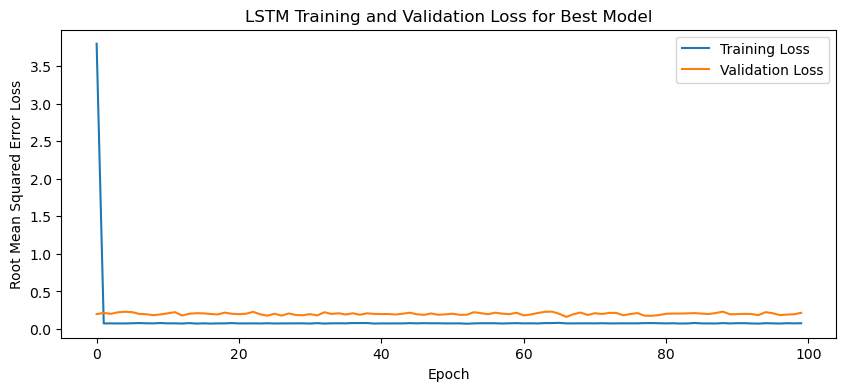

1/1 - 5s - loss: 0.0936 - 5s/epoch - 5s/step
Test Loss: 0.0935535877943039
1/1 [==============================] - 0s 146ms/step


IndexError: index 10 is out of bounds for axis 0 with size 10

In [3]:
n_batch = 1
nb_epoch = 100

def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))

def mape (y_true, y_pred):
    return 100*K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def pearson (y_true, y_pred):
    return (K.square(K.mean((y_true - K.mean(y_true))*(y_pred - K.mean(y_pred)))))/(K.mean(K.square(y_true - K.mean(y_true)))*K.mean(K.square(y_pred - K.mean(y_pred))))
 
# fit an LSTM network to training data
#Adapted from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def create_model(trial, X, y, n_lag, n_seq, n_batch, nb_epoch):

    cv_accuracies = []
    
    #Parameters:
    #trial (array-like): Optuna parameters.
    #train (array-like): Target values.
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations
    #nb_epoch (int): Maximum number of epochs
    
    # Hyperparameters to be tuned by Optuna (taken from Javier Leon's dissertation 'Fruit Prices')
    lr = trial.suggest_float('lr', 1e-3, 1, log=True)
    optimizer_name = trial.suggest_categorical('optimizer', ['Adam', 'RMSprop', 'SGD'])
    if optimizer_name == 'Adam':
        optimizer = Adam(learning_rate=lr)
    elif optimizer_name == 'RMSprop':
        optimizer = RMSprop(learning_rate=lr)
    else:
        optimizer = SGD(learning_rate=lr)
    
    #Optuna will try either Rectified Linear Unit (ReLU) = max(0, x), tanh, or sigmoid functions
    activation_function = trial.suggest_categorical('activation_function', ['relu', 'tanh', 'sigmoid'])
    
    lstm_units = trial.suggest_categorical('lstm_units', [256, 512, 1024])
    dropout_rate = trial.suggest_float('dropout_rate', 0.1, 0.5)

    # design network
    model = Sequential()
    model.add(LSTM(lstm_units, return_sequences=True, batch_input_shape=(n_batch, X.shape[1], X.shape[2]), stateful=True))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units))
    model.add(Dropout(dropout_rate))
    model.add(Dense(256, input_dim=y.shape[1], activation=activation_function))
    model.add(Dense(128, activation=activation_function))
    model.add(Dense(n_seq))
    model.compile(loss=rmse, optimizer=optimizer)
        
    return model

# make forecast with the CNN-LSTM best model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def forecast_lstm(model, X, n_seq, n_test):
    # reshape input pattern to [samples, timesteps, features]
    X = X.reshape(1, 1, X.shape[1])
    # make forecast
    forecast = model.predict(X)
    # convert to array
    return forecast
     
# evaluate the persistence model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def make_forecasts(model, X_test, y_test, n_lag, n_seq, n_test):
    forecasts = list()
    for i in range(len(X_test)):
        X, y = X_test[i, :], y_test[i, :]
        # make forecast
        forecast = forecast_lstm(model, X, n_seq, n_test)
        # store the forecast
        forecasts.append(forecast)
    return forecasts
     
# invert differenced forecast
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_difference(last_ob, forecast):
    # invert first forecast
    inverted = list()
    inverted.append(forecast[0] + last_ob)
    # propagate difference forecast using inverted first value
    for i in range(1, len(forecast)):
        inverted.append(forecast[i] + inverted[i-1])
    return inverted
     
# inverse data transform on forecasts
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_transform(series, forecasts, scaler, n_test, n_seq):
    inverted = list()
    for i in range(len(forecasts)):
        # create array from forecast
        forecast = forecasts[i]
        forecast = forecast.reshape(1, n_seq)
        # invert scaling
        inv_scale = scaler.inverse_transform(forecast)
        inv_scale = inv_scale[0, :]
        # invert differencing
        index = len(series) - n_test + i - 1
        last_ob = series.values[index]
        inv_diff = inverse_difference(last_ob, inv_scale)
        # store
        inverted.append(inv_diff)
    return inverted
     
# evaluate the RMSE for each forecast time step
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def evaluate_forecasts(test, forecasts, n_lag, n_seq):
    rmse_list = []
    mae_list = []
    mape_list = []
    r2_list = []
    for i in range(n_seq):
        actual = [row[i] for row in test]
        predicted = [forecast[i] for forecast in forecasts]
        rmse = sqrt(mean_squared_error(actual, predicted))
        mae = mean_absolute_error(actual, predicted)
        mse = mean_squared_error(actual, predicted)
        mape = mean_absolute_percentage_error(actual, predicted)
        r2 = r2_score(actual, predicted) 
        rmse_list.append(rmse)
        mae_list.append(mae)
        mape_list.append(mape)
        r2_list.append(r2)
        print("Month at t+"+str(i+1)+":")
        print('t+%d RMSE: %f' % ((i+1), rmse))
        print('t+%d MAE: %f' % ((i+1), mae))
        print('t+%d MAPE: %f' % ((i+1), mape))
        print('t+%d R2_SCORE: %f' % ((i+1), r2))

    return rmse_list, mae_list, mape_list, r2_list
     
# plot the forecasts in the context of the original dataset
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def plot_forecasts(series, forecasts, n_test):
    # plot the entire dataset in blue
    plt.plot(series.values)
    # plot the forecasts in red
    for i in range(len(forecasts)):
        off_s = len(series) - n_test + i - 1
        off_e = off_s + len(forecasts[i]) + 1
        xaxis = [x for x in range(off_s, off_e)]
        yaxis = [series.values[off_s]] + forecasts[i]
        plt.plot(xaxis, yaxis, color='red')
    # show the plot
    plt.show()
    
def objective(trial):
    
    cv_accuracies = []
        
    for i in range(5):
        train1 = train[i]
        test1 = test[i]
        validation1 = validation[i]

        X, y = train1[:, 0:-n_seq], train1[:, -n_seq:]
        X_test, y_test = test1[:, 0:-n_seq], test1[:, -n_seq:]
        X_val, y_val = validation1[:, 0:-n_seq], validation1[:, -n_seq:]
        X = X.reshape(X.shape[0], 1, X.shape[1])
        X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
        X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])
    
        model = create_model(trial, X, y, n_lag, n_seq, n_batch, nb_epoch)

        history = model.fit(X, y, validation_data=(X_val, y_val), epochs=nb_epoch, verbose=0)

        cv_accuracy = model.evaluate(X_test, y_test, verbose=0)
    
        loss = history.history['val_loss'][-1]
    
        # Plotting the training and validation loss
        #plt.figure(figsize=(10, 4))
        #plt.plot(history.history['loss'], label='Training Loss')
        #plt.plot(history.history['val_loss'], label='Validation Loss')
        #title1 = "LSTM Training and Validation Loss for Fold " + str(i+1)
        #plt.title(title1)
        #plt.xlabel('Epoch')
        #plt.ylabel('Root Mean Squared Error Loss')
        #plt.legend()
        #plt.show()
            
        cv_accuracies.append(cv_accuracy)
    
    print("Cross Validation Accuracies:")
    print(cv_accuracies)
    print("Mean Cross Validation Accuracy:")
    print(np.mean(cv_accuracies))
    print("Standard Deviation of Cross Validation Accuracy:")
    print(np.std(cv_accuracies))
        
    return np.mean(cv_accuracies)

n_batch = 1
nb_epoch = 100

# optimize and fit model
study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=100)
print('Number of finished trials:', len(study.trials))

print('Best trial:', study.best_trial.params)
best_params = study.best_params
print("Best hyperparameters: ", best_params)

for i in range(5):
    print("Fold "+str(i+1)+":")
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]

    X, y = train1[:, 0:-n_seq], train1[:, -n_seq:]
    X_test, y_test = test1[:, 0:-n_seq], test1[:, -n_seq:]
    X_val, y_val = validation1[:, 0:-n_seq], validation1[:, -n_seq]

    dataset_df = pd.DataFrame(val_y[i])
    dataset_df = dataset_df.iloc[0:10, :]
    dataset = dataset_df.values

    series = pd.Series(dataset[:, 0]) # Using first column (specific_humidity)
    
    X = X.reshape(X.shape[0], 1, X.shape[1])
    X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
    X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])

    best_model = create_model(optuna.trial.FixedTrial(best_params), X, y, n_lag, n_seq, n_batch, nb_epoch)
    history=best_model.fit(X, y, epochs=nb_epoch, batch_size=n_batch, validation_data=(X_val, y_val))

    # Plotting the training and validation loss
    plt.figure(figsize=(10, 4))
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    title1 = "LSTM Training and Validation Loss for Best Model"
    plt.title(title1)
    plt.xlabel('Epoch')
    plt.ylabel('Root Mean Squared Error Loss')
    plt.legend()
    plt.show()

    # Evaluate the model
    loss = best_model.evaluate(X_test, y_test, verbose=2)
    print(f'Test Loss: {loss}')

    # make forecasts
    forecasts = make_forecasts(best_model, X_test, y_test, n_lag, n_seq, n_test)
    
    # inverse transform forecasts and test
    forecasts = inverse_transform(series, forecasts, scaler[i], n_test+2, n_seq)
    actual = [row[-n_seq:] for row in test1]
    actual = inverse_transform(series, actual, scaler[i], n_test+2, n_seq)

    rmse_list = [] # list stores root mean squared errors for each future time prediction
    mae_list = [] # list stores root mean squared errors for each future time prediction
    mape_list = [] # list stores root mean squared errors for each future time prediction
    r2_list = [] # list stores root mean squared errors for each future time prediction
    
    # evaluate forecasts
    rmse_list, mae_list, mape_list, r2_list = evaluate_forecasts(actual, forecasts, n_lag, n_seq)

    for j in range(len(X_test)):
        print("Weather Station "+str(j+1)+":")
        dataset_df = pd.DataFrame(y_test[j].flatten())
        dataset = dataset_df.values
        dataset = dataset[:, 0]
        dataset = np.array(dataset).reshape(-1, 1)
        dataset = dataset.flatten()
        dataset = pd.DataFrame(dataset)
        series = scaler[i].inverse_transform(dataset)
        series = pd.Series(series.flatten())

    # plot forecasts
    plot_forecasts(series, forecasts, 1)
    
    best_model.summary()

    # Print out table of actual and predicted values for each weather station
    for j in range(11):
        print("Weather Station "+str(j+1)+":")
        print("Actual Temp\tPredicted Temp\tDifference")
        print("-----------\t--------------\t----------")
        for k in range(n_seq):
            diff = forecasts[j][k] - actual[j][k]
            print(f"{actual[j][k]:.2f}\t\t{forecasts[j][k]:.2f}\t\t{diff:.2f}")

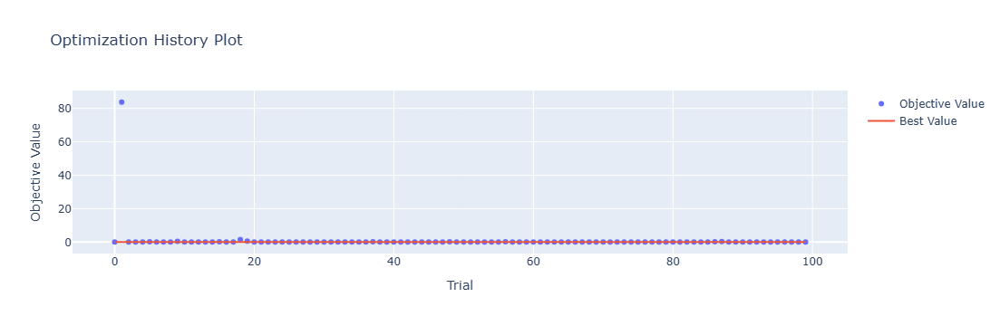

In [4]:
optuna.visualization.plot_optimization_history(study)

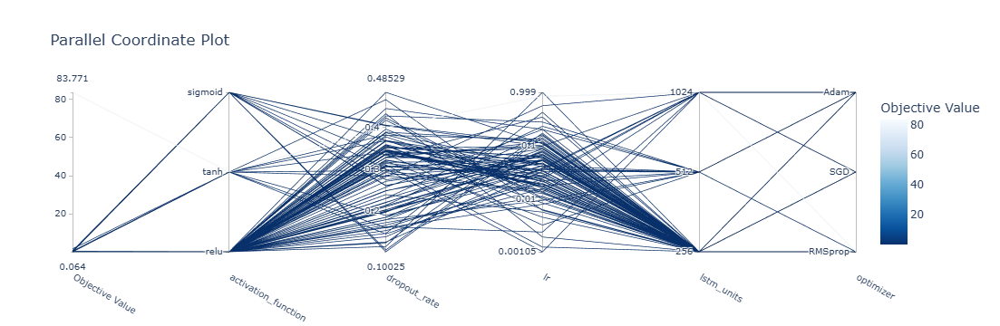

In [5]:
optuna.visualization.plot_parallel_coordinate(study)

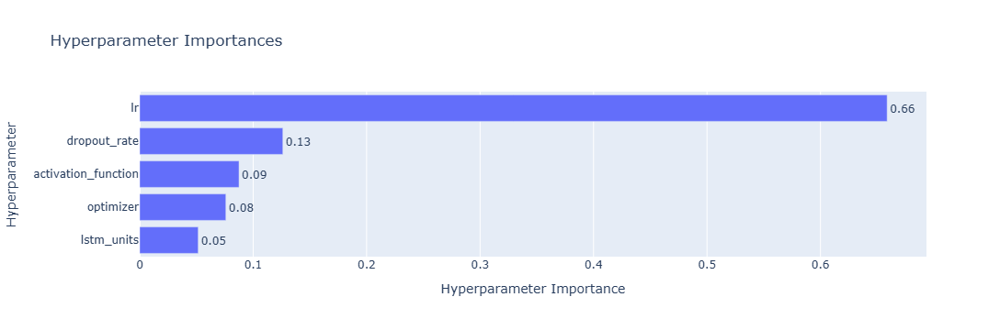

In [6]:
optuna.visualization.plot_param_importances(study)

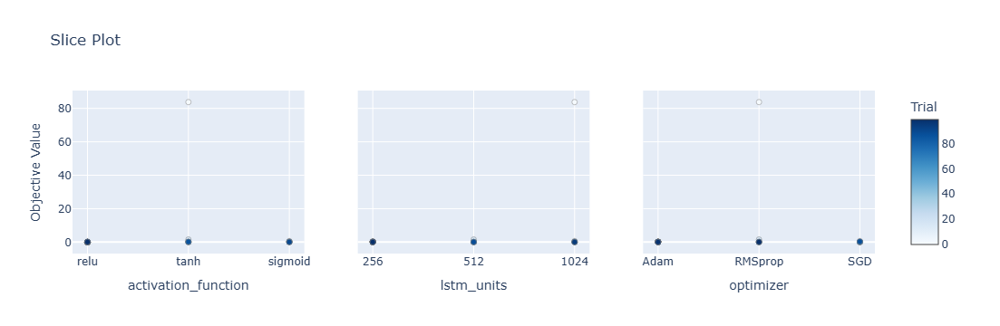

In [7]:
optuna.visualization.plot_slice(study, params=['optimizer', 'activation_function', 'lstm_units'])

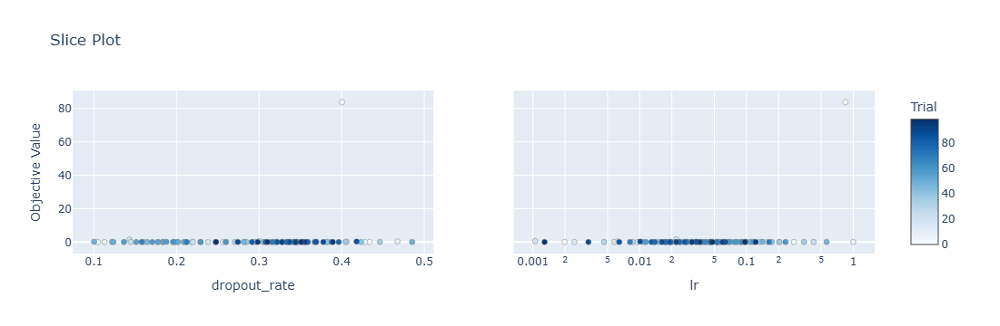

In [8]:
optuna.visualization.plot_slice(study, params=['lr', 'dropout_rate'])

[[ 5.39  4.3   6.51 ... 13.73  8.35  9.05]
 [ 8.03  6.78  8.21 ... 17.14 11.74 12.27]
 [ 5.48  4.27  5.49 ... 13.3   9.17  8.6 ]
 ...
 [ 4.55  3.1   4.22 ... 12.8   7.91  6.65]
 [ 4.44  3.4   5.39 ... 12.34  7.74  6.78]
 [ 4.14  2.75  4.12 ... 10.6   7.07  6.41]]
Epoch 1/100
84/84 [==============================] - 39s 201ms/step - loss: 2.8742 - accuracy: 0.1786 - mae: 2.7662 - rmse: 2.8742 - mape: 630.5253 - pearson: 0.5333 - val_loss: 0.0787 - val_accuracy: 0.0000e+00 - val_mae: 0.0650 - val_rmse: 0.0787 - val_mape: 14.2795 - val_pearson: 0.6282
Epoch 2/100
84/84 [==============================] - 11s 128ms/step - loss: 0.2517 - accuracy: 0.3452 - mae: 0.2244 - rmse: 0.2517 - mape: 48.5873 - pearson: 0.7192 - val_loss: 0.0722 - val_accuracy: 0.0000e+00 - val_mae: 0.0597 - val_rmse: 0.0722 - val_mape: 12.9353 - val_pearson: 0.7149
Epoch 3/100
84/84 [==============================] - 12s 139ms/step - loss: 0.0775 - accuracy: 0.3095 - mae: 0.0608 - rmse: 0.0775 - mape: 13.6760 - pearso

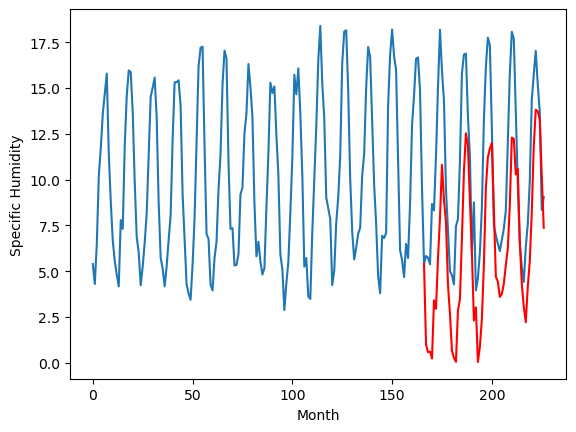

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.86		2.25		3.11
-0.53		1.83		2.36
-0.97		1.87		2.84
-0.24		1.49		1.73
3.64		4.66		1.02
1.85		4.20		2.35
4.17		6.95		2.78
7.85		9.14		1.29
9.51		12.05		2.54
9.45		10.14		0.69
7.35		8.89		1.54
4.79		5.52		0.73
1.46		3.91		2.45
-2.06		1.91		3.97
-1.71		1.51		3.22
-1.00		1.30		2.30
1.21		4.09		2.88
1.43		4.73		3.30
3.92		8.07		4.15
8.67		11.68		3.01
9.47		13.77		4.30
9.63		13.11		3.48
7.47		10.08		2.61
4.39		7.25		2.86
-1.27		3.56		4.83
2.37		4.27		1.90
-2.39		1.30		3.69
-1.17		2.12		3.29
0.74		3.65		2.91
2.04		6.58		4.54
6.28		10.81		4.53
8.89		12.48		3.59
9.79		12.94		3.15
9.22		13.26		4.04
6.16		9.64		3.48
1.02		5.94		4.92
0.82		5.68		4.86
-0.38		4.84		5.22
-0.29		5.01		5.30
1.40		5.56		4.16
1.78		6.58		4.80
2.57		7.50		4.93
4.76		9.87		5.11
8.09		13.54		5.45
9.76		13.47		3.71
10.54		11.53		0.99
6.52		11.83		5.31
1.82		7.87		6.05
-0.36		5.56		5.92
-1.80		4.31		6.11
-2.58		3.46		6.04
-1.36		5

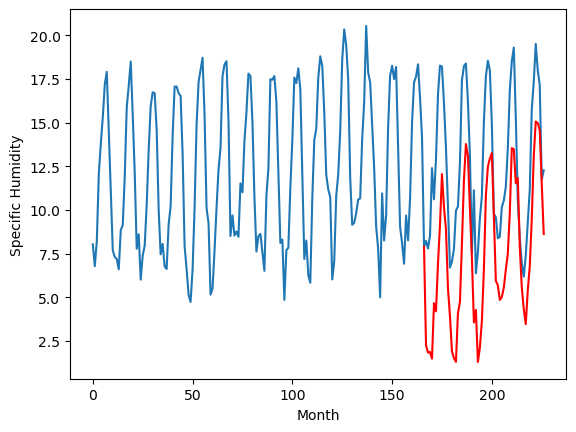

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.23		4.89		2.66
2.48		4.47		1.99
2.31		4.51		2.20
2.86		4.13		1.27
5.46		7.30		1.84
4.21		6.84		2.63
7.07		9.59		2.52
10.98		11.78		0.80
13.38		14.69		1.31
13.47		12.78		-0.69
10.38		11.53		1.15
7.63		8.16		0.53
4.30		6.55		2.25
1.14		4.55		3.41
1.52		4.15		2.63
1.67		3.94		2.27
3.52		6.73		3.21
3.76		7.37		3.61
6.52		10.71		4.19
11.14		14.32		3.18
13.05		16.41		3.36
13.25		15.75		2.50
10.25		12.72		2.47
7.53		9.89		2.36
1.66		6.20		4.54
4.06		6.91		2.85
0.65		3.94		3.29
1.86		4.76		2.90
2.57		6.29		3.72
4.02		9.22		5.20
8.16		13.45		5.29
10.94		15.12		4.18
13.14		15.58		2.44
12.44		15.90		3.46
8.71		12.28		3.57
3.71		8.58		4.87
3.39		8.32		4.93
2.06		7.48		5.42
2.43		7.65		5.22
3.54		8.20		4.66
2.90		9.22		6.32
4.34		10.14		5.80
7.12		12.51		5.39
9.70		16.18		6.48
12.56		16.11		3.55
12.65		14.17		1.52
9.07		14.47		5.40
5.16		10.51		5.35
2.63		8.20		5.57
1.82		6.95		5.13
1.02		6.10		5.08
1.6

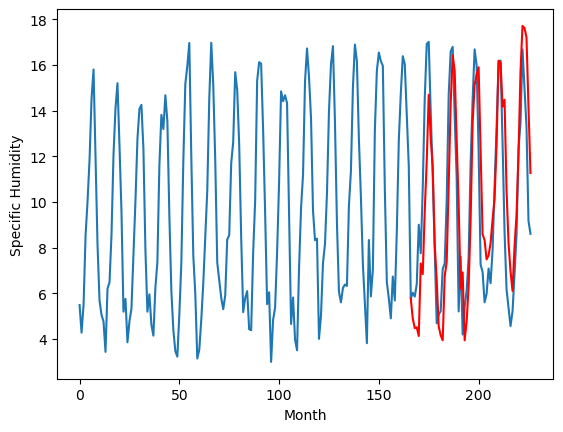

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.48		2.34		2.82
0.06		1.92		1.86
0.30		1.96		1.66
0.44		1.58		1.14
4.75		4.75		0.00
3.60		4.29		0.69
5.75		7.04		1.29
8.24		9.23		0.99
10.99		12.14		1.15
9.74		10.23		0.49
8.39		8.98		0.59
4.58		5.61		1.03
1.53		4.00		2.47
-1.54		2.00		3.54
-1.47		1.60		3.07
-1.56		1.39		2.95
1.89		4.18		2.29
2.46		4.82		2.36
5.97		8.16		2.19
9.87		11.77		1.90
10.71		13.86		3.15
10.33		13.20		2.87
8.02		10.17		2.15
5.59		7.34		1.75
-0.62		3.65		4.27
2.43		4.36		1.93
-2.69		1.39		4.08
-1.48		2.21		3.69
-0.39		3.74		4.13
2.53		6.67		4.14
6.77		10.90		4.13
8.78		12.57		3.79
9.99		13.03		3.04
9.27		13.35		4.08
5.89		9.73		3.84
0.79		6.03		5.24
0.27		5.77		5.50
-0.23		4.93		5.16
-0.04		5.10		5.14
0.63		5.65		5.02
1.71		6.67		4.96
2.11		7.59		5.48
4.96		9.96		5.00
9.11		13.63		4.52
10.14		13.56		3.42
9.89		11.62		1.73
7.71		11.92		4.21
3.14		7.96		4.82
0.15		5.65		5.50
-1.25		4.40		5.65
-2.17		3.55		5.72
-0.39		5

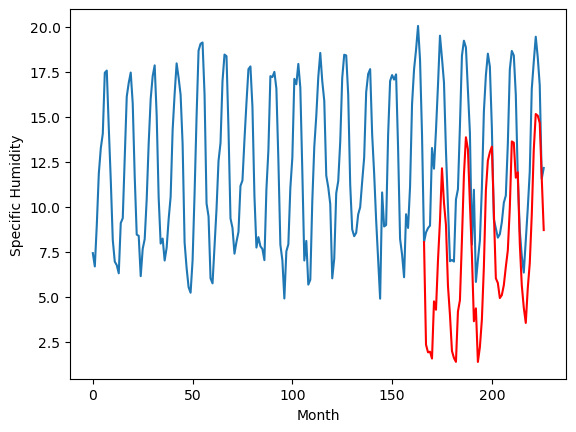

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
4.29		4.29		0.00
3.04		3.87		0.83
3.83		3.91		0.08
3.22		3.53		0.31
7.67		6.70		-0.97
7.39		6.24		-1.15
9.97		8.99		-0.98
12.33		11.18		-1.15
15.19		14.09		-1.10
12.92		12.18		-0.74
11.61		10.93		-0.68
7.33		7.56		0.23
5.48		5.95		0.47
2.70		3.95		1.25
2.63		3.55		0.92
2.23		3.34		1.11
5.07		6.13		1.06
6.47		6.77		0.30
10.48		10.11		-0.37
14.17		13.72		-0.45
14.88		15.81		0.93
14.80		15.15		0.35
10.57		12.12		1.55
8.48		9.29		0.81
4.26		5.60		1.34
7.02		6.31		-0.71
1.52		3.34		1.82
1.78		4.16		2.38
3.33		5.69		2.36
7.25		8.62		1.37
10.95		12.85		1.90
11.92		14.52		2.60
11.68		14.98		3.30
12.77		15.30		2.53
9.94		11.68		1.74
5.14		7.98		2.84
5.13		7.72		2.59
4.05		6.88		2.83
3.29		7.05		3.76
3.63		7.60		3.97
5.82		8.62		2.80
6.58		9.54		2.96
10.52		11.91		1.39
14.64		15.58		0.94
13.22		15.51		2.29
11.40		13.57		2.17
11.36		13.87		2.51
7.61		9.91		2.30
4.81		7.60		2.79
2.95		6.35		3.40
1.77		5.

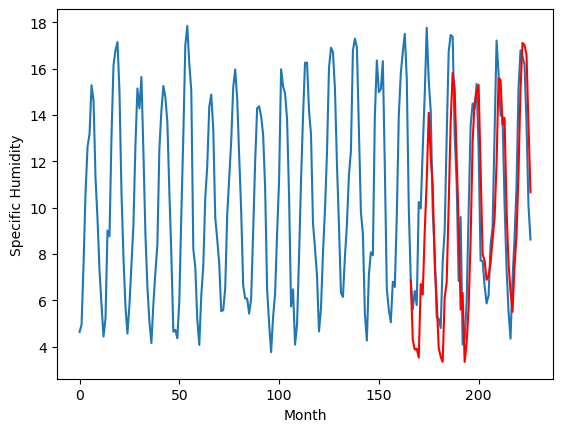

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.81		1.49		2.30
-0.85		1.07		1.92
-1.33		1.11		2.44
-1.44		0.73		2.17
0.32		3.90		3.58
0.66		3.44		2.78
3.79		6.19		2.40
7.52		8.38		0.86
11.00		11.29		0.29
11.03		9.38		-1.65
8.13		8.13		0.00
4.43		4.76		0.33
1.48		3.15		1.67
-2.28		1.15		3.43
-2.89		0.75		3.64
-2.30		0.54		2.84
-0.73		3.33		4.06
0.28		3.97		3.69
2.78		7.31		4.53
8.04		10.92		2.88
9.16		13.01		3.85
10.32		12.35		2.03
6.23		9.32		3.09
3.91		6.49		2.58
-1.35		2.80		4.15
0.07		3.51		3.44
-3.04		0.54		3.58
-1.66		1.36		3.02
-0.33		2.89		3.22
0.80		5.82		5.02
5.58		10.05		4.47
6.67		11.72		5.05
11.00		12.18		1.18
9.21		12.50		3.29
6.51		8.88		2.37
1.87		5.18		3.31
1.21		4.92		3.71
-2.14		4.08		6.22
-1.39		4.25		5.64
-0.46		4.80		5.26
-0.68		5.82		6.50
2.00		6.74		4.74
2.76		9.11		6.35
6.66		12.78		6.12
11.01		12.71		1.70
10.12		10.77		0.65
7.00		11.07		4.07
2.60		7.11		4.51
-0.42		4.80		5.22
-1.24		3.55		4.79
-2.03		2.70		4.73


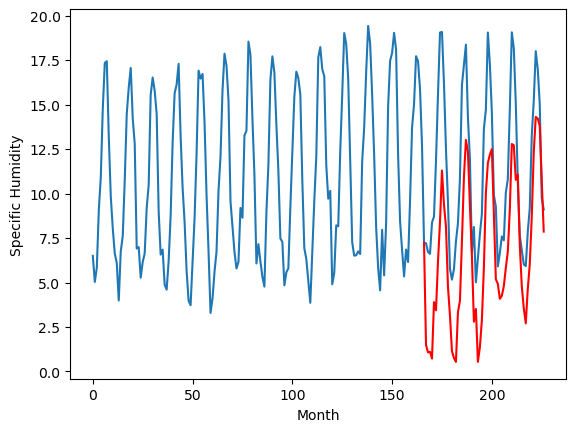

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.38		3.36		1.98
1.50		2.94		1.44
1.42		2.98		1.56
1.78		2.60		0.82
3.41		5.77		2.36
3.19		5.31		2.12
6.29		8.06		1.77
10.01		10.25		0.24
12.80		13.16		0.36
12.74		11.25		-1.49
9.21		10.00		0.79
6.49		6.63		0.14
3.64		5.02		1.38
0.77		3.02		2.25
0.62		2.62		2.00
0.67		2.41		1.74
2.26		5.20		2.94
2.86		5.84		2.98
5.86		9.18		3.32
10.24		12.79		2.55
11.68		14.88		3.20
12.21		14.22		2.01
8.89		11.19		2.30
6.78		8.36		1.58
1.03		4.67		3.64
2.87		5.38		2.51
0.09		2.41		2.32
1.37		3.23		1.86
2.38		4.76		2.38
3.38		7.69		4.31
7.74		11.92		4.18
9.62		13.59		3.97
13.24		14.05		0.81
11.89		14.37		2.48
8.45		10.75		2.30
3.89		7.05		3.16
3.29		6.79		3.50
1.11		5.95		4.84
1.97		6.12		4.15
2.65		6.67		4.02
2.24		7.69		5.45
4.45		8.61		4.16
6.04		10.98		4.94
8.77		14.65		5.88
12.51		14.58		2.07
12.14		12.64		0.50
9.20		12.94		3.74
4.94		8.98		4.04
1.61		6.67		5.06
1.54		5.42		3.88
0.87		4.57		3.70
1.03		6.5

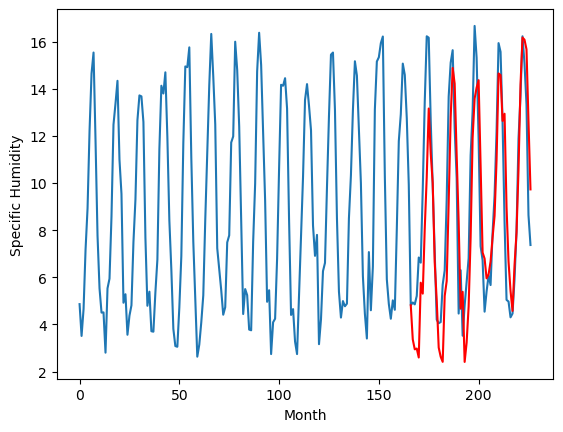

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.05		1.72		1.77
0.20		1.30		1.10
0.23		1.34		1.11
0.45		0.96		0.51
1.75		4.13		2.38
1.69		3.67		1.98
3.68		6.42		2.74
8.35		8.61		0.26
11.16		11.52		0.36
11.40		9.61		-1.79
7.50		8.36		0.86
4.79		4.99		0.20
2.25		3.38		1.13
-0.62		1.38		2.00
-0.93		0.98		1.91
-0.90		0.77		1.67
0.72		3.56		2.84
1.42		4.20		2.78
4.44		7.54		3.10
8.71		11.15		2.44
10.21		13.24		3.03
10.49		12.58		2.09
7.00		9.55		2.55
5.12		6.72		1.60
-0.67		3.03		3.70
1.10		3.74		2.64
-1.41		0.77		2.18
-0.18		1.59		1.77
0.81		3.12		2.31
1.71		6.05		4.34
6.00		10.28		4.28
7.45		11.95		4.50
10.82		12.41		1.59
9.75		12.73		2.98
6.96		9.11		2.15
2.54		5.41		2.87
1.84		5.15		3.31
-0.50		4.31		4.81
0.43		4.48		4.05
0.79		5.03		4.24
0.71		6.05		5.34
2.99		6.97		3.98
4.31		9.34		5.03
6.93		13.01		6.08
11.28		12.94		1.66
10.22		11.00		0.78
7.42		11.30		3.88
3.67		7.34		3.67
0.15		5.03		4.88
0.35		3.78		3.43
-0.34		2.93		3.27
-0.31		4.

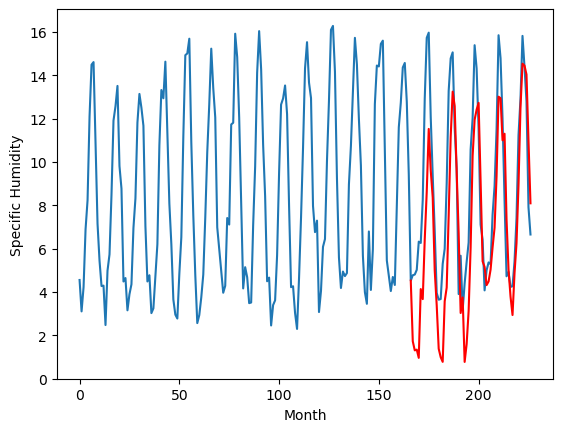

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.27		1.41		0.14
1.36		0.99		-0.37
0.96		1.03		0.07
0.95		0.65		-0.30
3.21		3.82		0.61
3.45		3.36		-0.09
6.67		6.11		-0.56
10.32		8.30		-2.02
13.41		11.21		-2.20
11.38		9.30		-2.08
8.66		8.05		-0.61
4.21		4.68		0.47
2.45		3.07		0.62
0.54		1.07		0.53
0.31		0.67		0.36
-0.37		0.46		0.83
2.69		3.25		0.56
3.42		3.89		0.47
6.33		7.23		0.90
11.31		10.84		-0.47
12.81		12.93		0.12
13.00		12.27		-0.73
9.19		9.24		0.05
6.77		6.41		-0.36
1.48		2.72		1.24
3.07		3.43		0.36
-0.21		0.46		0.67
0.38		1.28		0.90
2.06		2.81		0.75
3.64		5.74		2.10
7.83		9.97		2.14
10.01		11.64		1.63
13.67		12.10		-1.57
12.70		12.42		-0.28
8.25		8.80		0.55
3.02		5.10		2.08
2.02		4.84		2.82
1.09		4.00		2.91
1.69		4.17		2.48
1.76		4.72		2.96
2.20		5.74		3.54
3.42		6.66		3.24
6.91		9.03		2.12
9.19		12.70		3.51
12.74		12.63		-0.11
12.74		10.69		-2.05
8.67		10.99		2.32
4.61		7.03		2.42
1.95		4.72		2.77
1.34		3.47		2.13
0.16		2.62		2.46

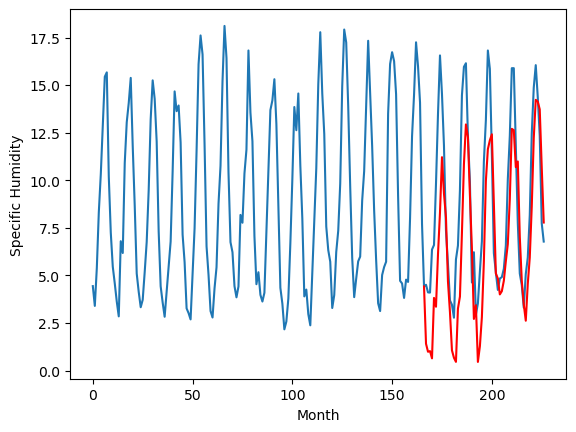

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.78		1.30		0.52
1.19		0.88		-0.31
0.69		0.92		0.23
0.37		0.54		0.17
2.33		3.71		1.38
2.39		3.25		0.86
5.53		6.00		0.47
8.22		8.19		-0.03
11.36		11.10		-0.26
10.14		9.19		-0.95
7.35		7.94		0.59
4.01		4.57		0.56
1.96		2.96		1.00
0.30		0.96		0.66
-0.03		0.56		0.59
-0.48		0.35		0.83
1.32		3.14		1.82
2.64		3.78		1.14
4.73		7.12		2.39
9.50		10.73		1.23
10.43		12.82		2.39
10.85		12.16		1.31
7.68		9.13		1.45
6.37		6.30		-0.07
0.85		2.61		1.76
1.69		3.32		1.63
-0.60		0.35		0.95
0.14		1.17		1.03
1.42		2.70		1.28
3.04		5.63		2.59
7.65		9.86		2.21
9.33		11.53		2.20
12.91		11.99		-0.92
11.37		12.31		0.94
8.31		8.69		0.38
2.52		4.99		2.47
1.80		4.73		2.93
0.87		3.89		3.02
1.48		4.06		2.58
1.25		4.61		3.36
1.35		5.63		4.28
3.08		6.55		3.47
5.52		8.92		3.40
8.14		12.59		4.45
11.96		12.52		0.56
10.66		10.58		-0.08
7.94		10.88		2.94
4.70		6.92		2.22
1.35		4.61		3.26
1.54		3.36		1.82
0.57		2.51		1.94
0.92		4.

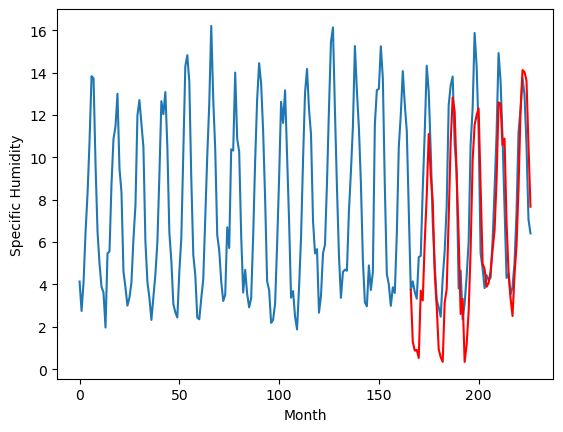

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.49		1.00		0.51
0.61		0.58		-0.03
0.23		0.62		0.39
-0.28		0.24		0.52
1.32		3.41		2.09
1.68		2.95		1.27
4.58		5.70		1.12
7.68		7.89		0.21
10.73		10.80		0.07
9.16		8.89		-0.27
6.50		7.64		1.14
3.05		4.27		1.22
1.64		2.66		1.02
0.11		0.66		0.55
-0.27		0.26		0.53
-1.01		0.05		1.06
0.61		2.84		2.23
2.21		3.48		1.27
3.73		6.82		3.09
8.86		10.43		1.57
9.93		12.52		2.59
10.42		11.86		1.44
6.80		8.83		2.03
5.81		6.00		0.19
0.96		2.31		1.35
0.96		3.02		2.06
-1.11		0.05		1.16
-0.51		0.87		1.38
0.74		2.40		1.66
1.68		5.33		3.65
5.40		9.56		4.16
6.67		11.23		4.56
9.16		11.69		2.53
10.15		12.01		1.86
7.55		8.39		0.84
2.53		4.69		2.16
1.39		4.43		3.04
0.22		3.59		3.37
0.62		3.76		3.14
0.06		4.31		4.25
0.52		5.33		4.81
2.16		6.25		4.09
3.37		8.62		5.25
6.38		12.29		5.91
10.21		12.22		2.01
9.46		10.28		0.82
8.15		10.58		2.43
4.39		6.62		2.23
0.98		4.31		3.33
1.51		3.06		1.55
-0.01		2.21		2.22
0.52		4.15		3.

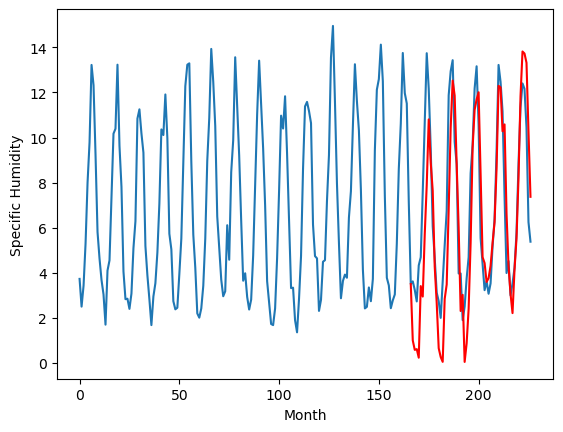

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    0.03    1.00118
1                 1   -0.86    2.25118
2                 2    2.23    4.89118
3                 3   -0.48    2.34118
4                 4    4.29    4.29118
5                 5   -0.81    1.49118
6                 6    1.38    3.36118
7                 7   -0.05    1.72118
8                 8    1.27    1.41118
9                 9    0.78    1.30118
10               10    0.49    1.00118


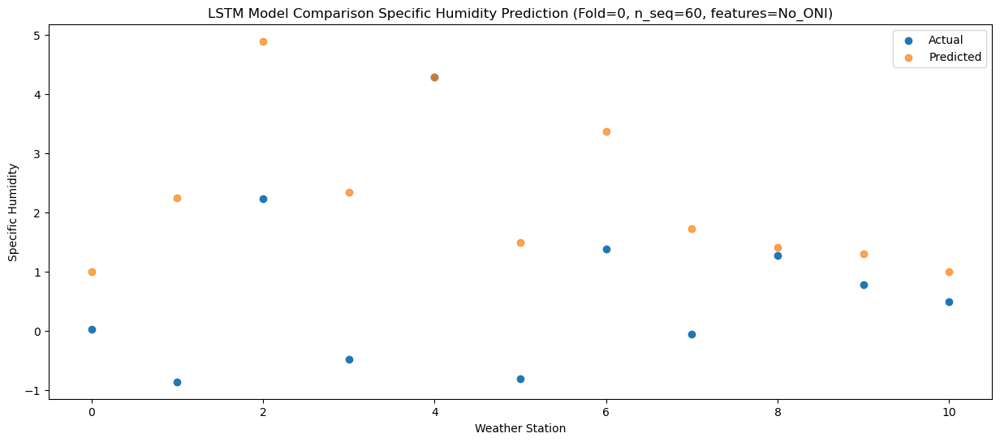

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    0.46   0.580538
1                 1   -0.53   1.830538
2                 2    2.48   4.470538
3                 3    0.06   1.920538
4                 4    3.04   3.870538
5                 5   -0.85   1.070538
6                 6    1.50   2.940538
7                 7    0.20   1.300538
8                 8    1.36   0.990538
9                 9    1.19   0.880538
10               10    0.61   0.580538


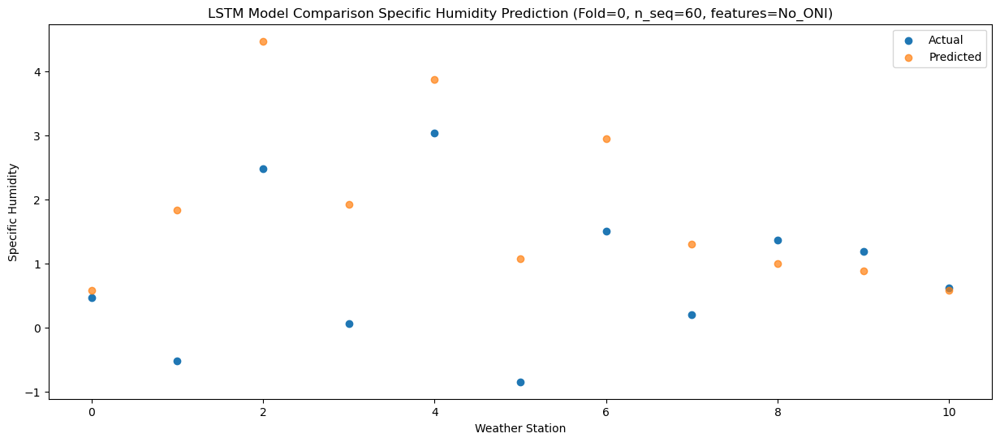

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0    0.37   0.615147
1                 1   -0.97   1.865147
2                 2    2.31   4.505147
3                 3    0.30   1.955147
4                 4    3.83   3.905147
5                 5   -1.33   1.105147
6                 6    1.42   2.975147
7                 7    0.23   1.335147
8                 8    0.96   1.025147
9                 9    0.69   0.915147
10               10    0.23   0.615147


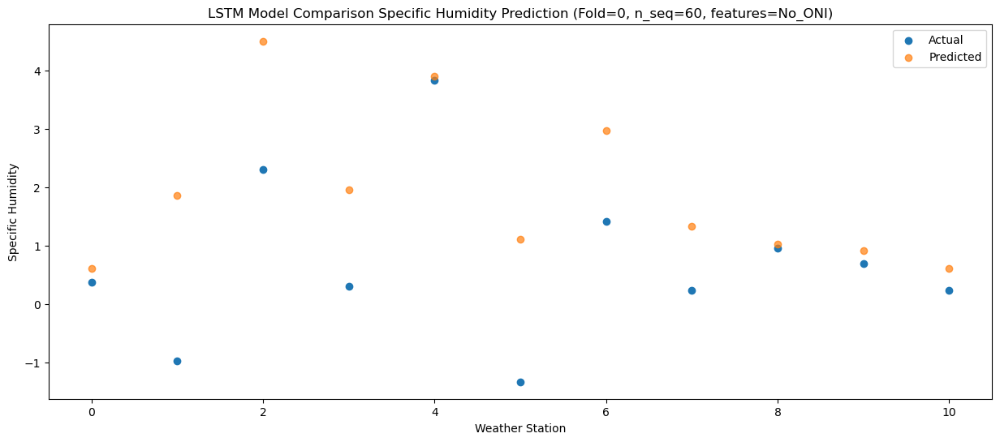

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0    0.01   0.235161
1                 1   -0.24   1.485161
2                 2    2.86   4.125161
3                 3    0.44   1.575161
4                 4    3.22   3.525161
5                 5   -1.44   0.725161
6                 6    1.78   2.595161
7                 7    0.45   0.955161
8                 8    0.95   0.645161
9                 9    0.37   0.535161
10               10   -0.28   0.235161


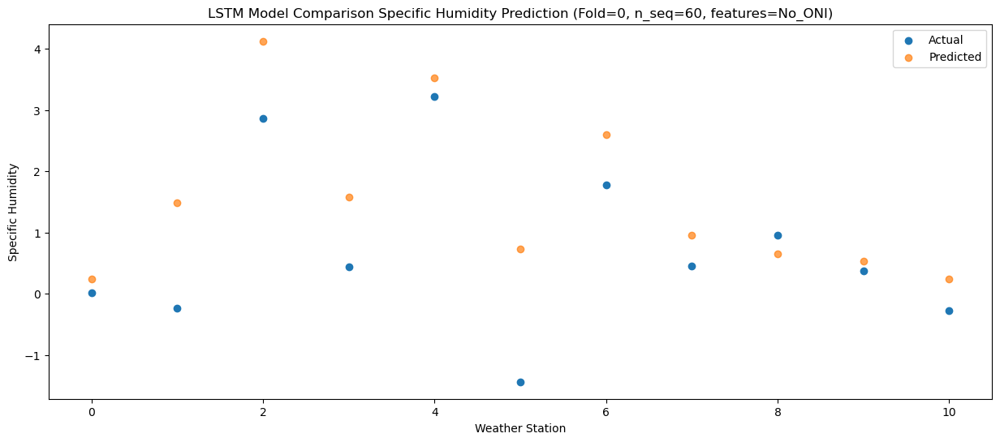

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    3.30   3.410113
1                 1    3.64   4.660113
2                 2    5.46   7.300113
3                 3    4.75   4.750113
4                 4    7.67   6.700113
5                 5    0.32   3.900113
6                 6    3.41   5.770113
7                 7    1.75   4.130113
8                 8    3.21   3.820113
9                 9    2.33   3.710113
10               10    1.32   3.410113


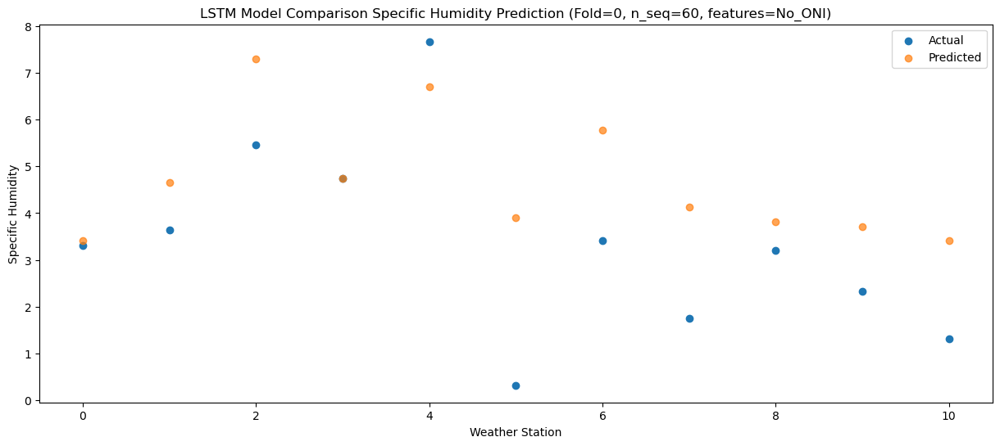

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    2.95   2.946698
1                 1    1.85   4.196698
2                 2    4.21   6.836698
3                 3    3.60   4.286698
4                 4    7.39   6.236698
5                 5    0.66   3.436698
6                 6    3.19   5.306698
7                 7    1.69   3.666698
8                 8    3.45   3.356698
9                 9    2.39   3.246698
10               10    1.68   2.946698


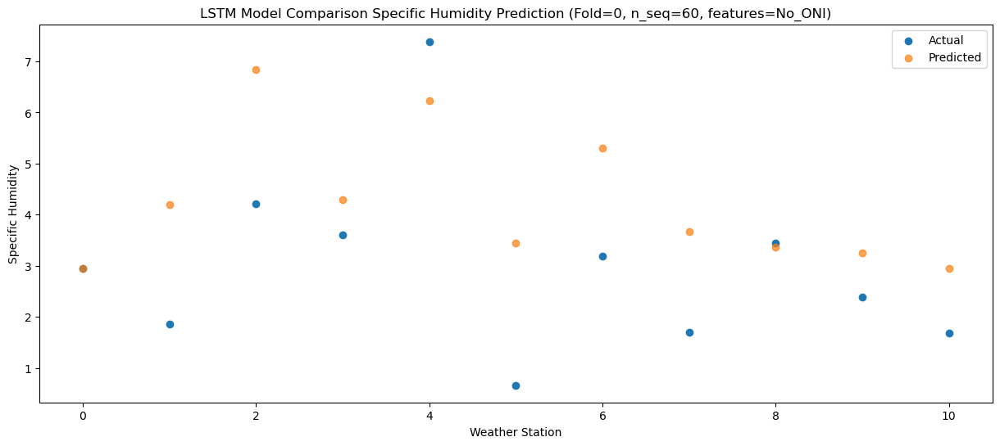

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    5.92   5.698843
1                 1    4.17   6.948843
2                 2    7.07   9.588843
3                 3    5.75   7.038843
4                 4    9.97   8.988843
5                 5    3.79   6.188843
6                 6    6.29   8.058843
7                 7    3.68   6.418843
8                 8    6.67   6.108843
9                 9    5.53   5.998843
10               10    4.58   5.698843


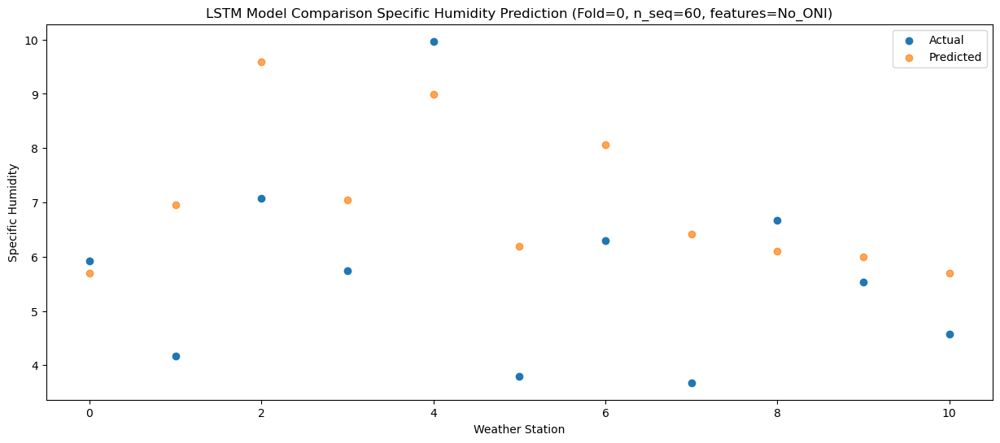

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0    9.68   7.893117
1                 1    7.85   9.143117
2                 2   10.98  11.783117
3                 3    8.24   9.233117
4                 4   12.33  11.183117
5                 5    7.52   8.383117
6                 6   10.01  10.253117
7                 7    8.35   8.613117
8                 8   10.32   8.303117
9                 9    8.22   8.193117
10               10    7.68   7.893117


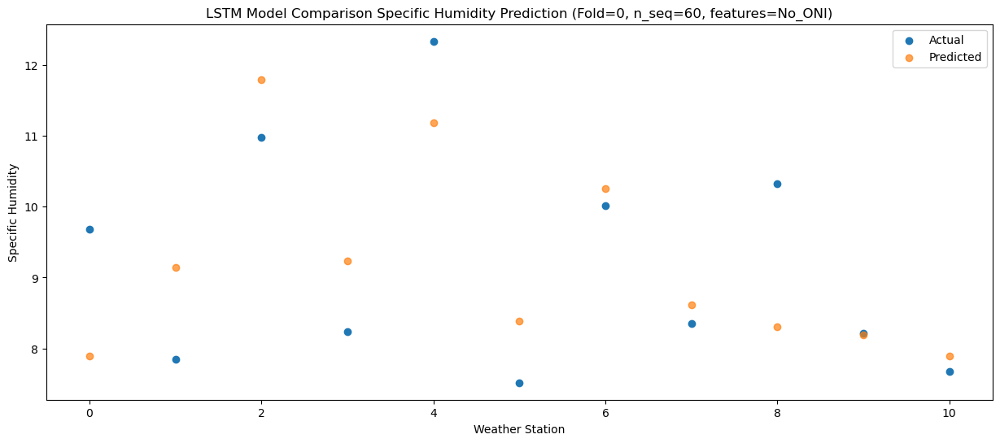

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   12.81  10.803782
1                 1    9.51  12.053782
2                 2   13.38  14.693782
3                 3   10.99  12.143782
4                 4   15.19  14.093782
5                 5   11.00  11.293782
6                 6   12.80  13.163782
7                 7   11.16  11.523782
8                 8   13.41  11.213782
9                 9   11.36  11.103782
10               10   10.73  10.803782


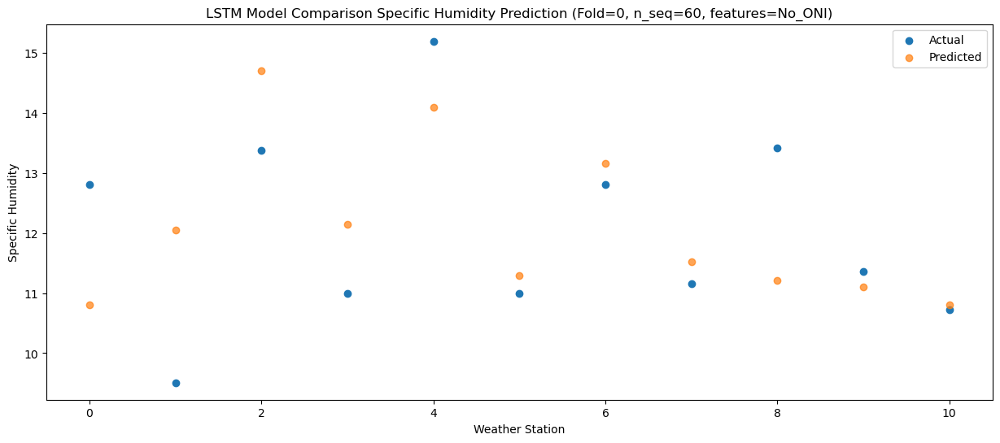

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   10.56   8.892709
1                 1    9.45  10.142709
2                 2   13.47  12.782709
3                 3    9.74  10.232709
4                 4   12.92  12.182709
5                 5   11.03   9.382709
6                 6   12.74  11.252709
7                 7   11.40   9.612709
8                 8   11.38   9.302709
9                 9   10.14   9.192709
10               10    9.16   8.892709


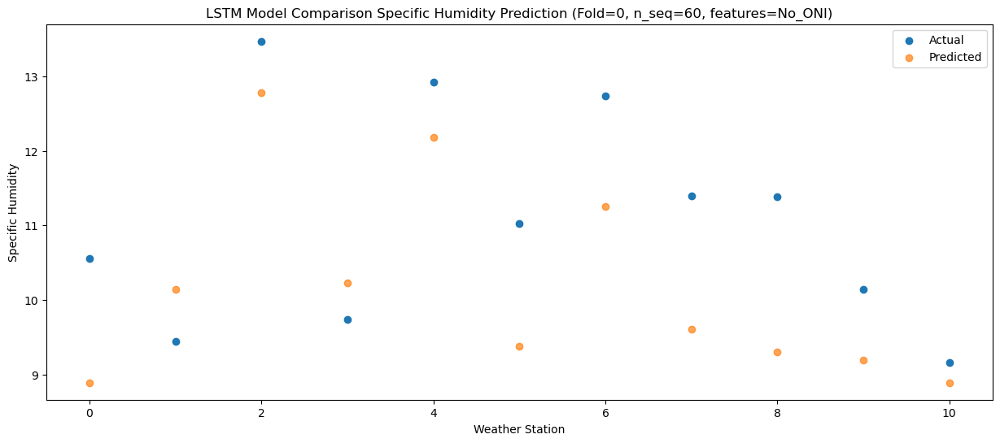

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    8.92   7.641311
1                 1    7.35   8.891311
2                 2   10.38  11.531311
3                 3    8.39   8.981311
4                 4   11.61  10.931311
5                 5    8.13   8.131311
6                 6    9.21  10.001311
7                 7    7.50   8.361311
8                 8    8.66   8.051311
9                 9    7.35   7.941311
10               10    6.50   7.641311


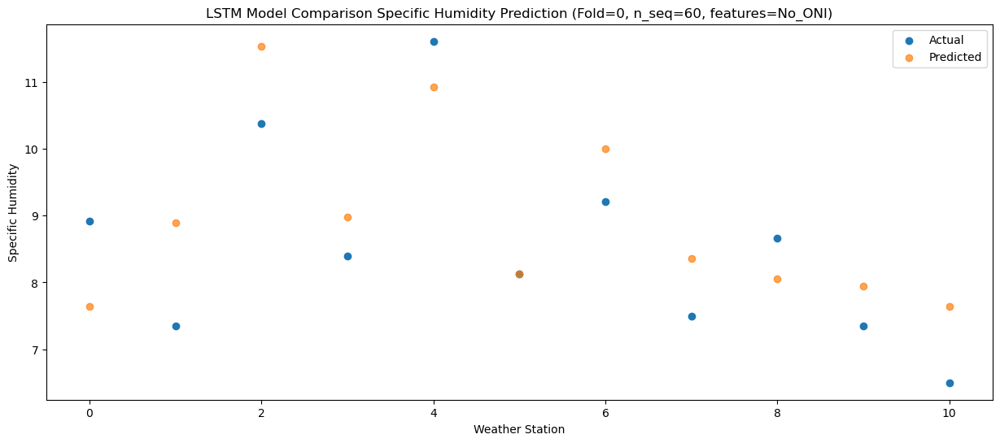

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    4.11   4.272919
1                 1    4.79   5.522919
2                 2    7.63   8.162919
3                 3    4.58   5.612919
4                 4    7.33   7.562919
5                 5    4.43   4.762919
6                 6    6.49   6.632919
7                 7    4.79   4.992919
8                 8    4.21   4.682919
9                 9    4.01   4.572919
10               10    3.05   4.272919


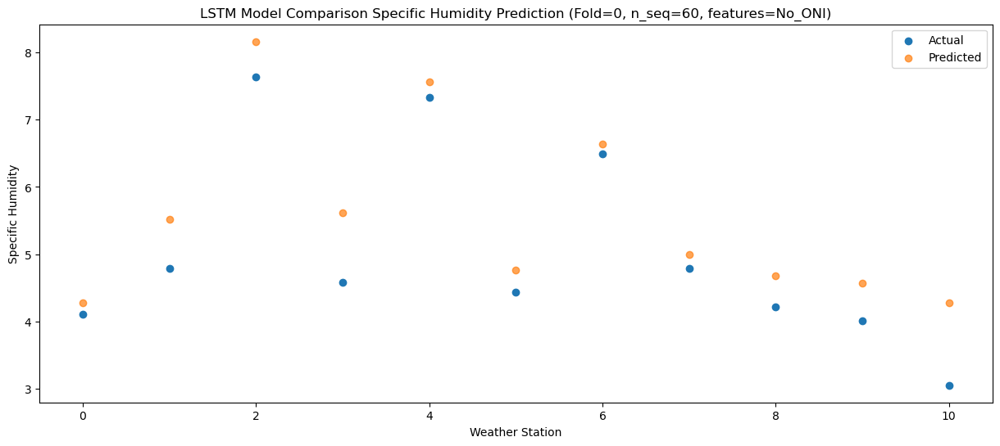

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    1.87   2.660528
1                 1    1.46   3.910528
2                 2    4.30   6.550528
3                 3    1.53   4.000528
4                 4    5.48   5.950528
5                 5    1.48   3.150528
6                 6    3.64   5.020528
7                 7    2.25   3.380528
8                 8    2.45   3.070528
9                 9    1.96   2.960528
10               10    1.64   2.660528


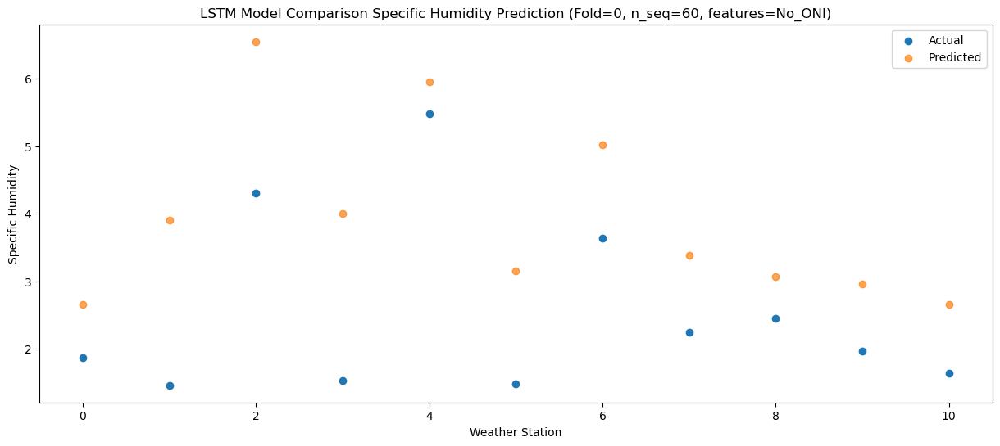

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -0.36   0.655333
1                 1   -2.06   1.905333
2                 2    1.14   4.545333
3                 3   -1.54   1.995333
4                 4    2.70   3.945333
5                 5   -2.28   1.145333
6                 6    0.77   3.015333
7                 7   -0.62   1.375333
8                 8    0.54   1.065333
9                 9    0.30   0.955333
10               10    0.11   0.655333


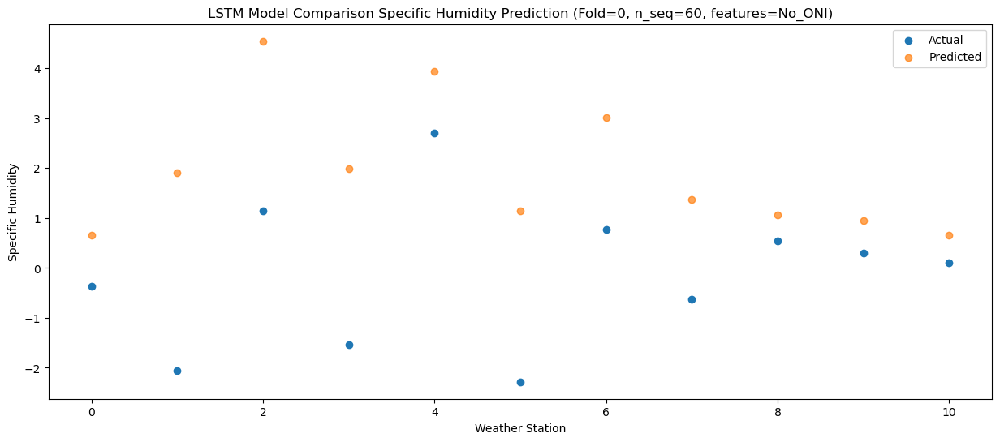

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -0.60   0.264983
1                 1   -1.71   1.514983
2                 2    1.52   4.154983
3                 3   -1.47   1.604983
4                 4    2.63   3.554983
5                 5   -2.89   0.754983
6                 6    0.62   2.624983
7                 7   -0.93   0.984983
8                 8    0.31   0.674983
9                 9   -0.03   0.564983
10               10   -0.27   0.264983


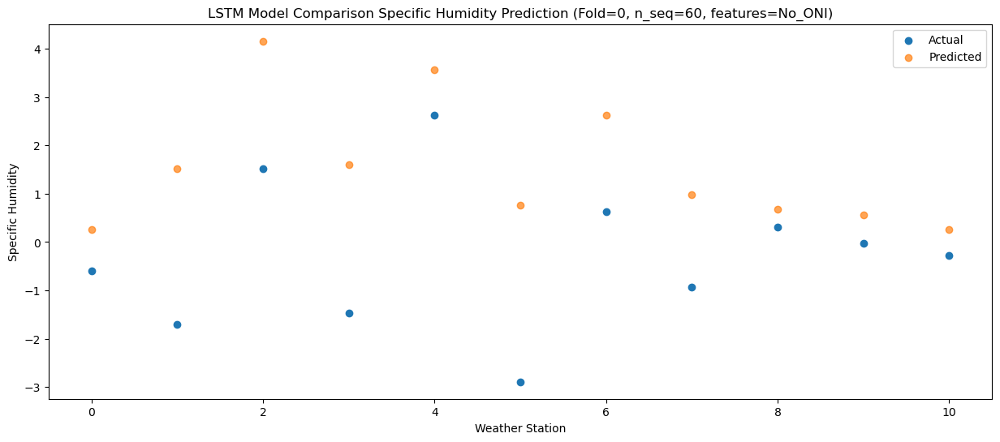

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -1.09    0.04934
1                 1   -1.00    1.29934
2                 2    1.67    3.93934
3                 3   -1.56    1.38934
4                 4    2.23    3.33934
5                 5   -2.30    0.53934
6                 6    0.67    2.40934
7                 7   -0.90    0.76934
8                 8   -0.37    0.45934
9                 9   -0.48    0.34934
10               10   -1.01    0.04934


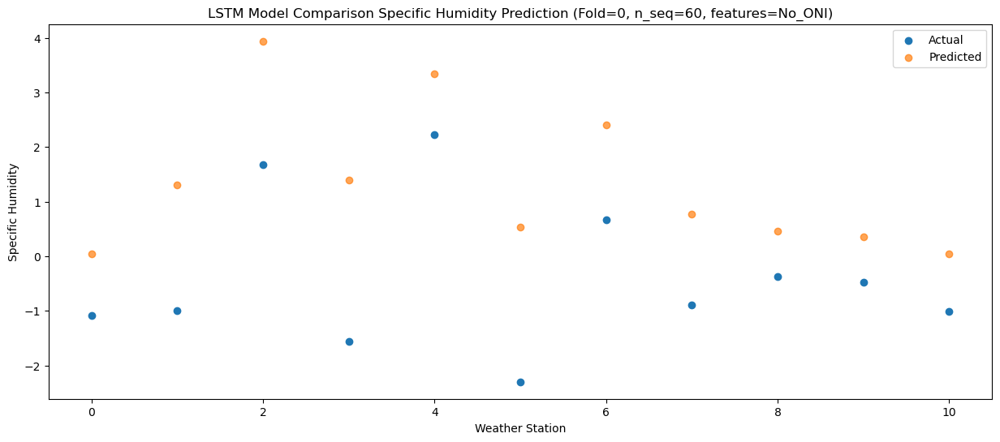

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    2.08   2.844394
1                 1    1.21   4.094394
2                 2    3.52   6.734394
3                 3    1.89   4.184394
4                 4    5.07   6.134394
5                 5   -0.73   3.334394
6                 6    2.26   5.204394
7                 7    0.72   3.564394
8                 8    2.69   3.254394
9                 9    1.32   3.144394
10               10    0.61   2.844394


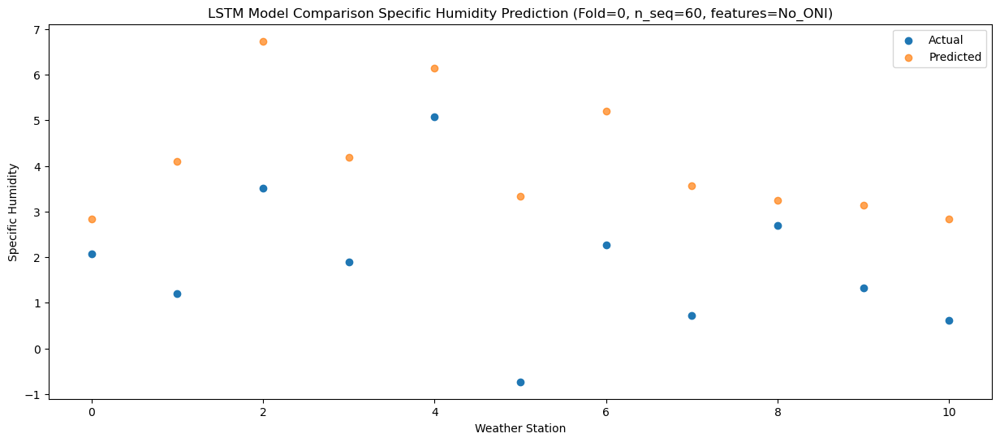

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    2.47   3.478846
1                 1    1.43   4.728846
2                 2    3.76   7.368846
3                 3    2.46   4.818846
4                 4    6.47   6.768846
5                 5    0.28   3.968846
6                 6    2.86   5.838846
7                 7    1.42   4.198846
8                 8    3.42   3.888846
9                 9    2.64   3.778846
10               10    2.21   3.478846


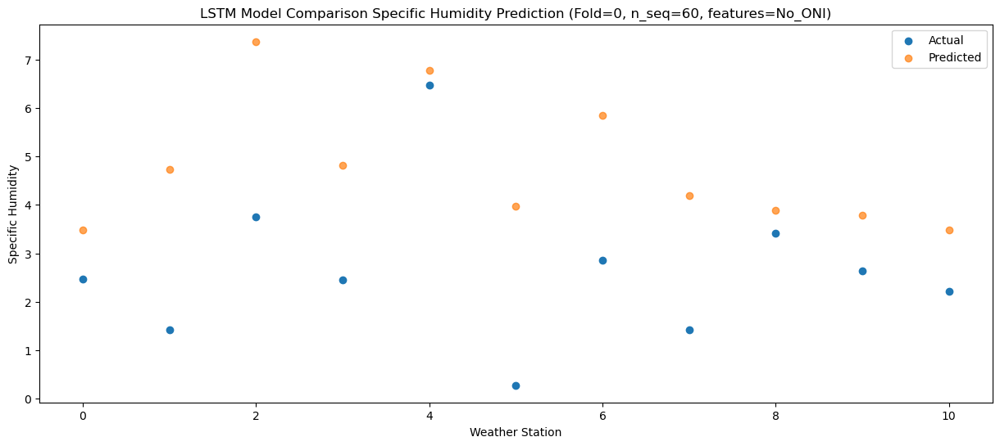

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    5.62   6.823536
1                 1    3.92   8.073536
2                 2    6.52  10.713536
3                 3    5.97   8.163536
4                 4   10.48  10.113536
5                 5    2.78   7.313536
6                 6    5.86   9.183536
7                 7    4.44   7.543536
8                 8    6.33   7.233536
9                 9    4.73   7.123536
10               10    3.73   6.823536


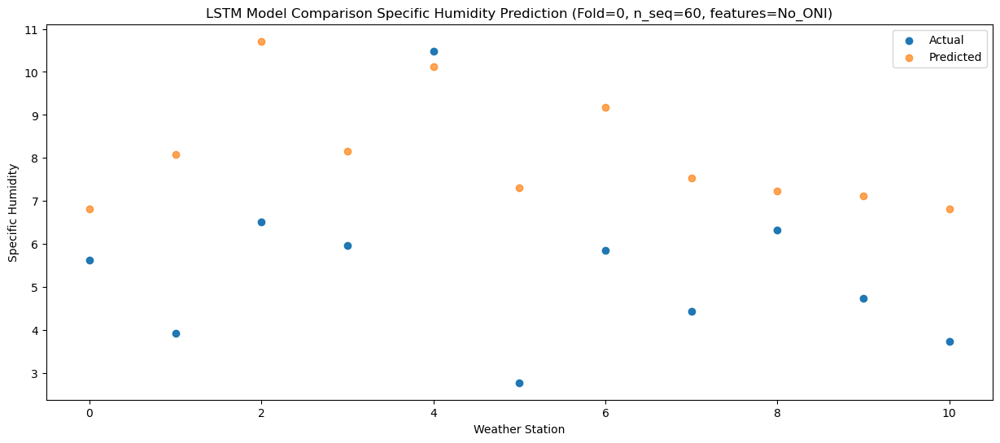

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   10.43  10.428091
1                 1    8.67  11.678091
2                 2   11.14  14.318091
3                 3    9.87  11.768091
4                 4   14.17  13.718091
5                 5    8.04  10.918091
6                 6   10.24  12.788091
7                 7    8.71  11.148091
8                 8   11.31  10.838091
9                 9    9.50  10.728091
10               10    8.86  10.428091


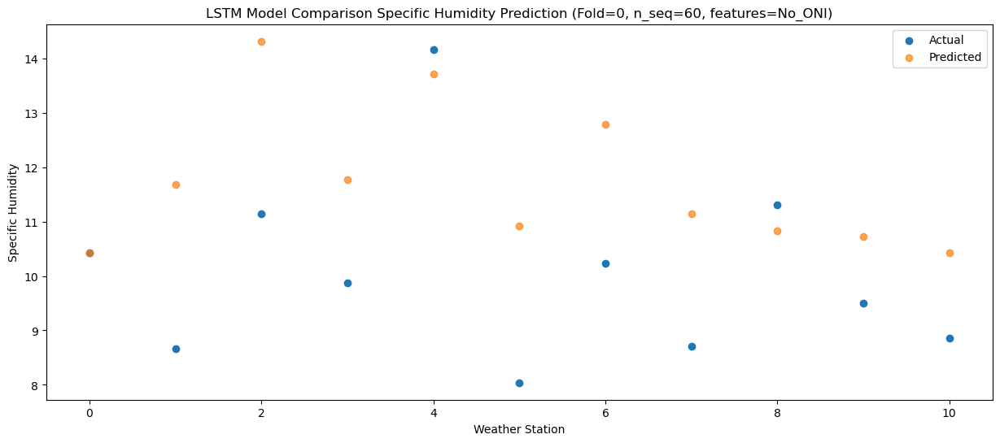

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   11.46  12.524752
1                 1    9.47  13.774752
2                 2   13.05  16.414752
3                 3   10.71  13.864752
4                 4   14.88  15.814752
5                 5    9.16  13.014752
6                 6   11.68  14.884752
7                 7   10.21  13.244752
8                 8   12.81  12.934752
9                 9   10.43  12.824752
10               10    9.93  12.524752


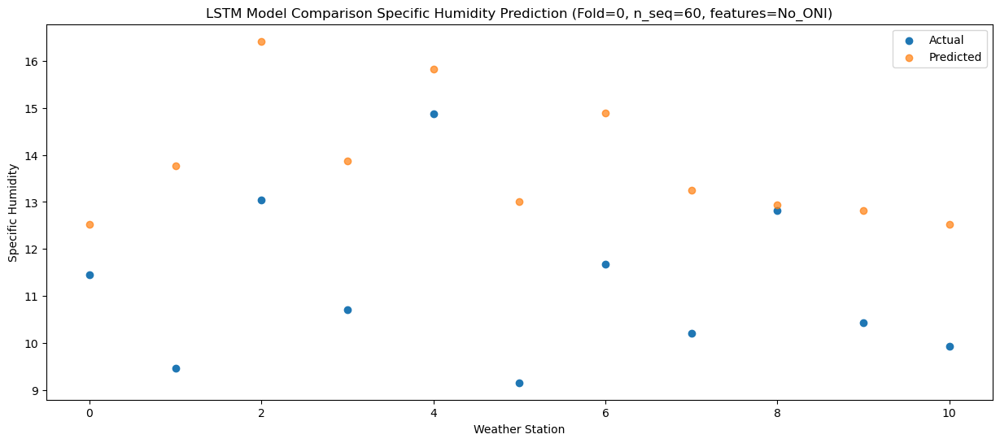

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   11.51  11.860014
1                 1    9.63  13.110014
2                 2   13.25  15.750014
3                 3   10.33  13.200014
4                 4   14.80  15.150014
5                 5   10.32  12.350014
6                 6   12.21  14.220014
7                 7   10.49  12.580014
8                 8   13.00  12.270014
9                 9   10.85  12.160014
10               10   10.42  11.860014


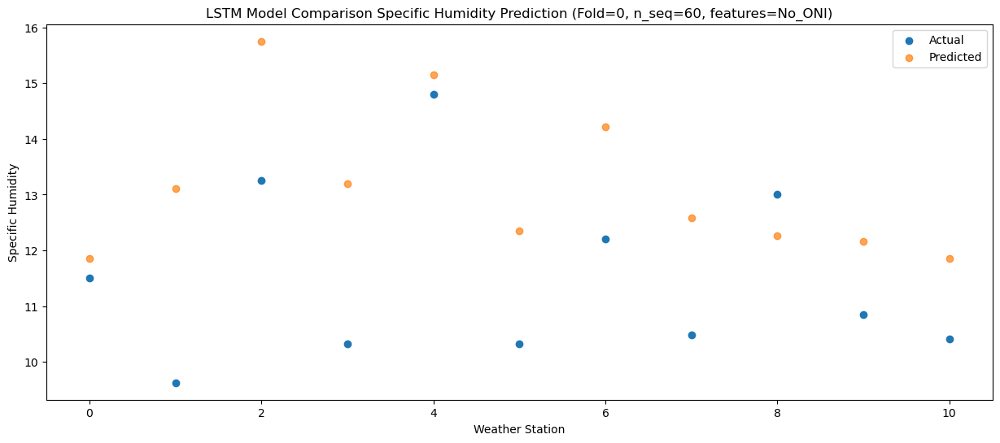

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    8.09   8.827029
1                 1    7.47  10.077029
2                 2   10.25  12.717029
3                 3    8.02  10.167029
4                 4   10.57  12.117029
5                 5    6.23   9.317029
6                 6    8.89  11.187029
7                 7    7.00   9.547029
8                 8    9.19   9.237029
9                 9    7.68   9.127029
10               10    6.80   8.827029


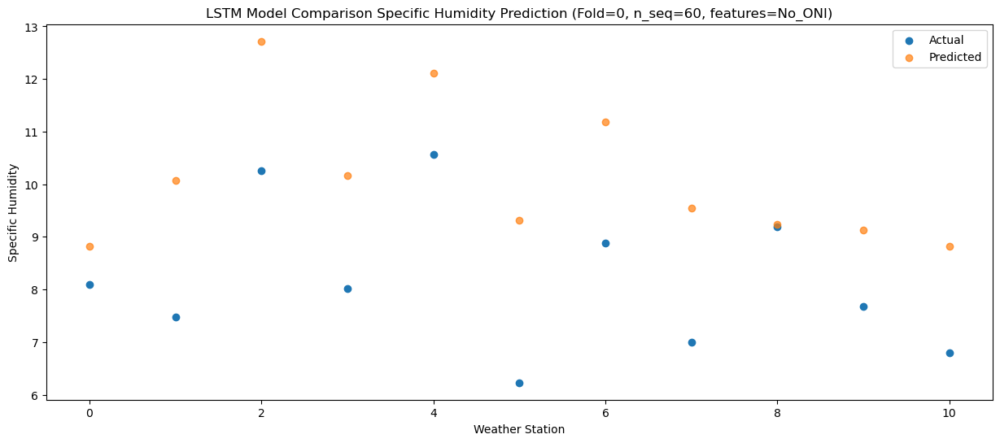

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    5.91   5.995758
1                 1    4.39   7.245758
2                 2    7.53   9.885758
3                 3    5.59   7.335758
4                 4    8.48   9.285758
5                 5    3.91   6.485758
6                 6    6.78   8.355758
7                 7    5.12   6.715758
8                 8    6.77   6.405758
9                 9    6.37   6.295758
10               10    5.81   5.995758


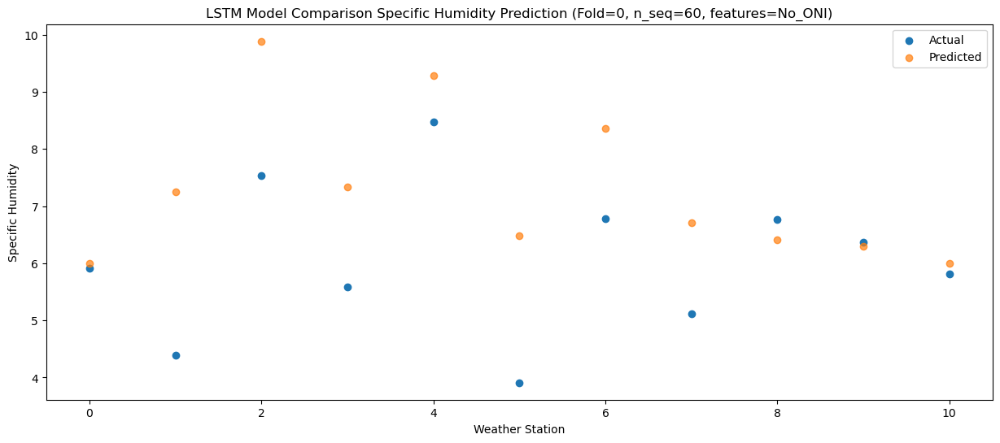

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    0.61   2.305551
1                 1   -1.27   3.555551
2                 2    1.66   6.195551
3                 3   -0.62   3.645551
4                 4    4.26   5.595551
5                 5   -1.35   2.795551
6                 6    1.03   4.665551
7                 7   -0.67   3.025551
8                 8    1.48   2.715551
9                 9    0.85   2.605551
10               10    0.96   2.305551


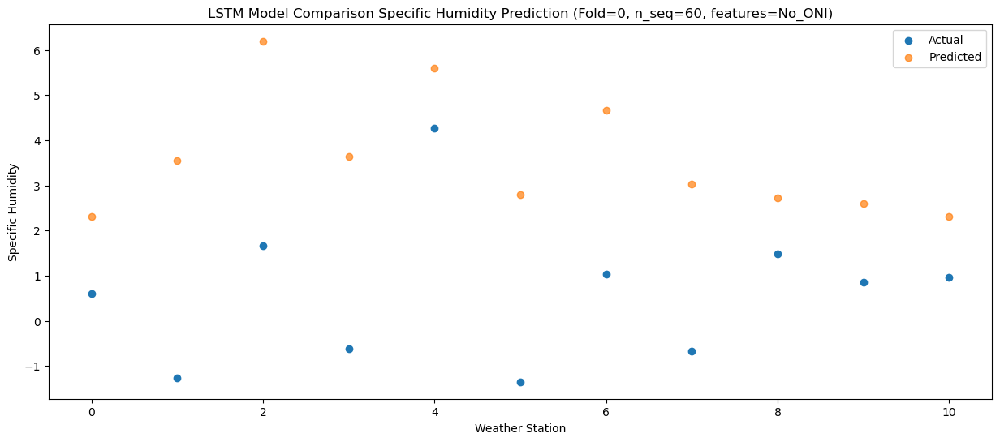

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    3.39    3.02271
1                 1    2.37    4.27271
2                 2    4.06    6.91271
3                 3    2.43    4.36271
4                 4    7.02    6.31271
5                 5    0.07    3.51271
6                 6    2.87    5.38271
7                 7    1.10    3.74271
8                 8    3.07    3.43271
9                 9    1.69    3.32271
10               10    0.96    3.02271


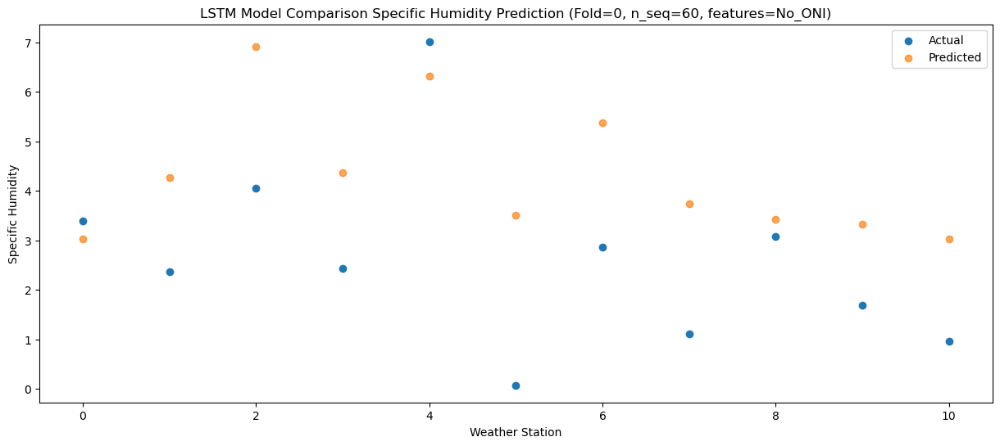

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -1.42   0.046968
1                 1   -2.39   1.296968
2                 2    0.65   3.936968
3                 3   -2.69   1.386968
4                 4    1.52   3.336968
5                 5   -3.04   0.536968
6                 6    0.09   2.406968
7                 7   -1.41   0.766968
8                 8   -0.21   0.456968
9                 9   -0.60   0.346968
10               10   -1.11   0.046968


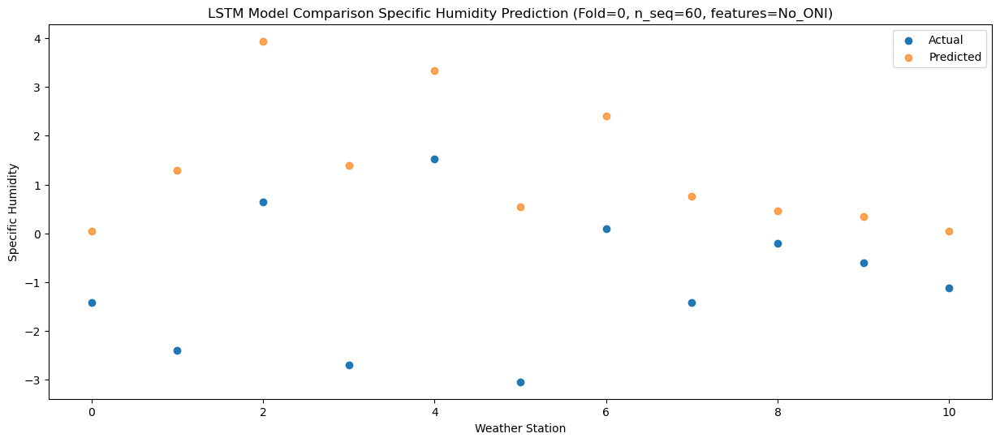

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -0.76   0.869915
1                 1   -1.17   2.119915
2                 2    1.86   4.759915
3                 3   -1.48   2.209915
4                 4    1.78   4.159915
5                 5   -1.66   1.359915
6                 6    1.37   3.229915
7                 7   -0.18   1.589915
8                 8    0.38   1.279915
9                 9    0.14   1.169915
10               10   -0.51   0.869915


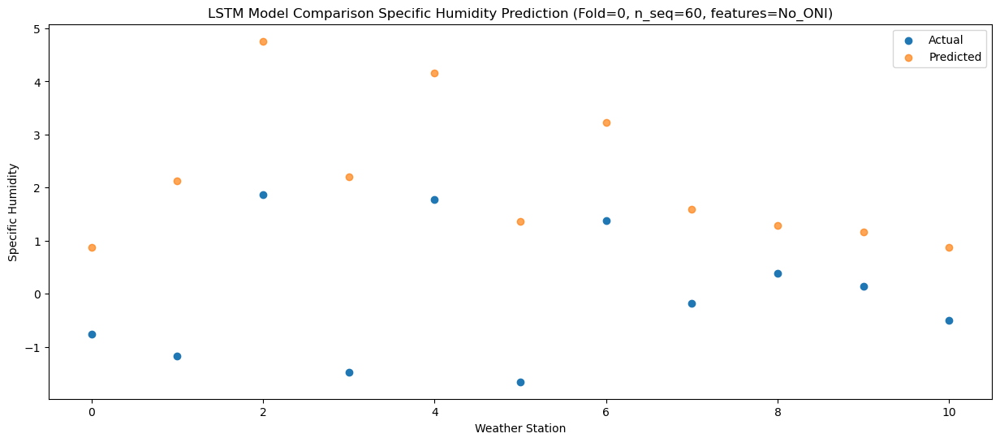

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    0.64   2.401117
1                 1    0.74   3.651117
2                 2    2.57   6.291117
3                 3   -0.39   3.741117
4                 4    3.33   5.691117
5                 5   -0.33   2.891117
6                 6    2.38   4.761117
7                 7    0.81   3.121117
8                 8    2.06   2.811117
9                 9    1.42   2.701117
10               10    0.74   2.401117


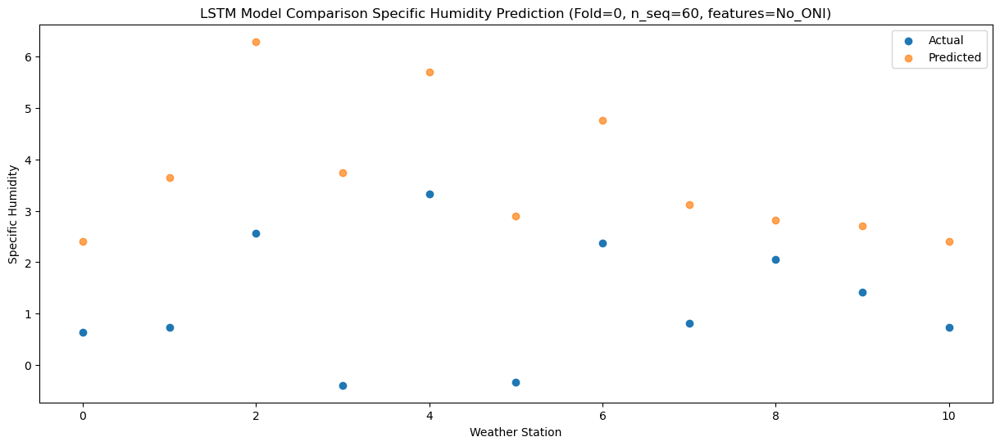

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    3.11   5.327388
1                 1    2.04   6.577388
2                 2    4.02   9.217388
3                 3    2.53   6.667388
4                 4    7.25   8.617388
5                 5    0.80   5.817388
6                 6    3.38   7.687388
7                 7    1.71   6.047388
8                 8    3.64   5.737388
9                 9    3.04   5.627388
10               10    1.68   5.327388


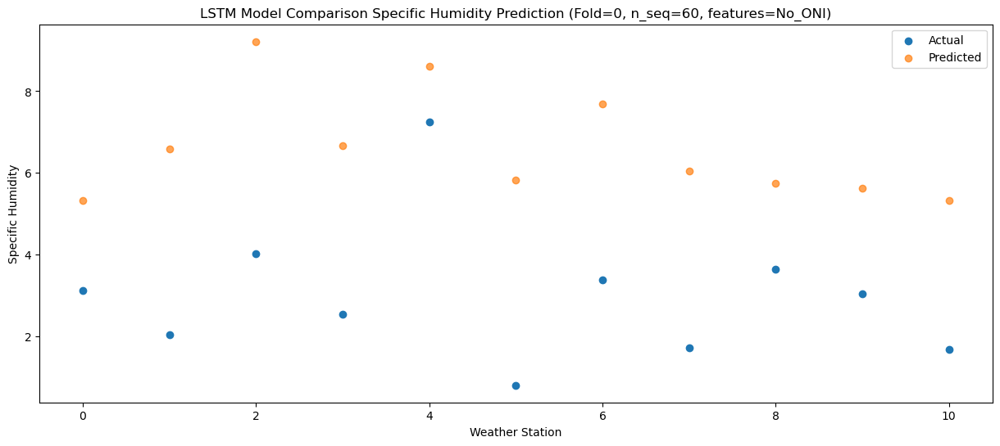

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    7.88    9.56163
1                 1    6.28   10.81163
2                 2    8.16   13.45163
3                 3    6.77   10.90163
4                 4   10.95   12.85163
5                 5    5.58   10.05163
6                 6    7.74   11.92163
7                 7    6.00   10.28163
8                 8    7.83    9.97163
9                 9    7.65    9.86163
10               10    5.40    9.56163


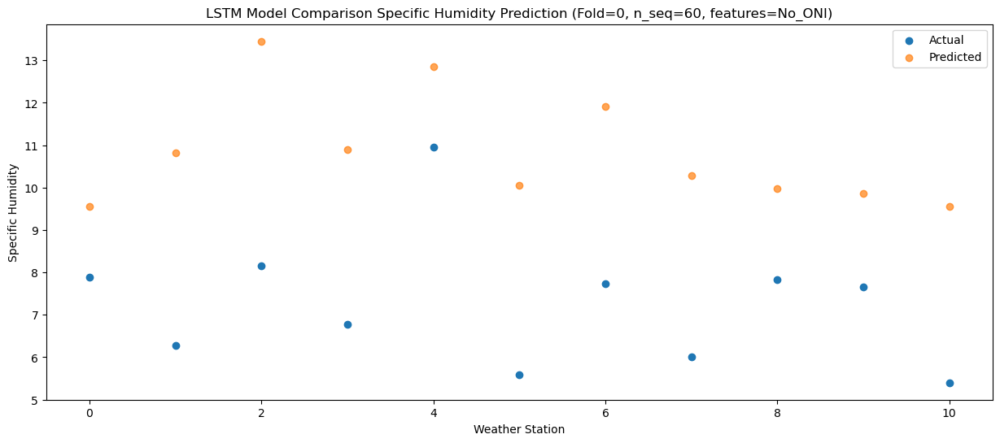

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   10.80  11.227005
1                 1    8.89  12.477005
2                 2   10.94  15.117005
3                 3    8.78  12.567005
4                 4   11.92  14.517005
5                 5    6.67  11.717005
6                 6    9.62  13.587005
7                 7    7.45  11.947005
8                 8   10.01  11.637005
9                 9    9.33  11.527005
10               10    6.67  11.227005


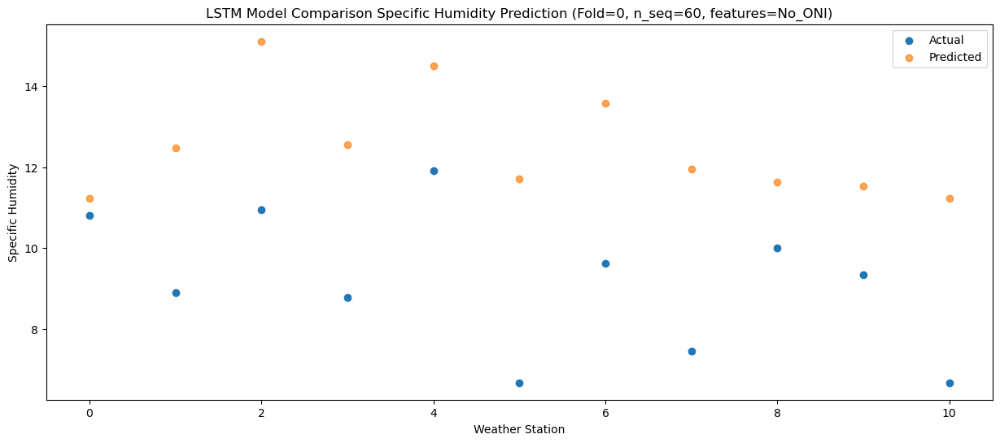

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   12.38  11.692703
1                 1    9.79  12.942703
2                 2   13.14  15.582703
3                 3    9.99  13.032703
4                 4   11.68  14.982703
5                 5   11.00  12.182703
6                 6   13.24  14.052703
7                 7   10.82  12.412703
8                 8   13.67  12.102703
9                 9   12.91  11.992703
10               10    9.16  11.692703


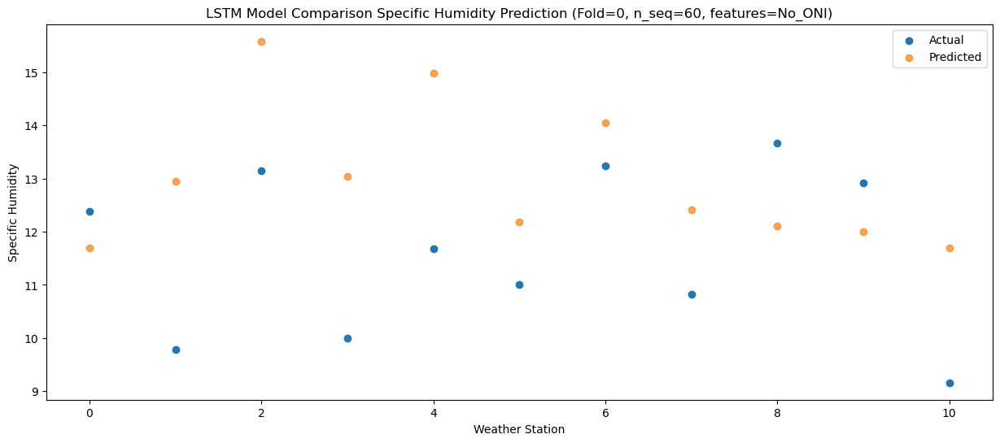

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   11.96  12.006363
1                 1    9.22  13.256363
2                 2   12.44  15.896363
3                 3    9.27  13.346363
4                 4   12.77  15.296363
5                 5    9.21  12.496363
6                 6   11.89  14.366363
7                 7    9.75  12.726363
8                 8   12.70  12.416363
9                 9   11.37  12.306363
10               10   10.15  12.006363


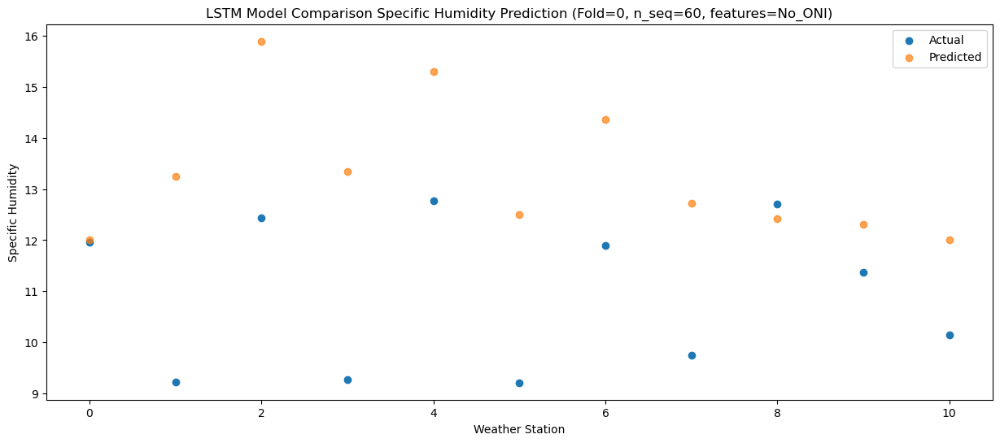

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    7.41   8.388708
1                 1    6.16   9.638708
2                 2    8.71  12.278708
3                 3    5.89   9.728708
4                 4    9.94  11.678708
5                 5    6.51   8.878708
6                 6    8.45  10.748708
7                 7    6.96   9.108708
8                 8    8.25   8.798708
9                 9    8.31   8.688708
10               10    7.55   8.388708


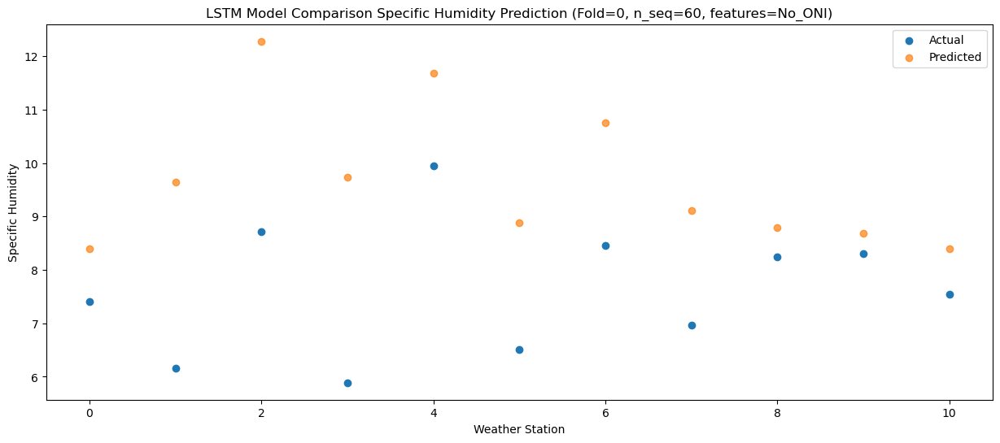

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    2.13   4.692481
1                 1    1.02   5.942481
2                 2    3.71   8.582481
3                 3    0.79   6.032481
4                 4    5.14   7.982481
5                 5    1.87   5.182481
6                 6    3.89   7.052481
7                 7    2.54   5.412481
8                 8    3.02   5.102481
9                 9    2.52   4.992481
10               10    2.53   4.692481


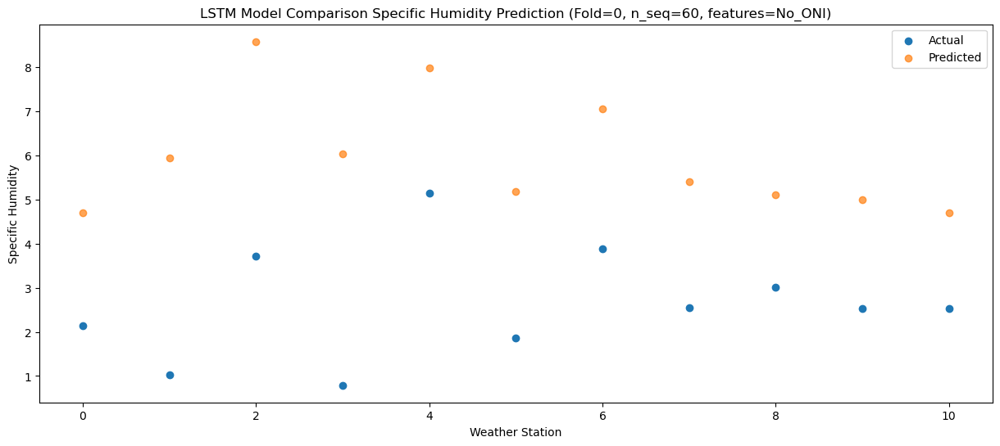

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    1.59   4.432092
1                 1    0.82   5.682092
2                 2    3.39   8.322092
3                 3    0.27   5.772092
4                 4    5.13   7.722092
5                 5    1.21   4.922092
6                 6    3.29   6.792092
7                 7    1.84   5.152092
8                 8    2.02   4.842092
9                 9    1.80   4.732092
10               10    1.39   4.432092


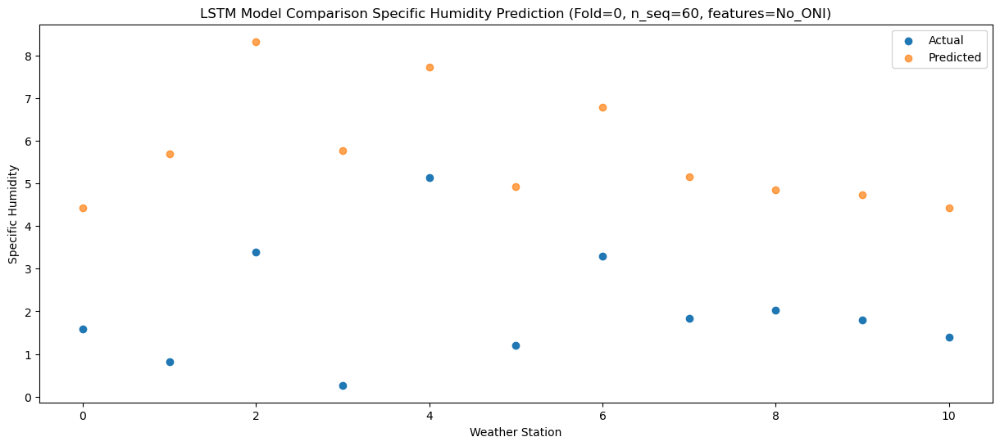

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0    1.13   3.593704
1                 1   -0.38   4.843704
2                 2    2.06   7.483704
3                 3   -0.23   4.933704
4                 4    4.05   6.883704
5                 5   -2.14   4.083704
6                 6    1.11   5.953704
7                 7   -0.50   4.313704
8                 8    1.09   4.003704
9                 9    0.87   3.893704
10               10    0.22   3.593704


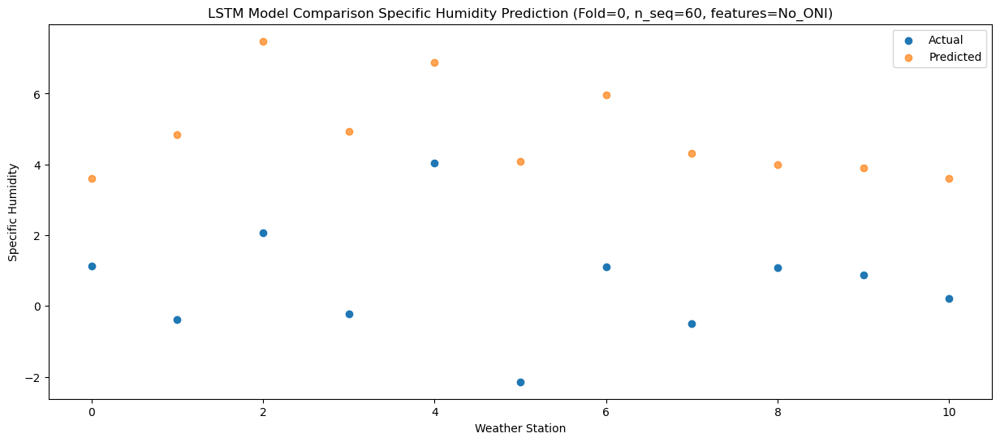

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    0.73   3.762125
1                 1   -0.29   5.012125
2                 2    2.43   7.652125
3                 3   -0.04   5.102125
4                 4    3.29   7.052125
5                 5   -1.39   4.252125
6                 6    1.97   6.122125
7                 7    0.43   4.482125
8                 8    1.69   4.172125
9                 9    1.48   4.062125
10               10    0.62   3.762125


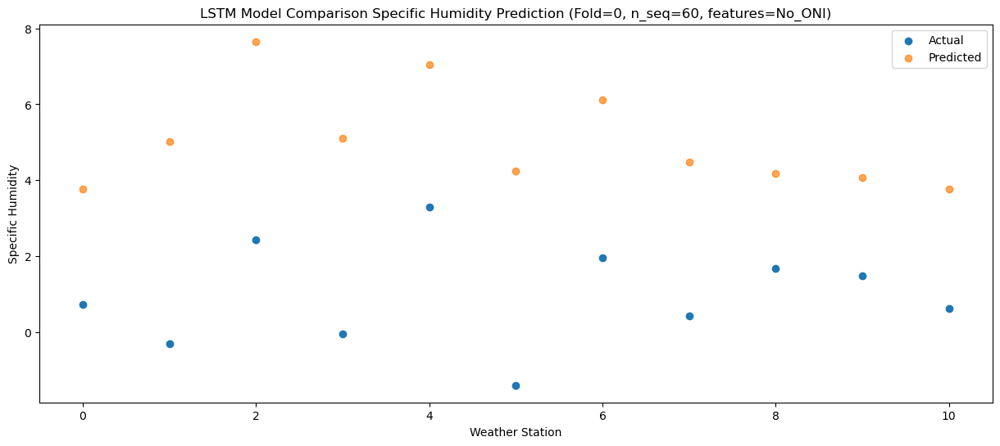

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    1.35   4.309516
1                 1    1.40   5.559516
2                 2    3.54   8.199516
3                 3    0.63   5.649516
4                 4    3.63   7.599516
5                 5   -0.46   4.799516
6                 6    2.65   6.669516
7                 7    0.79   5.029516
8                 8    1.76   4.719516
9                 9    1.25   4.609516
10               10    0.06   4.309516


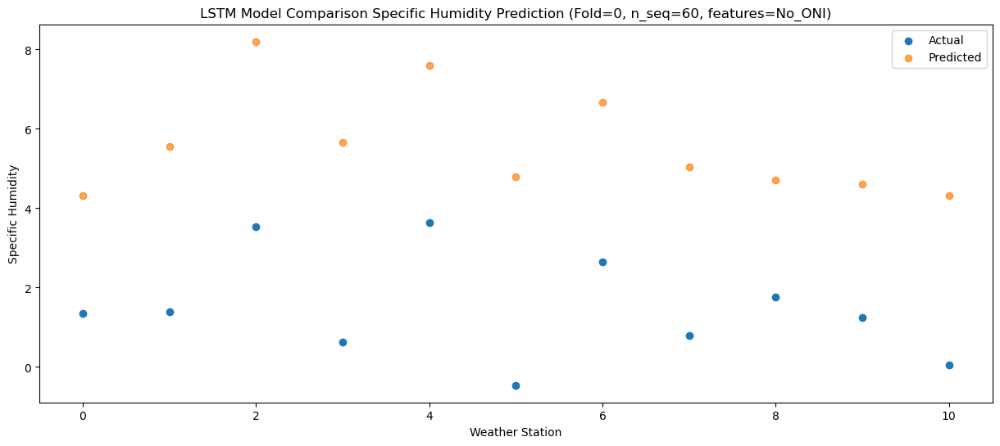

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    1.95   5.328712
1                 1    1.78   6.578712
2                 2    2.90   9.218712
3                 3    1.71   6.668712
4                 4    5.82   8.618712
5                 5   -0.68   5.818712
6                 6    2.24   7.688712
7                 7    0.71   6.048712
8                 8    2.20   5.738712
9                 9    1.35   5.628712
10               10    0.52   5.328712


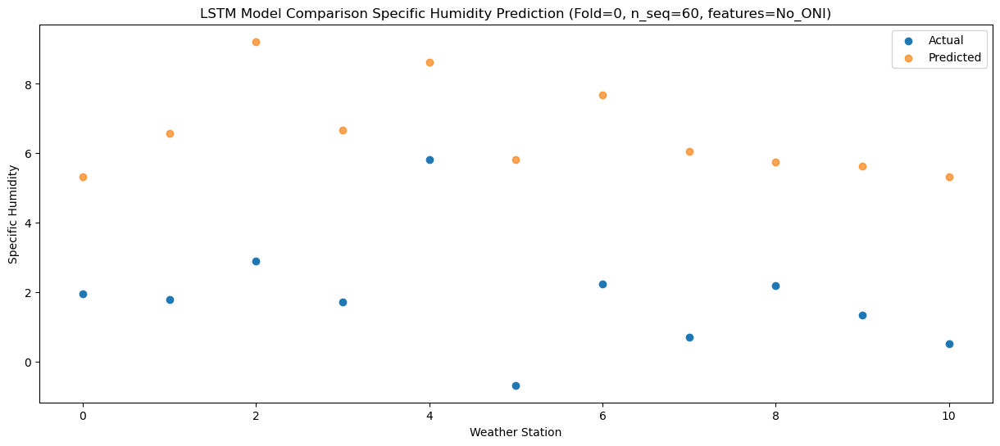

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    2.94   6.245689
1                 1    2.57   7.495689
2                 2    4.34  10.135689
3                 3    2.11   7.585689
4                 4    6.58   9.535689
5                 5    2.00   6.735689
6                 6    4.45   8.605689
7                 7    2.99   6.965689
8                 8    3.42   6.655689
9                 9    3.08   6.545689
10               10    2.16   6.245689


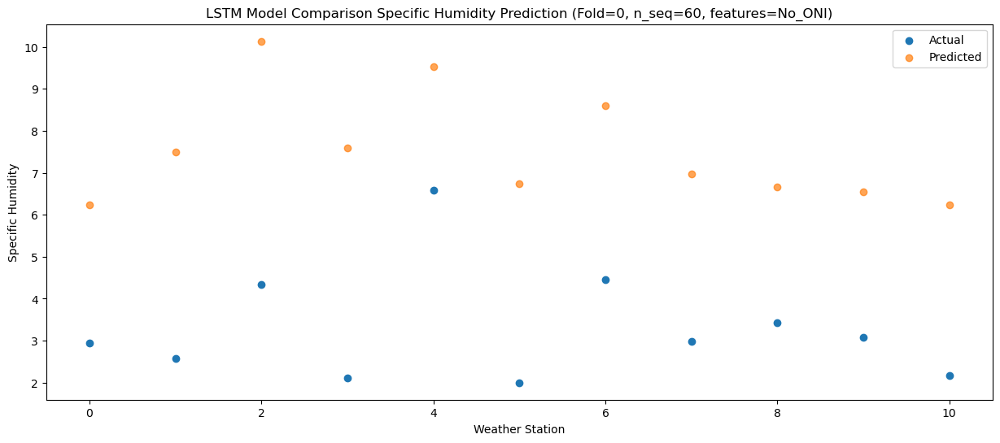

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    6.62   8.618558
1                 1    4.76   9.868558
2                 2    7.12  12.508558
3                 3    4.96   9.958558
4                 4   10.52  11.908558
5                 5    2.76   9.108558
6                 6    6.04  10.978558
7                 7    4.31   9.338558
8                 8    6.91   9.028558
9                 9    5.52   8.918558
10               10    3.37   8.618558


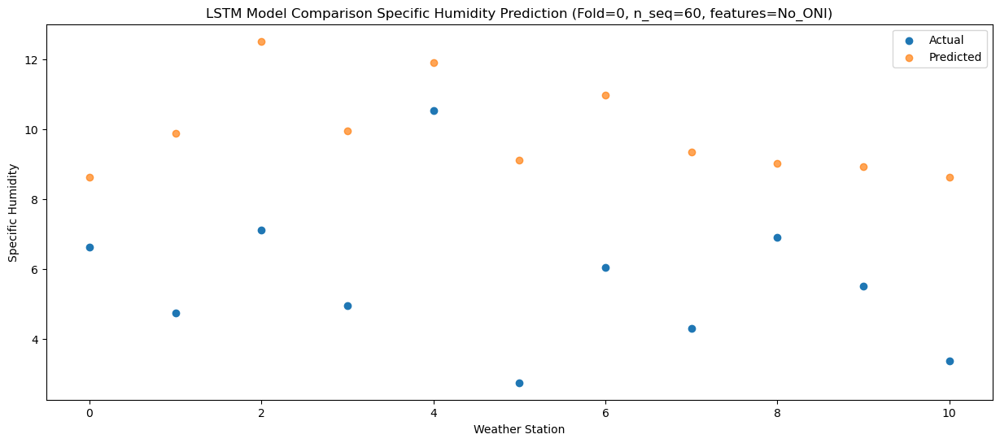

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   10.41  12.292334
1                 1    8.09  13.542334
2                 2    9.70  16.182334
3                 3    9.11  13.632334
4                 4   14.64  15.582334
5                 5    6.66  12.782334
6                 6    8.77  14.652334
7                 7    6.93  13.012334
8                 8    9.19  12.702334
9                 9    8.14  12.592334
10               10    6.38  12.292334


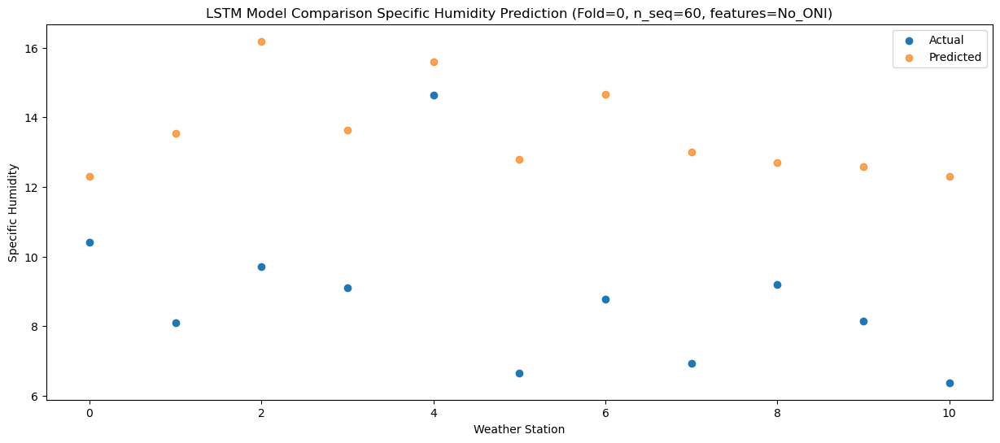

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   12.70  12.223388
1                 1    9.76  13.473388
2                 2   12.56  16.113388
3                 3   10.14  13.563388
4                 4   13.22  15.513388
5                 5   11.01  12.713388
6                 6   12.51  14.583388
7                 7   11.28  12.943388
8                 8   12.74  12.633388
9                 9   11.96  12.523388
10               10   10.21  12.223388


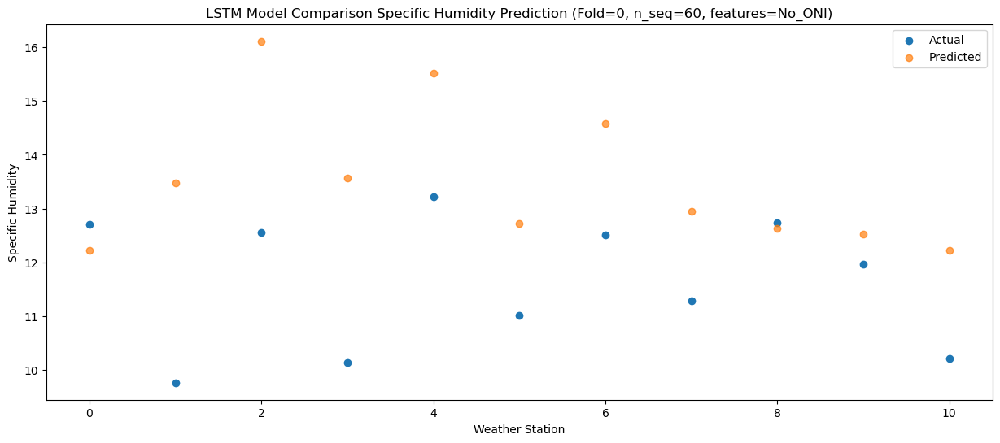

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   12.32  10.277214
1                 1   10.54  11.527214
2                 2   12.65  14.167214
3                 3    9.89  11.617214
4                 4   11.40  13.567214
5                 5   10.12  10.767214
6                 6   12.14  12.637214
7                 7   10.22  10.997214
8                 8   12.74  10.687214
9                 9   10.66  10.577214
10               10    9.46  10.277214


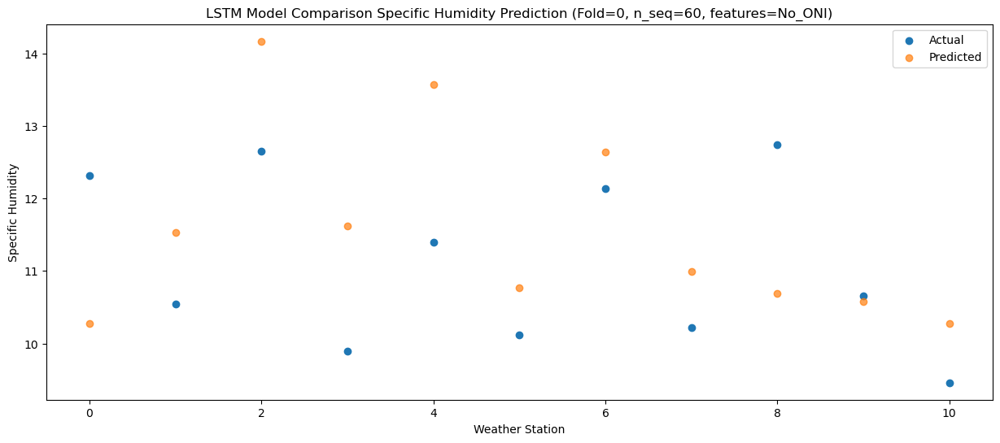

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    8.35  10.581607
1                 1    6.52  11.831607
2                 2    9.07  14.471607
3                 3    7.71  11.921607
4                 4   11.36  13.871607
5                 5    7.00  11.071607
6                 6    9.20  12.941607
7                 7    7.42  11.301607
8                 8    8.67  10.991607
9                 9    7.94  10.881607
10               10    8.15  10.581607


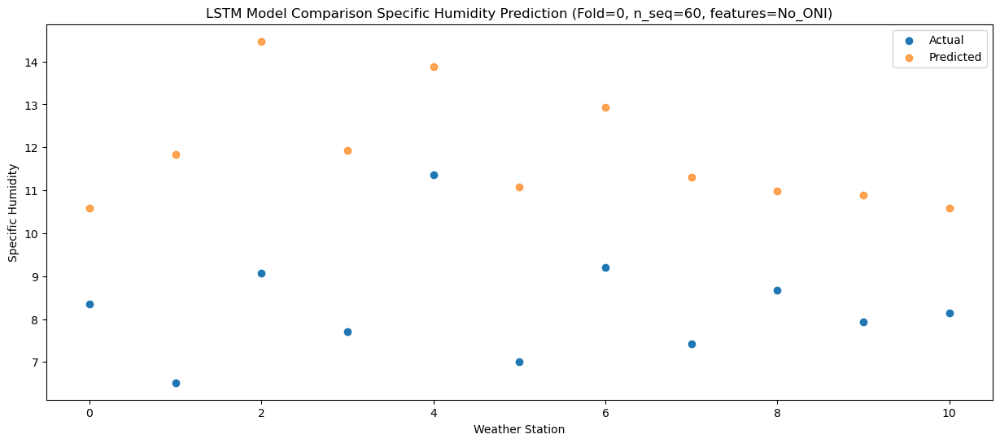

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    4.32   6.616765
1                 1    1.82   7.866765
2                 2    5.16  10.506765
3                 3    3.14   7.956765
4                 4    7.61   9.906765
5                 5    2.60   7.106765
6                 6    4.94   8.976765
7                 7    3.67   7.336765
8                 8    4.61   7.026765
9                 9    4.70   6.916765
10               10    4.39   6.616765


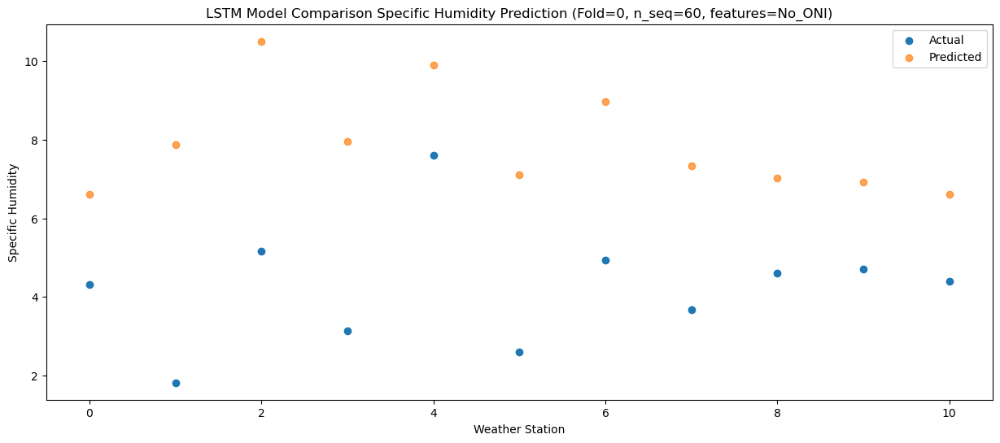

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    1.14   4.306633
1                 1   -0.36   5.556633
2                 2    2.63   8.196633
3                 3    0.15   5.646633
4                 4    4.81   7.596633
5                 5   -0.42   4.796633
6                 6    1.61   6.666633
7                 7    0.15   5.026633
8                 8    1.95   4.716633
9                 9    1.35   4.606633
10               10    0.98   4.306633


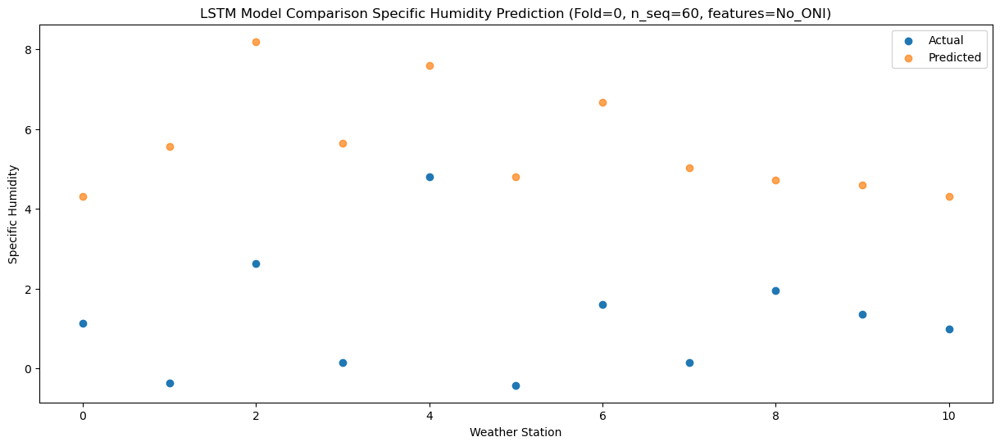

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -0.14   3.063916
1                 1   -1.80   4.313916
2                 2    1.82   6.953916
3                 3   -1.25   4.403916
4                 4    2.95   6.353916
5                 5   -1.24   3.553916
6                 6    1.54   5.423916
7                 7    0.35   3.783916
8                 8    1.34   3.473916
9                 9    1.54   3.363916
10               10    1.51   3.063916


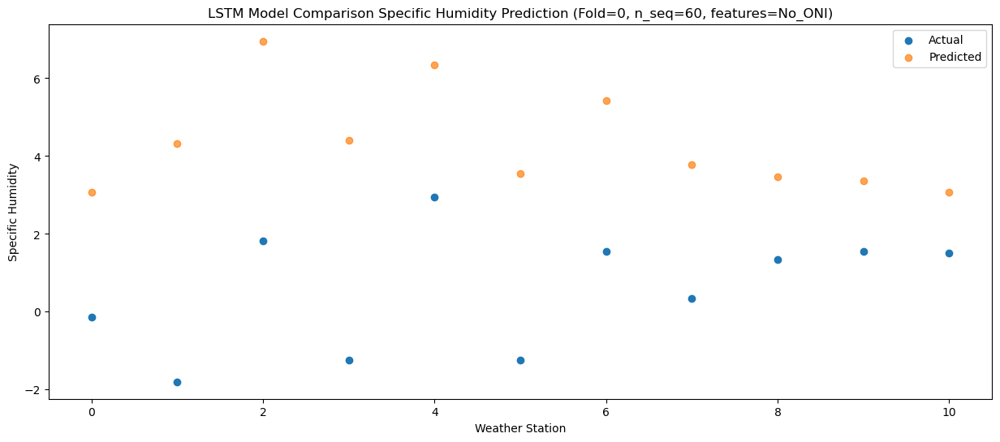

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -0.96   2.211926
1                 1   -2.58   3.461926
2                 2    1.02   6.101926
3                 3   -2.17   3.551926
4                 4    1.77   5.501926
5                 5   -2.03   2.701926
6                 6    0.87   4.571926
7                 7   -0.34   2.931926
8                 8    0.16   2.621926
9                 9    0.57   2.511926
10               10   -0.01   2.211926


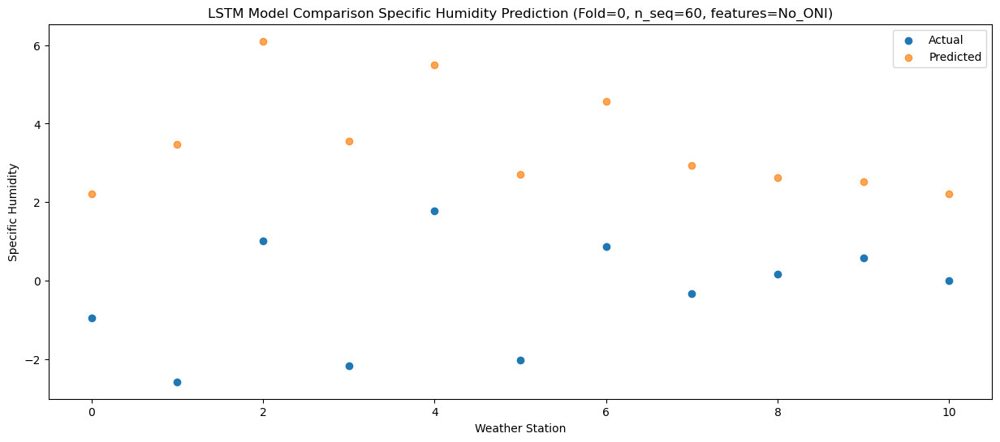

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    0.94   4.145218
1                 1   -1.36   5.395218
2                 2    1.66   8.035218
3                 3   -0.39   5.485218
4                 4    4.34   7.435218
5                 5   -2.13   4.635218
6                 6    1.03   6.505218
7                 7   -0.31   4.865218
8                 8    1.92   4.555218
9                 9    0.92   4.445218
10               10    0.52   4.145218


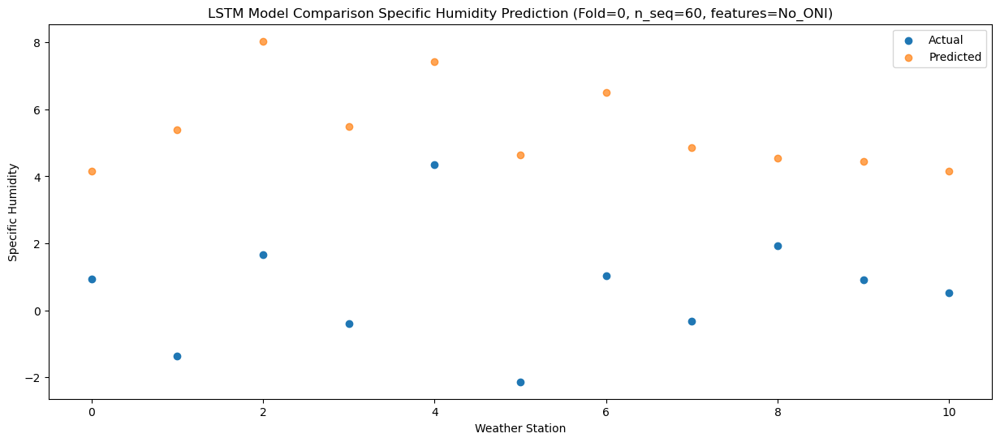

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    2.20   5.529935
1                 1    0.49   6.779935
2                 2    3.29   9.419935
3                 3    1.40   6.869935
4                 4    6.08   8.819935
5                 5   -0.21   6.019935
6                 6    2.48   7.889935
7                 7    0.83   6.249935
8                 8    2.79   5.939935
9                 9    2.05   5.829935
10               10    1.21   5.529935


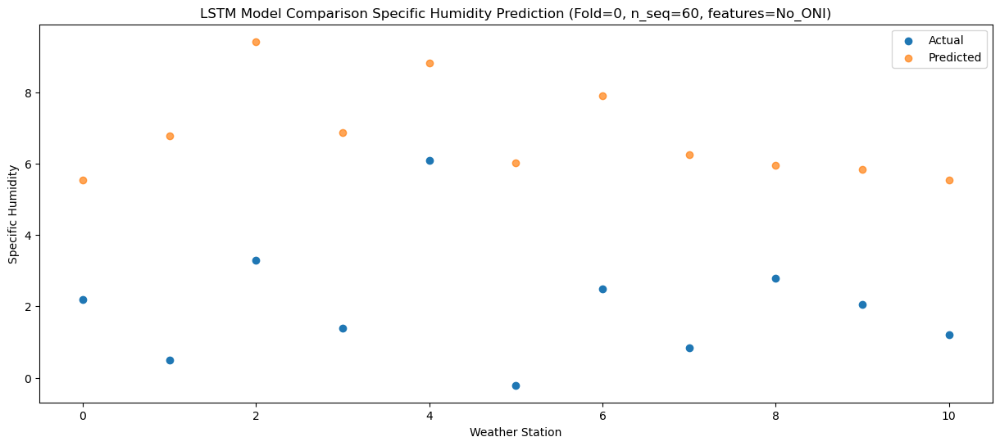

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    4.51   8.214013
1                 1    2.40   9.464013
2                 2    5.03  12.104013
3                 3    3.45   9.554013
4                 4    8.32  11.504013
5                 5    1.13   8.704013
6                 6    4.54  10.574013
7                 7    2.85   8.934013
8                 8    5.02   8.624013
9                 9    4.42   8.514013
10               10    2.77   8.214013


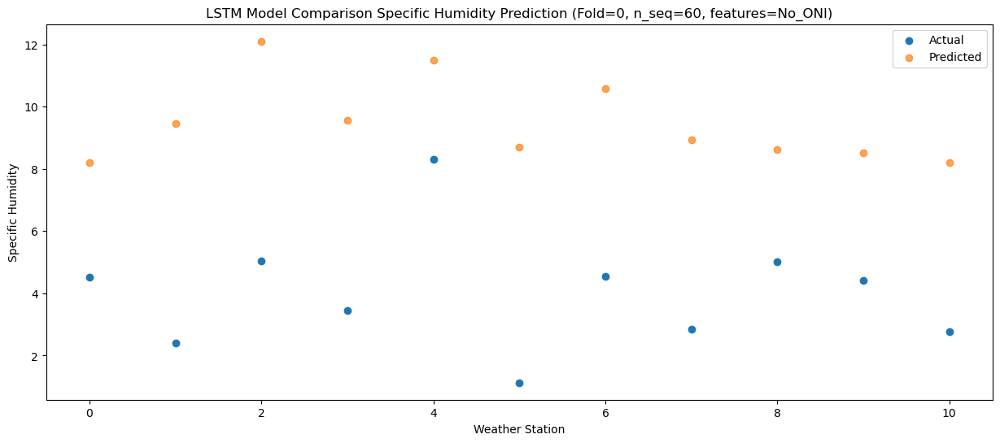

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    8.98   11.81415
1                 1    6.98   13.06415
2                 2    8.78   15.70415
3                 3    8.02   13.15415
4                 4   12.57   15.10415
5                 5    5.19   12.30415
6                 6    8.45   14.17415
7                 7    6.67   12.53415
8                 8    9.30   12.22415
9                 9    8.22   12.11415
10               10    5.82   11.81415


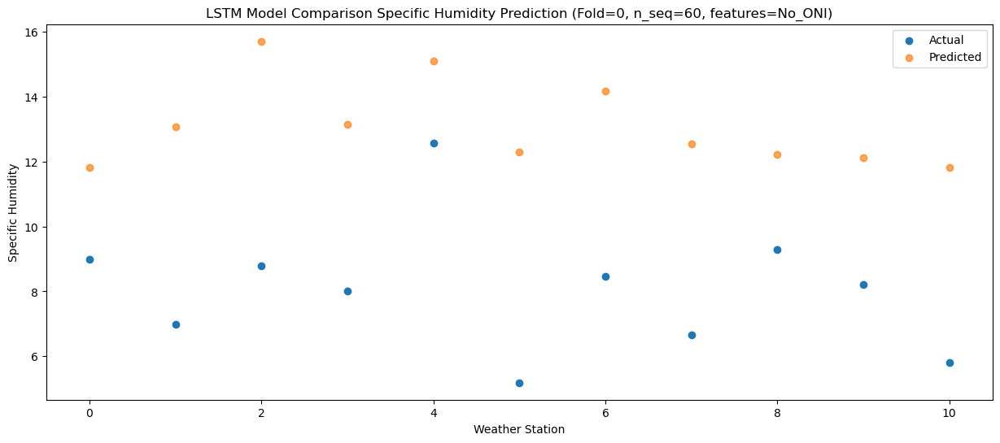

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   10.37   13.81636
1                 1    8.58   15.06636
2                 2    9.91   17.70636
3                 3    9.53   15.15636
4                 4   14.22   17.10636
5                 5    7.16   14.30636
6                 6   10.27   16.17636
7                 7    8.36   14.53636
8                 8   11.72   14.22636
9                 9    9.29   14.11636
10               10    8.32   13.81636


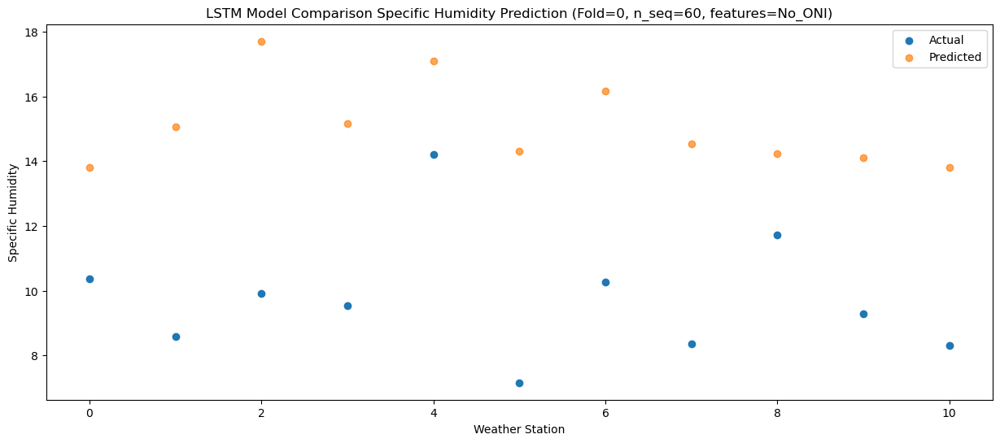

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   11.66  13.726105
1                 1   10.75  14.976105
2                 2   13.14  17.616105
3                 3   10.93  15.066105
4                 4   13.96  17.016105
5                 5    9.95  14.216105
6                 6   12.80  16.086105
7                 7   11.25  14.446105
8                 8   12.90  14.136105
9                 9   10.79  14.026105
10               10    9.39  13.726105


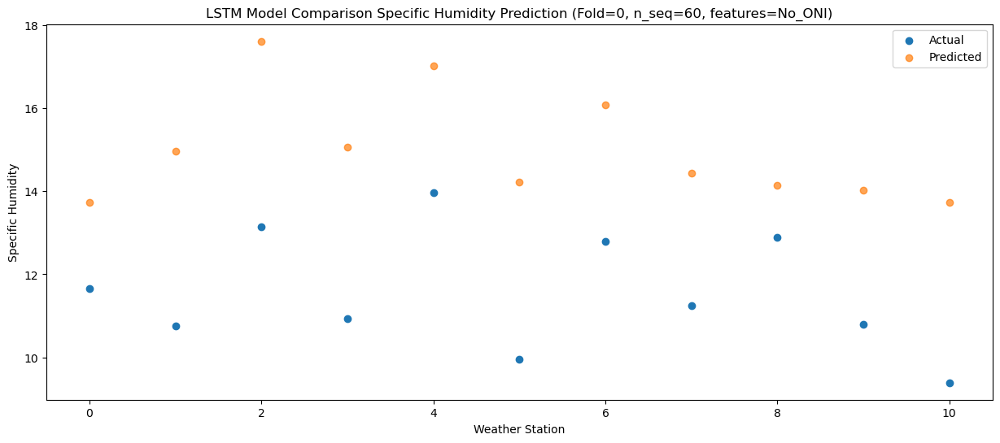

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0    9.83  13.317849
1                 1    9.25  14.567849
2                 2   11.45  17.207849
3                 3    9.79  14.657849
4                 4   13.61  16.607849
5                 5    8.94  13.807849
6                 6   11.64  15.677849
7                 7    9.82  14.037849
8                 8   11.23  13.727849
9                 9    9.99  13.617849
10               10    9.15  13.317849


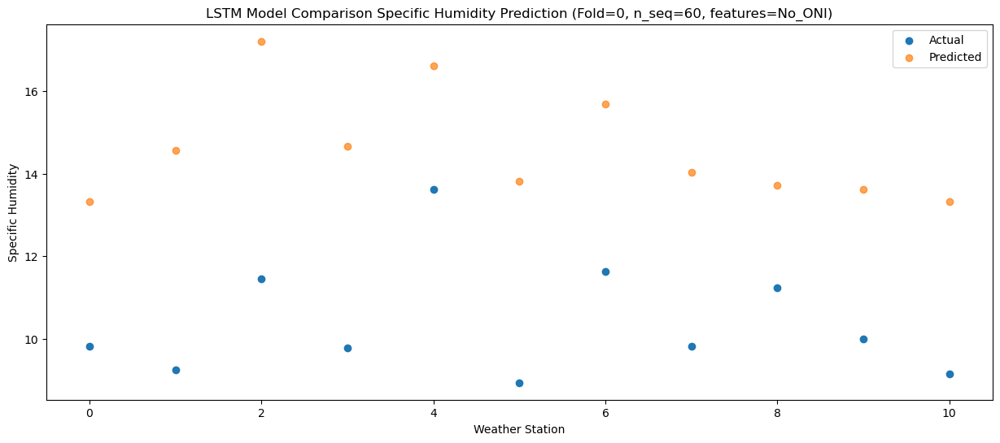

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    8.36  10.271339
1                 1    8.38  11.521339
2                 2    9.76  14.161339
3                 3    8.23  11.611339
4                 4   11.12  13.561339
5                 5    6.99  10.761339
6                 6    9.91  12.631339
7                 7    8.23  10.991339
8                 8    9.19  10.681339
9                 9    7.64  10.571339
10               10    7.44  10.271339


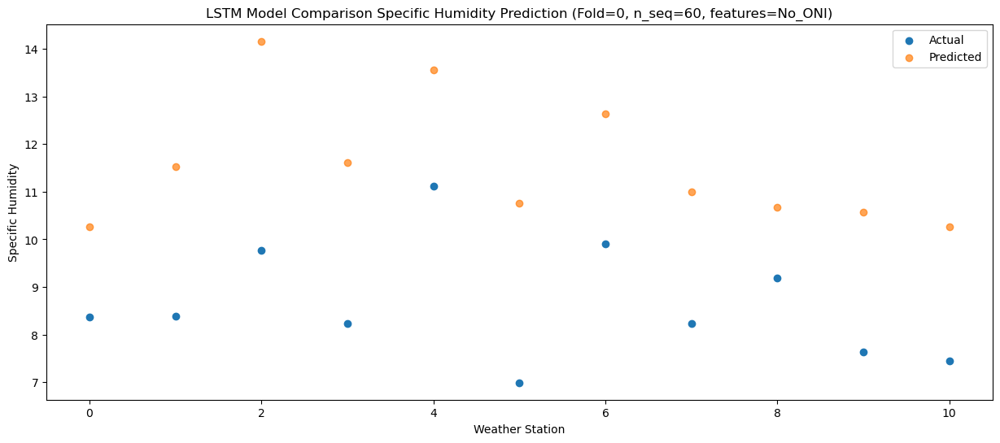

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    2.98    7.37086
1                 1    2.98    8.62086
2                 2    5.63   11.26086
3                 3    3.04    8.71086
4                 4    7.51   10.66086
5                 5    1.70    7.86086
6                 6    5.21    9.73086
7                 7    3.34    8.09086
8                 8    4.59    7.78086
9                 9    4.11    7.67086
10               10    3.24    7.37086


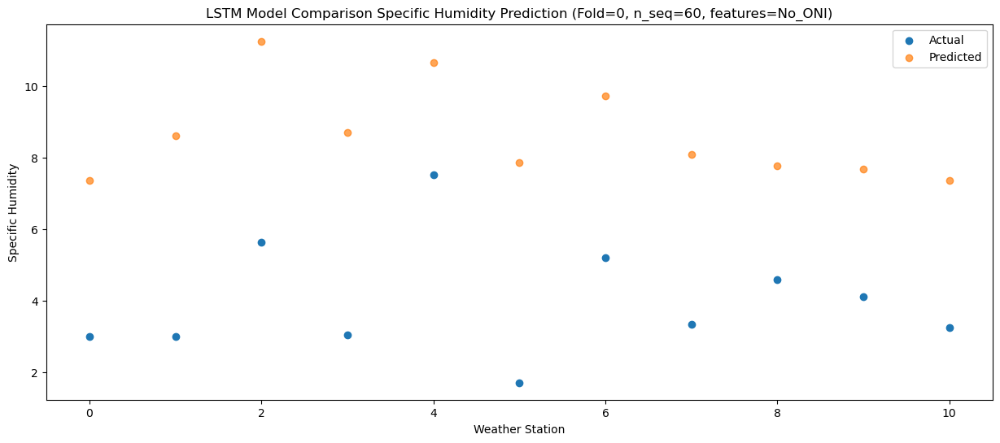

f, t:
[[ 3.000e-02 -8.600e-01  2.230e+00 -4.800e-01  4.290e+00 -8.100e-01
   1.380e+00 -5.000e-02  1.270e+00  7.800e-01  4.900e-01]
 [ 4.600e-01 -5.300e-01  2.480e+00  6.000e-02  3.040e+00 -8.500e-01
   1.500e+00  2.000e-01  1.360e+00  1.190e+00  6.100e-01]
 [ 3.700e-01 -9.700e-01  2.310e+00  3.000e-01  3.830e+00 -1.330e+00
   1.420e+00  2.300e-01  9.600e-01  6.900e-01  2.300e-01]
 [ 1.000e-02 -2.400e-01  2.860e+00  4.400e-01  3.220e+00 -1.440e+00
   1.780e+00  4.500e-01  9.500e-01  3.700e-01 -2.800e-01]
 [ 3.300e+00  3.640e+00  5.460e+00  4.750e+00  7.670e+00  3.200e-01
   3.410e+00  1.750e+00  3.210e+00  2.330e+00  1.320e+00]
 [ 2.950e+00  1.850e+00  4.210e+00  3.600e+00  7.390e+00  6.600e-01
   3.190e+00  1.690e+00  3.450e+00  2.390e+00  1.680e+00]
 [ 5.920e+00  4.170e+00  7.070e+00  5.750e+00  9.970e+00  3.790e+00
   6.290e+00  3.680e+00  6.670e+00  5.530e+00  4.580e+00]
 [ 9.680e+00  7.850e+00  1.098e+01  8.240e+00  1.233e+01  7.520e+00
   1.001e+01  8.350e+00  1.032e+01  8.220e+0

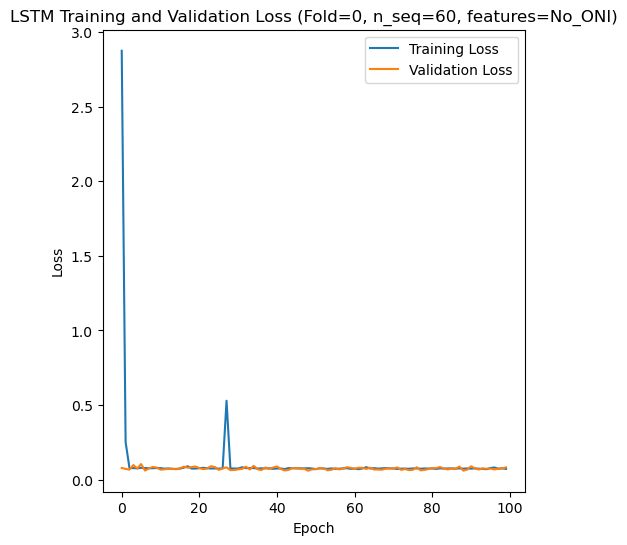

[[ 6.43  5.26  5.95 ... 15.04 10.09  9.76]
 [ 4.92  3.81  4.91 ... 12.52  8.69  7.9 ]
 [ 5.77  4.38  5.81 ... 14.28  9.78  9.52]
 ...
 [ 4.32  3.52  5.54 ... 12.    6.96  7.01]
 [ 3.07  3.12  5.08 ... 11.47  8.11  7.14]
 [ 2.37  2.06  3.5  ...  9.32  6.33  5.39]]
Epoch 1/100
84/84 [==============================] - 48s 235ms/step - loss: 2.3199 - accuracy: 0.2262 - mae: 2.2559 - rmse: 2.3199 - mape: 507.3626 - pearson: 0.5438 - val_loss: 0.0678 - val_accuracy: 0.0000e+00 - val_mae: 0.0530 - val_rmse: 0.0678 - val_mape: 11.5791 - val_pearson: 0.7692
Epoch 2/100
84/84 [==============================] - 13s 154ms/step - loss: 0.0718 - accuracy: 0.3810 - mae: 0.0567 - rmse: 0.0718 - mape: 12.7894 - pearson: 0.7493 - val_loss: 0.0698 - val_accuracy: 0.5000 - val_mae: 0.0545 - val_rmse: 0.0698 - val_mape: 12.3001 - val_pearson: 0.7333
Epoch 3/100
84/84 [==============================] - 13s 154ms/step - loss: 0.0745 - accuracy: 0.4405 - mae: 0.0586 - rmse: 0.0745 - mape: 13.4009 - pearson: 0

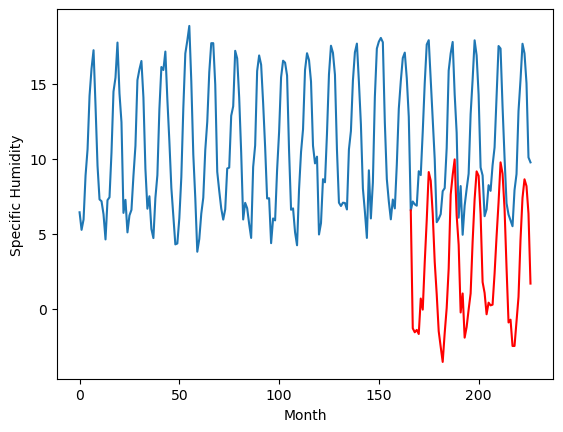

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.11		2.75		1.64
1.16		2.49		1.33
0.91		2.65		1.74
1.43		2.37		0.94
3.66		4.74		1.08
2.07		4.00		1.93
5.08		7.17		2.09
8.88		9.97		1.09
10.92		13.17		2.25
10.97		12.60		1.63
8.07		10.40		2.33
5.40		7.19		1.79
2.34		5.02		2.68
-0.25		2.56		2.81
-0.23		1.52		1.75
-0.04		0.51		0.55
1.49		2.43		0.94
1.85		4.11		2.26
4.77		6.75		1.98
8.75		11.67		2.92
10.62		12.98		2.36
10.83		14.02		3.19
7.88		10.29		2.41
5.84		8.32		2.48
0.25		3.81		3.56
2.42		5.08		2.66
-0.58		2.13		2.71
0.37		2.84		2.47
1.05		4.00		2.95
2.11		5.08		2.97
6.28		8.53		2.25
8.68		11.36		2.68
11.35		13.22		1.87
10.94		12.92		1.98
7.58		10.35		2.77
2.69		5.84		3.15
2.21		5.12		2.91
0.62		3.69		3.07
1.03		4.46		3.43
2.15		4.28		2.13
1.28		4.33		3.05
2.88		6.40		3.52
5.62		8.88		3.26
7.97		11.15		3.18
10.93		13.82		2.89
11.06		13.07		2.01
7.95		10.73		2.78
4.10		6.80		2.70
1.09		3.14		2.05
0.51		3.33		2.82
-0.26		1.57		1.83
0.08		1.57

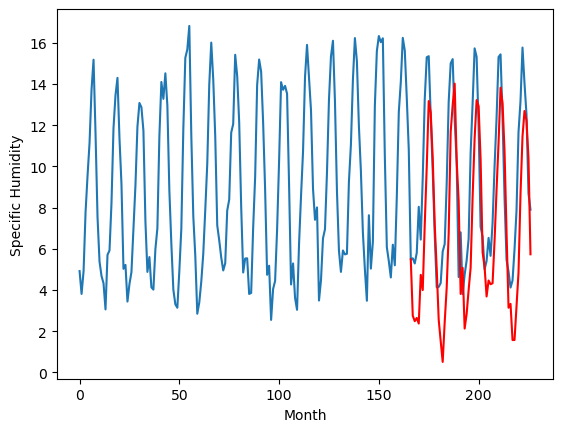

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.05		1.24		1.29
0.86		0.98		0.12
0.35		1.14		0.79
0.74		0.86		0.12
3.90		3.23		-0.67
2.28		2.49		0.21
5.05		5.66		0.61
8.90		8.46		-0.44
11.45		11.66		0.21
10.97		11.09		0.12
8.02		8.89		0.87
5.26		5.68		0.42
2.08		3.51		1.43
-0.69		1.05		1.74
-0.54		0.01		0.55
-0.54		-1.00		-0.46
2.08		0.92		-1.16
1.79		2.60		0.81
4.63		5.24		0.61
9.15		10.16		1.01
10.74		11.47		0.73
10.96		12.51		1.55
8.20		8.78		0.58
5.45		6.81		1.36
-0.05		2.30		2.35
2.59		3.57		0.98
-1.29		0.62		1.91
-0.26		1.33		1.59
0.53		2.49		1.96
2.29		3.57		1.28
6.65		7.02		0.37
9.74		9.85		0.11
11.37		11.71		0.34
10.50		11.41		0.91
6.99		8.84		1.85
1.88		4.33		2.45
1.51		3.61		2.10
0.82		2.18		1.36
0.79		2.95		2.16
1.84		2.77		0.93
1.37		2.82		1.45
2.73		4.89		2.16
6.03		7.37		1.34
8.68		9.64		0.96
11.82		12.31		0.49
11.75		11.56		-0.19
7.94		9.22		1.28
3.43		5.29		1.86
0.88		1.63		0.75
-0.14		1.82		1.96
-0.77		0.06		0.83
0.03		

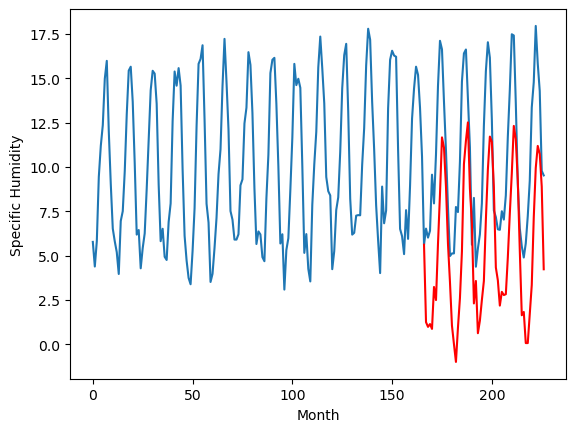

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.89		2.09		0.20
0.69		1.83		1.14
1.59		1.99		0.40
0.89		1.71		0.82
5.25		4.08		-1.17
4.91		3.34		-1.57
6.89		6.51		-0.38
9.01		9.31		0.30
11.52		12.51		0.99
10.41		11.94		1.53
8.83		9.74		0.91
5.43		6.53		1.10
3.33		4.36		1.03
0.78		1.90		1.12
0.44		0.86		0.42
0.51		-0.15		-0.66
3.15		1.77		-1.38
4.49		3.45		-1.04
8.38		6.09		-2.29
11.57		11.01		-0.56
12.05		12.32		0.27
12.39		13.36		0.97
9.30		9.63		0.33
7.05		7.66		0.61
2.60		3.15		0.55
5.52		4.42		-1.10
-0.13		1.47		1.60
0.04		2.18		2.14
1.72		3.34		1.62
5.88		4.42		-1.46
9.69		7.87		-1.82
10.74		10.70		-0.04
11.66		12.56		0.90
11.91		12.26		0.35
8.62		9.69		1.07
3.66		5.18		1.52
3.16		4.46		1.30
2.35		3.03		0.68
1.93		3.80		1.87
2.71		3.62		0.91
4.26		3.67		-0.59
4.63		5.74		1.11
8.41		8.22		-0.19
11.81		10.49		-1.32
12.37		13.16		0.79
10.70		12.41		1.71
9.50		10.07		0.57
6.08		6.14		0.06
2.75		2.48		-0.27
1.11		2.67		1.56
0.01		0.91		0.

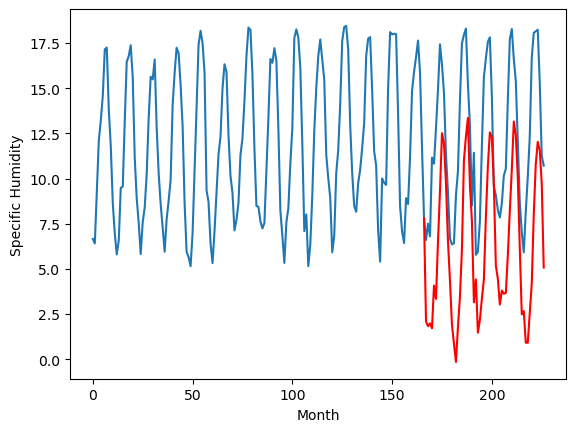

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.44		2.98		0.54
1.20		2.72		1.52
2.11		2.88		0.77
1.43		2.60		1.17
6.16		4.97		-1.19
5.85		4.23		-1.62
7.97		7.40		-0.57
10.26		10.20		-0.06
12.86		13.40		0.54
11.41		12.83		1.42
9.92		10.63		0.71
6.07		7.42		1.35
3.59		5.25		1.66
0.77		2.79		2.02
0.52		1.75		1.23
0.56		0.74		0.18
3.28		2.66		-0.62
4.54		4.34		-0.20
8.57		6.98		-1.59
11.98		11.90		-0.08
12.16		13.21		1.05
12.20		14.25		2.05
9.10		10.52		1.42
7.15		8.55		1.40
2.56		4.04		1.48
5.49		5.31		-0.18
-0.05		2.36		2.41
0.15		3.07		2.92
1.85		4.23		2.38
5.95		5.31		-0.64
9.83		8.76		-1.07
10.95		11.59		0.64
11.70		13.45		1.75
12.08		13.15		1.07
8.73		10.58		1.85
3.83		6.07		2.24
3.45		5.35		1.90
2.63		3.92		1.29
2.15		4.69		2.54
2.75		4.51		1.76
4.45		4.56		0.11
4.90		6.63		1.73
8.57		9.11		0.54
11.83		11.38		-0.45
11.91		14.05		2.14
10.51		13.30		2.79
9.76		10.96		1.20
6.37		7.03		0.66
3.03		3.37		0.34
1.31		3.56		2.25
0.14		1.80		1.

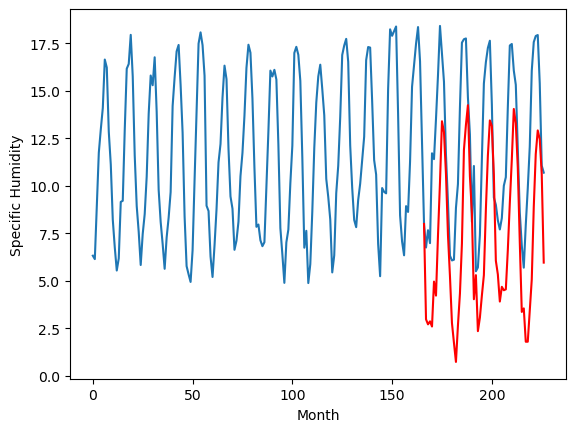

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
4.76		2.65		-2.11
3.28		2.39		-0.89
3.00		2.55		-0.45
3.18		2.27		-0.91
5.85		4.64		-1.21
4.84		3.90		-0.94
7.52		7.07		-0.45
9.34		9.87		0.53
10.33		13.07		2.74
9.10		12.50		3.40
8.67		10.30		1.63
5.16		7.09		1.93
4.60		4.92		0.32
2.16		2.46		0.30
2.99		1.42		-1.57
2.36		0.41		-1.95
3.15		2.33		-0.82
4.45		4.01		-0.44
8.76		6.65		-2.11
10.93		11.57		0.64
12.26		12.88		0.62
12.48		13.92		1.44
8.94		10.19		1.25
5.83		8.22		2.39
3.99		3.71		-0.28
2.94		4.98		2.04
1.67		2.03		0.36
1.55		2.74		1.19
2.10		3.90		1.80
4.37		4.98		0.61
6.14		8.43		2.29
8.74		11.26		2.52
9.69		13.12		3.43
11.80		12.82		1.02
10.53		10.25		-0.28
7.34		5.74		-1.60
4.47		5.02		0.55
3.80		3.59		-0.21
2.25		4.36		2.11
2.28		4.18		1.90
3.33		4.23		0.90
3.59		6.30		2.71
7.96		8.78		0.82
7.91		11.05		3.14
10.08		13.72		3.64
10.23		12.97		2.74
9.87		10.63		0.76
7.89		6.70		-1.19
5.26		3.04		-2.22
3.39		3.23		-0.16
2.24		1.47		-

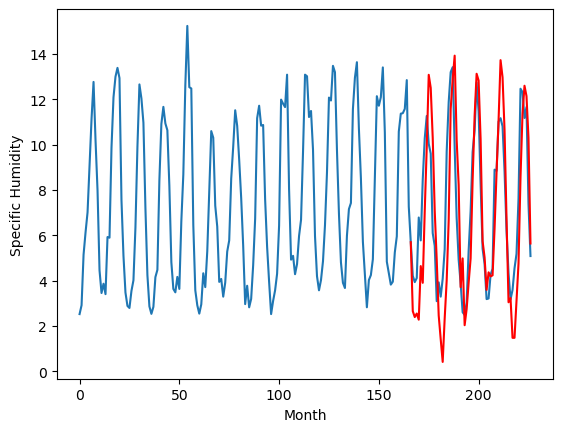

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-2.55		-1.16		1.39
-2.52		-1.42		1.10
-2.94		-1.26		1.68
-2.46		-1.54		0.92
-0.49		0.83		1.32
-1.14		0.09		1.23
2.06		3.26		1.20
5.70		6.06		0.36
8.14		9.26		1.12
8.16		8.69		0.53
4.85		6.49		1.64
2.36		3.28		0.92
-0.75		1.11		1.86
-3.47		-1.35		2.12
-3.58		-2.39		1.19
-3.46		-3.40		0.06
-1.90		-1.48		0.42
-1.28		0.20		1.48
1.65		2.84		1.19
6.00		7.76		1.76
8.50		9.07		0.57
8.79		10.11		1.32
5.44		6.38		0.94
3.31		4.41		1.10
-2.62		-0.10		2.52
-0.75		1.17		1.92
-3.75		-1.78		1.97
-2.62		-1.07		1.55
-1.87		0.09		1.96
-0.68		1.17		1.85
3.58		4.62		1.04
6.30		7.45		1.15
9.29		9.31		0.02
8.20		9.01		0.81
4.72		6.44		1.72
-0.34		1.93		2.27
-0.83		1.21		2.04
-2.73		-0.22		2.51
-2.37		0.55		2.92
-1.17		0.37		1.54
-1.93		0.42		2.35
-0.12		2.49		2.61
2.44		4.97		2.53
5.02		7.24		2.22
8.64		9.91		1.27
8.53		9.16		0.63
5.56		6.82		1.26
1.31		2.89		1.58
-2.04		-0.77		1.27
-2.54		-0.58		1.96
-3.36		-2.34	

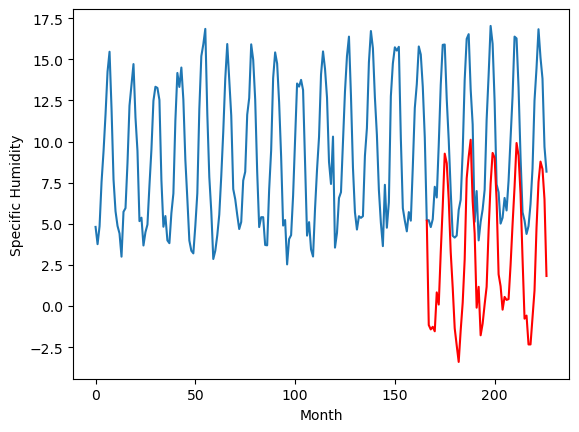

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.26		1.13		-0.13
0.93		0.87		-0.06
0.85		1.03		0.18
0.73		0.75		0.02
3.39		3.12		-0.27
3.65		2.38		-1.27
6.55		5.55		-1.00
10.38		8.35		-2.03
13.46		11.55		-1.91
11.29		10.98		-0.31
9.49		8.78		-0.71
4.67		5.57		0.90
2.65		3.40		0.75
0.33		0.94		0.61
0.20		-0.10		-0.30
-0.32		-1.11		-0.79
2.41		0.81		-1.60
3.64		2.49		-1.15
6.85		5.13		-1.72
11.61		10.05		-1.56
12.24		11.36		-0.88
12.09		12.40		0.31
8.84		8.67		-0.17
6.11		6.70		0.59
1.55		2.19		0.64
3.19		3.46		0.27
-0.56		0.51		1.07
0.12		1.22		1.10
1.65		2.38		0.73
3.84		3.46		-0.38
8.29		6.91		-1.38
11.05		9.74		-1.31
12.02		11.60		-0.42
11.93		11.30		-0.63
7.97		8.73		0.76
3.43		4.22		0.79
2.18		3.50		1.32
1.27		2.07		0.80
1.39		2.84		1.45
1.49		2.66		1.17
2.25		2.71		0.46
3.45		4.78		1.33
7.49		7.26		-0.23
10.41		9.53		-0.88
12.98		12.20		-0.78
12.56		11.45		-1.11
8.07		9.11		1.04
4.82		5.18		0.36
2.11		1.52		-0.59
0.72		1.71		0.99
-0.

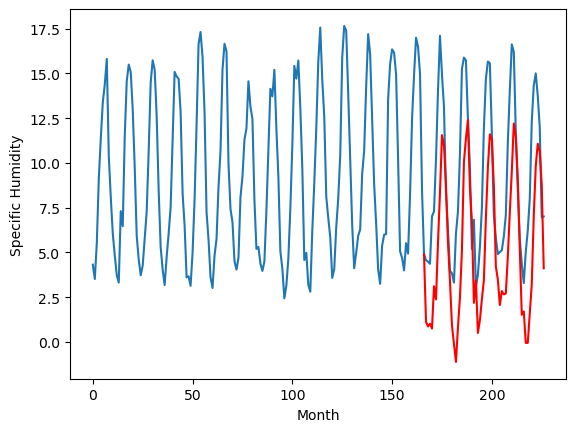

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.02		0.64		-1.38
1.18		0.38		-0.80
1.63		0.54		-1.09
1.01		0.26		-0.75
4.03		2.63		-1.40
4.22		1.89		-2.33
7.55		5.06		-2.49
9.69		7.86		-1.83
13.05		11.06		-1.99
10.15		10.49		0.34
8.67		8.29		-0.38
4.00		5.08		1.08
2.89		2.91		0.02
0.61		0.45		-0.16
0.77		-0.59		-1.36
-0.04		-1.60		-1.56
2.57		0.32		-2.25
3.73		2.00		-1.73
7.95		4.64		-3.31
11.09		9.56		-1.53
12.14		10.87		-1.27
11.72		11.91		0.19
8.15		8.18		0.03
5.71		6.21		0.50
2.18		1.70		-0.48
1.57		2.97		1.40
-0.41		0.02		0.43
0.12		0.73		0.61
1.21		1.89		0.68
4.33		2.97		-1.36
8.57		6.42		-2.15
10.47		9.25		-1.22
9.83		11.11		1.28
10.57		10.81		0.24
7.83		8.24		0.41
3.88		3.73		-0.15
2.90		3.01		0.11
1.16		1.58		0.42
0.68		2.35		1.67
1.01		2.17		1.16
2.43		2.22		-0.21
3.65		4.29		0.64
8.70		6.77		-1.93
11.28		9.04		-2.24
11.51		11.71		0.20
9.68		10.96		1.28
8.73		8.62		-0.11
5.30		4.69		-0.61
2.63		1.03		-1.60
1.58		1.22		-0.36
0.27

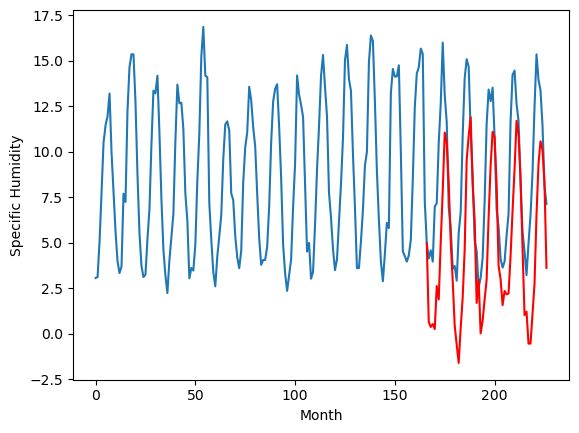

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.35		-0.61		-1.96
0.70		-0.87		-1.57
0.55		-0.71		-1.26
0.56		-0.99		-1.55
2.45		1.38		-1.07
2.61		0.64		-1.97
5.43		3.81		-1.62
7.14		6.61		-0.53
10.03		9.81		-0.22
8.71		9.24		0.53
5.92		7.04		1.12
2.40		3.83		1.43
2.08		1.66		-0.42
0.22		-0.80		-1.02
0.41		-1.84		-2.25
-0.33		-2.85		-2.52
1.49		-0.93		-2.42
1.66		0.75		-0.91
6.81		3.39		-3.42
9.80		8.31		-1.49
11.04		9.62		-1.42
10.01		10.66		0.65
7.05		6.93		-0.12
3.61		4.96		1.35
1.25		0.45		-0.80
0.27		1.72		1.45
-0.37		-1.23		-0.86
-0.45		-0.52		-0.07
0.51		0.64		0.13
1.48		1.72		0.24
4.04		5.17		1.13
8.22		8.00		-0.22
8.87		9.86		0.99
9.28		9.56		0.28
7.28		6.99		-0.29
3.89		2.48		-1.41
1.91		1.76		-0.15
0.70		0.33		-0.37
0.39		1.10		0.71
0.25		0.92		0.67
1.04		0.97		-0.07
1.56		3.04		1.48
7.29		5.52		-1.77
8.90		7.79		-1.11
10.83		10.46		-0.37
8.92		9.71		0.79
7.27		7.37		0.10
4.16		3.44		-0.72
1.84		-0.22		-2.06
1.40		-0.03		-1.43

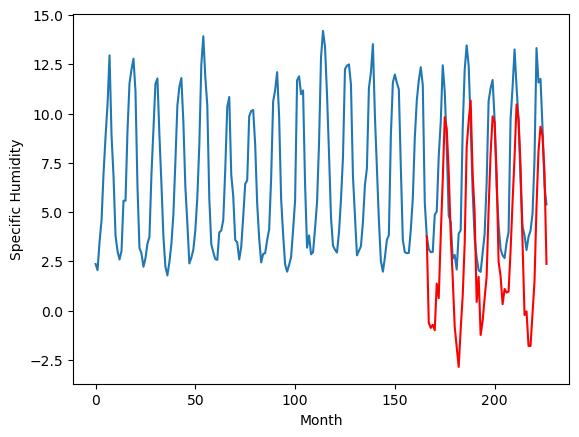

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.82		-1.31		0.51
-1.83		-1.57		0.26
-1.98		-1.41		0.57
-1.91		-1.69		0.22
-0.96		0.68		1.64
-0.67		-0.06		0.61
1.90		3.11		1.21
5.54		5.91		0.37
9.18		9.11		-0.07
9.09		8.54		-0.55
5.61		6.34		0.73
2.69		3.13		0.44
0.31		0.96		0.65
-1.85		-1.50		0.35
-2.58		-2.54		0.04
-2.54		-3.55		-1.01
-1.30		-1.63		-0.33
0.07		0.05		-0.02
1.60		2.69		1.09
6.92		7.61		0.69
8.78		8.92		0.14
9.12		9.96		0.84
5.93		6.23		0.30
4.07		4.26		0.19
-1.12		-0.25		0.87
-1.24		1.02		2.26
-2.85		-1.93		0.92
-2.11		-1.22		0.89
-1.09		-0.06		1.03
-0.43		1.02		1.45
3.70		4.47		0.77
5.29		7.30		2.01
8.92		9.16		0.24
8.49		8.86		0.37
5.24		6.29		1.05
1.80		1.78		-0.02
0.30		1.06		0.76
-1.83		-0.37		1.46
-0.97		0.40		1.37
-1.77		0.22		1.99
-1.74		0.27		2.01
0.87		2.34		1.47
1.17		4.82		3.65
4.46		7.09		2.63
9.17		9.76		0.59
6.88		9.01		2.13
5.62		6.67		1.05
2.57		2.74		0.17
-1.09		-0.92		0.17
-0.85		-0.73		0.12
-1.90		-2.

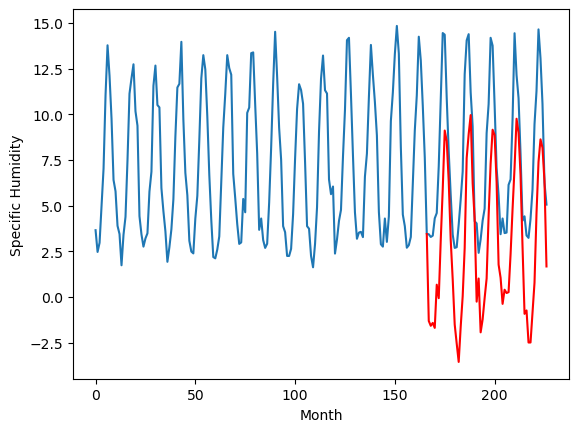

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -3.88  -1.308183
1                 1    1.11   2.751817
2                 2   -0.05   1.241817
3                 3    1.89   2.091817
4                 4    2.44   2.981817
5                 5    4.76   2.651817
6                 6   -2.55  -1.158183
7                 7    1.26   1.131817
8                 8    2.02   0.641817
9                 9    1.35  -0.608183
10               10   -1.82  -1.308183


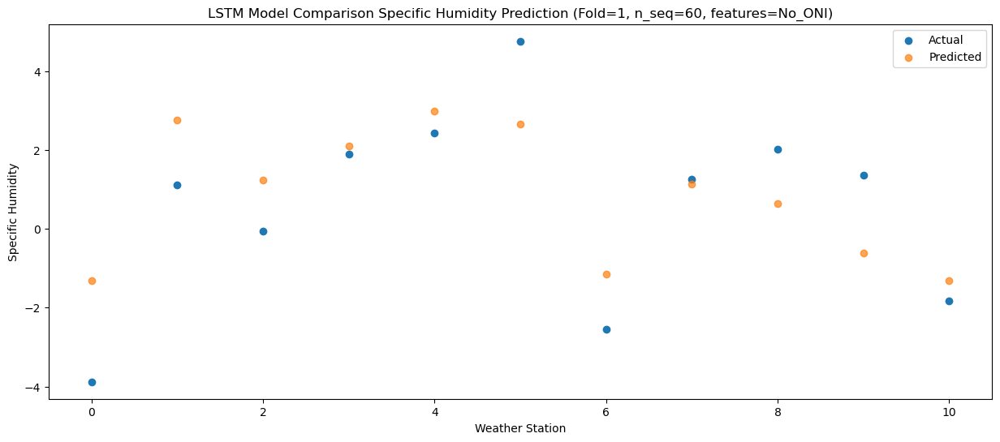

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -3.28  -1.571902
1                 1    1.16   2.488098
2                 2    0.86   0.978098
3                 3    0.69   1.828098
4                 4    1.20   2.718098
5                 5    3.28   2.388098
6                 6   -2.52  -1.421902
7                 7    0.93   0.868098
8                 8    1.18   0.378098
9                 9    0.70  -0.871902
10               10   -1.83  -1.571902


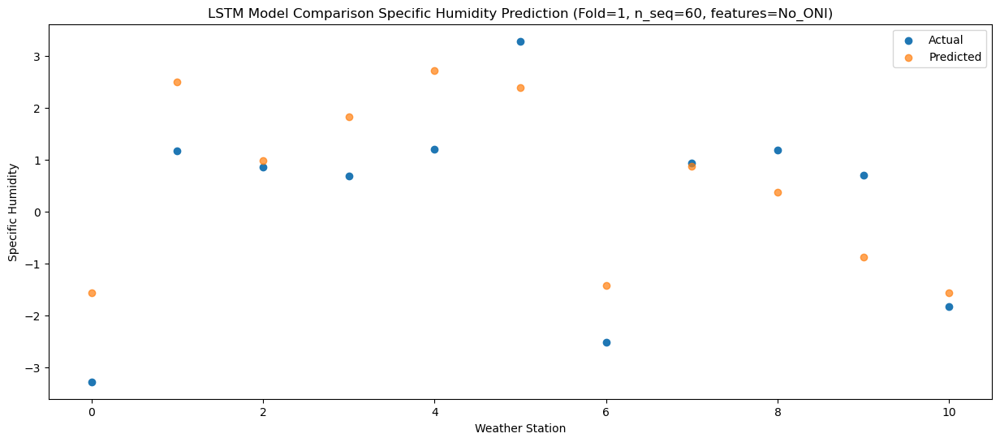

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -3.47  -1.414464
1                 1    0.91   2.645536
2                 2    0.35   1.135536
3                 3    1.59   1.985536
4                 4    2.11   2.875536
5                 5    3.00   2.545536
6                 6   -2.94  -1.264464
7                 7    0.85   1.025536
8                 8    1.63   0.535536
9                 9    0.55  -0.714464
10               10   -1.98  -1.414464


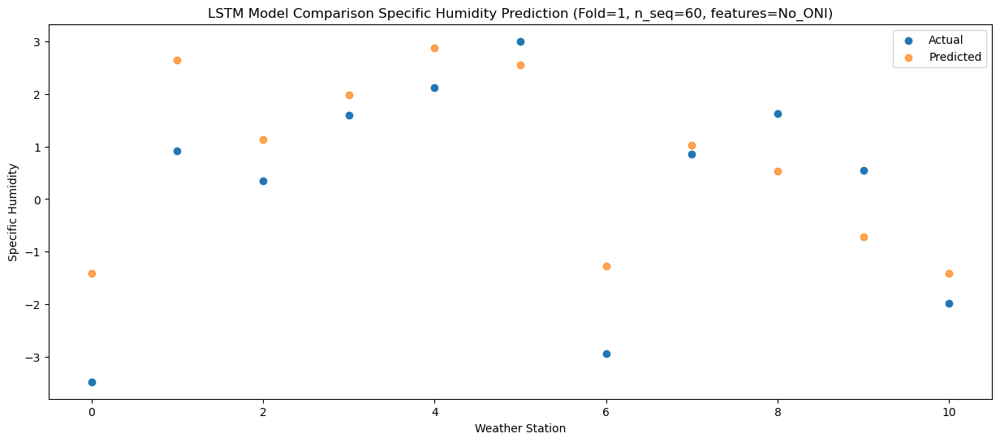

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -3.56  -1.687436
1                 1    1.43   2.372564
2                 2    0.74   0.862564
3                 3    0.89   1.712564
4                 4    1.43   2.602564
5                 5    3.18   2.272564
6                 6   -2.46  -1.537436
7                 7    0.73   0.752564
8                 8    1.01   0.262564
9                 9    0.56  -0.987436
10               10   -1.91  -1.687436


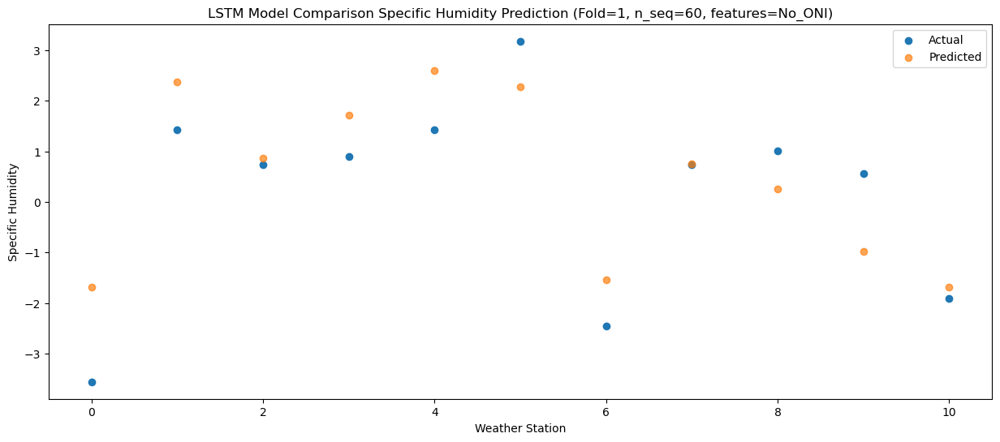

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0   -1.26    0.67729
1                 1    3.66    4.73729
2                 2    3.90    3.22729
3                 3    5.25    4.07729
4                 4    6.16    4.96729
5                 5    5.85    4.63729
6                 6   -0.49    0.82729
7                 7    3.39    3.11729
8                 8    4.03    2.62729
9                 9    2.45    1.37729
10               10   -0.96    0.67729


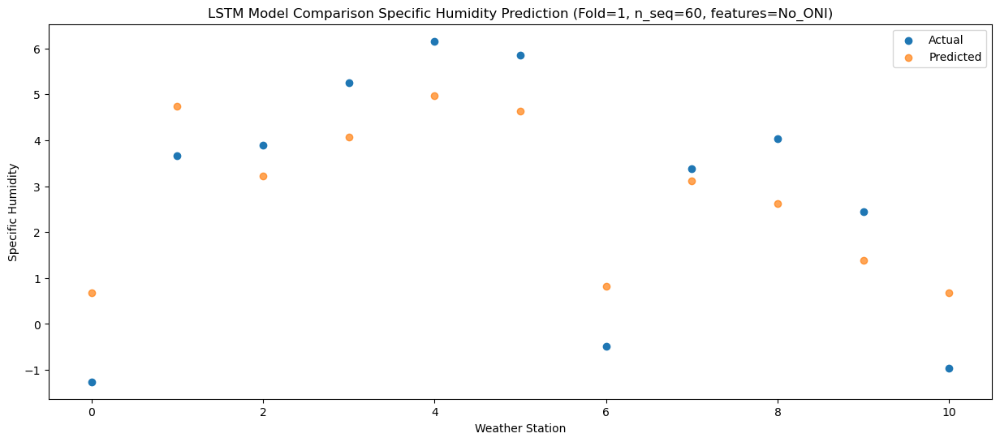

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0   -1.52  -0.060368
1                 1    2.07   3.999632
2                 2    2.28   2.489632
3                 3    4.91   3.339632
4                 4    5.85   4.229632
5                 5    4.84   3.899632
6                 6   -1.14   0.089632
7                 7    3.65   2.379632
8                 8    4.22   1.889632
9                 9    2.61   0.639632
10               10   -0.67  -0.060368


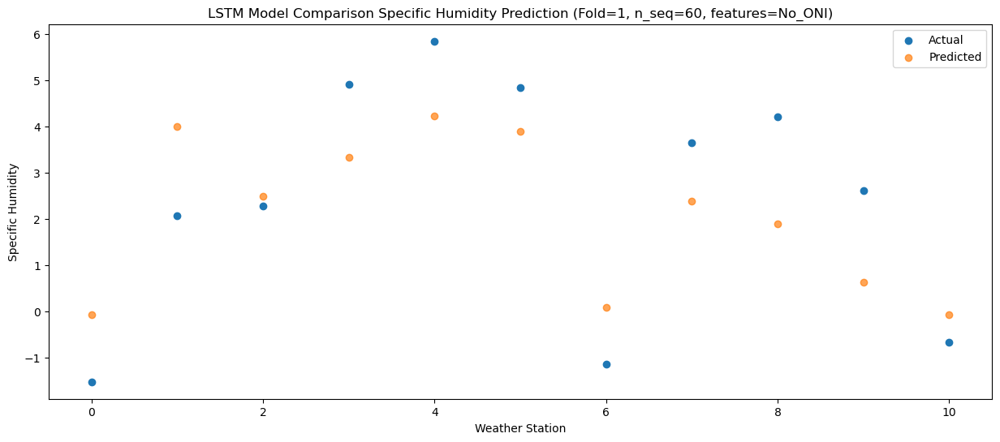

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    1.38   3.105209
1                 1    5.08   7.165209
2                 2    5.05   5.655209
3                 3    6.89   6.505209
4                 4    7.97   7.395209
5                 5    7.52   7.065209
6                 6    2.06   3.255209
7                 7    6.55   5.545209
8                 8    7.55   5.055209
9                 9    5.43   3.805209
10               10    1.90   3.105209


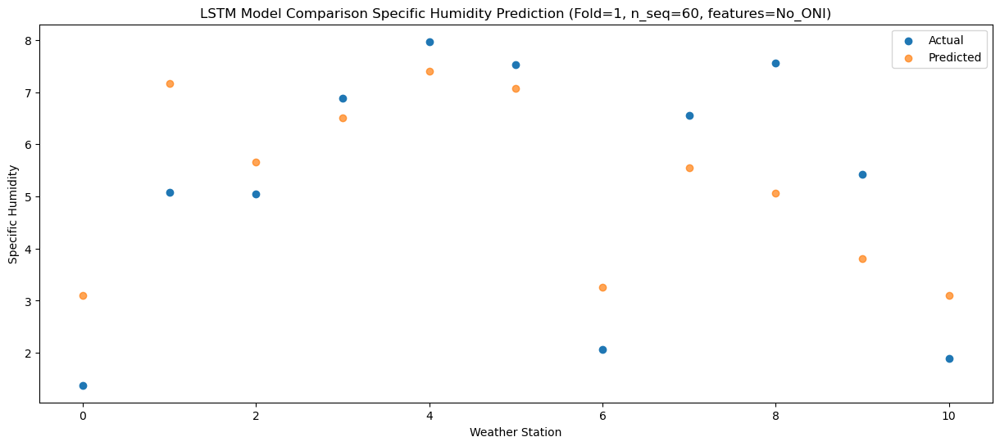

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0    4.62   5.909596
1                 1    8.88   9.969596
2                 2    8.90   8.459596
3                 3    9.01   9.309596
4                 4   10.26  10.199596
5                 5    9.34   9.869596
6                 6    5.70   6.059596
7                 7   10.38   8.349596
8                 8    9.69   7.859596
9                 9    7.14   6.609596
10               10    5.54   5.909596


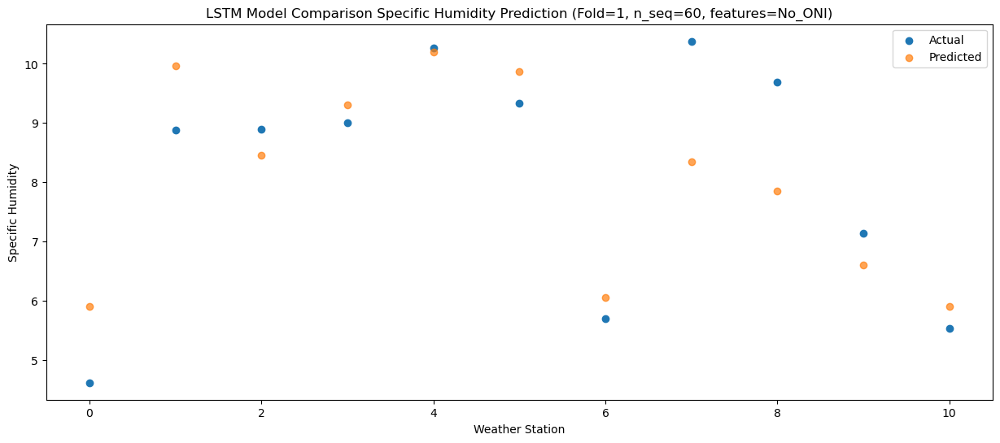

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0    7.19   9.113843
1                 1   10.92  13.173843
2                 2   11.45  11.663843
3                 3   11.52  12.513843
4                 4   12.86  13.403843
5                 5   10.33  13.073843
6                 6    8.14   9.263843
7                 7   13.46  11.553843
8                 8   13.05  11.063843
9                 9   10.03   9.813843
10               10    9.18   9.113843


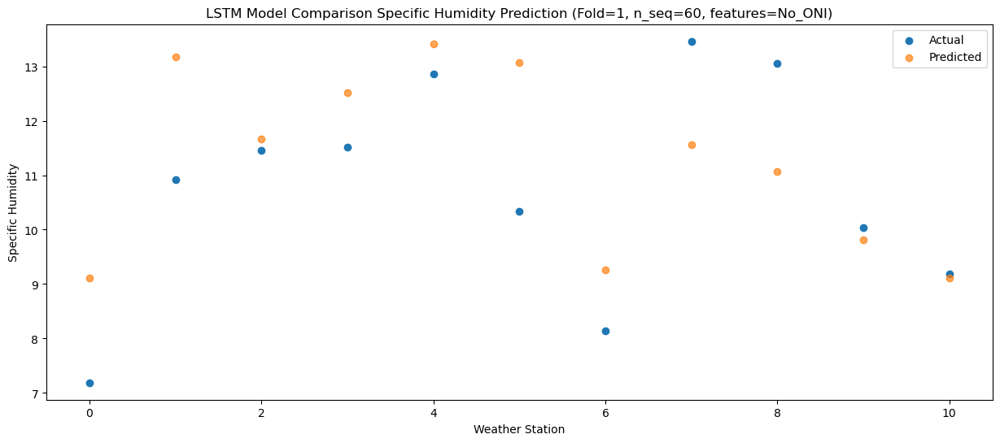

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0    7.48   8.537503
1                 1   10.97  12.597503
2                 2   10.97  11.087503
3                 3   10.41  11.937503
4                 4   11.41  12.827503
5                 5    9.10  12.497503
6                 6    8.16   8.687503
7                 7   11.29  10.977503
8                 8   10.15  10.487503
9                 9    8.71   9.237503
10               10    9.09   8.537503


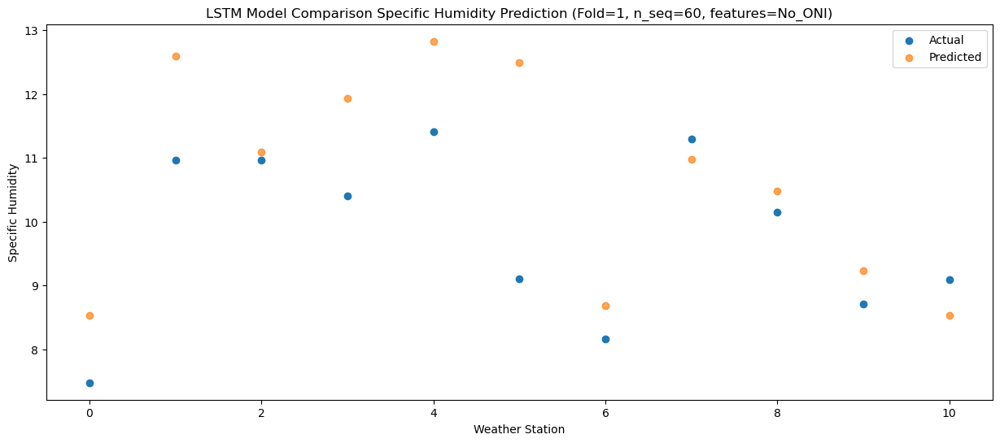

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    4.86   6.339751
1                 1    8.07  10.399751
2                 2    8.02   8.889751
3                 3    8.83   9.739751
4                 4    9.92  10.629751
5                 5    8.67  10.299751
6                 6    4.85   6.489751
7                 7    9.49   8.779751
8                 8    8.67   8.289751
9                 9    5.92   7.039751
10               10    5.61   6.339751


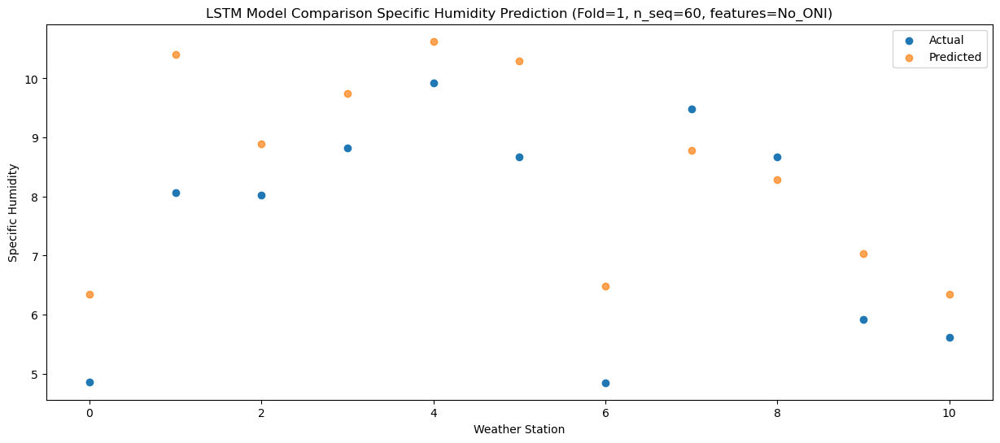

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    2.18   3.125092
1                 1    5.40   7.185092
2                 2    5.26   5.675092
3                 3    5.43   6.525092
4                 4    6.07   7.415092
5                 5    5.16   7.085092
6                 6    2.36   3.275092
7                 7    4.67   5.565092
8                 8    4.00   5.075092
9                 9    2.40   3.825092
10               10    2.69   3.125092


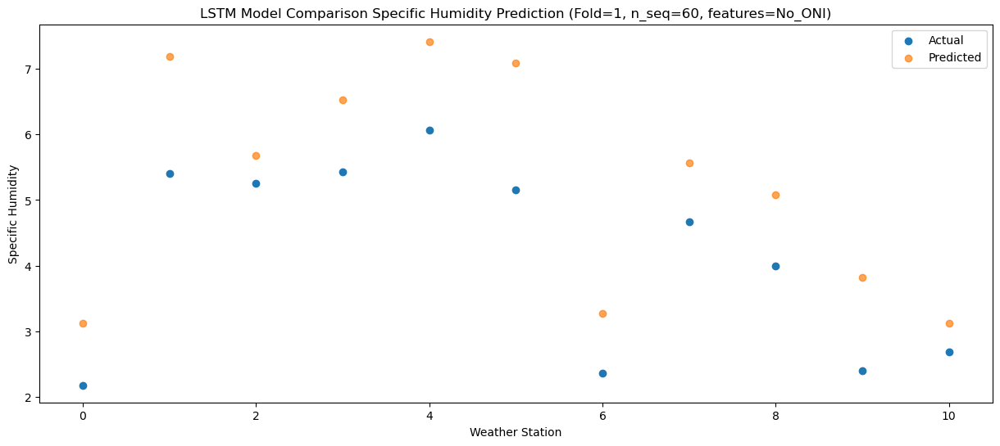

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0   -0.45   0.963856
1                 1    2.34   5.023856
2                 2    2.08   3.513856
3                 3    3.33   4.363856
4                 4    3.59   5.253856
5                 5    4.60   4.923856
6                 6   -0.75   1.113856
7                 7    2.65   3.403856
8                 8    2.89   2.913856
9                 9    2.08   1.663856
10               10    0.31   0.963856


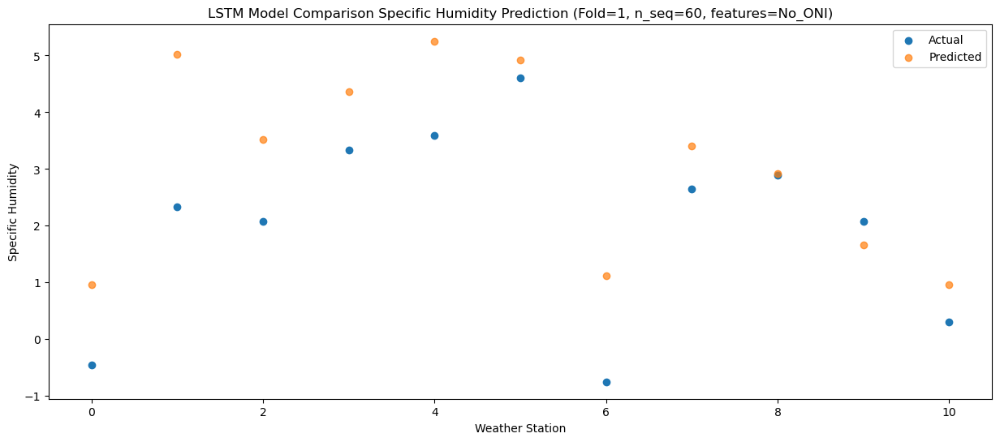

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -4.66  -1.500911
1                 1   -0.25   2.559089
2                 2   -0.69   1.049089
3                 3    0.78   1.899089
4                 4    0.77   2.789089
5                 5    2.16   2.459089
6                 6   -3.47  -1.350911
7                 7    0.33   0.939089
8                 8    0.61   0.449089
9                 9    0.22  -0.800911
10               10   -1.85  -1.500911


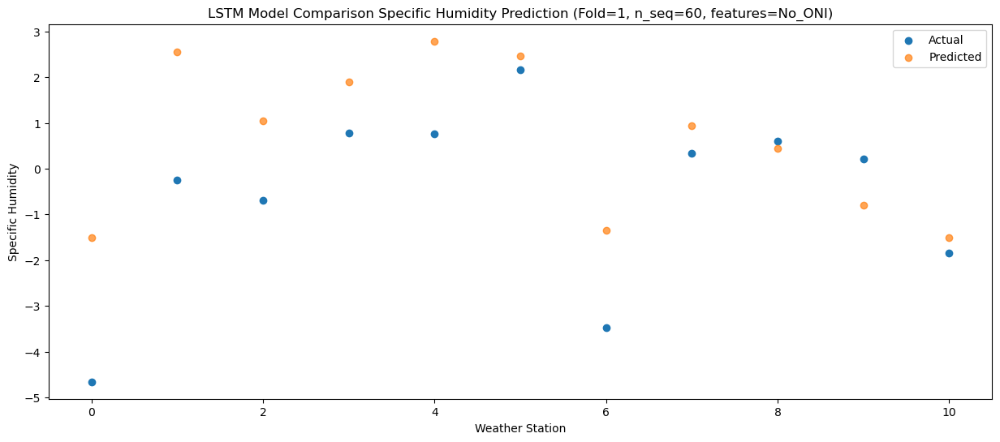

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -4.44  -2.543854
1                 1   -0.23   1.516146
2                 2   -0.54   0.006146
3                 3    0.44   0.856146
4                 4    0.52   1.746146
5                 5    2.99   1.416146
6                 6   -3.58  -2.393854
7                 7    0.20  -0.103854
8                 8    0.77  -0.593854
9                 9    0.41  -1.843854
10               10   -2.58  -2.543854


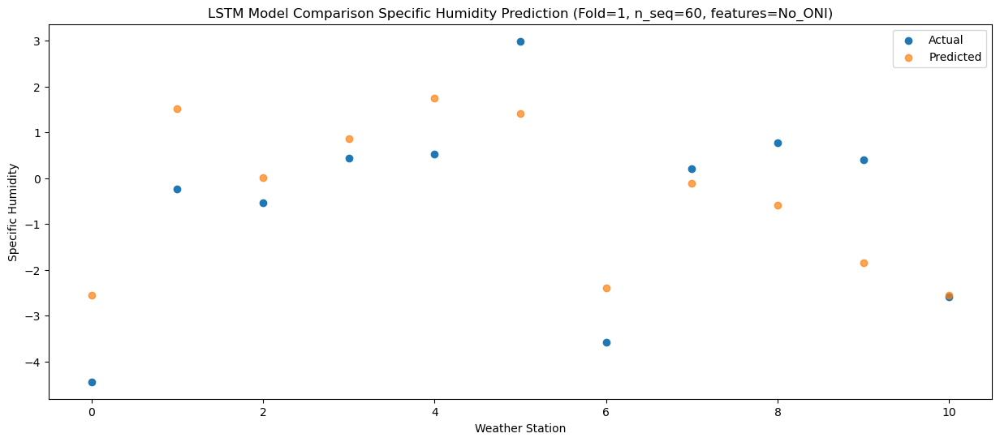

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -4.12  -3.549631
1                 1   -0.04   0.510369
2                 2   -0.54  -0.999631
3                 3    0.51  -0.149631
4                 4    0.56   0.740369
5                 5    2.36   0.410369
6                 6   -3.46  -3.399631
7                 7   -0.32  -1.109631
8                 8   -0.04  -1.599631
9                 9   -0.33  -2.849631
10               10   -2.54  -3.549631


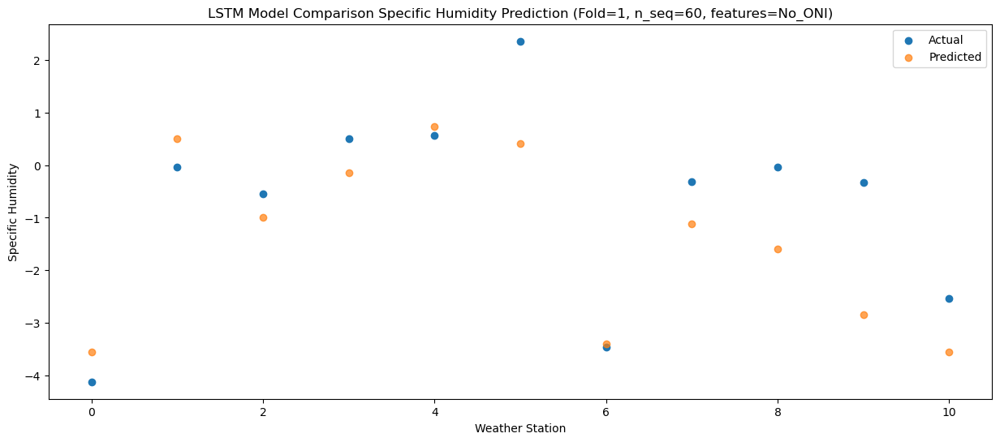

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0   -2.59  -1.627326
1                 1    1.49   2.432674
2                 2    2.08   0.922674
3                 3    3.15   1.772674
4                 4    3.28   2.662674
5                 5    3.15   2.332674
6                 6   -1.90  -1.477326
7                 7    2.41   0.812674
8                 8    2.57   0.322674
9                 9    1.49  -0.927326
10               10   -1.30  -1.627326


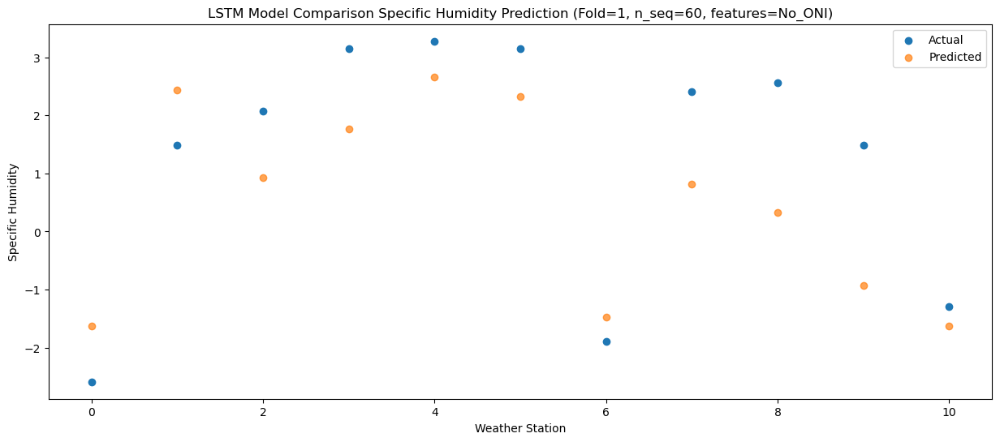

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0   -2.39   0.047502
1                 1    1.85   4.107502
2                 2    1.79   2.597502
3                 3    4.49   3.447502
4                 4    4.54   4.337502
5                 5    4.45   4.007502
6                 6   -1.28   0.197502
7                 7    3.64   2.487502
8                 8    3.73   1.997502
9                 9    1.66   0.747502
10               10    0.07   0.047502


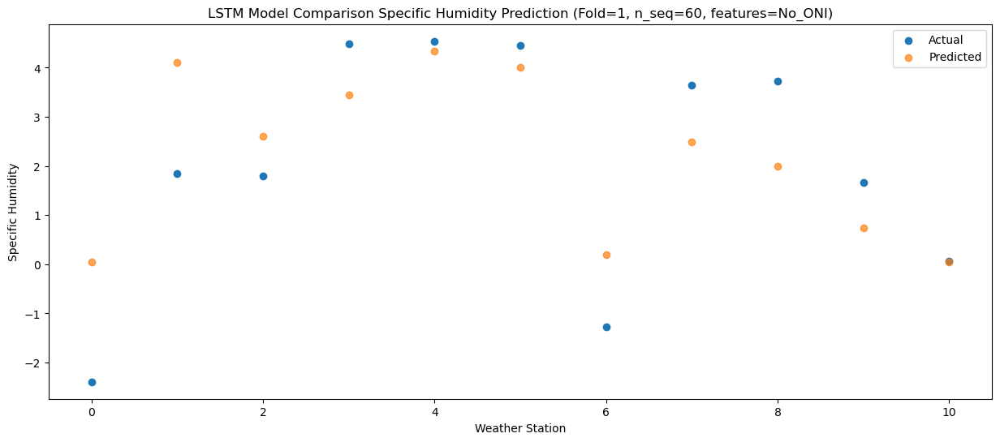

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    0.29    2.68557
1                 1    4.77    6.74557
2                 2    4.63    5.23557
3                 3    8.38    6.08557
4                 4    8.57    6.97557
5                 5    8.76    6.64557
6                 6    1.65    2.83557
7                 7    6.85    5.12557
8                 8    7.95    4.63557
9                 9    6.81    3.38557
10               10    1.60    2.68557


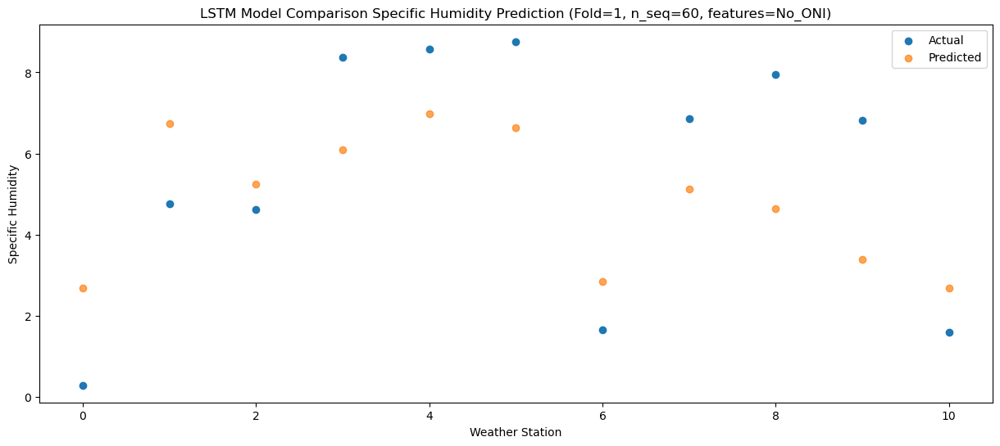

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0    5.45   7.606495
1                 1    8.75  11.666495
2                 2    9.15  10.156495
3                 3   11.57  11.006495
4                 4   11.98  11.896495
5                 5   10.93  11.566495
6                 6    6.00   7.756495
7                 7   11.61  10.046495
8                 8   11.09   9.556495
9                 9    9.80   8.306495
10               10    6.92   7.606495


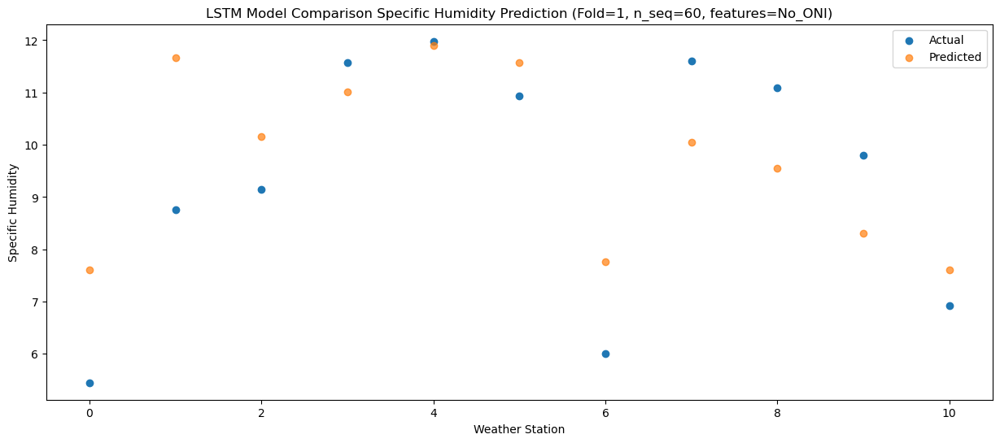

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0    6.60   8.916253
1                 1   10.62  12.976253
2                 2   10.74  11.466253
3                 3   12.05  12.316253
4                 4   12.16  13.206253
5                 5   12.26  12.876253
6                 6    8.50   9.066253
7                 7   12.24  11.356253
8                 8   12.14  10.866253
9                 9   11.04   9.616253
10               10    8.78   8.916253


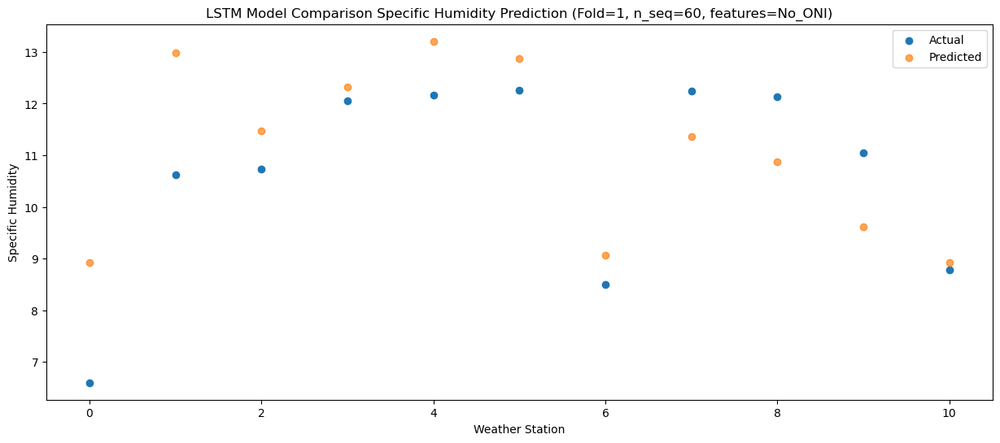

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0    7.36   9.958773
1                 1   10.83  14.018773
2                 2   10.96  12.508773
3                 3   12.39  13.358773
4                 4   12.20  14.248773
5                 5   12.48  13.918773
6                 6    8.79  10.108773
7                 7   12.09  12.398773
8                 8   11.72  11.908773
9                 9   10.01  10.658773
10               10    9.12   9.958773


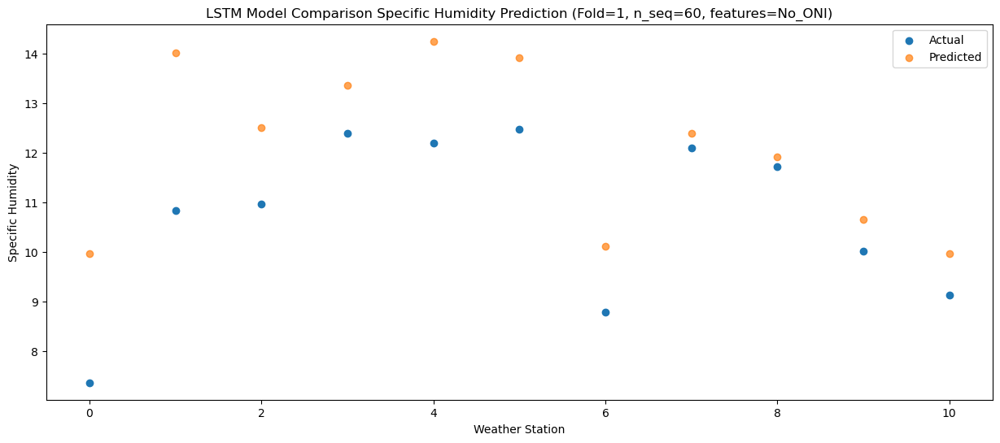

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    3.88   6.228135
1                 1    7.88  10.288135
2                 2    8.20   8.778135
3                 3    9.30   9.628135
4                 4    9.10  10.518135
5                 5    8.94  10.188135
6                 6    5.44   6.378135
7                 7    8.84   8.668135
8                 8    8.15   8.178135
9                 9    7.05   6.928135
10               10    5.93   6.228135


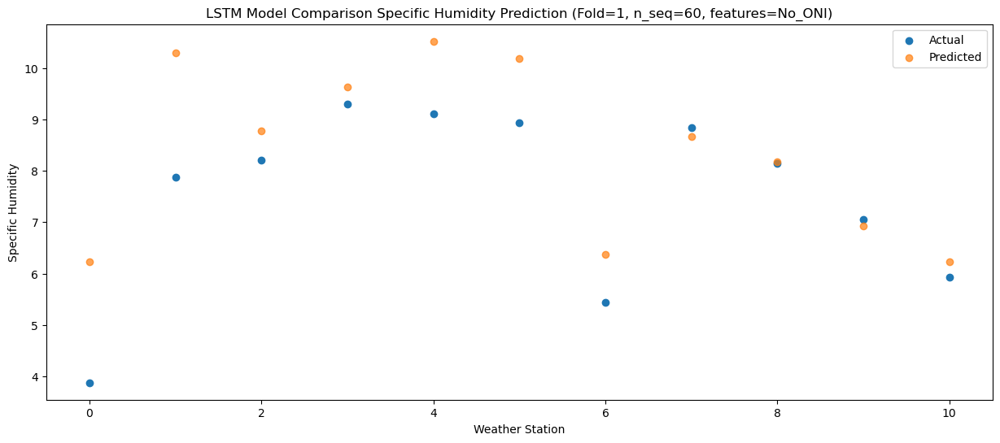

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    1.30   4.261382
1                 1    5.84   8.321382
2                 2    5.45   6.811382
3                 3    7.05   7.661382
4                 4    7.15   8.551382
5                 5    5.83   8.221382
6                 6    3.31   4.411382
7                 7    6.11   6.701382
8                 8    5.71   6.211382
9                 9    3.61   4.961382
10               10    4.07   4.261382


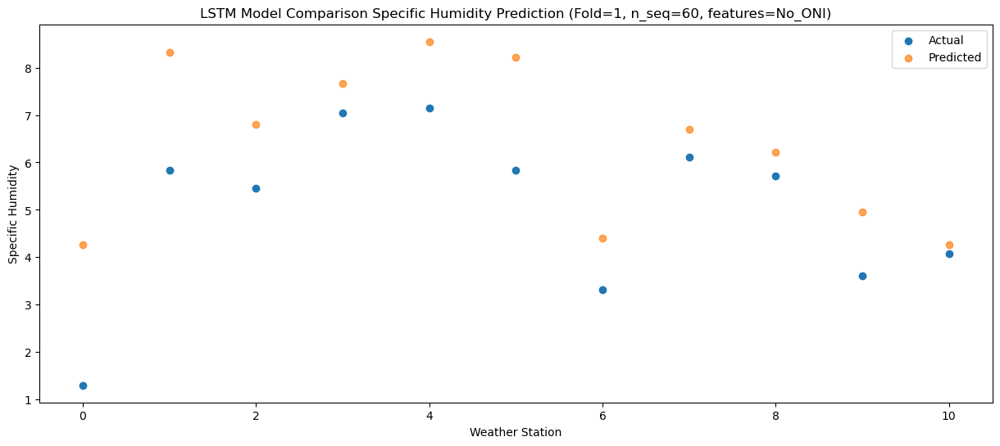

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0   -4.36  -0.251333
1                 1    0.25   3.808667
2                 2   -0.05   2.298667
3                 3    2.60   3.148667
4                 4    2.56   4.038667
5                 5    3.99   3.708667
6                 6   -2.62  -0.101333
7                 7    1.55   2.188667
8                 8    2.18   1.698667
9                 9    1.25   0.448667
10               10   -1.12  -0.251333


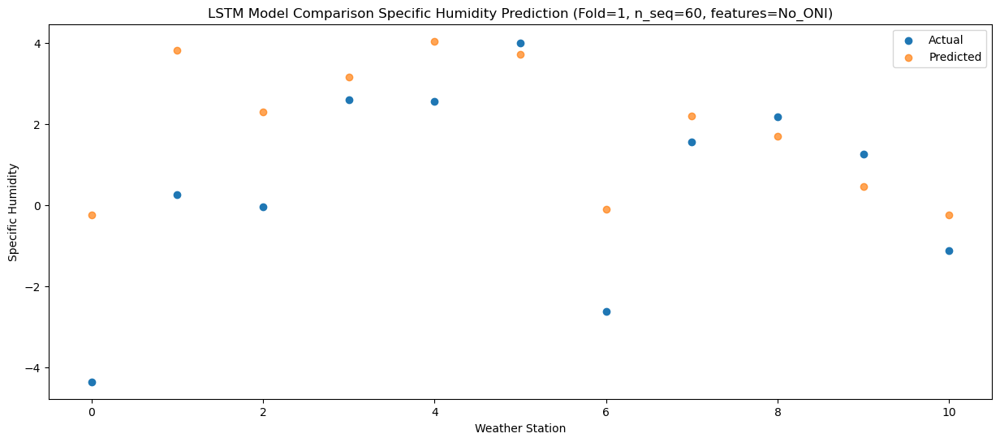

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0   -2.25   1.016078
1                 1    2.42   5.076078
2                 2    2.59   3.566078
3                 3    5.52   4.416078
4                 4    5.49   5.306078
5                 5    2.94   4.976078
6                 6   -0.75   1.166078
7                 7    3.19   3.456078
8                 8    1.57   2.966078
9                 9    0.27   1.716078
10               10   -1.24   1.016078


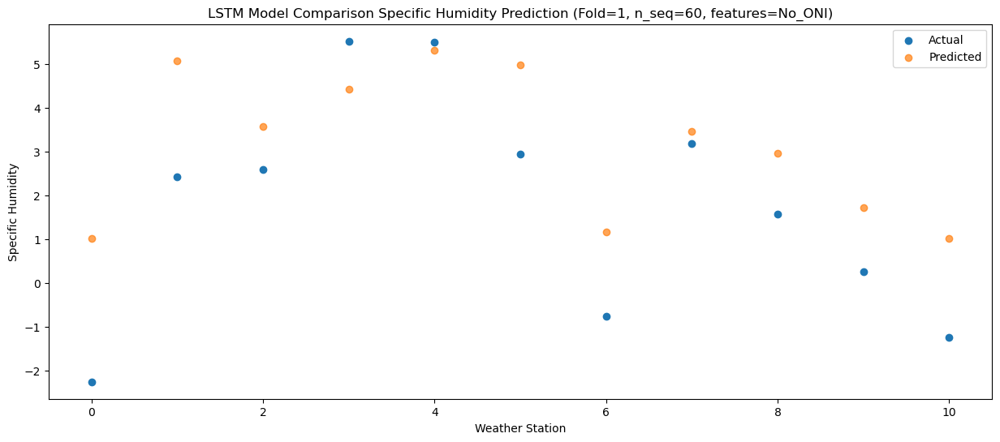

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -5.50   -1.93035
1                 1   -0.58    2.12965
2                 2   -1.29    0.61965
3                 3   -0.13    1.46965
4                 4   -0.05    2.35965
5                 5    1.67    2.02965
6                 6   -3.75   -1.78035
7                 7   -0.56    0.50965
8                 8   -0.41    0.01965
9                 9   -0.37   -1.23035
10               10   -2.85   -1.93035


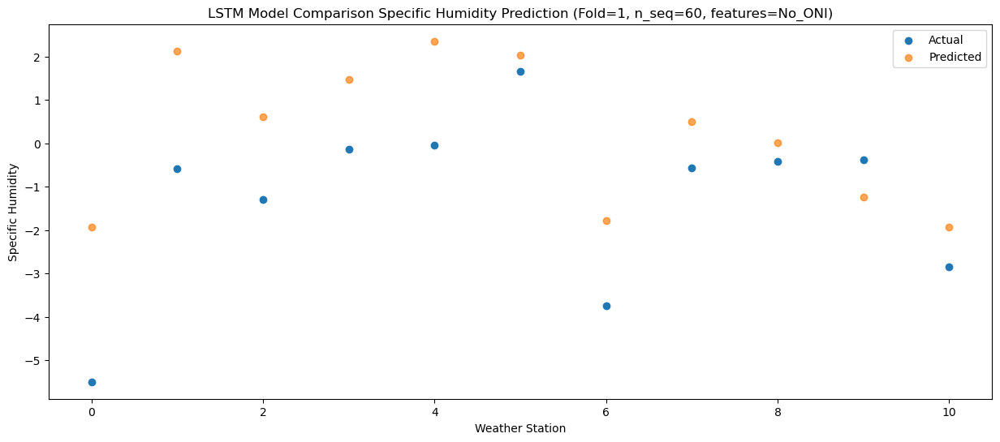

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -3.56  -1.220579
1                 1    0.37   2.839421
2                 2   -0.26   1.329421
3                 3    0.04   2.179421
4                 4    0.15   3.069421
5                 5    1.55   2.739421
6                 6   -2.62  -1.070579
7                 7    0.12   1.219421
8                 8    0.12   0.729421
9                 9   -0.45  -0.520579
10               10   -2.11  -1.220579


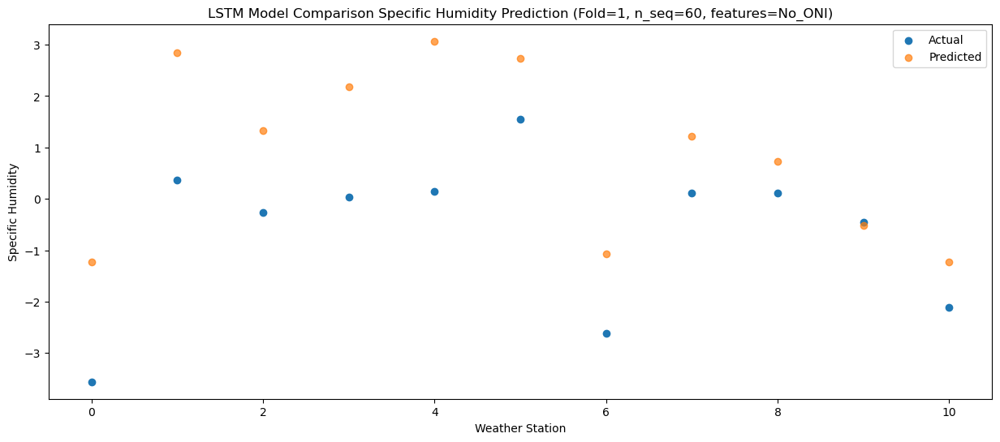

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0   -2.45  -0.057547
1                 1    1.05   4.002453
2                 2    0.53   2.492453
3                 3    1.72   3.342453
4                 4    1.85   4.232453
5                 5    2.10   3.902453
6                 6   -1.87   0.092453
7                 7    1.65   2.382453
8                 8    1.21   1.892453
9                 9    0.51   0.642453
10               10   -1.09  -0.057547


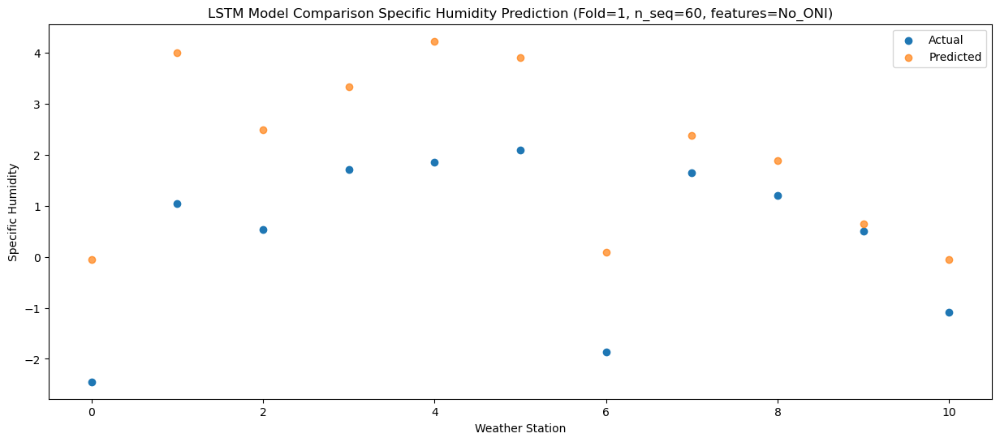

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0   -1.43   1.018073
1                 1    2.11   5.078073
2                 2    2.29   3.568073
3                 3    5.88   4.418073
4                 4    5.95   5.308073
5                 5    4.37   4.978073
6                 6   -0.68   1.168073
7                 7    3.84   3.458073
8                 8    4.33   2.968073
9                 9    1.48   1.718073
10               10   -0.43   1.018073


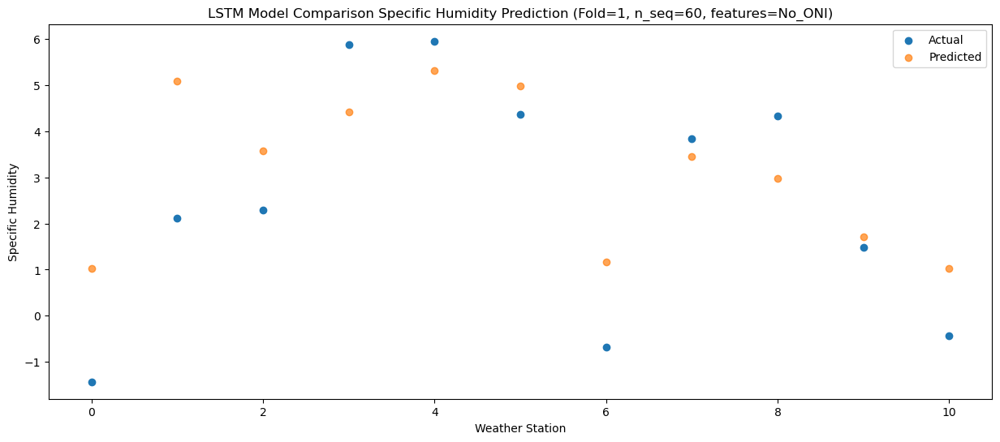

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    2.55   4.468778
1                 1    6.28   8.528778
2                 2    6.65   7.018778
3                 3    9.69   7.868778
4                 4    9.83   8.758778
5                 5    6.14   8.428778
6                 6    3.58   4.618778
7                 7    8.29   6.908778
8                 8    8.57   6.418778
9                 9    4.04   5.168778
10               10    3.70   4.468778


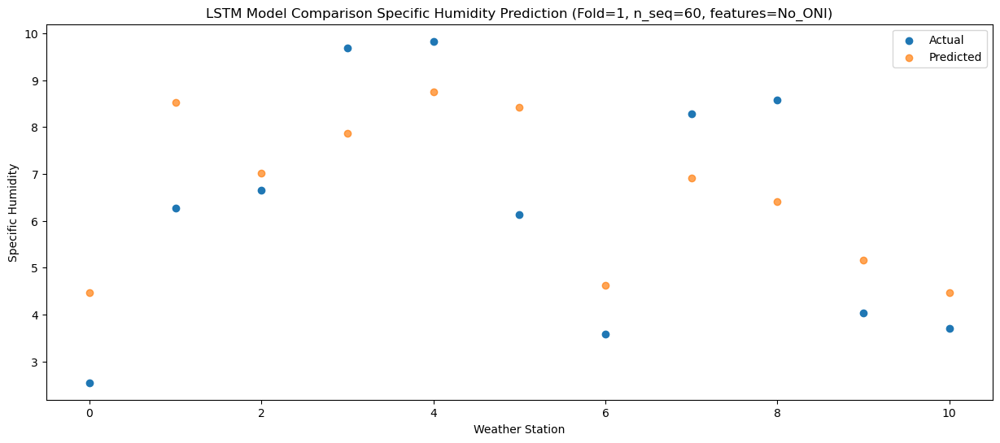

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0    4.85   7.295936
1                 1    8.68  11.355936
2                 2    9.74   9.845936
3                 3   10.74  10.695936
4                 4   10.95  11.585936
5                 5    8.74  11.255936
6                 6    6.30   7.445936
7                 7   11.05   9.735936
8                 8   10.47   9.245936
9                 9    8.22   7.995936
10               10    5.29   7.295936


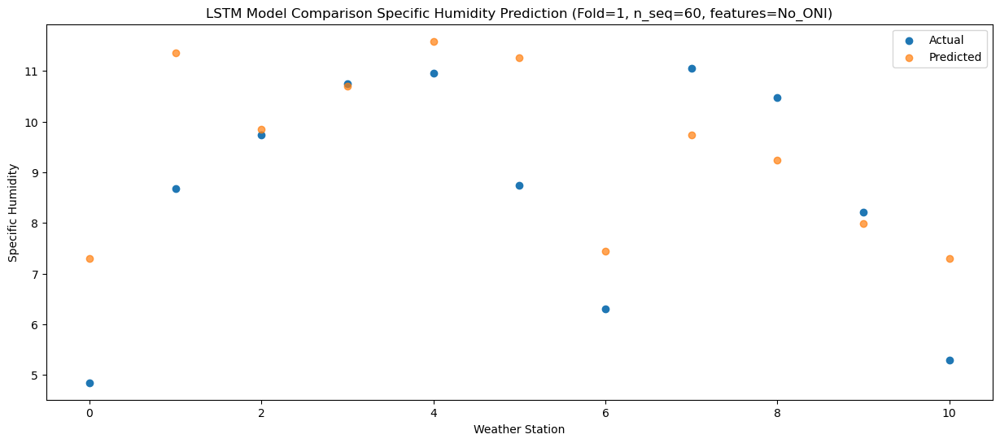

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0    7.47   9.159215
1                 1   11.35  13.219215
2                 2   11.37  11.709215
3                 3   11.66  12.559215
4                 4   11.70  13.449215
5                 5    9.69  13.119215
6                 6    9.29   9.309215
7                 7   12.02  11.599215
8                 8    9.83  11.109215
9                 9    8.87   9.859215
10               10    8.92   9.159215


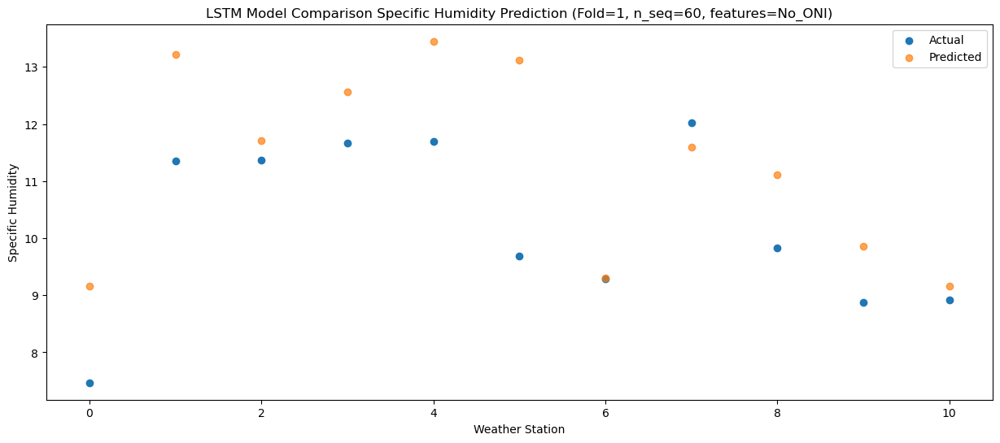

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0    6.47   8.863604
1                 1   10.94  12.923604
2                 2   10.50  11.413604
3                 3   11.91  12.263604
4                 4   12.08  13.153604
5                 5   11.80  12.823604
6                 6    8.20   9.013604
7                 7   11.93  11.303604
8                 8   10.57  10.813604
9                 9    9.28   9.563604
10               10    8.49   8.863604


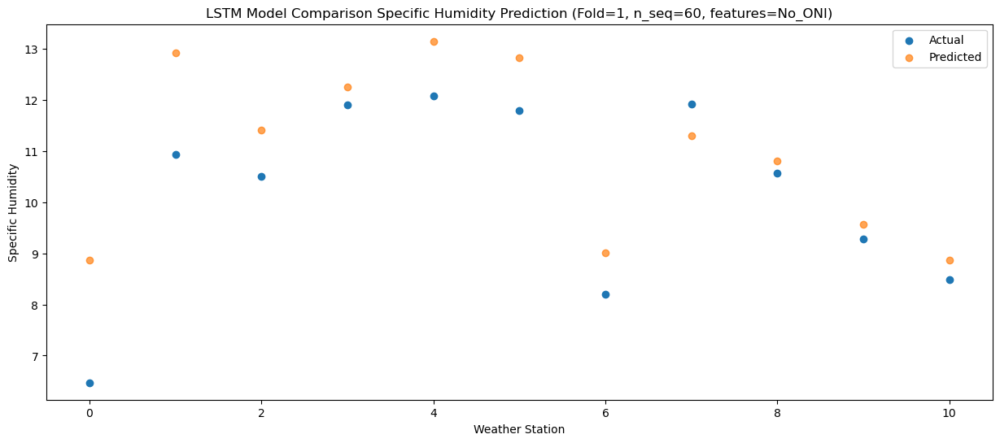

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    3.85   6.285957
1                 1    7.58  10.345957
2                 2    6.99   8.835957
3                 3    8.62   9.685957
4                 4    8.73  10.575957
5                 5   10.53  10.245957
6                 6    4.72   6.435957
7                 7    7.97   8.725957
8                 8    7.83   8.235957
9                 9    7.28   6.985957
10               10    5.24   6.285957


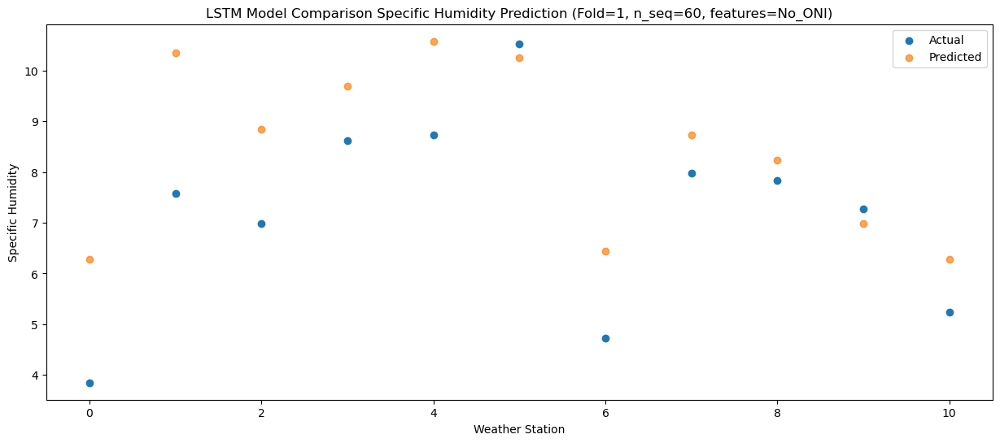

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0   -1.01   1.776819
1                 1    2.69   5.836819
2                 2    1.88   4.326819
3                 3    3.66   5.176819
4                 4    3.83   6.066819
5                 5    7.34   5.736819
6                 6   -0.34   1.926819
7                 7    3.43   4.216819
8                 8    3.88   3.726819
9                 9    3.89   2.476819
10               10    1.80   1.776819


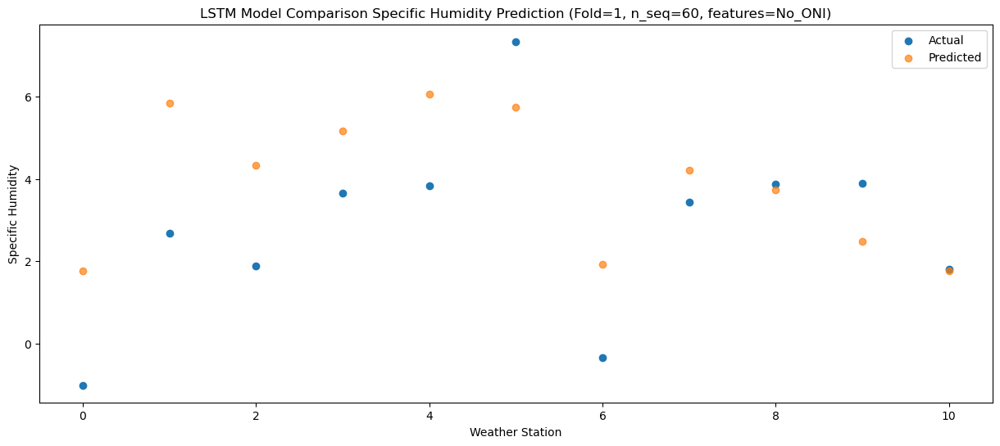

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0   -1.54   1.055764
1                 1    2.21   5.115764
2                 2    1.51   3.605764
3                 3    3.16   4.455764
4                 4    3.45   5.345764
5                 5    4.47   5.015764
6                 6   -0.83   1.205764
7                 7    2.18   3.495764
8                 8    2.90   3.005764
9                 9    1.91   1.755764
10               10    0.30   1.055764


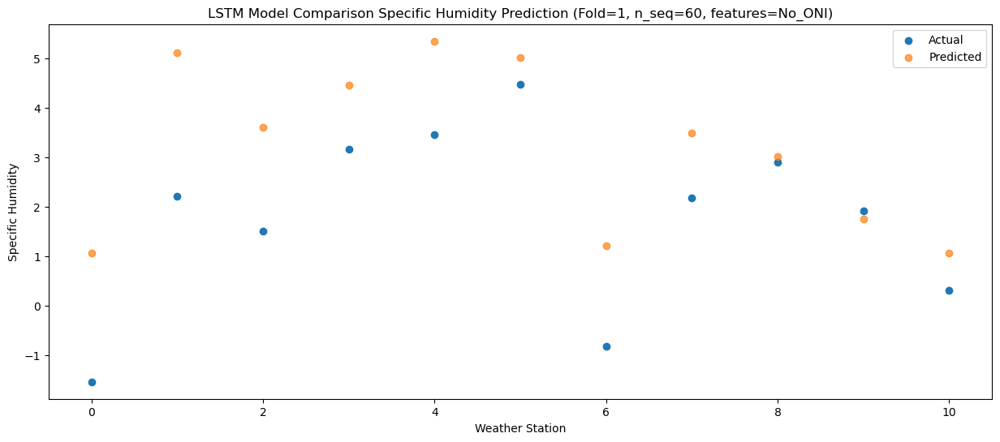

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -4.26  -0.372446
1                 1    0.62   3.687554
2                 2    0.82   2.177554
3                 3    2.35   3.027554
4                 4    2.63   3.917554
5                 5    3.80   3.587554
6                 6   -2.73  -0.222446
7                 7    1.27   2.067554
8                 8    1.16   1.577554
9                 9    0.70   0.327554
10               10   -1.83  -0.372446


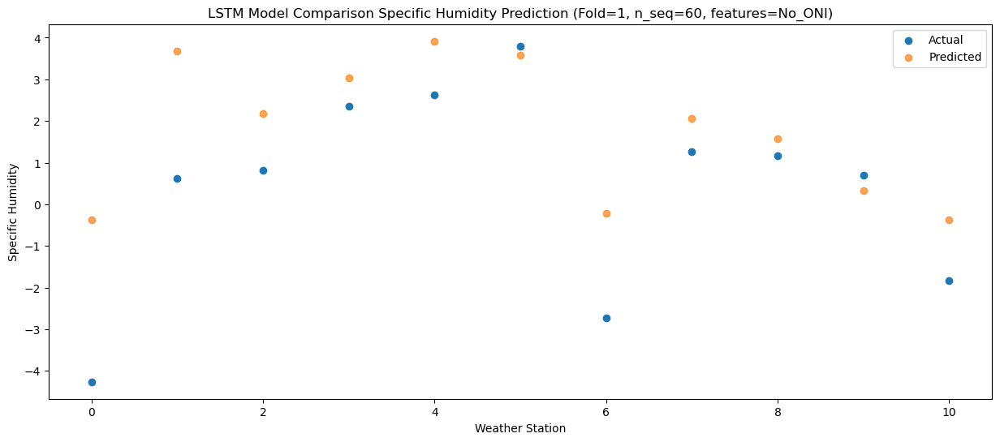

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0   -3.80   0.402196
1                 1    1.03   4.462196
2                 2    0.79   2.952196
3                 3    1.93   3.802196
4                 4    2.15   4.692196
5                 5    2.25   4.362196
6                 6   -2.37   0.552196
7                 7    1.39   2.842196
8                 8    0.68   2.352196
9                 9    0.39   1.102196
10               10   -0.97   0.402196


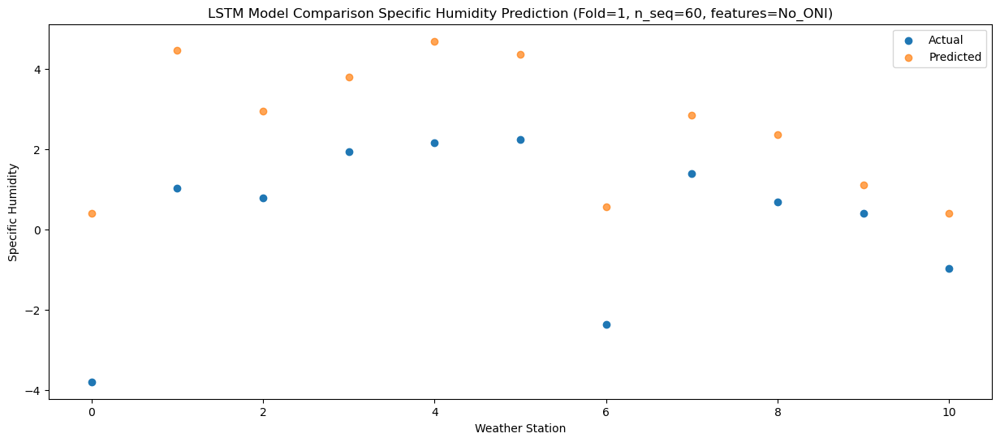

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0   -2.19   0.221108
1                 1    2.15   4.281108
2                 2    1.84   2.771108
3                 3    2.71   3.621108
4                 4    2.75   4.511108
5                 5    2.28   4.181108
6                 6   -1.17   0.371108
7                 7    1.49   2.661108
8                 8    1.01   2.171108
9                 9    0.25   0.921108
10               10   -1.77   0.221108


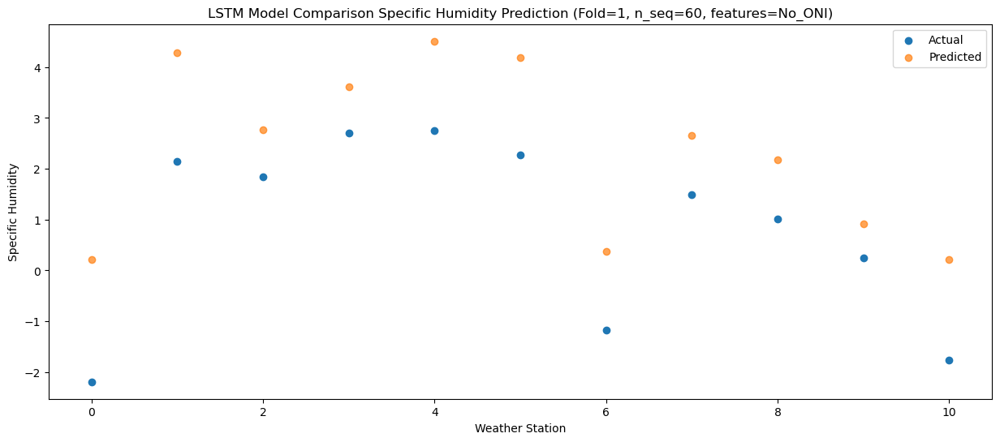

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0   -2.57   0.269456
1                 1    1.28   4.329456
2                 2    1.37   2.819456
3                 3    4.26   3.669456
4                 4    4.45   4.559456
5                 5    3.33   4.229456
6                 6   -1.93   0.419456
7                 7    2.25   2.709456
8                 8    2.43   2.219456
9                 9    1.04   0.969456
10               10   -1.74   0.269456


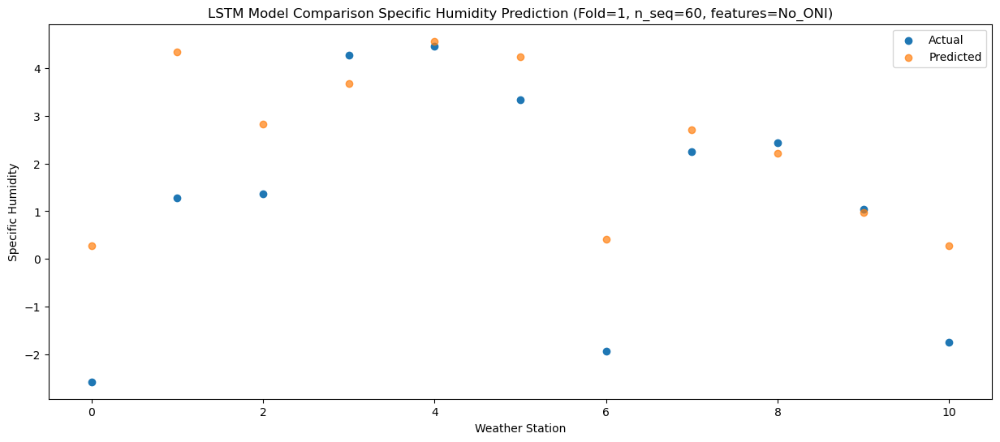

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0   -0.87   2.335026
1                 1    2.88   6.395026
2                 2    2.73   4.885026
3                 3    4.63   5.735026
4                 4    4.90   6.625026
5                 5    3.59   6.295026
6                 6   -0.12   2.485026
7                 7    3.45   4.775026
8                 8    3.65   4.285026
9                 9    1.56   3.035026
10               10    0.87   2.335026


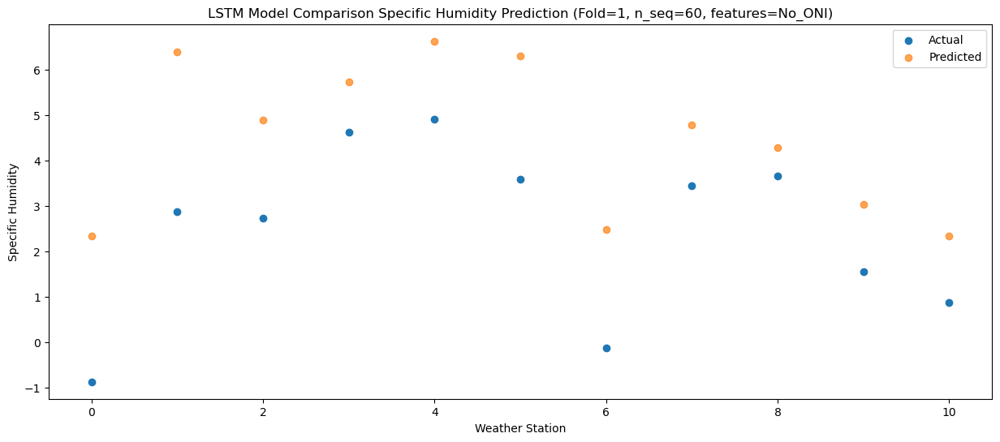

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    0.33    4.81593
1                 1    5.62    8.87593
2                 2    6.03    7.36593
3                 3    8.41    8.21593
4                 4    8.57    9.10593
5                 5    7.96    8.77593
6                 6    2.44    4.96593
7                 7    7.49    7.25593
8                 8    8.70    6.76593
9                 9    7.29    5.51593
10               10    1.17    4.81593


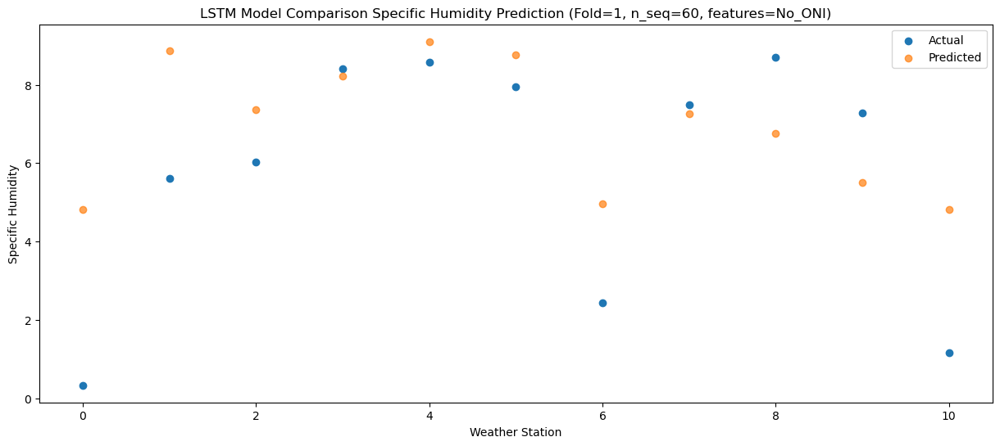

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0    3.68    7.09476
1                 1    7.97   11.15476
2                 2    8.68    9.64476
3                 3   11.81   10.49476
4                 4   11.83   11.38476
5                 5    7.91   11.05476
6                 6    5.02    7.24476
7                 7   10.41    9.53476
8                 8   11.28    9.04476
9                 9    8.90    7.79476
10               10    4.46    7.09476


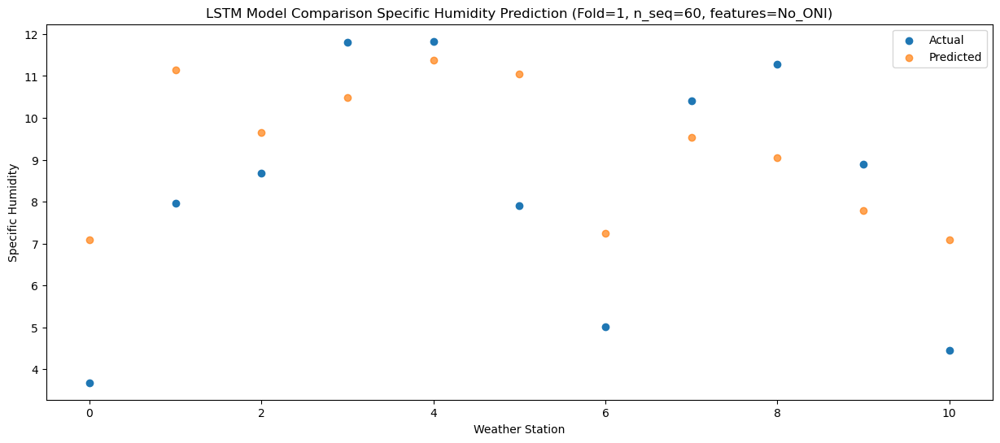

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0    7.09    9.76062
1                 1   10.93   13.82062
2                 2   11.82   12.31062
3                 3   12.37   13.16062
4                 4   11.91   14.05062
5                 5   10.08   13.72062
6                 6    8.64    9.91062
7                 7   12.98   12.20062
8                 8   11.51   11.71062
9                 9   10.83   10.46062
10               10    9.17    9.76062


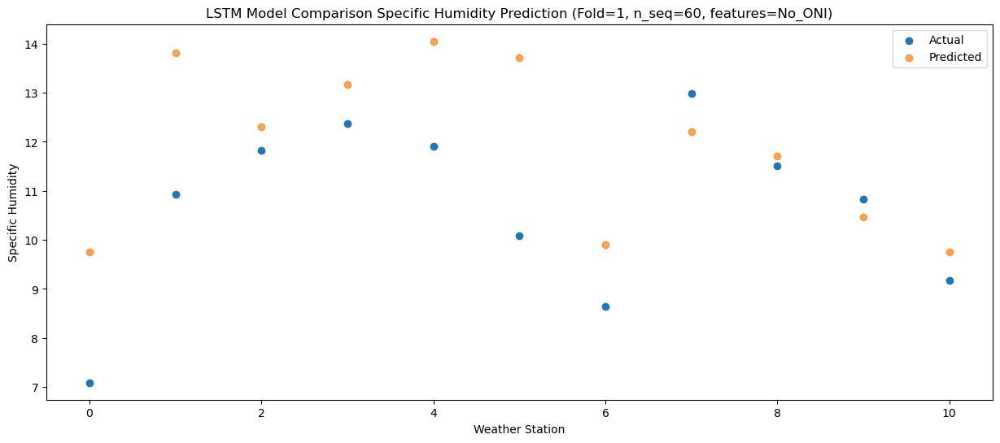

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0    6.92   9.006501
1                 1   11.06  13.066501
2                 2   11.75  11.556501
3                 3   10.70  12.406501
4                 4   10.51  13.296501
5                 5   10.23  12.966501
6                 6    8.53   9.156501
7                 7   12.56  11.446501
8                 8    9.68  10.956501
9                 9    8.92   9.706501
10               10    6.88   9.006501


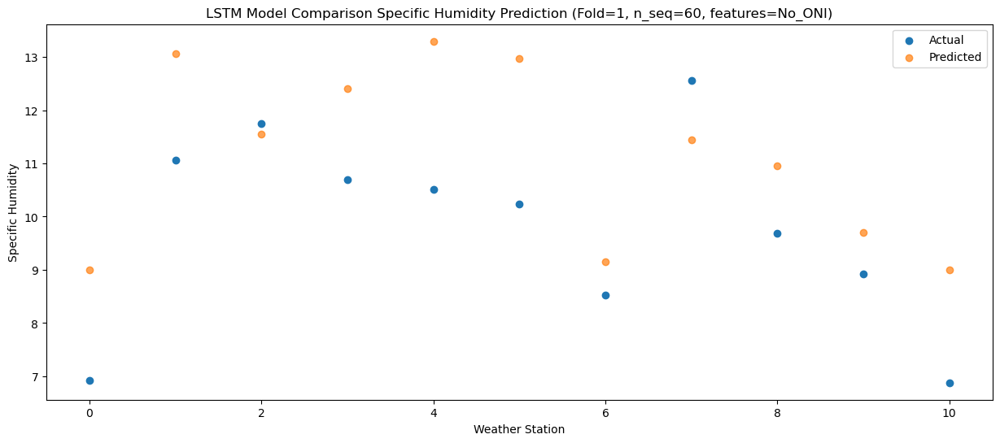

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    3.06   6.672305
1                 1    7.95  10.732305
2                 2    7.94   9.222305
3                 3    9.50  10.072305
4                 4    9.76  10.962305
5                 5    9.87  10.632305
6                 6    5.56   6.822305
7                 7    8.07   9.112305
8                 8    8.73   8.622305
9                 9    7.27   7.372305
10               10    5.62   6.672305


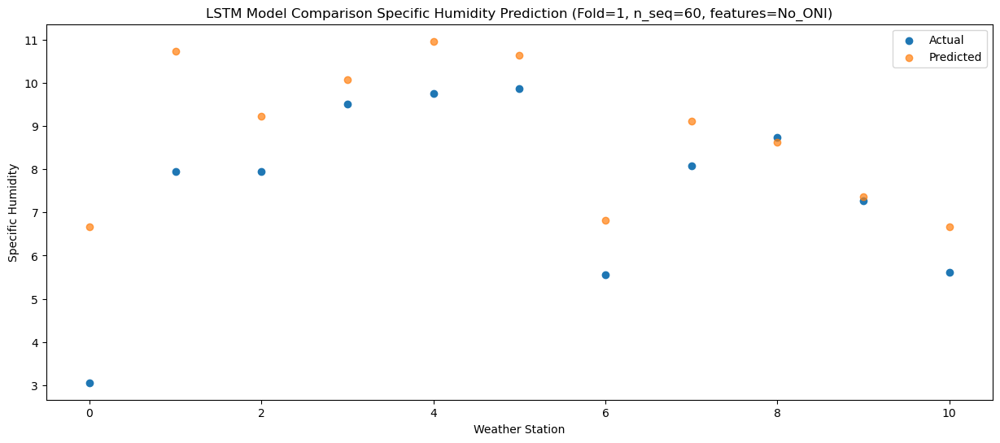

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0   -0.34   2.735571
1                 1    4.10   6.795571
2                 2    3.43   5.285571
3                 3    6.08   6.135571
4                 4    6.37   7.025571
5                 5    7.89   6.695571
6                 6    1.31   2.885571
7                 7    4.82   5.175571
8                 8    5.30   4.685571
9                 9    4.16   3.435571
10               10    2.57   2.735571


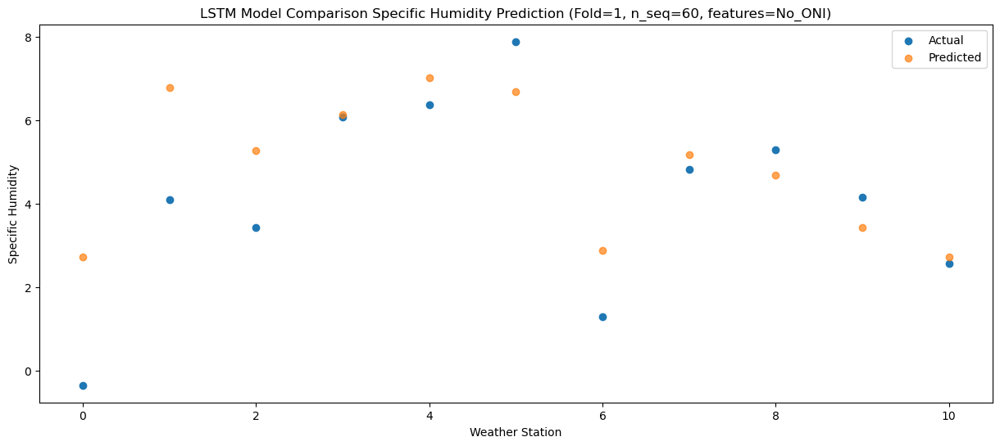

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0   -3.40  -0.918854
1                 1    1.09   3.141146
2                 2    0.88   1.631146
3                 3    2.75   2.481146
4                 4    3.03   3.371146
5                 5    5.26   3.041146
6                 6   -2.04  -0.768854
7                 7    2.11   1.521146
8                 8    2.63   1.031146
9                 9    1.84  -0.218854
10               10   -1.09  -0.918854


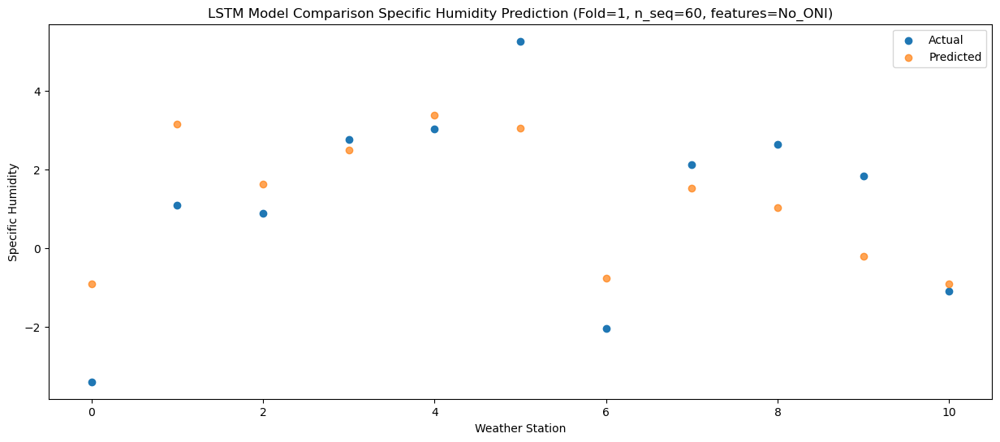

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -4.15  -0.731603
1                 1    0.51   3.328397
2                 2   -0.14   1.818397
3                 3    1.11   2.668397
4                 4    1.31   3.558397
5                 5    3.39   3.228397
6                 6   -2.54  -0.581603
7                 7    0.72   1.708397
8                 8    1.58   1.218397
9                 9    1.40  -0.031603
10               10   -0.85  -0.731603


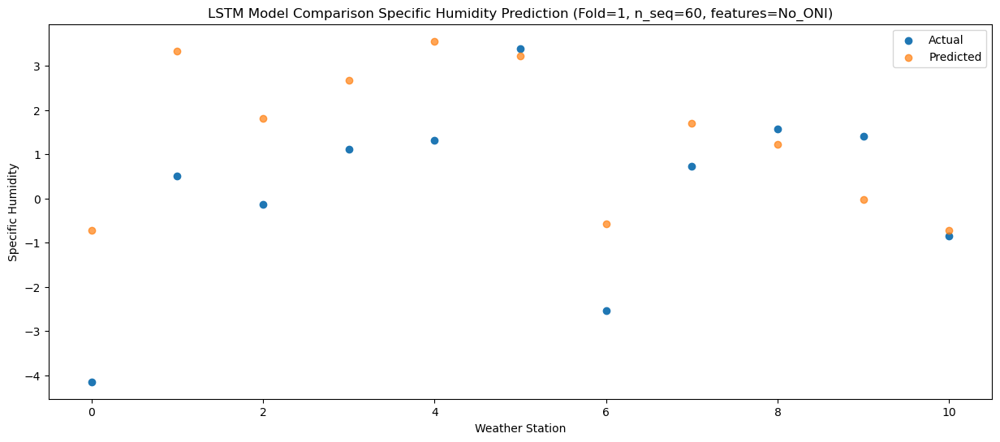

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -4.54   -2.48743
1                 1   -0.26    1.57257
2                 2   -0.77    0.06257
3                 3    0.01    0.91257
4                 4    0.14    1.80257
5                 5    2.24    1.47257
6                 6   -3.36   -2.33743
7                 7   -0.35   -0.04743
8                 8    0.27   -0.53743
9                 9    0.66   -1.78743
10               10   -1.90   -2.48743


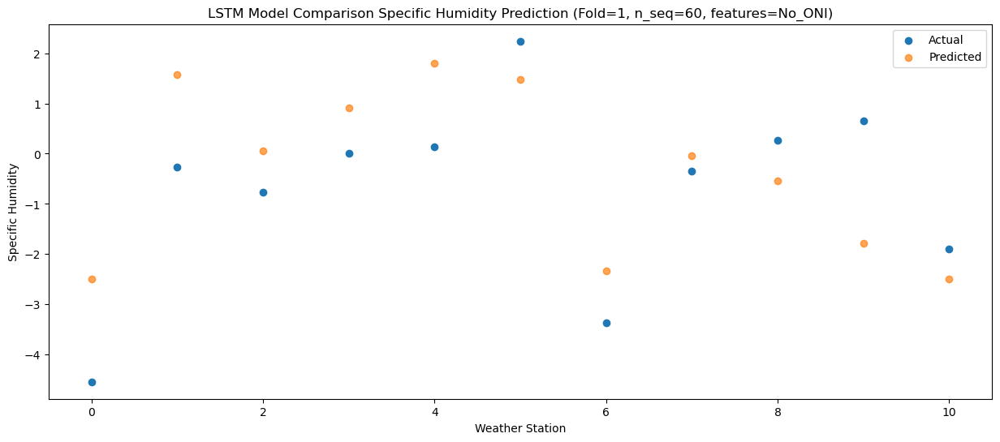

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0   -4.93  -2.486501
1                 1    0.08   1.573499
2                 2    0.03   0.063499
3                 3    2.26   0.913499
4                 4    2.39   1.803499
5                 5    2.65   1.473499
6                 6   -2.88  -2.336501
7                 7    1.40  -0.046501
8                 8    2.02  -0.536501
9                 9    1.33  -1.786501
10               10   -2.03  -2.486501


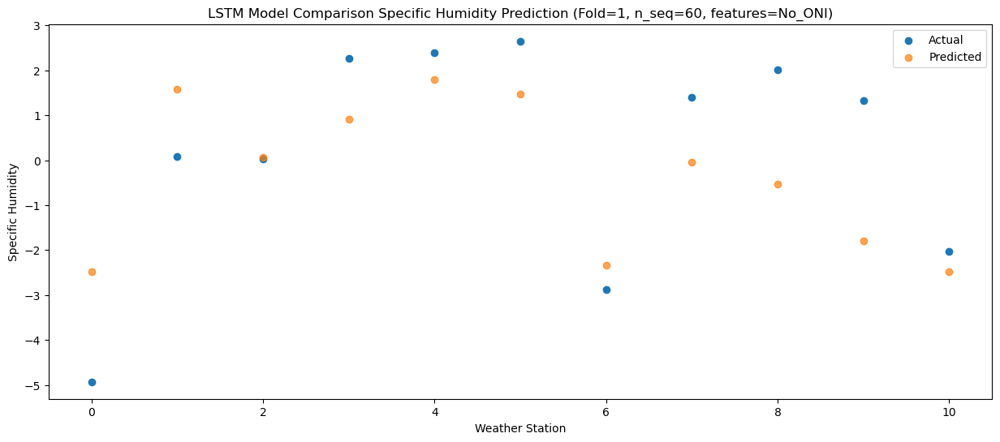

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0   -2.52  -0.849654
1                 1    1.59   3.210346
2                 2    1.57   1.700346
3                 3    4.17   2.550346
4                 4    4.32   3.440346
5                 5    3.61   3.110346
6                 6   -1.54  -0.699654
7                 7    2.59   1.590346
8                 8    3.57   1.100346
9                 9    1.64  -0.149654
10               10   -1.00  -0.849654


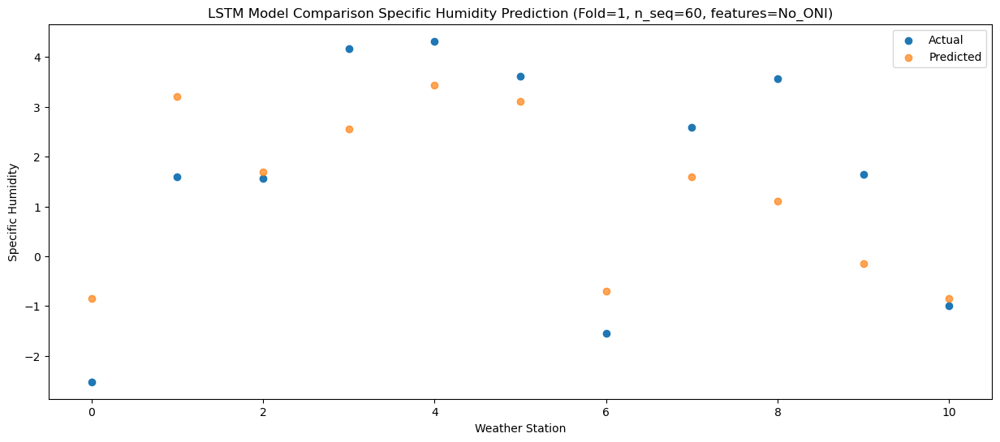

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0   -1.45   0.787821
1                 1    3.48   4.847821
2                 2    3.56   3.337821
3                 3    6.42   4.187821
4                 4    6.52   5.077821
5                 5    4.25   4.747821
6                 6    0.61   0.937821
7                 7    4.36   3.227821
8                 8    5.89   2.737821
9                 9    2.50   1.487821
10               10    0.61   0.787821


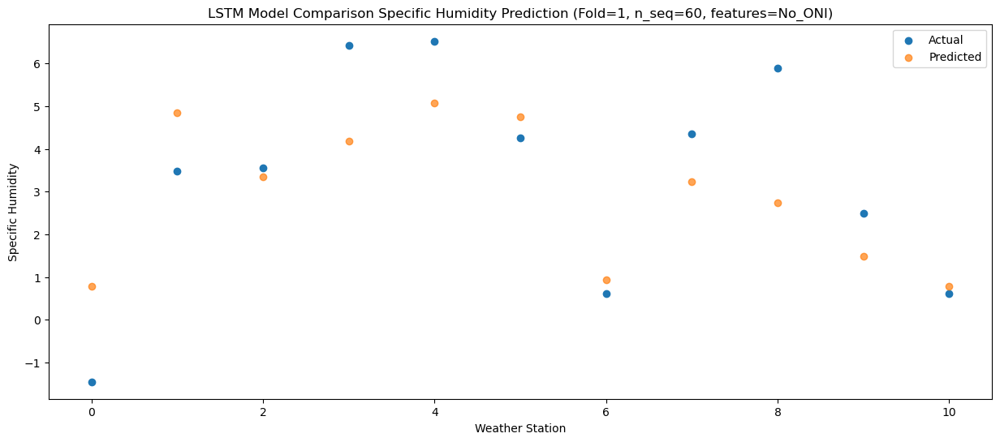

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    2.75   4.590751
1                 1    7.28   8.650751
2                 2    7.69   7.140751
3                 3   10.77   7.990751
4                 4   10.50   8.880751
5                 5    6.68   8.550751
6                 6    4.75   4.740751
7                 7    8.67   7.030751
8                 8    9.49   6.540751
9                 9    5.23   5.290751
10               10    4.19   4.590751


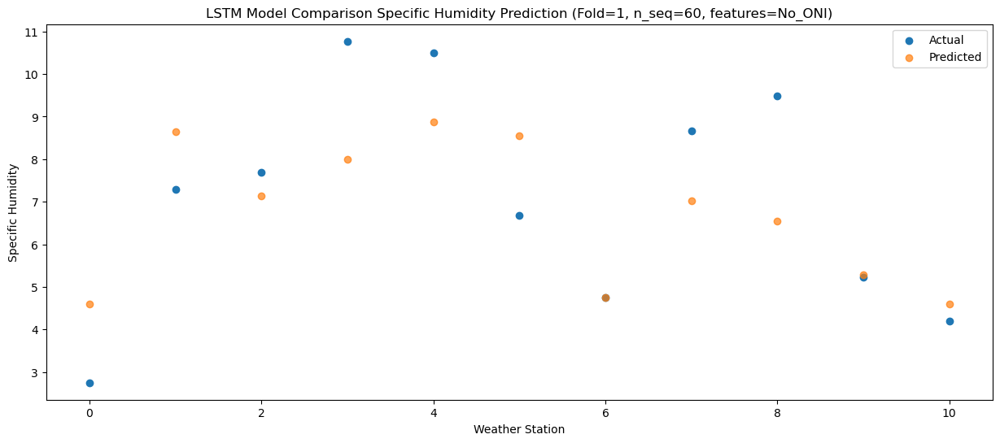

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0    4.82   7.387917
1                 1    8.79  11.447917
2                 2    9.12   9.937917
3                 3   12.16  10.787917
4                 4   12.01  11.677917
5                 5   11.53  11.347917
6                 6    6.71   7.537917
7                 7   10.69   9.827917
8                 8   12.40   9.337917
9                 9   10.90   8.087917
10               10    6.01   7.387917


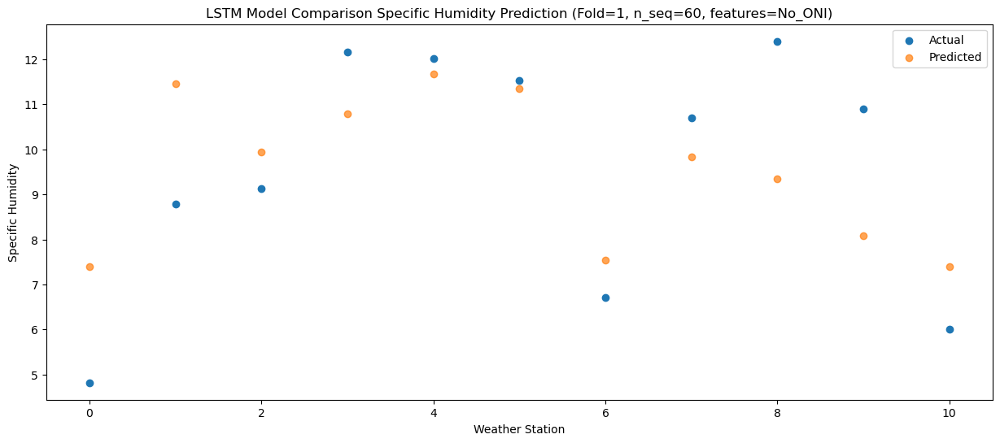

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0    7.24   8.631295
1                 1   11.39  12.691295
2                 2   12.29  11.181295
3                 3   12.24  12.031295
4                 4   12.33  12.921295
5                 5   11.38  12.591295
6                 6    9.09   8.781295
7                 7   11.36  11.071295
8                 8   11.01  10.581295
9                 9    9.15   9.331295
10               10    9.38   8.631295


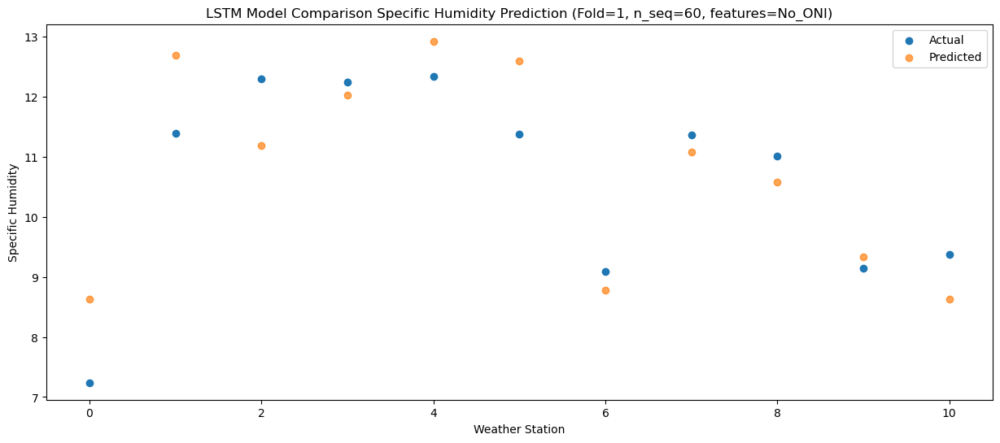

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0    6.60    8.17514
1                 1    9.66   12.23514
2                 2   10.17   10.72514
3                 3   12.33   11.57514
4                 4   12.38   12.46514
5                 5   10.24   12.13514
6                 6    7.37    8.32514
7                 7   10.12   10.61514
8                 8   10.42   10.12514
9                 9    9.34    8.87514
10               10    7.80    8.17514


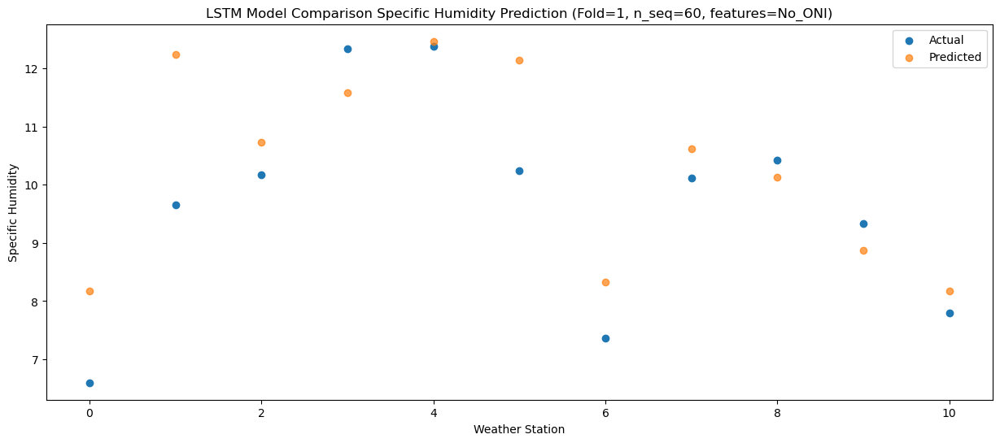

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    4.61   6.339728
1                 1    8.14  10.399728
2                 2    8.62   8.889728
3                 3    9.41   9.739728
4                 4    9.84  10.629728
5                 5   10.72  10.299728
6                 6    6.08   6.489728
7                 7    8.36   8.779728
8                 8    8.51   8.289728
9                 9    6.90   7.039728
10               10    5.31   6.339728


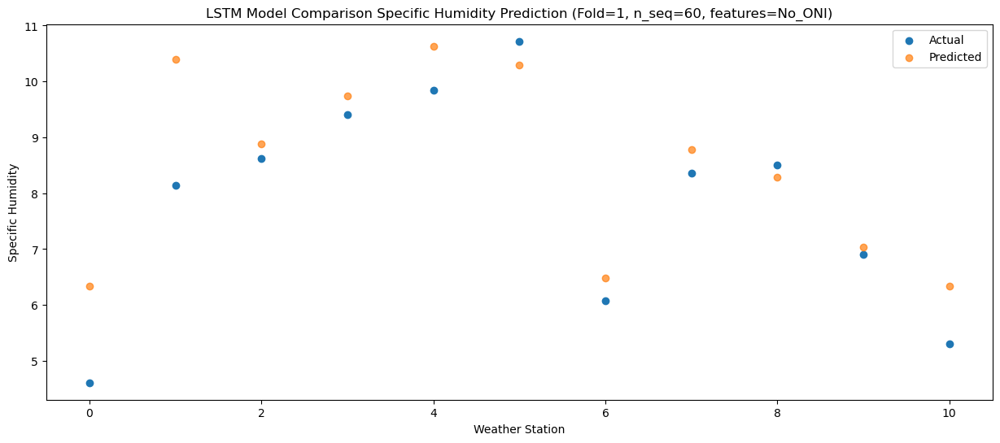

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0   -0.34    1.67507
1                 1    4.31    5.73507
2                 2    4.12    4.22507
3                 3    5.36    5.07507
4                 4    5.51    5.96507
5                 5    6.45    5.63507
6                 6    1.94    1.82507
7                 7    3.32    4.11507
8                 8    5.15    3.62507
9                 9    3.91    2.37507
10               10    1.00    1.67507


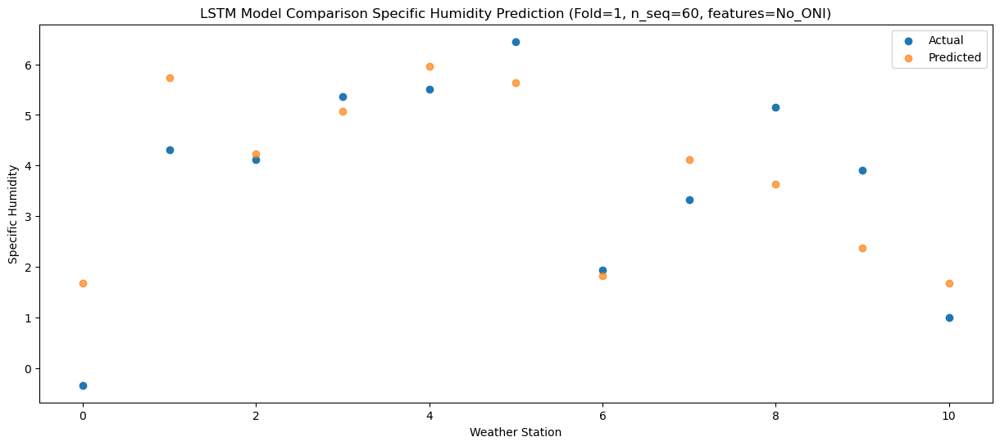

f, t:
[[-3.880e+00  1.110e+00 -5.000e-02  1.890e+00  2.440e+00  4.760e+00
  -2.550e+00  1.260e+00  2.020e+00  1.350e+00 -1.820e+00]
 [-3.280e+00  1.160e+00  8.600e-01  6.900e-01  1.200e+00  3.280e+00
  -2.520e+00  9.300e-01  1.180e+00  7.000e-01 -1.830e+00]
 [-3.470e+00  9.100e-01  3.500e-01  1.590e+00  2.110e+00  3.000e+00
  -2.940e+00  8.500e-01  1.630e+00  5.500e-01 -1.980e+00]
 [-3.560e+00  1.430e+00  7.400e-01  8.900e-01  1.430e+00  3.180e+00
  -2.460e+00  7.300e-01  1.010e+00  5.600e-01 -1.910e+00]
 [-1.260e+00  3.660e+00  3.900e+00  5.250e+00  6.160e+00  5.850e+00
  -4.900e-01  3.390e+00  4.030e+00  2.450e+00 -9.600e-01]
 [-1.520e+00  2.070e+00  2.280e+00  4.910e+00  5.850e+00  4.840e+00
  -1.140e+00  3.650e+00  4.220e+00  2.610e+00 -6.700e-01]
 [ 1.380e+00  5.080e+00  5.050e+00  6.890e+00  7.970e+00  7.520e+00
   2.060e+00  6.550e+00  7.550e+00  5.430e+00  1.900e+00]
 [ 4.620e+00  8.880e+00  8.900e+00  9.010e+00  1.026e+01  9.340e+00
   5.700e+00  1.038e+01  9.690e+00  7.140e+0

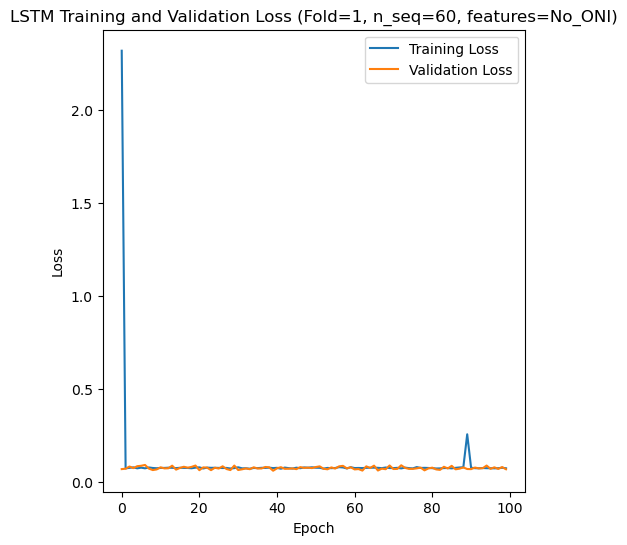

[[ 4.97  3.84  5.83 ... 12.86  8.48  8.25]
 [ 2.46  2.06  3.48 ...  9.57  6.71  5.1 ]
 [ 8.78  8.15  9.01 ... 20.36 15.38 12.95]
 ...
 [ 1.89  2.51  2.73 ...  7.42  4.53  3.35]
 [ 5.04  4.9   5.93 ... 10.09  8.19  4.88]
 [ 5.06  3.79  4.84 ... 13.58  8.96  7.8 ]]
Epoch 1/100
84/84 [==============================] - 43s 233ms/step - loss: 4.2942 - accuracy: 0.3333 - mae: 4.1158 - rmse: 4.2942 - mape: 930.2440 - pearson: 0.5265 - val_loss: 0.0558 - val_accuracy: 0.8000 - val_mae: 0.0440 - val_rmse: 0.0558 - val_mape: 9.7276 - val_pearson: 0.8617
Epoch 2/100
84/84 [==============================] - 13s 148ms/step - loss: 0.0767 - accuracy: 0.3810 - mae: 0.0607 - rmse: 0.0767 - mape: 13.6687 - pearson: 0.7248 - val_loss: 0.0536 - val_accuracy: 0.8000 - val_mae: 0.0433 - val_rmse: 0.0536 - val_mape: 10.0169 - val_pearson: 0.8677
Epoch 3/100
84/84 [==============================] - 13s 158ms/step - loss: 0.0768 - accuracy: 0.4167 - mae: 0.0599 - rmse: 0.0768 - mape: 13.5609 - pearson: 0.7362

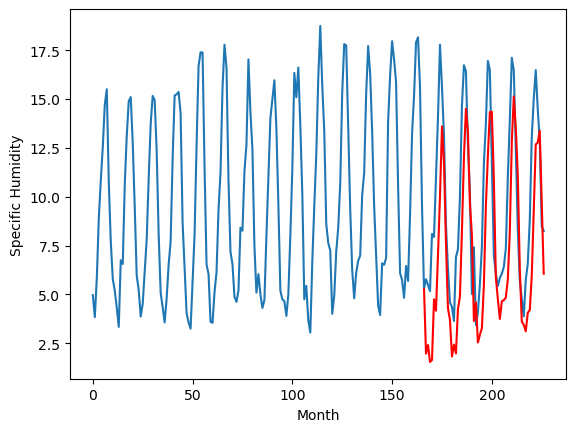

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
3.34		1.88		-1.46
2.83		2.32		-0.51
2.81		1.46		-1.35
2.87		1.55		-1.32
4.66		4.66		0.00
4.95		4.08		-0.87
7.85		6.93		-0.92
9.27		9.92		0.65
14.08		13.51		-0.57
12.65		11.65		-1.00
8.59		7.52		-1.07
4.86		4.20		-0.66
4.64		3.61		-1.03
2.91		1.73		-1.18
2.86		2.35		-0.51
2.18		1.89		-0.29
4.03		4.16		0.13
4.15		4.81		0.66
9.27		8.15		-1.12
12.18		11.91		-0.27
13.79		14.41		0.62
12.17		13.24		1.07
9.35		9.54		0.19
5.96		7.97		2.01
3.53		3.55		0.02
2.47		4.51		2.04
2.14		2.45		0.31
2.05		2.84		0.79
2.93		3.19		0.26
4.08		5.38		1.30
6.47		9.44		2.97
10.83		12.00		1.17
12.17		14.24		2.07
11.67		14.26		2.59
9.10		10.78		1.68
5.42		5.78		0.36
3.92		4.68		0.76
2.73		3.66		0.93
2.72		4.56		1.84
2.64		4.62		1.98
3.33		4.75		1.42
3.95		5.70		1.75
9.73		8.12		-1.61
12.38		12.73		0.35
14.44		15.04		0.60
12.55		13.45		0.90
9.96		11.03		1.07
6.50		6.23		-0.27
3.94		3.53		-0.41
3.55		3.35		-0.20
2.96		3.03	

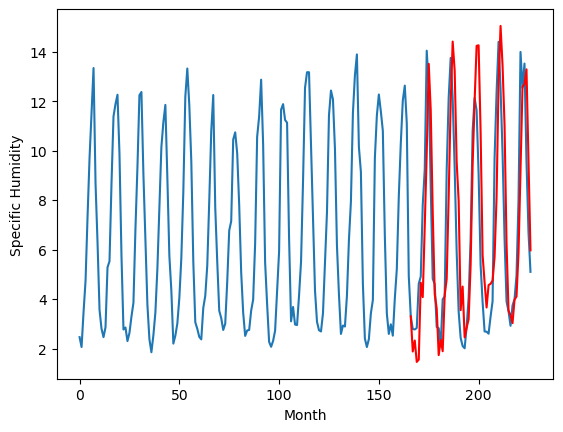

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-2.46		-0.63		1.83
-2.15		-0.19		1.96
-3.71		-1.05		2.66
-2.83		-0.96		1.87
-1.66		2.15		3.81
-0.18		1.57		1.75
0.93		4.42		3.49
4.27		7.41		3.14
5.29		11.00		5.71
5.99		9.14		3.15
5.29		5.01		-0.28
2.70		1.69		-1.01
-0.25		1.10		1.35
-4.92		-0.78		4.14
-4.43		-0.16		4.27
-2.30		-0.62		1.68
-2.08		1.65		3.73
-1.11		2.30		3.41
0.20		5.64		5.44
3.98		9.40		5.42
4.38		11.90		7.52
5.00		10.73		5.73
3.72		7.03		3.31
1.06		5.46		4.40
-2.89		1.04		3.93
-1.49		2.00		3.49
-5.14		-0.06		5.08
-3.95		0.33		4.28
-2.14		0.68		2.82
-0.78		2.87		3.65
2.32		6.93		4.61
4.25		9.49		5.24
5.08		11.73		6.65
4.97		11.75		6.78
4.82		8.27		3.45
0.43		3.27		2.84
0.32		2.17		1.85
-3.34		1.15		4.49
-3.72		2.05		5.77
-1.87		2.11		3.98
-1.48		2.24		3.72
0.03		3.19		3.16
0.84		5.61		4.77
4.00		10.22		6.22
4.97		12.53		7.56
5.69		10.94		5.25
3.30		8.52		5.22
0.38		3.72		3.34
-2.12		1.02		3.14
-2.69		0.84		3.53
-3.76		0.52		

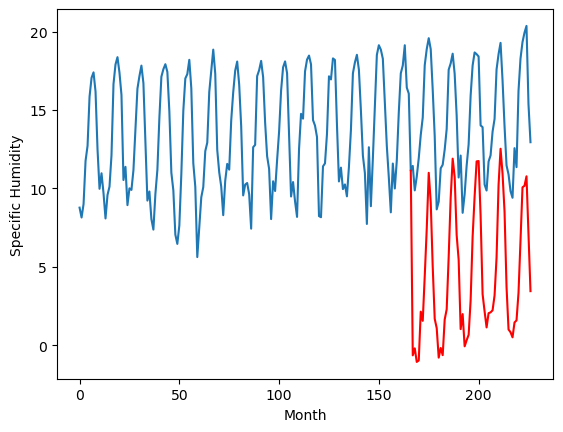

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
4.49		5.69		1.20
3.93		6.13		2.20
3.75		5.27		1.52
3.77		5.36		1.59
4.29		8.47		4.18
4.67		7.89		3.22
6.92		10.74		3.82
10.93		13.73		2.80
14.31		17.32		3.01
13.48		15.46		1.98
10.39		11.33		0.94
7.88		8.01		0.13
6.01		7.42		1.41
4.09		5.54		1.45
3.01		6.16		3.15
3.18		5.70		2.52
3.82		7.97		4.15
5.17		8.62		3.45
6.85		11.96		5.11
11.45		15.72		4.27
14.05		18.22		4.17
14.79		17.05		2.26
12.13		13.35		1.22
9.17		11.78		2.61
4.72		7.36		2.64
4.36		8.32		3.96
3.03		6.26		3.23
3.60		6.65		3.05
4.36		7.00		2.64
5.06		9.19		4.13
8.36		13.25		4.89
10.62		15.81		5.19
13.98		18.05		4.07
14.66		18.07		3.41
10.86		14.59		3.73
7.99		9.59		1.60
6.17		8.49		2.32
4.08		7.47		3.39
4.59		8.37		3.78
3.83		8.43		4.60
4.08		8.56		4.48
6.16		9.51		3.35
6.97		11.93		4.96
10.87		16.54		5.67
15.13		18.85		3.72
12.79		17.26		4.47
11.78		14.84		3.06
8.42		10.04		1.62
4.59		7.34		2.75
4.88		7.16		2.28
3.55		6.84		3.29


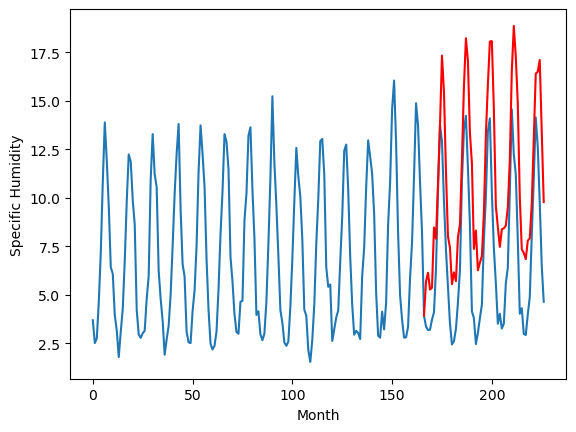

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-2.07		0.60		2.67
-1.27		1.04		2.31
-1.24		0.18		1.42
-0.92		0.27		1.19
2.57		3.38		0.81
1.61		2.80		1.19
3.73		5.65		1.92
7.07		8.64		1.57
9.20		12.23		3.03
8.47		10.37		1.90
6.67		6.24		-0.43
3.46		2.92		-0.54
0.73		2.33		1.60
-2.55		0.45		3.00
-2.42		1.07		3.49
-2.44		0.61		3.05
0.85		2.88		2.03
0.87		3.53		2.66
4.07		6.87		2.80
7.96		10.63		2.67
8.99		13.13		4.14
8.59		11.96		3.37
6.45		8.26		1.81
3.92		6.69		2.77
-1.74		2.27		4.01
1.54		3.23		1.69
-3.37		1.17		4.54
-1.91		1.56		3.47
-1.06		1.91		2.97
1.37		4.10		2.73
5.40		8.16		2.76
7.70		10.72		3.02
8.99		12.96		3.97
9.39		12.98		3.59
5.88		9.50		3.62
0.70		4.50		3.80
0.26		3.40		3.14
-0.29		2.38		2.67
-0.38		3.28		3.66
0.92		3.34		2.42
1.80		3.47		1.67
2.35		4.42		2.07
5.41		6.84		1.43
8.72		11.45		2.73
10.06		13.76		3.70
10.09		12.17		2.08
7.74		9.75		2.01
2.51		4.95		2.44
-0.01		2.25		2.26
-1.60		2.07		3.67
-2.47		1.75		4.22
-1.41		

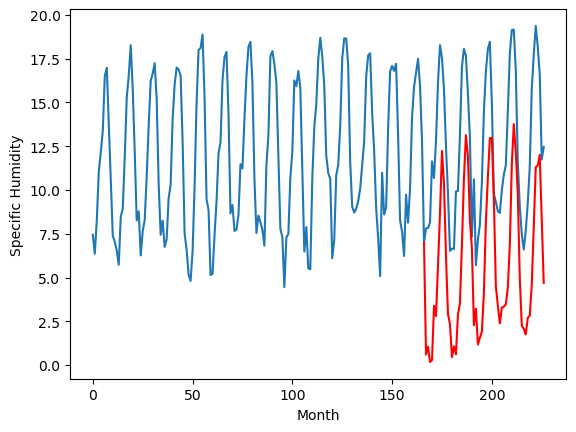

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
3.77		4.35		0.58
2.58		4.79		2.21
3.41		3.93		0.52
2.74		4.02		1.28
7.35		7.13		-0.22
6.83		6.55		-0.28
8.91		9.40		0.49
11.03		12.39		1.36
13.61		15.98		2.37
12.17		14.12		1.95
10.72		9.99		-0.73
6.85		6.67		-0.18
4.79		6.08		1.29
2.47		4.20		1.73
2.34		4.82		2.48
2.29		4.36		2.07
5.28		6.63		1.35
6.85		7.28		0.43
11.68		10.62		-1.06
14.32		14.38		0.06
13.28		16.88		3.60
13.41		15.71		2.30
9.85		12.01		2.16
8.26		10.44		2.18
4.07		6.02		1.95
6.94		6.98		0.04
1.31		4.92		3.61
1.53		5.31		3.78
3.15		5.66		2.51
7.11		7.85		0.74
10.76		11.91		1.15
11.79		14.47		2.68
12.89		16.71		3.82
13.35		16.73		3.38
9.99		13.25		3.26
5.17		8.25		3.08
5.03		7.15		2.12
4.12		6.13		2.01
3.74		7.03		3.29
4.19		7.09		2.90
5.97		7.22		1.25
6.52		8.17		1.65
10.22		10.59		0.37
13.68		15.20		1.52
13.39		17.51		4.12
11.96		15.92		3.96
11.41		13.50		2.09
7.88		8.70		0.82
4.71		6.00		1.29
2.78		5.82		3.04
1.77		5.50		3.

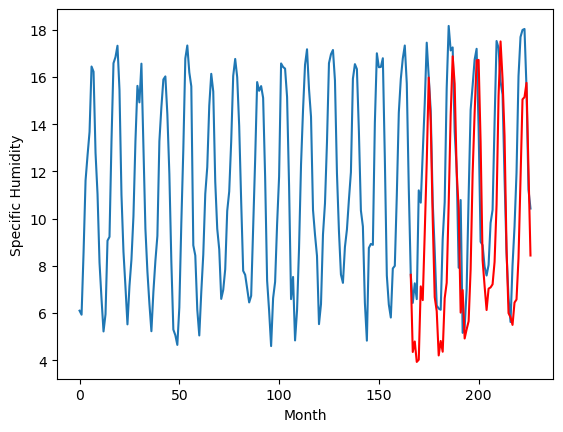

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.89		3.01		0.12
1.79		3.45		1.66
2.47		2.59		0.12
1.91		2.68		0.77
6.13		5.79		-0.34
5.71		5.21		-0.50
8.65		8.06		-0.59
10.93		11.05		0.12
13.84		14.64		0.80
11.14		12.78		1.64
10.20		8.65		-1.55
5.71		5.33		-0.38
4.12		4.74		0.62
1.41		2.86		1.45
1.31		3.48		2.17
0.98		3.02		2.04
3.84		5.29		1.45
5.16		5.94		0.78
9.36		9.28		-0.08
13.11		13.04		-0.07
13.93		15.54		1.61
14.31		14.37		0.06
9.86		10.67		0.81
7.25		9.10		1.85
3.26		4.68		1.42
5.76		5.64		-0.12
0.47		3.58		3.11
0.94		3.97		3.03
2.57		4.32		1.75
6.47		6.51		0.04
10.56		10.57		0.01
11.36		13.13		1.77
10.68		15.37		4.69
11.74		15.39		3.65
9.07		11.91		2.84
4.29		6.91		2.62
3.84		5.81		1.97
2.67		4.79		2.12
1.89		5.69		3.80
2.29		5.75		3.46
4.20		5.88		1.68
4.87		6.83		1.96
8.76		9.25		0.49
12.66		13.86		1.20
11.95		16.17		4.22
9.90		14.58		4.68
9.27		12.16		2.89
6.12		7.36		1.24
3.50		4.66		1.16
1.68		4.48		2.80
0.56		4.16		3.60
3

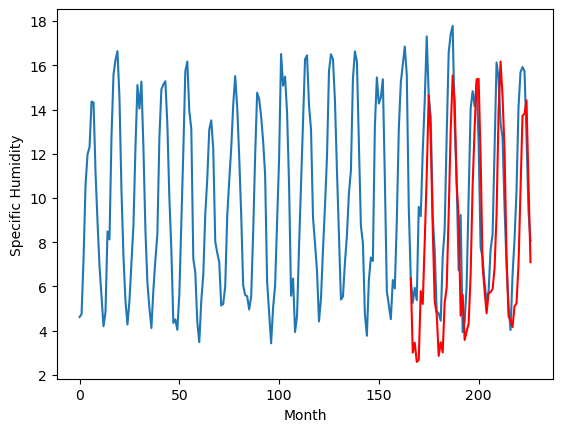

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
3.55		1.53		-2.02
3.10		1.97		-1.13
2.15		1.11		-1.04
2.68		1.20		-1.48
4.14		4.31		0.17
2.74		3.73		0.99
2.98		6.58		3.60
4.66		9.57		4.91
8.10		13.16		5.06
6.37		11.30		4.93
5.72		7.17		1.45
2.65		3.85		1.20
2.70		3.26		0.56
1.44		1.38		-0.06
1.72		2.00		0.28
1.59		1.54		-0.05
1.68		3.81		2.13
1.98		4.46		2.48
2.10		7.80		5.70
4.76		11.56		6.80
10.00		14.06		4.06
10.29		12.89		2.60
7.53		9.19		1.66
3.82		7.62		3.80
2.17		3.20		1.03
2.30		4.16		1.86
2.02		2.10		0.08
1.03		2.49		1.46
1.43		2.84		1.41
1.44		5.03		3.59
1.37		9.09		7.72
6.87		11.65		4.78
9.43		13.89		4.46
11.40		13.91		2.51
8.36		10.43		2.07
6.28		5.43		-0.85
2.31		4.33		2.02
3.13		3.31		0.18
2.24		4.21		1.97
2.12		4.27		2.15
2.46		4.40		1.94
1.62		5.35		3.73
3.62		7.77		4.15
3.42		12.38		8.96
6.77		14.69		7.92
8.96		13.10		4.14
7.15		10.68		3.53
4.70		5.88		1.18
3.78		3.18		-0.60
2.26		3.00		0.74
2.68		2.68		-0.00
2.70		3.62		0

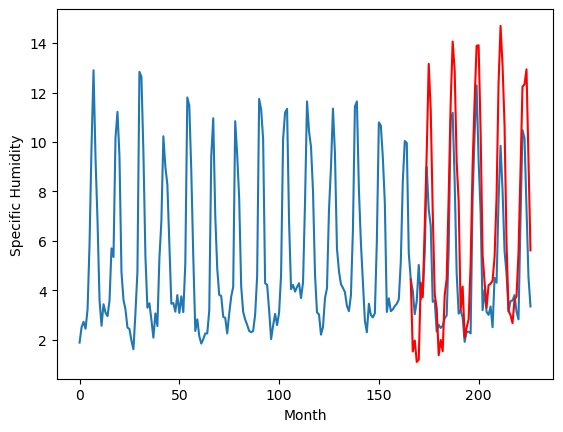

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.23		-1.20		-3.43
2.05		-0.76		-2.81
1.84		-1.62		-3.46
1.12		-1.53		-2.65
2.76		1.58		-1.18
4.17		1.00		-3.17
4.93		3.85		-1.08
4.91		6.84		1.93
5.68		10.43		4.75
6.76		8.57		1.81
4.98		4.44		-0.54
3.85		1.12		-2.73
1.61		0.53		-1.08
0.04		-1.35		-1.39
0.89		-0.73		-1.62
1.42		-1.19		-2.61
1.53		1.08		-0.45
2.85		1.73		-1.12
4.33		5.07		0.74
5.58		8.83		3.25
6.73		11.33		4.60
6.13		10.16		4.03
5.67		6.46		0.79
2.87		4.89		2.02
2.33		0.47		-1.86
2.15		1.43		-0.72
0.79		-0.63		-1.42
0.05		-0.24		-0.29
1.79		0.11		-1.68
2.63		2.30		-0.33
3.89		6.36		2.47
5.66		8.92		3.26
6.55		11.16		4.61
6.65		11.18		4.53
7.50		7.70		0.20
5.73		2.70		-3.03
1.09		1.60		0.51
1.94		0.58		-1.36
2.03		1.48		-0.55
0.62		1.54		0.92
2.54		1.67		-0.87
3.24		2.62		-0.62
4.64		5.04		0.40
5.02		9.65		4.63
6.36		11.96		5.60
6.97		10.37		3.40
6.72		7.95		1.23
4.42		3.15		-1.27
1.39		0.45		-0.94
2.18		0.27		-1.91
2.15		-0.0

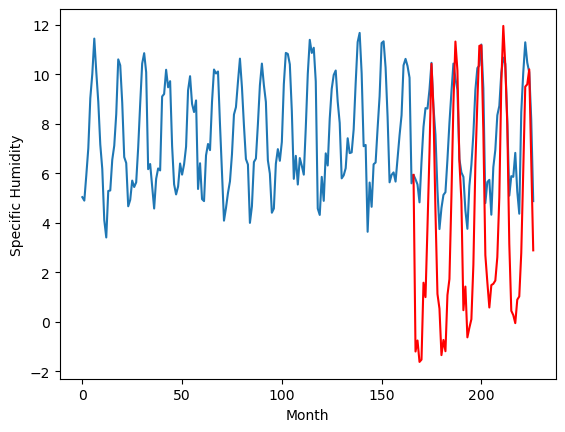

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.17		1.95		2.12
-0.06		2.39		2.45
-0.08		1.53		1.61
0.31		1.62		1.31
1.94		4.73		2.79
1.85		4.15		2.30
5.18		7.00		1.82
8.69		9.99		1.30
11.54		13.58		2.04
11.53		11.72		0.19
7.81		7.59		-0.22
5.19		4.27		-0.92
2.54		3.68		1.14
-0.68		1.80		2.48
-0.80		2.42		3.22
-0.73		1.96		2.69
1.00		4.23		3.23
1.53		4.88		3.35
4.24		8.22		3.98
8.74		11.98		3.24
10.26		14.48		4.22
10.84		13.31		2.47
7.24		9.61		2.37
5.08		8.04		2.96
-0.48		3.62		4.10
1.37		4.58		3.21
-1.41		2.52		3.93
-0.10		2.91		3.01
0.86		3.26		2.40
1.90		5.45		3.55
6.22		9.51		3.29
8.02		12.07		4.05
11.60		14.31		2.71
10.03		14.33		4.30
6.60		10.85		4.25
2.24		5.85		3.61
1.77		4.75		2.98
-0.47		3.73		4.20
0.39		4.63		4.24
1.15		4.69		3.54
0.84		4.82		3.98
2.97		5.77		2.80
4.50		8.19		3.69
7.36		12.80		5.44
11.20		15.11		3.91
10.71		13.52		2.81
7.57		11.10		3.53
3.38		6.30		2.92
0.27		3.60		3.33
0.18		3.42		3.24
-0.51		3.10		3.61
-0.

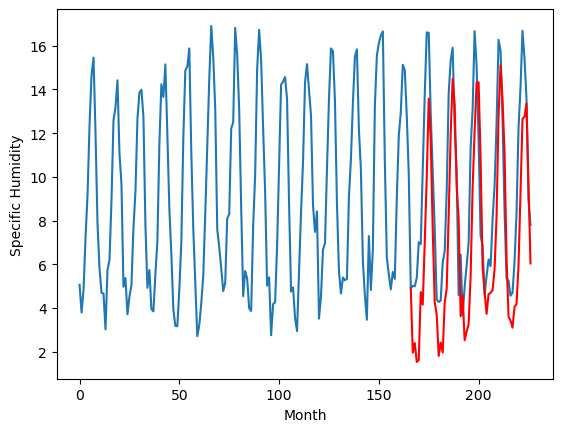

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.52		1.97		1.45
0.97		2.41		1.44
0.77		1.55		0.78
0.88		1.64		0.76
2.73		4.75		2.02
2.16		4.17		2.01
4.95		7.02		2.07
8.39		10.01		1.62
11.09		13.60		2.51
10.85		11.74		0.89
8.24		7.61		-0.63
5.05		4.29		-0.76
1.93		3.70		1.77
0.14		1.82		1.68
0.15		2.44		2.29
0.39		1.98		1.59
1.42		4.25		2.83
2.03		4.90		2.87
4.70		8.24		3.54
8.80		12.00		3.20
10.21		14.50		4.29
10.60		13.33		2.73
7.39		9.63		2.24
5.66		8.06		2.40
0.30		3.64		3.34
1.86		4.60		2.74
-0.56		2.54		3.10
0.34		2.93		2.59
0.96		3.28		2.32
2.23		5.47		3.24
6.39		9.53		3.14
8.35		12.09		3.74
11.56		14.33		2.77
10.57		14.35		3.78
7.09		10.87		3.78
2.43		5.87		3.44
1.81		4.77		2.96
0.72		3.75		3.03
0.99		4.65		3.66
1.39		4.71		3.32
0.99		4.84		3.85
2.63		5.79		3.16
5.22		8.21		2.99
7.06		12.82		5.76
10.37		15.13		4.76
10.48		13.54		3.06
8.06		11.12		3.06
3.95		6.32		2.37
1.00		3.62		2.62
0.79		3.44		2.65
0.17		3.12		2.95
0.57		4.06		

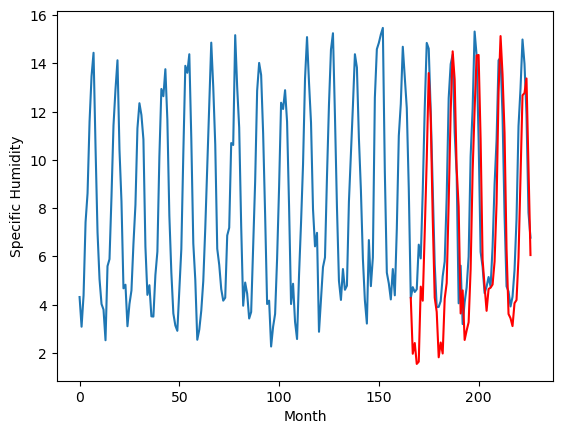

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    0.85   1.969825
1                 1    3.34   1.879825
2                 2   -2.46  -0.630175
3                 3    4.49   5.689825
4                 4   -2.07   0.599825
5                 5    3.77   4.349825
6                 6    2.89   3.009825
7                 7    3.55   1.529825
8                 8    2.23  -1.200175
9                 9   -0.17   1.949825
10               10    0.52   1.969825


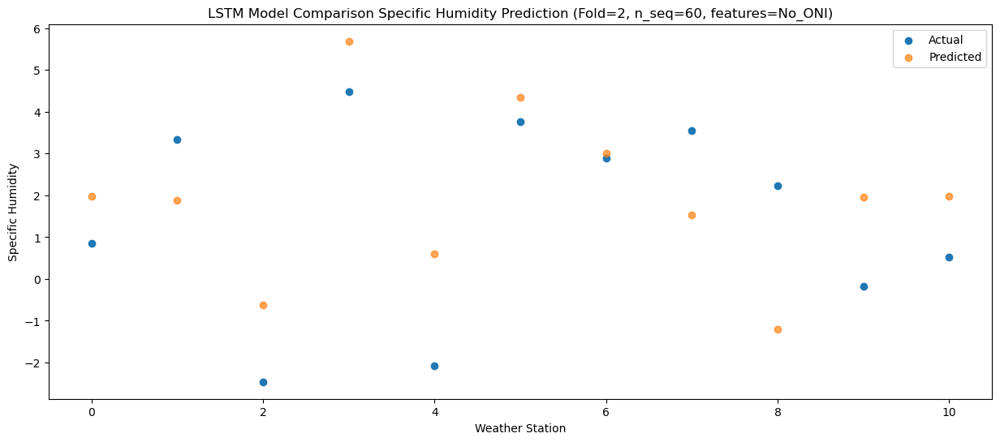

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    1.35   2.414511
1                 1    2.83   2.324511
2                 2   -2.15  -0.185489
3                 3    3.93   6.134511
4                 4   -1.27   1.044511
5                 5    2.58   4.794511
6                 6    1.79   3.454511
7                 7    3.10   1.974511
8                 8    2.05  -0.755489
9                 9   -0.06   2.394511
10               10    0.97   2.414511


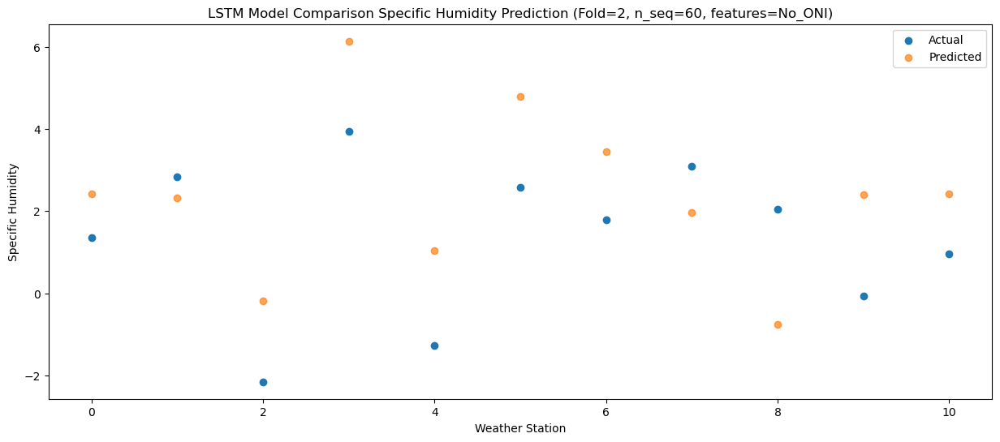

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0    1.06   1.548443
1                 1    2.81   1.458443
2                 2   -3.71  -1.051557
3                 3    3.75   5.268443
4                 4   -1.24   0.178443
5                 5    3.41   3.928443
6                 6    2.47   2.588443
7                 7    2.15   1.108443
8                 8    1.84  -1.621557
9                 9   -0.08   1.528443
10               10    0.77   1.548443


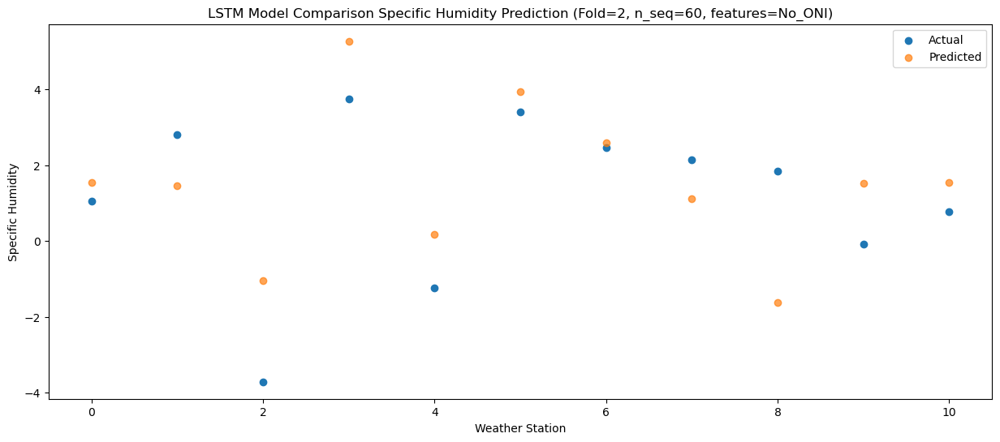

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0    0.74   1.641615
1                 1    2.87   1.551615
2                 2   -2.83  -0.958385
3                 3    3.77   5.361615
4                 4   -0.92   0.271615
5                 5    2.74   4.021615
6                 6    1.91   2.681615
7                 7    2.68   1.201615
8                 8    1.12  -1.528385
9                 9    0.31   1.621615
10               10    0.88   1.641615


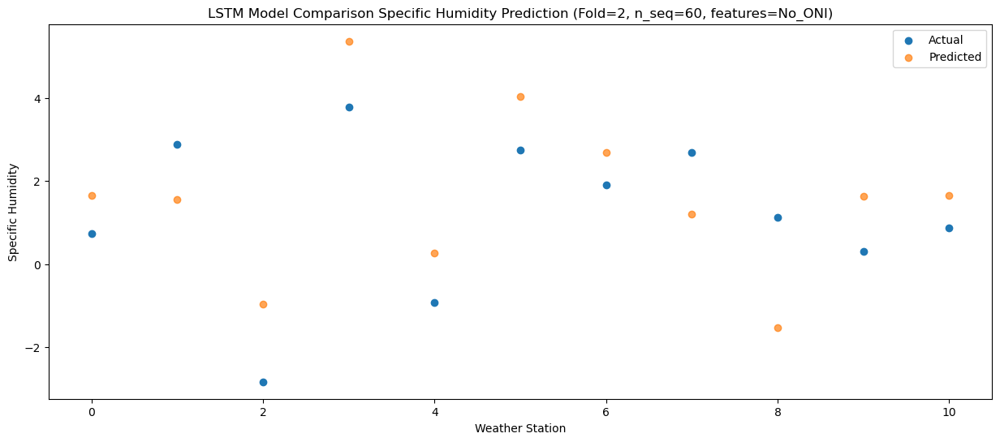

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    3.67   4.750674
1                 1    4.66   4.660674
2                 2   -1.66   2.150674
3                 3    4.29   8.470674
4                 4    2.57   3.380674
5                 5    7.35   7.130674
6                 6    6.13   5.790674
7                 7    4.14   4.310674
8                 8    2.76   1.580674
9                 9    1.94   4.730674
10               10    2.73   4.750674


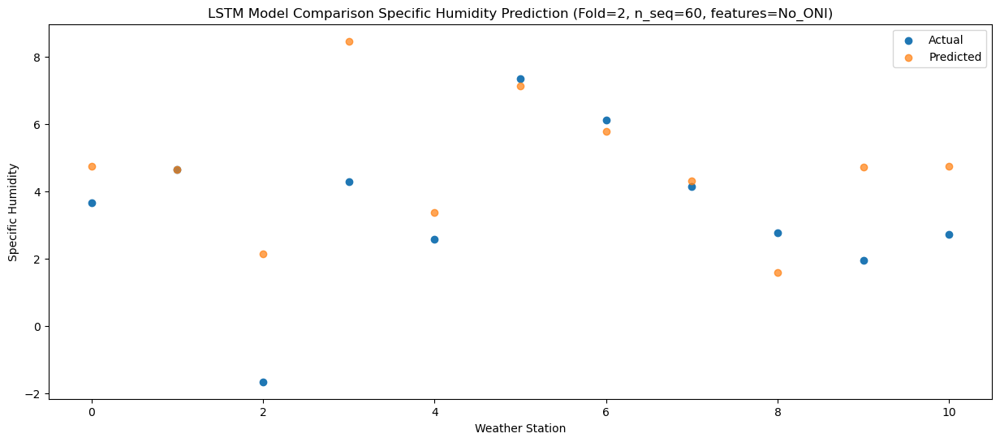

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    3.51   4.168191
1                 1    4.95   4.078191
2                 2   -0.18   1.568191
3                 3    4.67   7.888191
4                 4    1.61   2.798191
5                 5    6.83   6.548191
6                 6    5.71   5.208191
7                 7    2.74   3.728191
8                 8    4.17   0.998191
9                 9    1.85   4.148191
10               10    2.16   4.168191


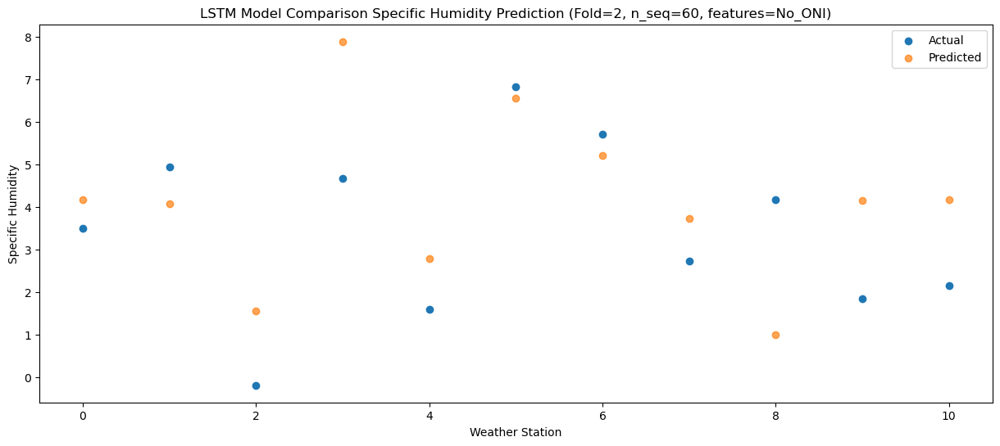

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    6.50   7.018321
1                 1    7.85   6.928321
2                 2    0.93   4.418321
3                 3    6.92  10.738321
4                 4    3.73   5.648321
5                 5    8.91   9.398321
6                 6    8.65   8.058321
7                 7    2.98   6.578321
8                 8    4.93   3.848321
9                 9    5.18   6.998321
10               10    4.95   7.018321


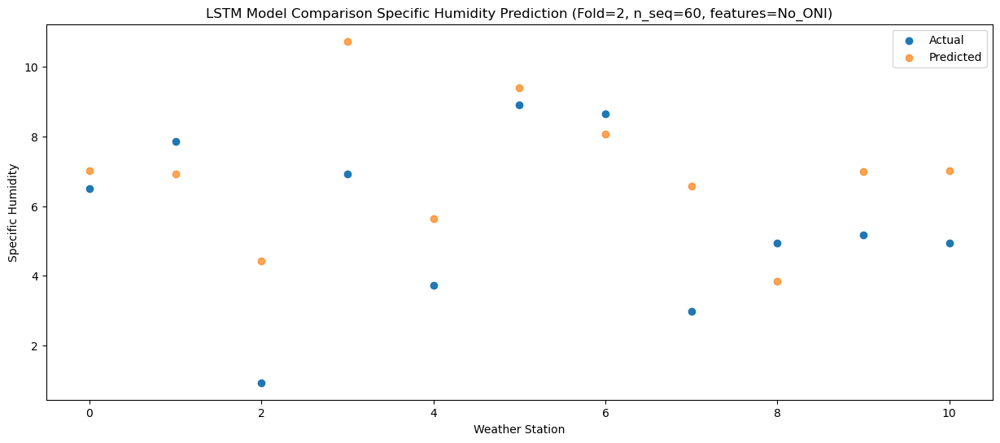

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0    9.65  10.014113
1                 1    9.27   9.924113
2                 2    4.27   7.414113
3                 3   10.93  13.734113
4                 4    7.07   8.644113
5                 5   11.03  12.394113
6                 6   10.93  11.054113
7                 7    4.66   9.574113
8                 8    4.91   6.844113
9                 9    8.69   9.994113
10               10    8.39  10.014113


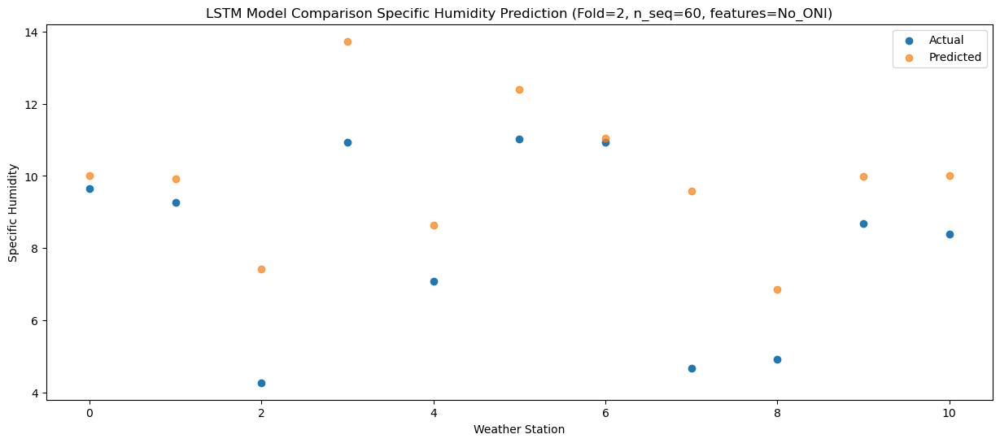

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   13.35  13.599328
1                 1   14.08  13.509328
2                 2    5.29  10.999328
3                 3   14.31  17.319328
4                 4    9.20  12.229328
5                 5   13.61  15.979328
6                 6   13.84  14.639328
7                 7    8.10  13.159328
8                 8    5.68  10.429328
9                 9   11.54  13.579328
10               10   11.09  13.599328


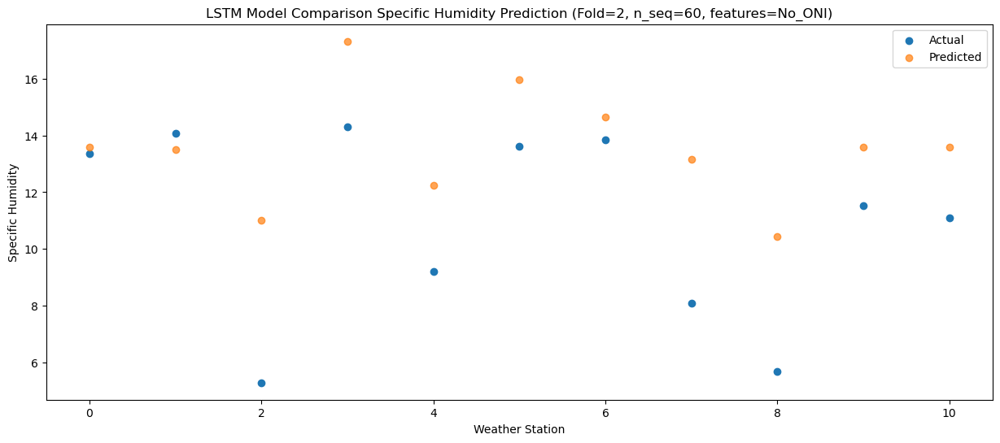

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   11.19  11.735885
1                 1   12.65  11.645885
2                 2    5.99   9.135885
3                 3   13.48  15.455885
4                 4    8.47  10.365885
5                 5   12.17  14.115885
6                 6   11.14  12.775885
7                 7    6.37  11.295885
8                 8    6.76   8.565885
9                 9   11.53  11.715885
10               10   10.85  11.735885


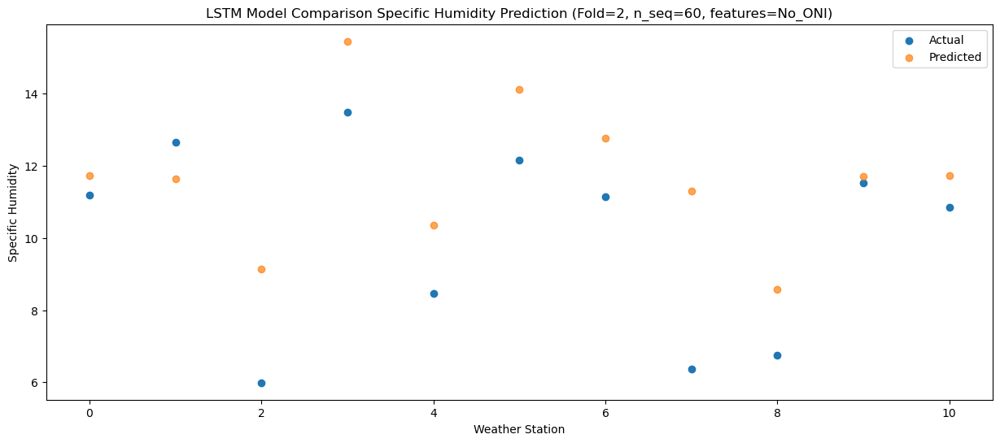

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    8.73   7.611011
1                 1    8.59   7.521011
2                 2    5.29   5.011011
3                 3   10.39  11.331011
4                 4    6.67   6.241011
5                 5   10.72   9.991011
6                 6   10.20   8.651011
7                 7    5.72   7.171011
8                 8    4.98   4.441011
9                 9    7.81   7.591011
10               10    8.24   7.611011


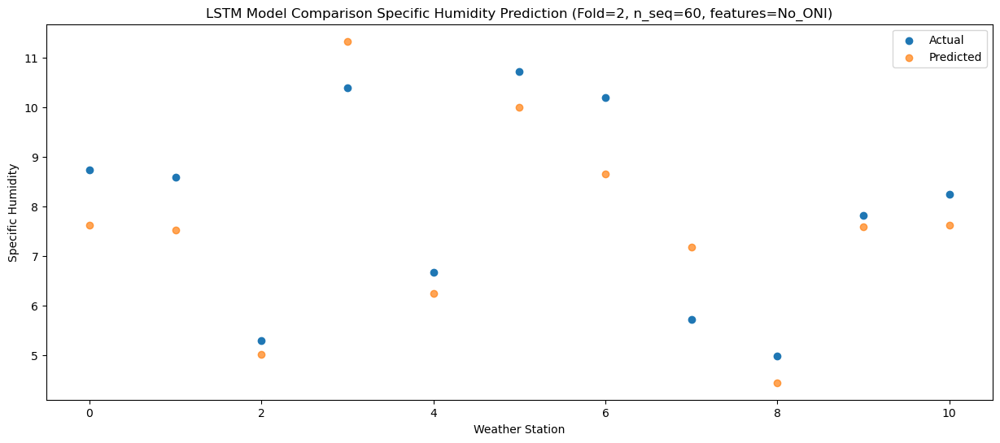

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    4.14   4.294887
1                 1    4.86   4.204887
2                 2    2.70   1.694887
3                 3    7.88   8.014887
4                 4    3.46   2.924887
5                 5    6.85   6.674887
6                 6    5.71   5.334887
7                 7    2.65   3.854887
8                 8    3.85   1.124887
9                 9    5.19   4.274887
10               10    5.05   4.294887


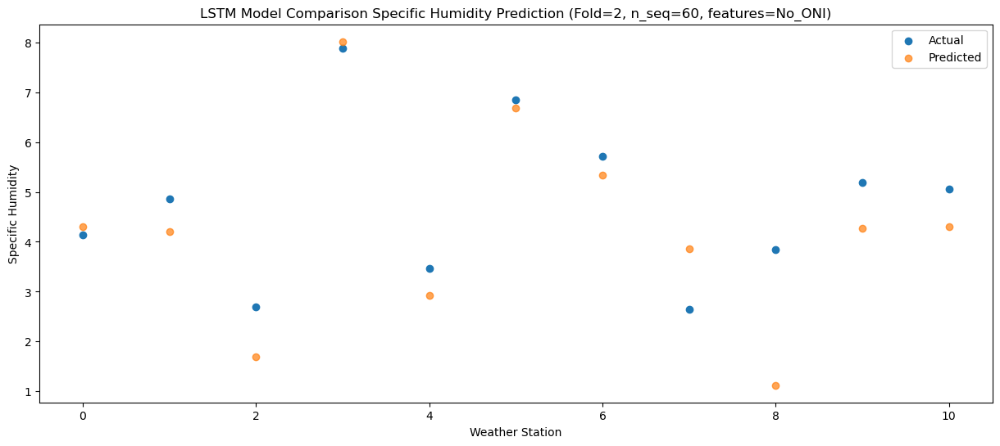

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    1.89   3.702939
1                 1    4.64   3.612939
2                 2   -0.25   1.102939
3                 3    6.01   7.422939
4                 4    0.73   2.332939
5                 5    4.79   6.082939
6                 6    4.12   4.742939
7                 7    2.70   3.262939
8                 8    1.61   0.532939
9                 9    2.54   3.682939
10               10    1.93   3.702939


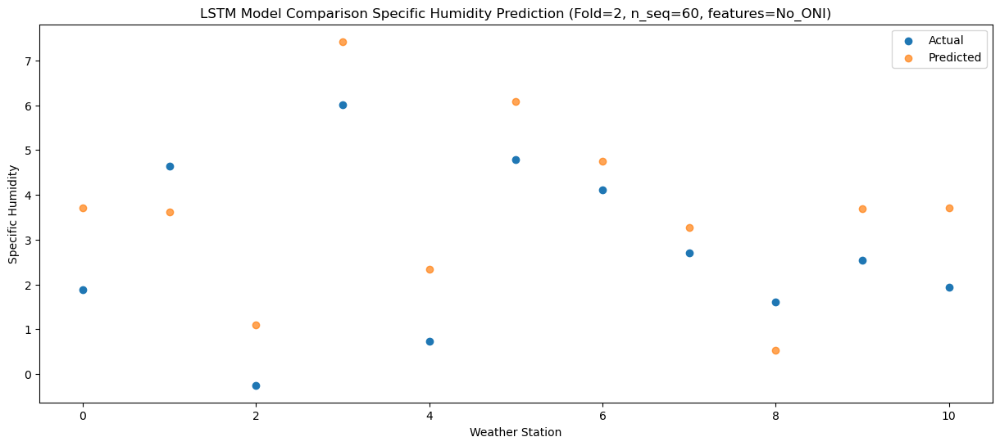

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0    0.16   1.823187
1                 1    2.91   1.733187
2                 2   -4.92  -0.776813
3                 3    4.09   5.543187
4                 4   -2.55   0.453187
5                 5    2.47   4.203187
6                 6    1.41   2.863187
7                 7    1.44   1.383187
8                 8    0.04  -1.346813
9                 9   -0.68   1.803187
10               10    0.14   1.823187


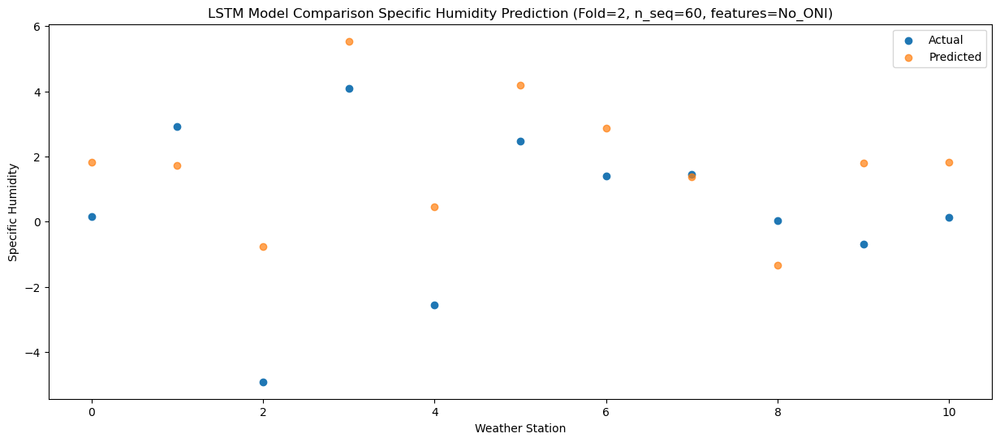

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -0.07   2.435873
1                 1    2.86   2.345873
2                 2   -4.43  -0.164127
3                 3    3.01   6.155873
4                 4   -2.42   1.065873
5                 5    2.34   4.815873
6                 6    1.31   3.475873
7                 7    1.72   1.995873
8                 8    0.89  -0.734127
9                 9   -0.80   2.415873
10               10    0.15   2.435873


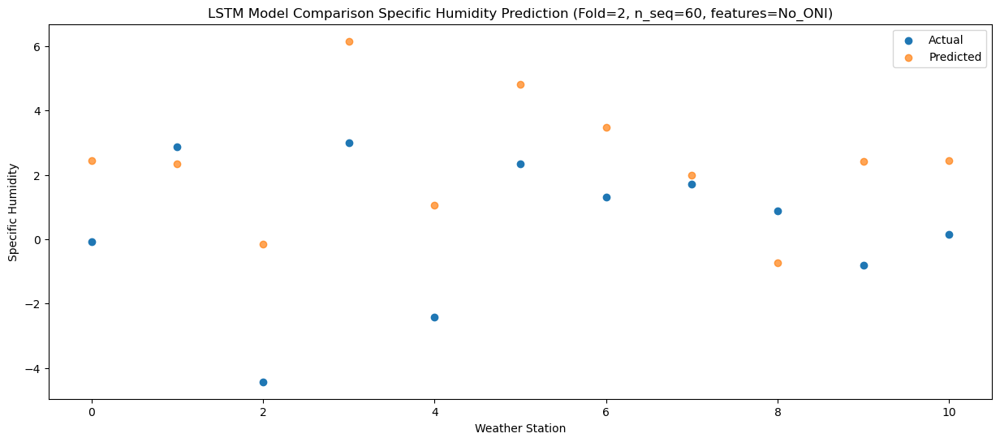

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -0.79   1.980745
1                 1    2.18   1.890745
2                 2   -2.30  -0.619255
3                 3    3.18   5.700745
4                 4   -2.44   0.610745
5                 5    2.29   4.360745
6                 6    0.98   3.020745
7                 7    1.59   1.540745
8                 8    1.42  -1.189255
9                 9   -0.73   1.960745
10               10    0.39   1.980745


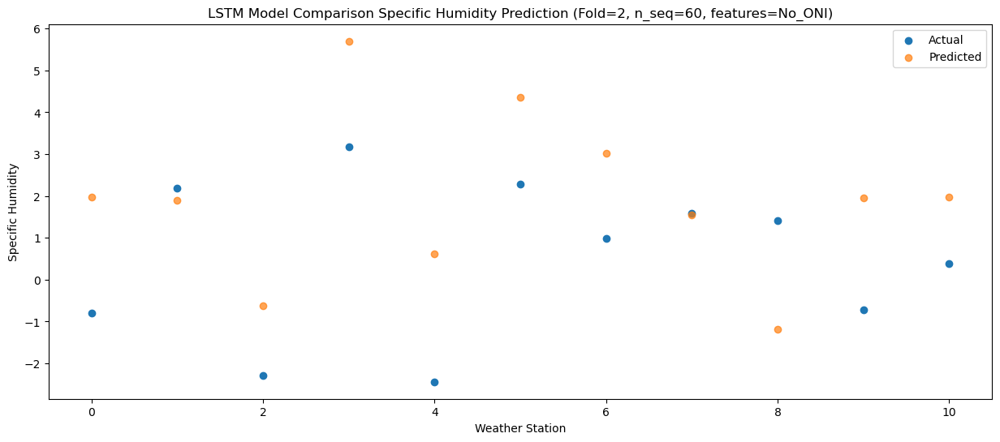

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    2.49   4.249069
1                 1    4.03   4.159069
2                 2   -2.08   1.649069
3                 3    3.82   7.969069
4                 4    0.85   2.879069
5                 5    5.28   6.629069
6                 6    3.84   5.289069
7                 7    1.68   3.809069
8                 8    1.53   1.079069
9                 9    1.00   4.229069
10               10    1.42   4.249069


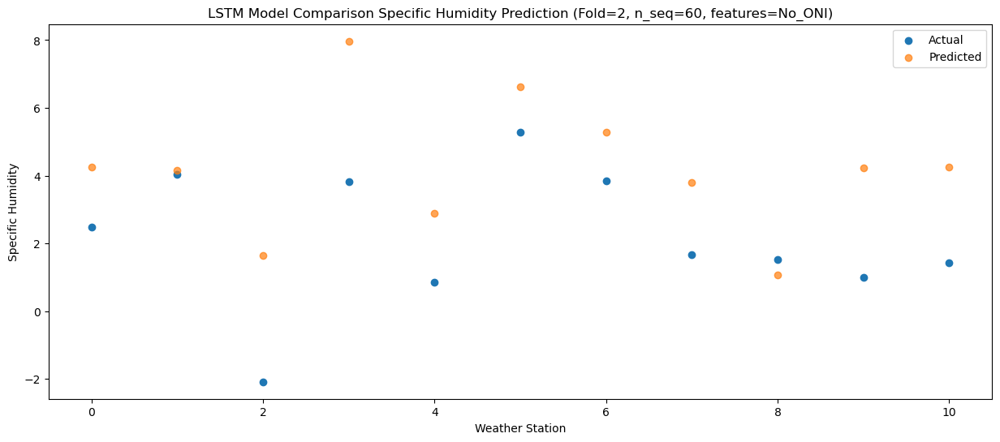

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    2.88   4.899445
1                 1    4.15   4.809445
2                 2   -1.11   2.299445
3                 3    5.17   8.619445
4                 4    0.87   3.529445
5                 5    6.85   7.279445
6                 6    5.16   5.939445
7                 7    1.98   4.459445
8                 8    2.85   1.729445
9                 9    1.53   4.879445
10               10    2.03   4.899445


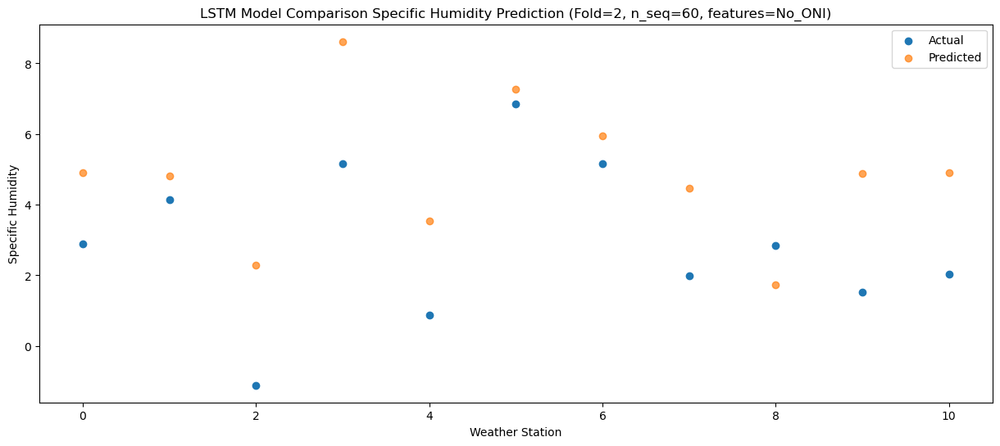

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    5.55   8.243483
1                 1    9.27   8.153483
2                 2    0.20   5.643483
3                 3    6.85  11.963483
4                 4    4.07   6.873483
5                 5   11.68  10.623483
6                 6    9.36   9.283483
7                 7    2.10   7.803483
8                 8    4.33   5.073483
9                 9    4.24   8.223483
10               10    4.70   8.243483


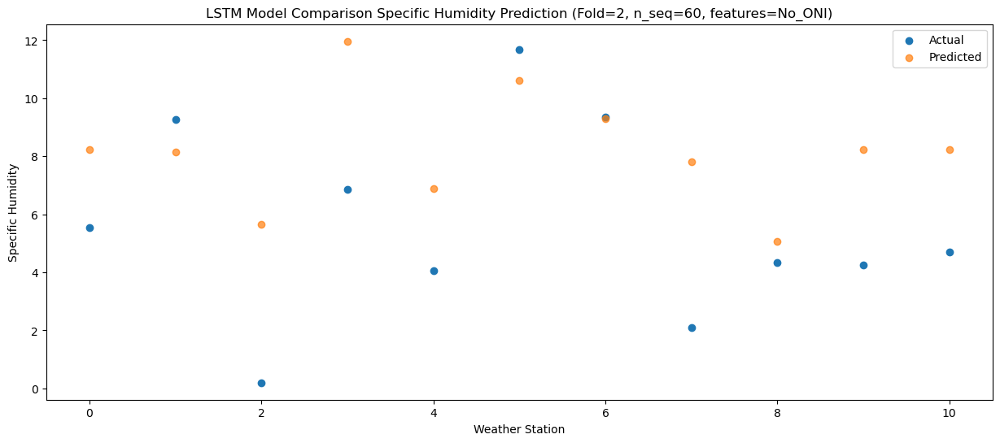

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   10.20  12.000663
1                 1   12.18  11.910663
2                 2    3.98   9.400663
3                 3   11.45  15.720663
4                 4    7.96  10.630663
5                 5   14.32  14.380663
6                 6   13.11  13.040663
7                 7    4.76  11.560663
8                 8    5.58   8.830663
9                 9    8.74  11.980663
10               10    8.80  12.000663


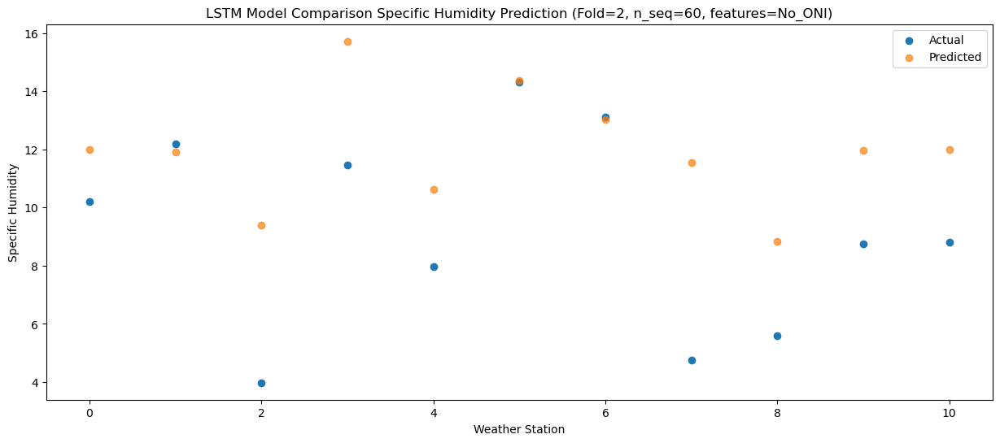

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   12.30  14.500436
1                 1   13.79  14.410436
2                 2    4.38  11.900436
3                 3   14.05  18.220436
4                 4    8.99  13.130436
5                 5   13.28  16.880436
6                 6   13.93  15.540436
7                 7   10.00  14.060436
8                 8    6.73  11.330436
9                 9   10.26  14.480436
10               10   10.21  14.500436


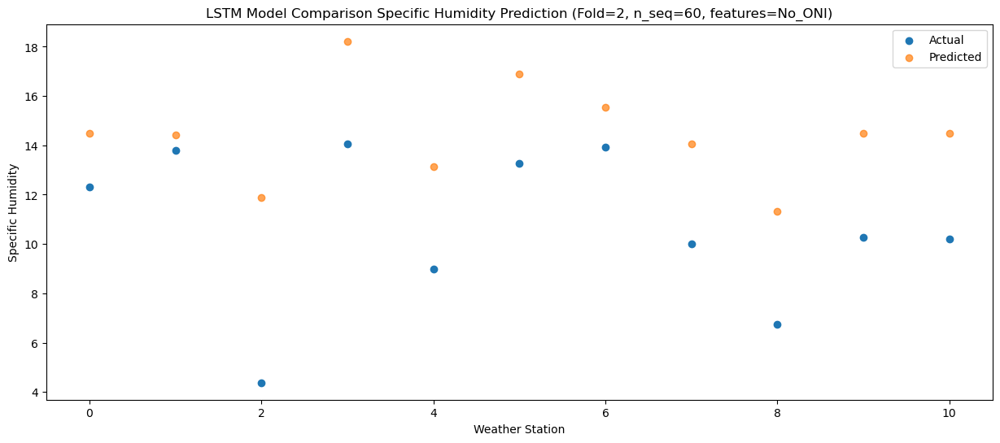

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   12.00  13.330526
1                 1   12.17  13.240526
2                 2    5.00  10.730526
3                 3   14.79  17.050526
4                 4    8.59  11.960526
5                 5   13.41  15.710526
6                 6   14.31  14.370526
7                 7   10.29  12.890526
8                 8    6.13  10.160526
9                 9   10.84  13.310526
10               10   10.60  13.330526


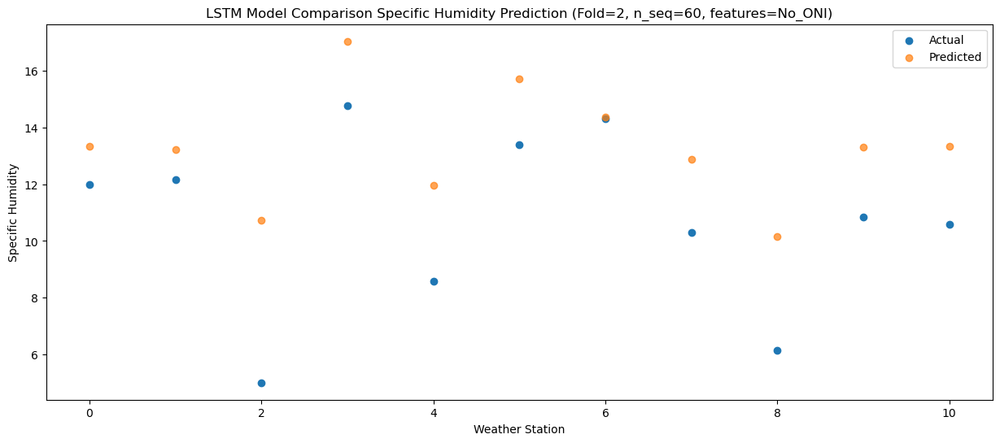

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    8.23   9.630709
1                 1    9.35   9.540709
2                 2    3.72   7.030709
3                 3   12.13  13.350709
4                 4    6.45   8.260709
5                 5    9.85  12.010709
6                 6    9.86  10.670709
7                 7    7.53   9.190709
8                 8    5.67   6.460709
9                 9    7.24   9.610709
10               10    7.39   9.630709


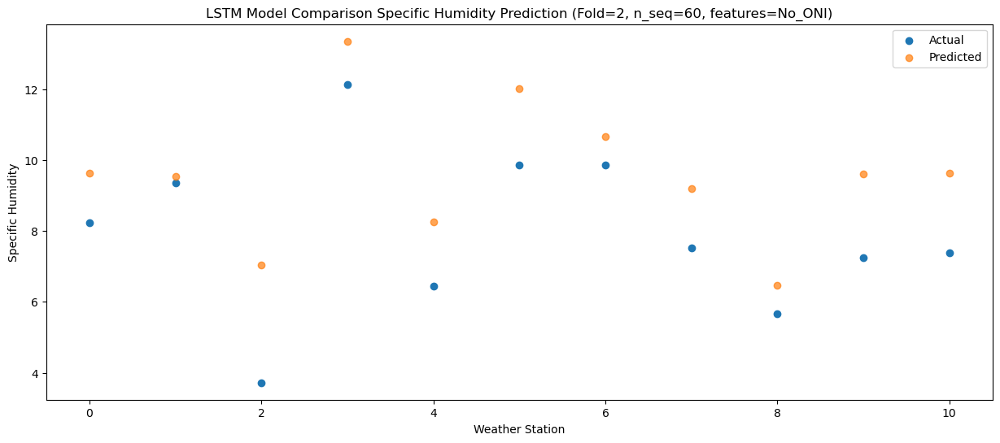

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    5.78   8.058381
1                 1    5.96   7.968381
2                 2    1.06   5.458381
3                 3    9.17  11.778381
4                 4    3.92   6.688381
5                 5    8.26  10.438381
6                 6    7.25   9.098381
7                 7    3.82   7.618381
8                 8    2.87   4.888381
9                 9    5.08   8.038381
10               10    5.66   8.058381


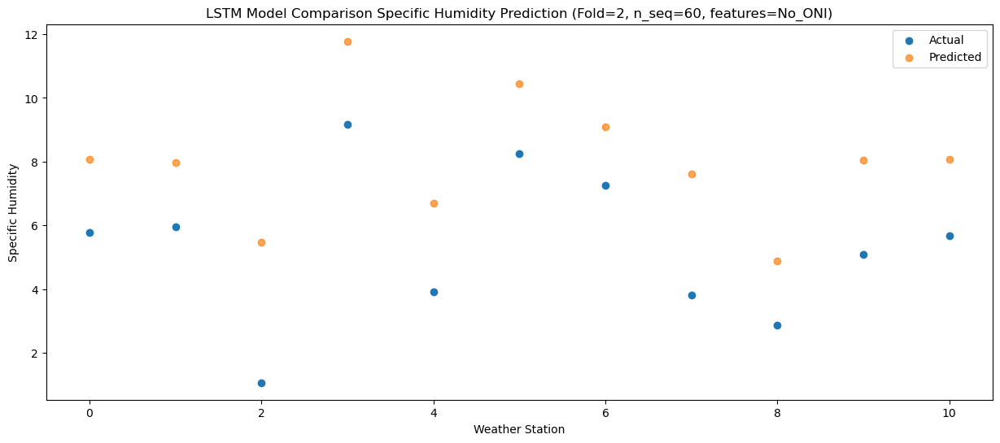

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    0.59   3.639199
1                 1    3.53   3.549199
2                 2   -2.89   1.039199
3                 3    4.72   7.359199
4                 4   -1.74   2.269199
5                 5    4.07   6.019199
6                 6    3.26   4.679199
7                 7    2.17   3.199199
8                 8    2.33   0.469199
9                 9   -0.48   3.619199
10               10    0.30   3.639199


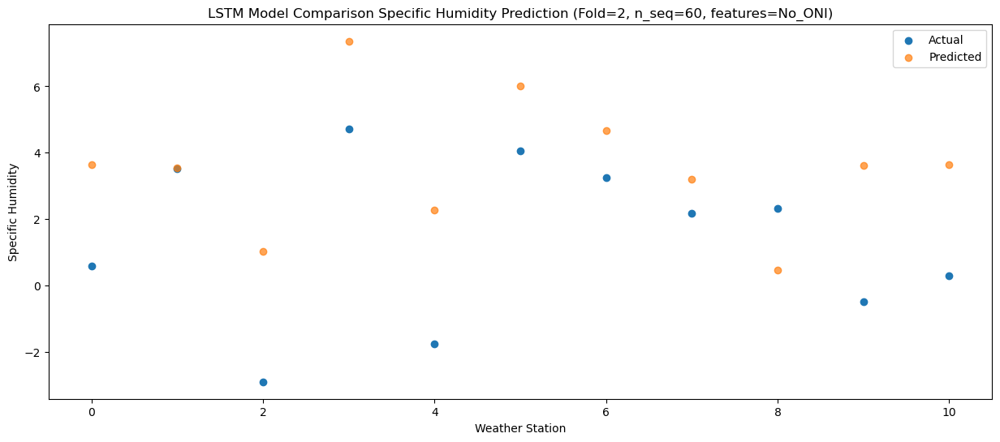

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    2.99    4.59507
1                 1    2.47    4.50507
2                 2   -1.49    1.99507
3                 3    4.36    8.31507
4                 4    1.54    3.22507
5                 5    6.94    6.97507
6                 6    5.76    5.63507
7                 7    2.30    4.15507
8                 8    2.15    1.42507
9                 9    1.37    4.57507
10               10    1.86    4.59507


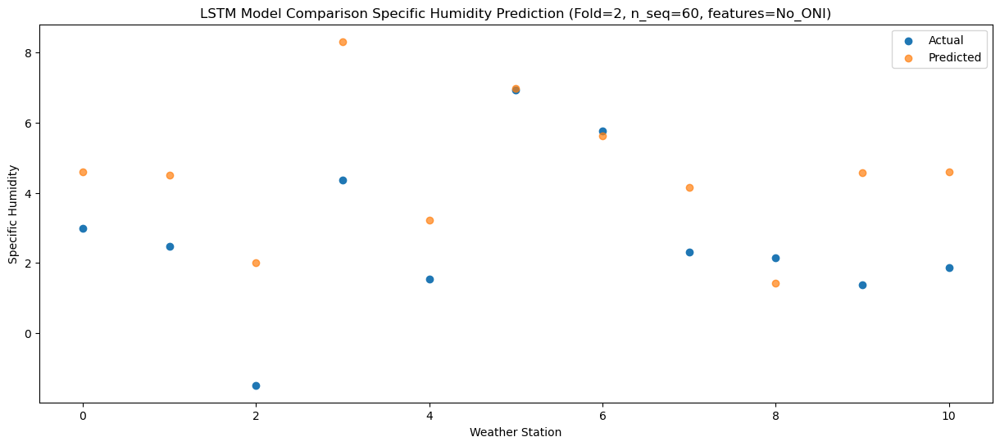

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -1.00   2.541775
1                 1    2.14   2.451775
2                 2   -5.14  -0.058225
3                 3    3.03   6.261775
4                 4   -3.37   1.171775
5                 5    1.31   4.921775
6                 6    0.47   3.581775
7                 7    2.02   2.101775
8                 8    0.79  -0.628225
9                 9   -1.41   2.521775
10               10   -0.56   2.541775


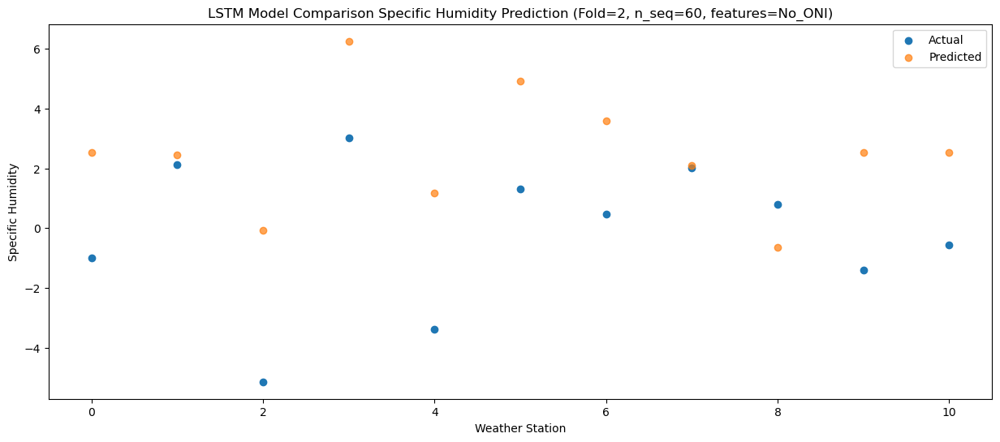

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -0.34    2.93063
1                 1    2.05    2.84063
2                 2   -3.95    0.33063
3                 3    3.60    6.65063
4                 4   -1.91    1.56063
5                 5    1.53    5.31063
6                 6    0.94    3.97063
7                 7    1.03    2.49063
8                 8    0.05   -0.23937
9                 9   -0.10    2.91063
10               10    0.34    2.93063


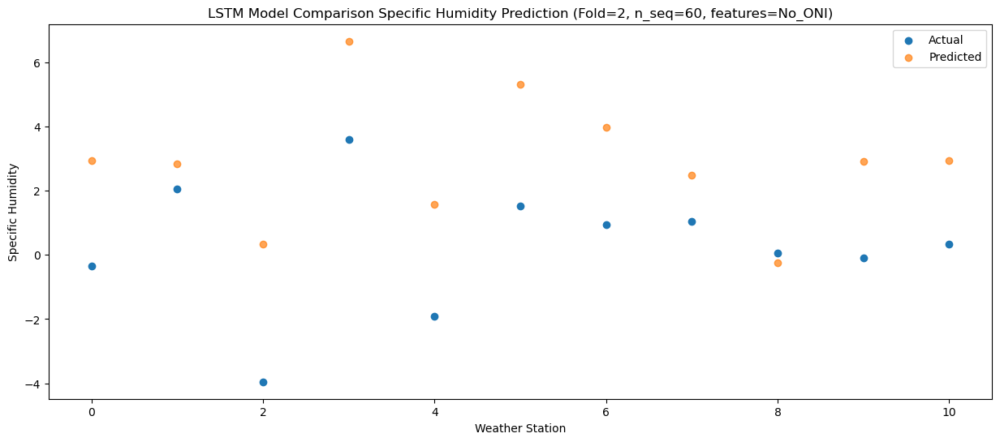

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    1.09   3.275149
1                 1    2.93   3.185149
2                 2   -2.14   0.675149
3                 3    4.36   6.995149
4                 4   -1.06   1.905149
5                 5    3.15   5.655149
6                 6    2.57   4.315149
7                 7    1.43   2.835149
8                 8    1.79   0.105149
9                 9    0.86   3.255149
10               10    0.96   3.275149


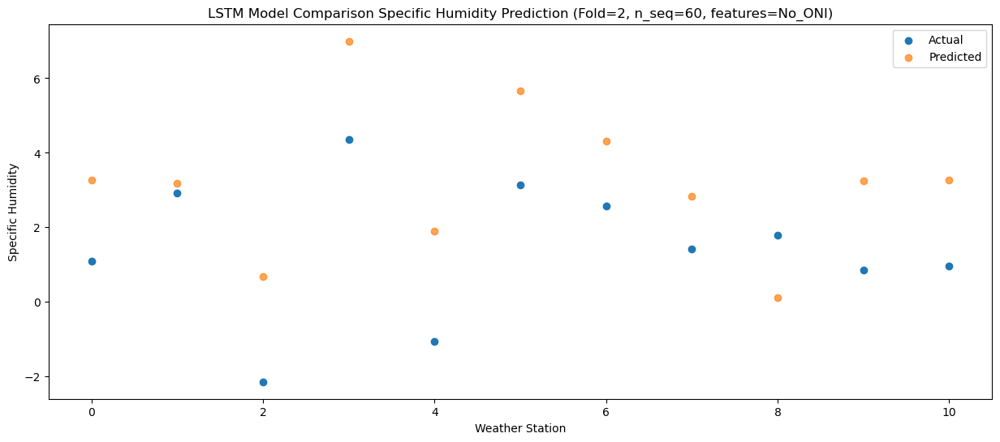

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    2.99   5.472306
1                 1    4.08   5.382306
2                 2   -0.78   2.872306
3                 3    5.06   9.192306
4                 4    1.37   4.102306
5                 5    7.11   7.852306
6                 6    6.47   6.512306
7                 7    1.44   5.032306
8                 8    2.63   2.302306
9                 9    1.90   5.452306
10               10    2.23   5.472306


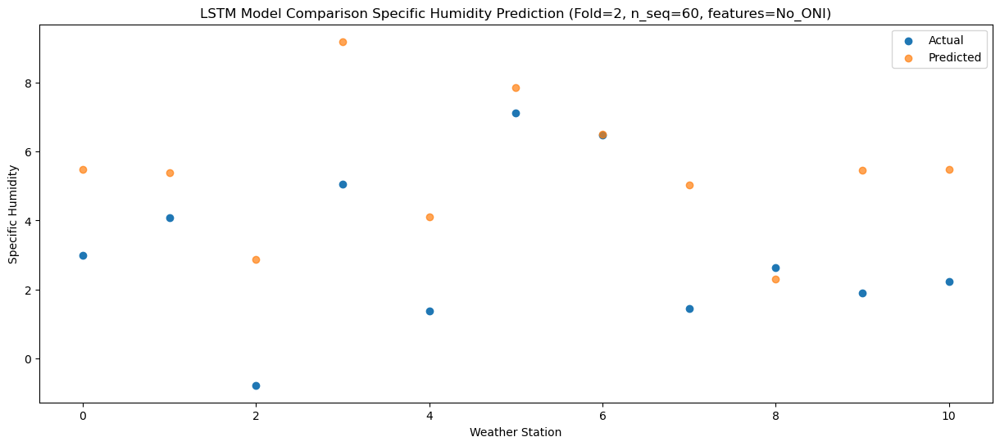

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    7.25   9.525601
1                 1    6.47   9.435601
2                 2    2.32   6.925601
3                 3    8.36  13.245601
4                 4    5.40   8.155601
5                 5   10.76  11.905601
6                 6   10.56  10.565601
7                 7    1.37   9.085601
8                 8    3.89   6.355601
9                 9    6.22   9.505601
10               10    6.39   9.525601


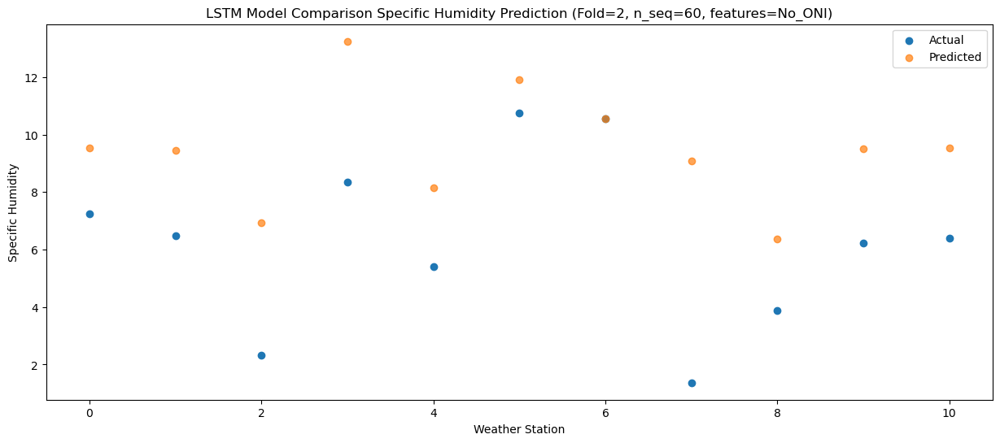

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0    9.30  12.094096
1                 1   10.83  12.004096
2                 2    4.25   9.494096
3                 3   10.62  15.814096
4                 4    7.70  10.724096
5                 5   11.79  14.474096
6                 6   11.36  13.134096
7                 7    6.87  11.654096
8                 8    5.66   8.924096
9                 9    8.02  12.074096
10               10    8.35  12.094096


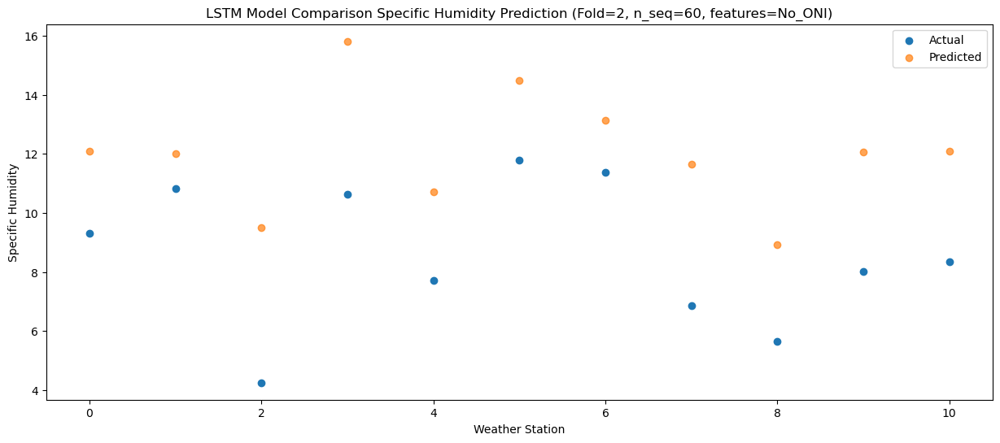

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   12.52  14.328098
1                 1   12.17  14.238098
2                 2    5.08  11.728098
3                 3   13.98  18.048098
4                 4    8.99  12.958098
5                 5   12.89  16.708098
6                 6   10.68  15.368098
7                 7    9.43  13.888098
8                 8    6.55  11.158098
9                 9   11.60  14.308098
10               10   11.56  14.328098


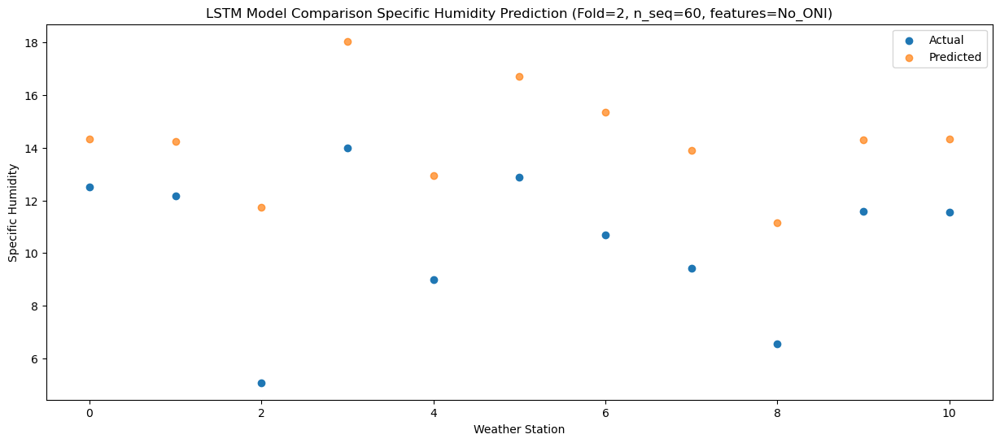

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   12.04  14.350512
1                 1   11.67  14.260512
2                 2    4.97  11.750512
3                 3   14.66  18.070512
4                 4    9.39  12.980512
5                 5   13.35  16.730512
6                 6   11.74  15.390512
7                 7   11.40  13.910512
8                 8    6.65  11.180512
9                 9   10.03  14.330512
10               10   10.57  14.350512


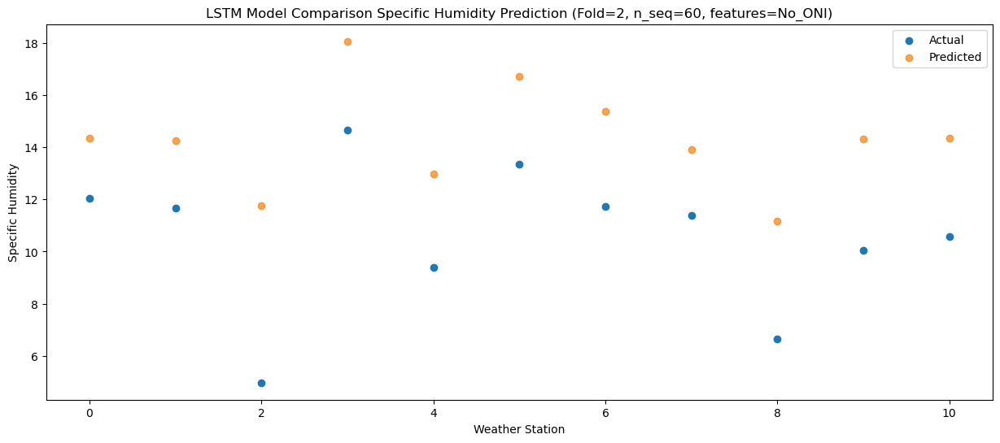

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    7.29  10.873734
1                 1    9.10  10.783734
2                 2    4.82   8.273734
3                 3   10.86  14.593734
4                 4    5.88   9.503734
5                 5    9.99  13.253734
6                 6    9.07  11.913734
7                 7    8.36  10.433734
8                 8    7.50   7.703734
9                 9    6.60  10.853734
10               10    7.09  10.873734


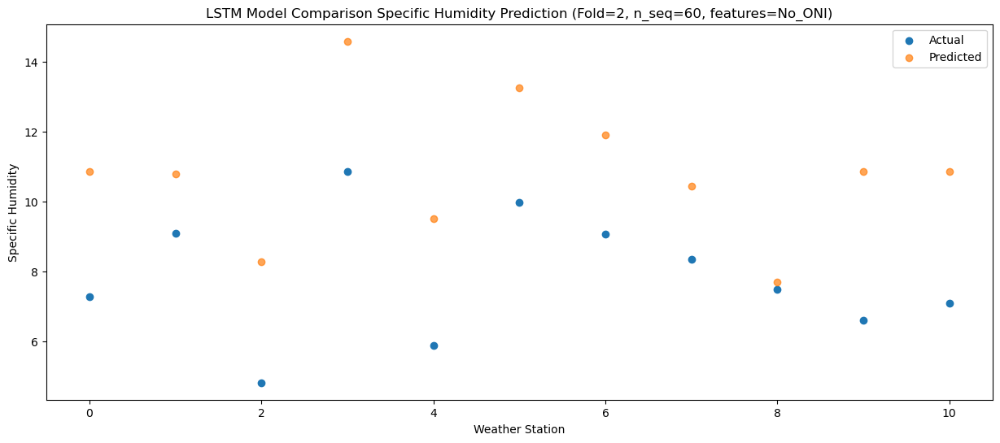

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    2.57   5.865231
1                 1    5.42   5.775231
2                 2    0.43   3.265231
3                 3    7.99   9.585231
4                 4    0.70   4.495231
5                 5    5.17   8.245231
6                 6    4.29   6.905231
7                 7    6.28   5.425231
8                 8    5.73   2.695231
9                 9    2.24   5.845231
10               10    2.43   5.865231


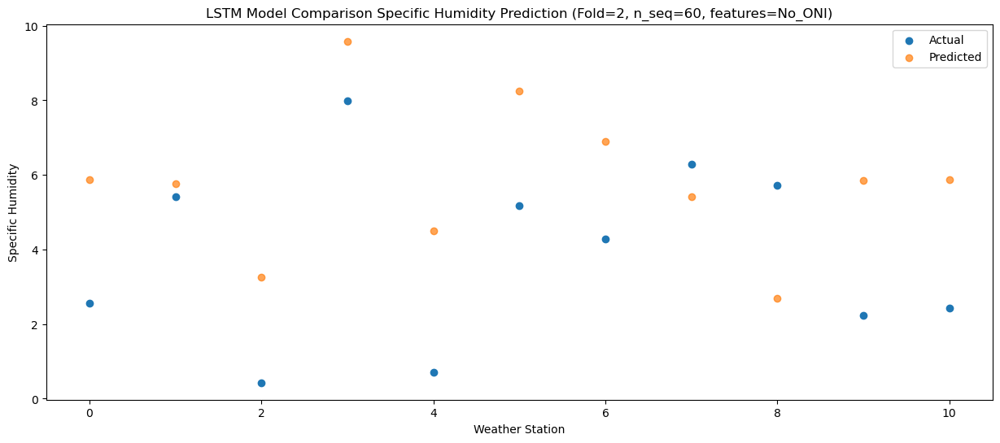

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    1.63   4.769716
1                 1    3.92   4.679716
2                 2    0.32   2.169716
3                 3    6.17   8.489716
4                 4    0.26   3.399716
5                 5    5.03   7.149716
6                 6    3.84   5.809716
7                 7    2.31   4.329716
8                 8    1.09   1.599716
9                 9    1.77   4.749716
10               10    1.81   4.769716


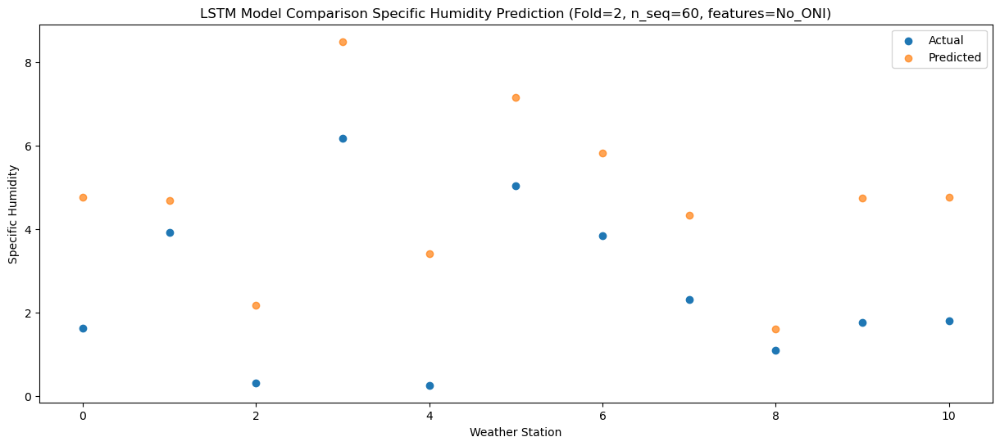

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0    1.00    3.74842
1                 1    2.73    3.65842
2                 2   -3.34    1.14842
3                 3    4.08    7.46842
4                 4   -0.29    2.37842
5                 5    4.12    6.12842
6                 6    2.67    4.78842
7                 7    3.13    3.30842
8                 8    1.94    0.57842
9                 9   -0.47    3.72842
10               10    0.72    3.74842


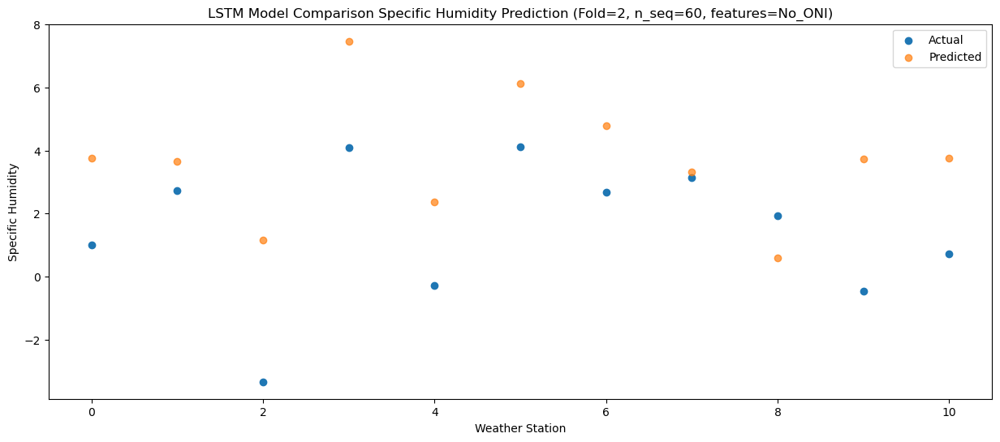

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    1.41   4.654358
1                 1    2.72   4.564358
2                 2   -3.72   2.054358
3                 3    4.59   8.374358
4                 4   -0.38   3.284358
5                 5    3.74   7.034358
6                 6    1.89   5.694358
7                 7    2.24   4.214358
8                 8    2.03   1.484358
9                 9    0.39   4.634358
10               10    0.99   4.654358


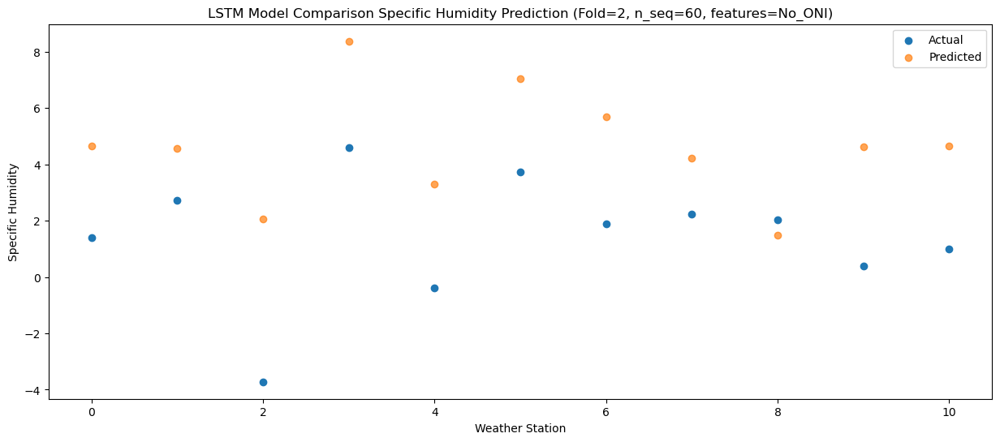

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    1.63   4.706311
1                 1    2.64   4.616311
2                 2   -1.87   2.106311
3                 3    3.83   8.426311
4                 4    0.92   3.336311
5                 5    4.19   7.086311
6                 6    2.29   5.746311
7                 7    2.12   4.266311
8                 8    0.62   1.536311
9                 9    1.15   4.686311
10               10    1.39   4.706311


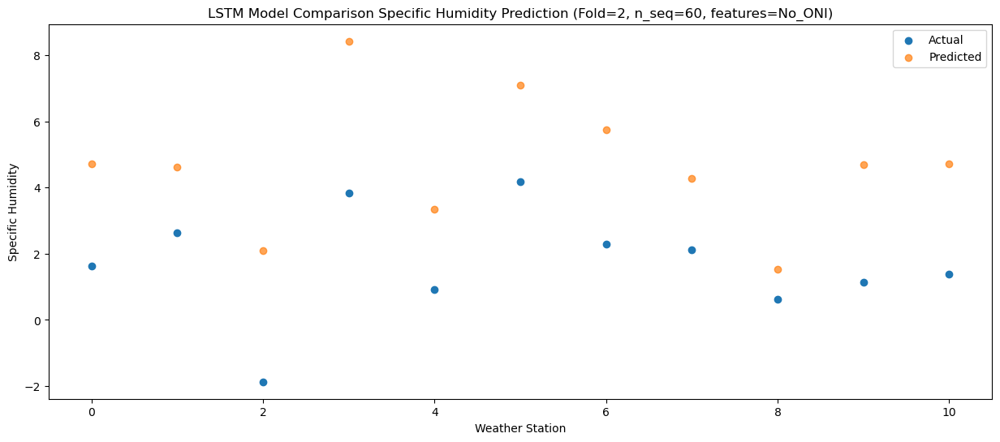

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    1.98   4.838457
1                 1    3.33   4.748457
2                 2   -1.48   2.238457
3                 3    4.08   8.558457
4                 4    1.80   3.468457
5                 5    5.97   7.218457
6                 6    4.20   5.878457
7                 7    2.46   4.398457
8                 8    2.54   1.668457
9                 9    0.84   4.818457
10               10    0.99   4.838457


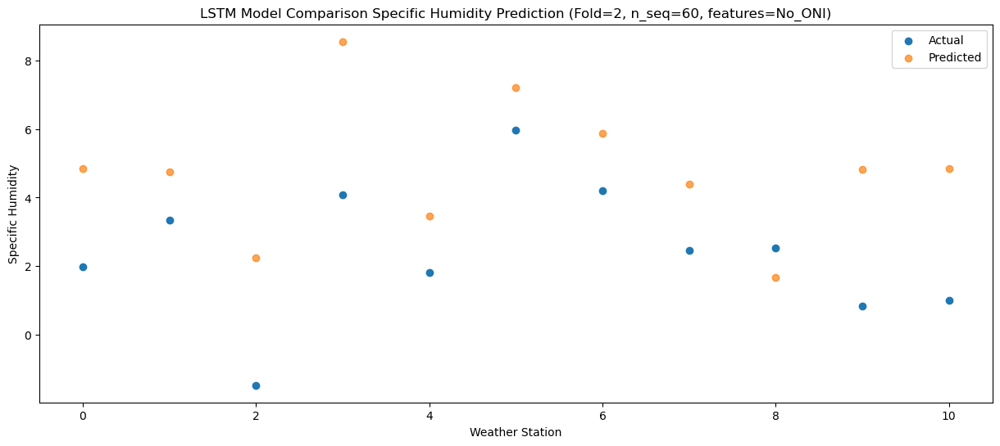

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    2.92   5.785279
1                 1    3.95   5.695279
2                 2    0.03   3.185279
3                 3    6.16   9.505279
4                 4    2.35   4.415279
5                 5    6.52   8.165279
6                 6    4.87   6.825279
7                 7    1.62   5.345279
8                 8    3.24   2.615279
9                 9    2.97   5.765279
10               10    2.63   5.785279


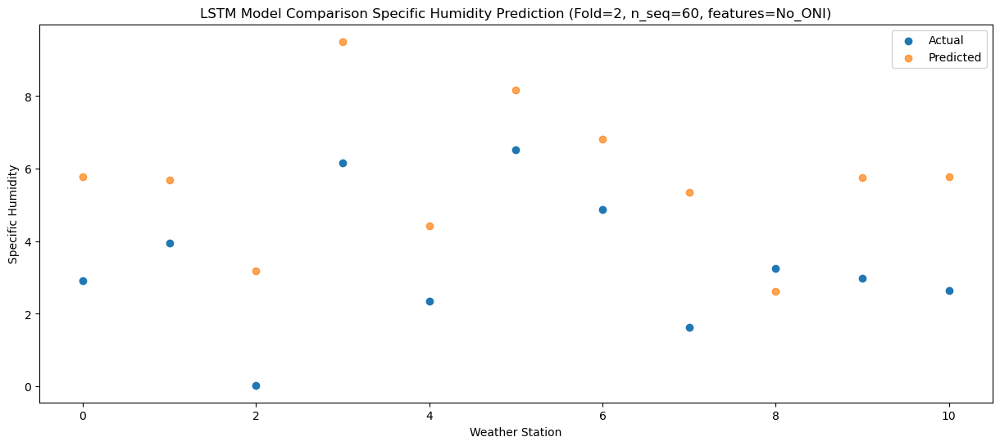

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    6.53   8.208647
1                 1    9.73   8.118647
2                 2    0.84   5.608647
3                 3    6.97  11.928647
4                 4    5.41   6.838647
5                 5   10.22  10.588647
6                 6    8.76   9.248647
7                 7    3.62   7.768647
8                 8    4.64   5.038647
9                 9    4.50   8.188647
10               10    5.22   8.208647


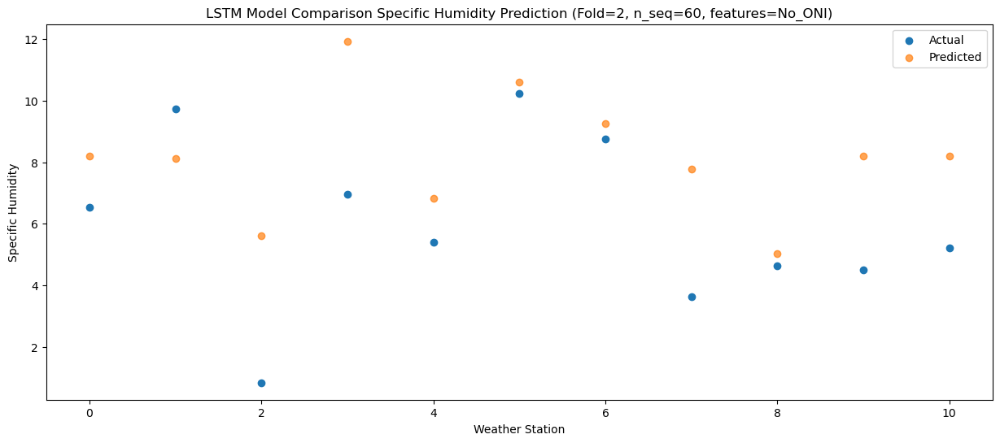

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0    9.50  12.819554
1                 1   12.38  12.729554
2                 2    4.00  10.219554
3                 3   10.87  16.539554
4                 4    8.72  11.449554
5                 5   13.68  15.199554
6                 6   12.66  13.859554
7                 7    3.42  12.379554
8                 8    5.02   9.649554
9                 9    7.36  12.799554
10               10    7.06  12.819554


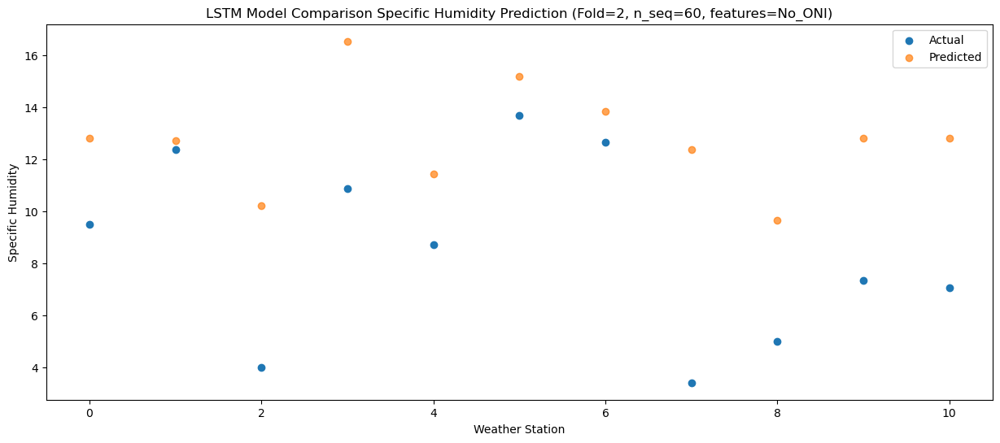

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   12.68  15.132317
1                 1   14.44  15.042317
2                 2    4.97  12.532317
3                 3   15.13  18.852317
4                 4   10.06  13.762317
5                 5   13.39  17.512317
6                 6   11.95  16.172317
7                 7    6.77  14.692317
8                 8    6.36  11.962317
9                 9   11.20  15.112317
10               10   10.37  15.132317


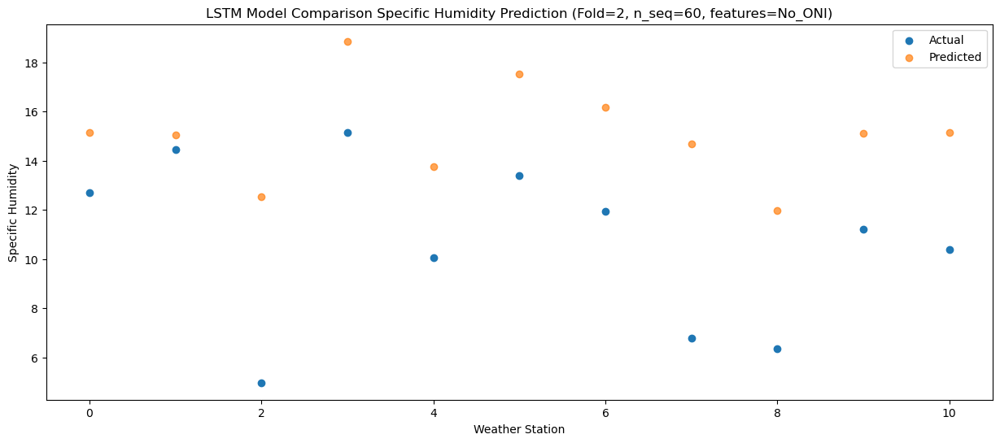

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   12.03  13.536567
1                 1   12.55  13.446567
2                 2    5.69  10.936567
3                 3   12.79  17.256567
4                 4   10.09  12.166567
5                 5   11.96  15.916567
6                 6    9.90  14.576567
7                 7    8.96  13.096567
8                 8    6.97  10.366567
9                 9   10.71  13.516567
10               10   10.48  13.536567


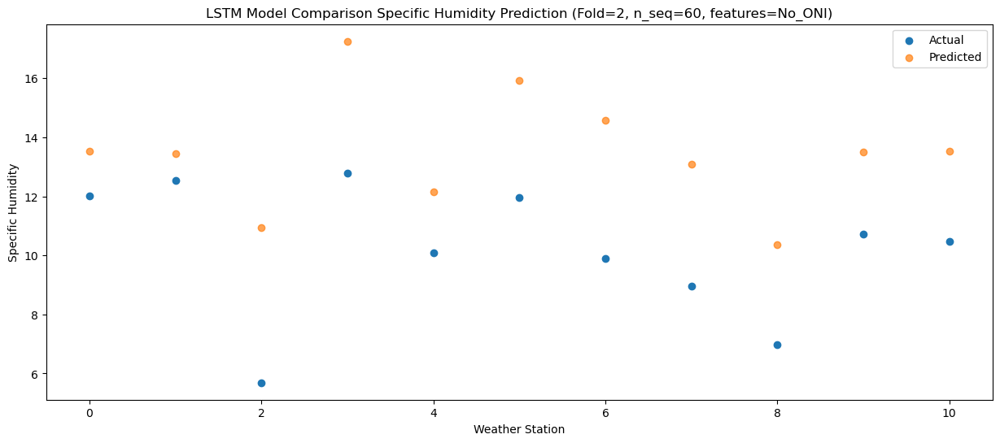

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    8.00  11.124372
1                 1    9.96  11.034372
2                 2    3.30   8.524372
3                 3   11.78  14.844372
4                 4    7.74   9.754372
5                 5   11.41  13.504372
6                 6    9.27  12.164372
7                 7    7.15  10.684372
8                 8    6.72   7.954372
9                 9    7.57  11.104372
10               10    8.06  11.124372


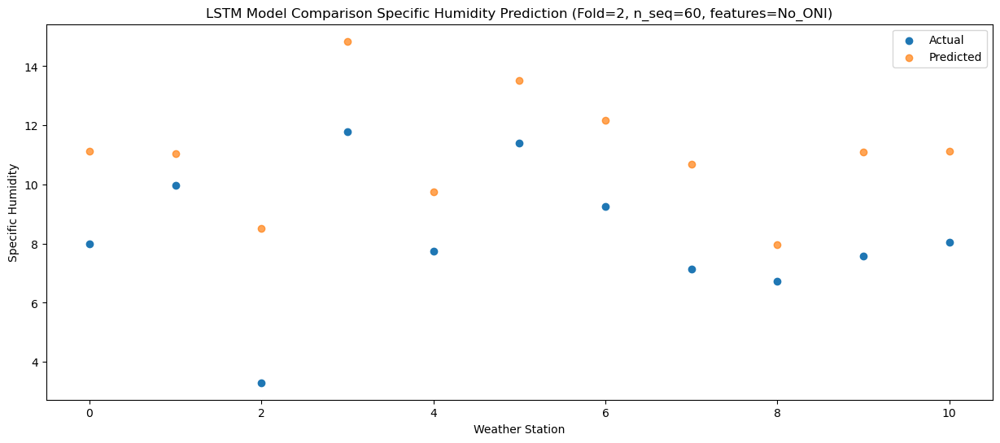

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    3.90   6.322078
1                 1    6.50   6.232078
2                 2    0.38   3.722078
3                 3    8.42  10.042078
4                 4    2.51   4.952078
5                 5    7.88   8.702078
6                 6    6.12   7.362078
7                 7    4.70   5.882078
8                 8    4.42   3.152078
9                 9    3.38   6.302078
10               10    3.95   6.322078


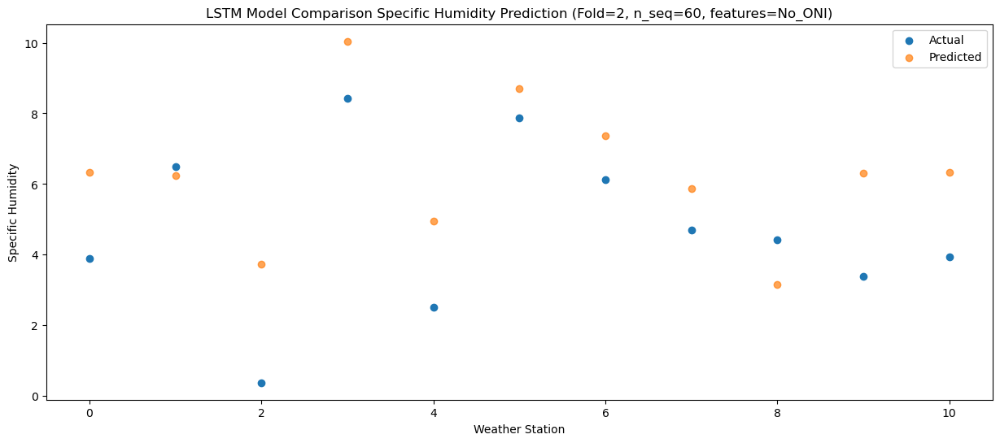

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    1.26   3.616293
1                 1    3.94   3.526293
2                 2   -2.12   1.016293
3                 3    4.59   7.336293
4                 4   -0.01   2.246293
5                 5    4.71   5.996293
6                 6    3.50   4.656293
7                 7    3.78   3.176293
8                 8    1.39   0.446293
9                 9    0.27   3.596293
10               10    1.00   3.616293


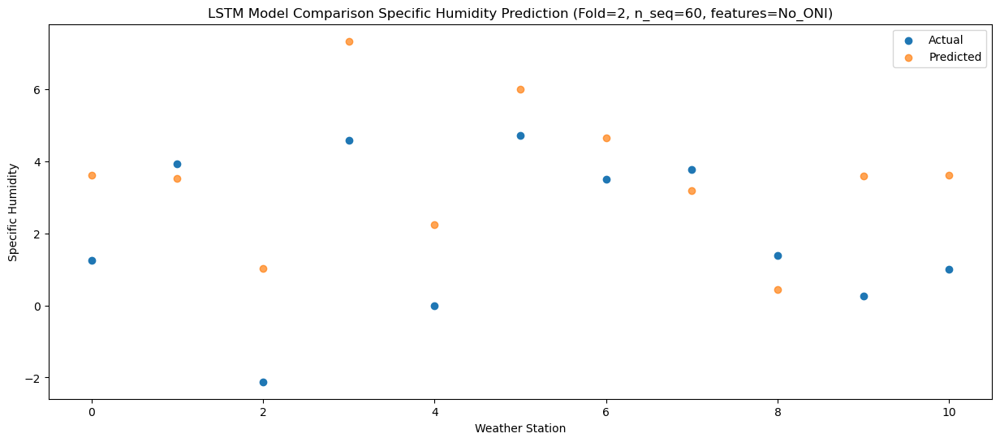

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0    0.34   3.441116
1                 1    3.55   3.351116
2                 2   -2.69   0.841116
3                 3    4.88   7.161116
4                 4   -1.60   2.071116
5                 5    2.78   5.821116
6                 6    1.68   4.481116
7                 7    2.26   3.001116
8                 8    2.18   0.271116
9                 9    0.18   3.421116
10               10    0.79   3.441116


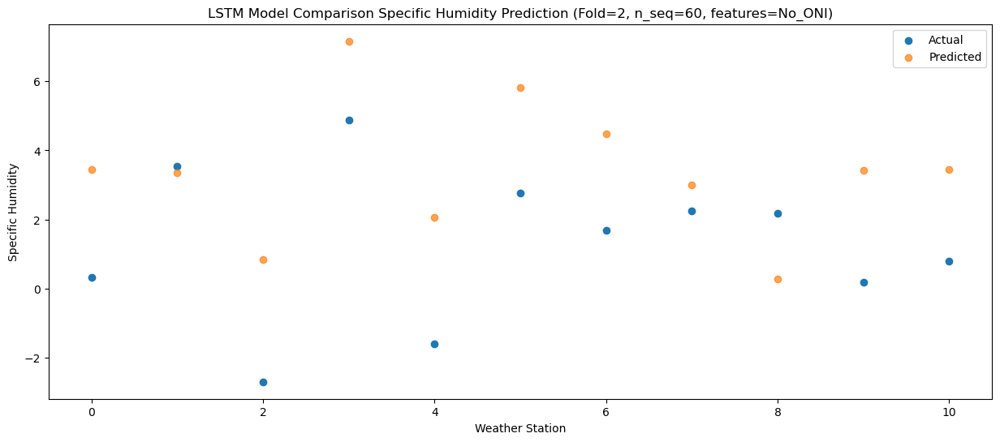

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -0.55   3.116797
1                 1    2.96   3.026797
2                 2   -3.76   0.516797
3                 3    3.55   6.836797
4                 4   -2.47   1.746797
5                 5    1.77   5.496797
6                 6    0.56   4.156797
7                 7    2.68   2.676797
8                 8    2.15  -0.053203
9                 9   -0.51   3.096797
10               10    0.17   3.116797


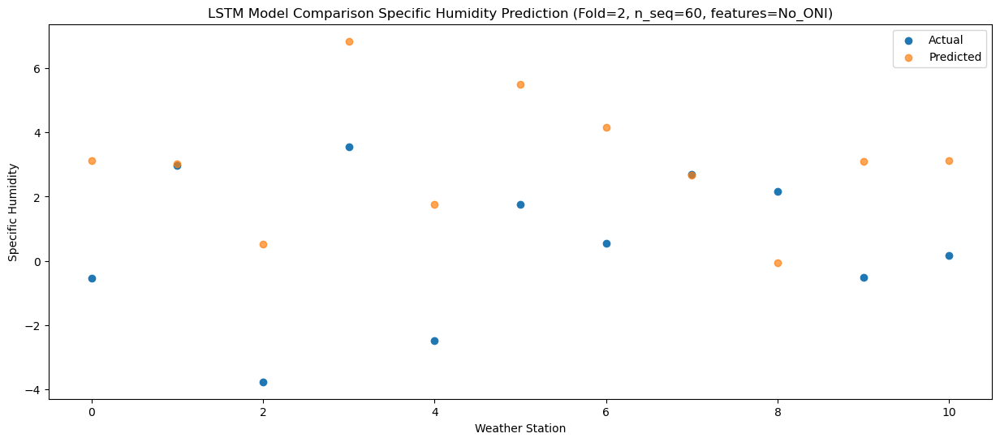

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    1.32   4.063953
1                 1    3.78   3.973953
2                 2   -4.18   1.463953
3                 3    3.50   7.783953
4                 4   -1.41   2.693953
5                 5    4.17   6.443953
6                 6    3.03   5.103953
7                 7    2.70   3.623953
8                 8    3.12   0.893953
9                 9   -0.37   4.043953
10               10    0.57   4.063953


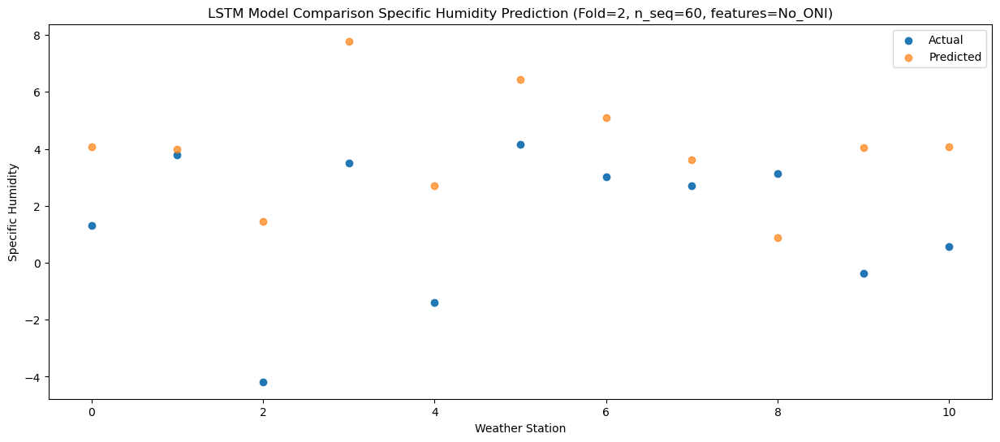

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    2.14    4.19514
1                 1    4.03    4.10514
2                 2   -1.02    1.59514
3                 3    4.55    7.91514
4                 4    0.19    2.82514
5                 5    5.81    6.57514
6                 6    4.65    5.23514
7                 7    2.92    3.75514
8                 8    1.56    1.02514
9                 9    1.04    4.17514
10               10    1.67    4.19514


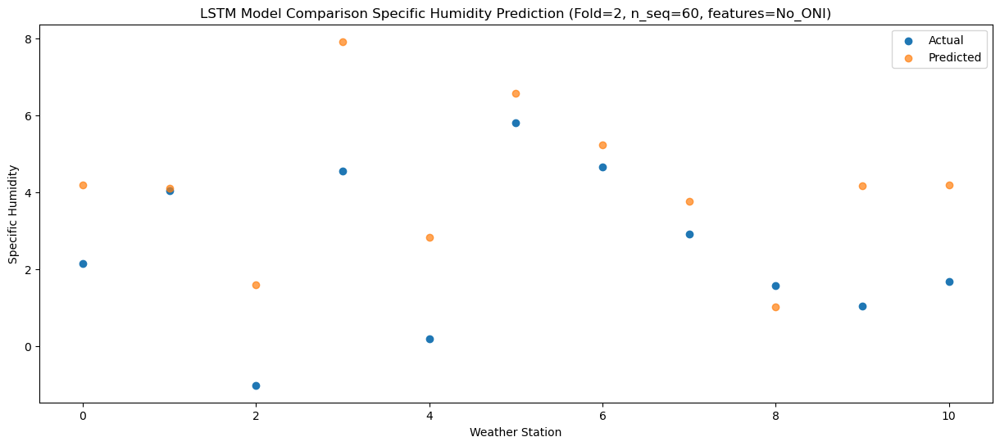

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    4.35    5.95265
1                 1    4.99    5.86265
2                 2   -2.23    3.35265
3                 3    5.44    9.67265
4                 4    2.26    4.58265
5                 5    8.09    8.33265
6                 6    6.85    6.99265
7                 7    2.25    5.51265
8                 8    0.66    2.78265
9                 9    3.26    5.93265
10               10    3.78    5.95265


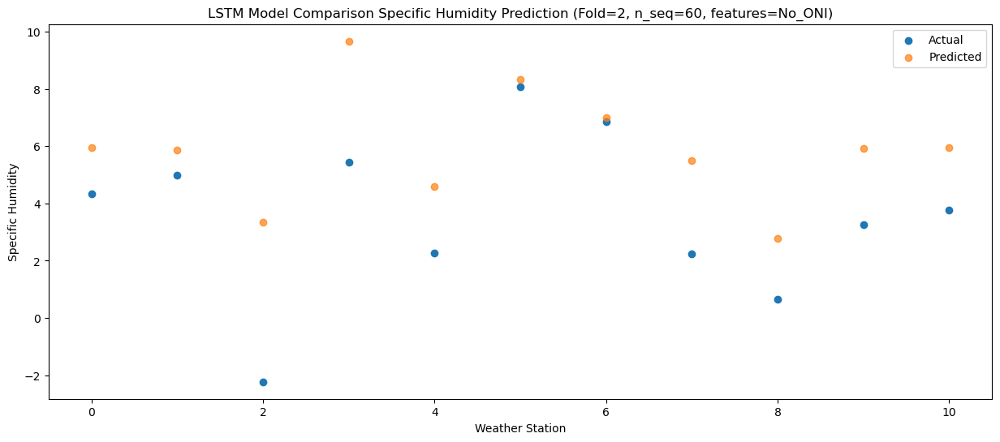

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    8.61    9.27935
1                 1    8.02    9.18935
2                 2    2.63    6.67935
3                 3    8.62   12.99935
4                 4    6.69    7.90935
5                 5   12.19   11.65935
6                 6   10.63   10.31935
7                 7    1.94    8.83935
8                 8    4.76    6.10935
9                 9    7.14    9.25935
10               10    7.64    9.27935


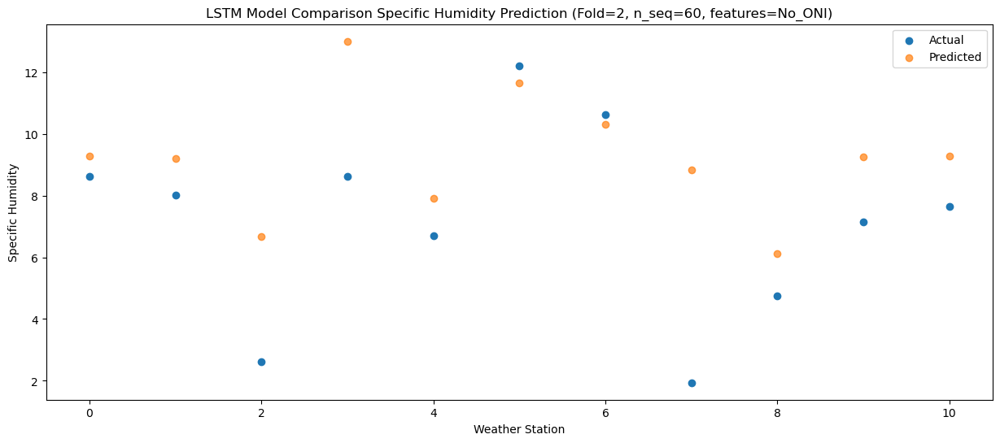

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   10.58  12.676985
1                 1   14.03  12.586985
2                 2    4.69  10.076985
3                 3   11.54  16.396985
4                 4    8.66  11.306985
5                 5   13.85  15.056985
6                 6   12.22  13.716985
7                 7    5.99  12.236985
8                 8    6.36   9.506985
9                 9    9.01  12.656985
10               10    9.19  12.676985


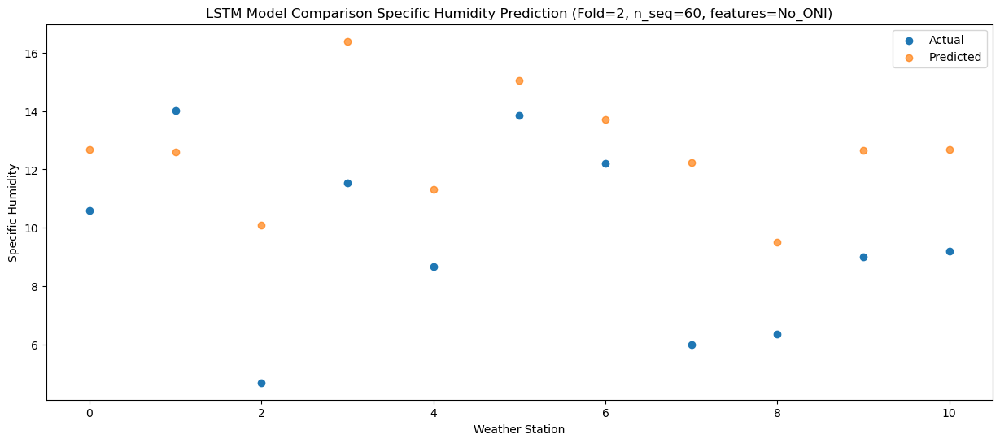

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   12.05  12.770812
1                 1   12.58  12.680812
2                 2    5.74  10.170812
3                 3   14.71  16.490812
4                 4   10.30  11.400812
5                 5   14.15  15.150812
6                 6   12.45  13.810812
7                 7    9.59  12.330812
8                 8    7.59   9.600812
9                 9   11.62  12.750812
10               10   11.23  12.770812


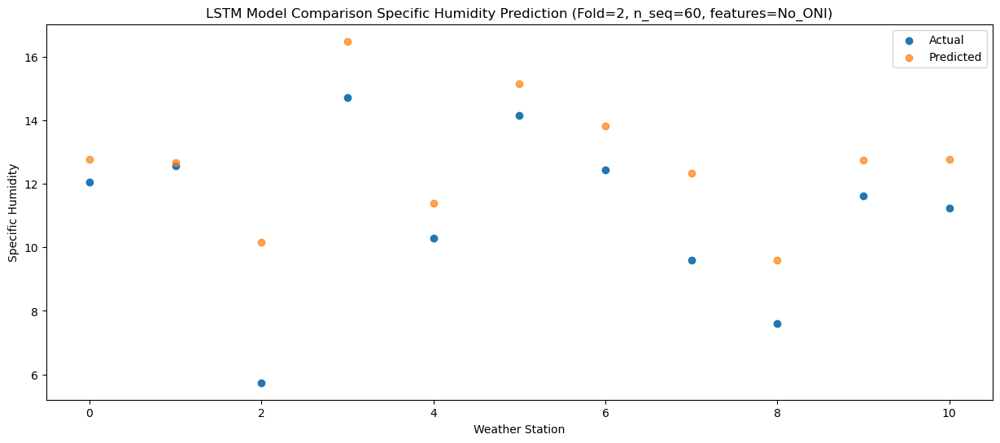

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   10.05  13.376279
1                 1   13.56  13.286279
2                 2    6.34  10.776279
3                 3   13.21  17.096279
4                 4    9.13  12.006279
5                 5   14.19  15.756279
6                 6   12.27  14.416279
7                 7    9.27  12.936279
8                 8    6.77  10.206279
9                 9   10.36  13.356279
10               10   10.22  13.376279


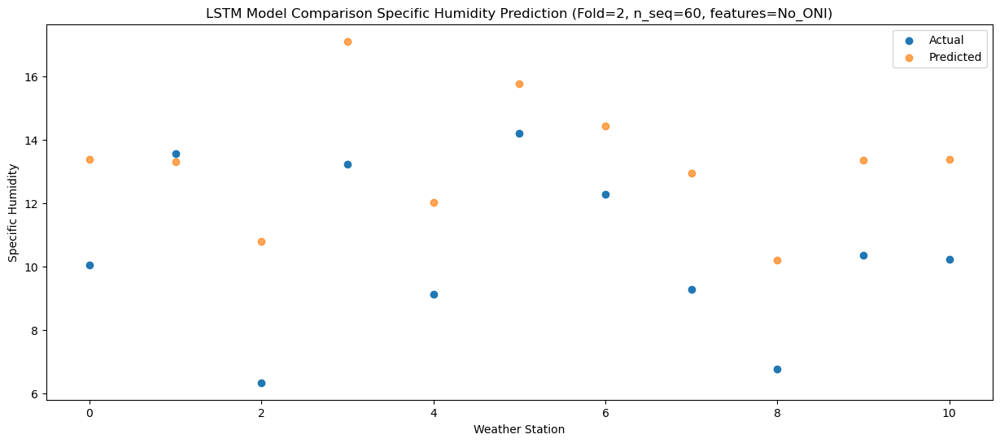

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    8.43   9.704032
1                 1    9.61   9.614032
2                 2    6.77   7.104032
3                 3   10.32  13.424032
4                 4    7.53   8.334032
5                 5   11.70  12.084032
6                 6    9.37  10.744032
7                 7    6.53   9.264032
8                 8    6.38   6.534032
9                 9    8.51   9.684032
10               10    8.12   9.704032


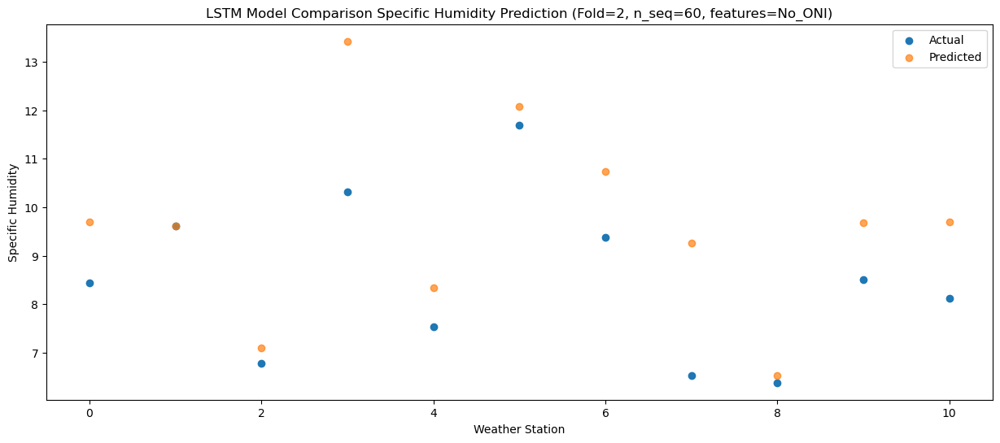

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    4.05   6.059036
1                 1    6.75   5.969036
2                 2    1.79   3.459036
3                 3    7.08   9.779036
4                 4    2.67   4.689036
5                 5    7.38   8.439036
6                 6    5.95   7.099036
7                 7    3.64   5.619036
8                 8    4.48   2.889036
9                 9    3.89   6.039036
10               10    4.05   6.059036


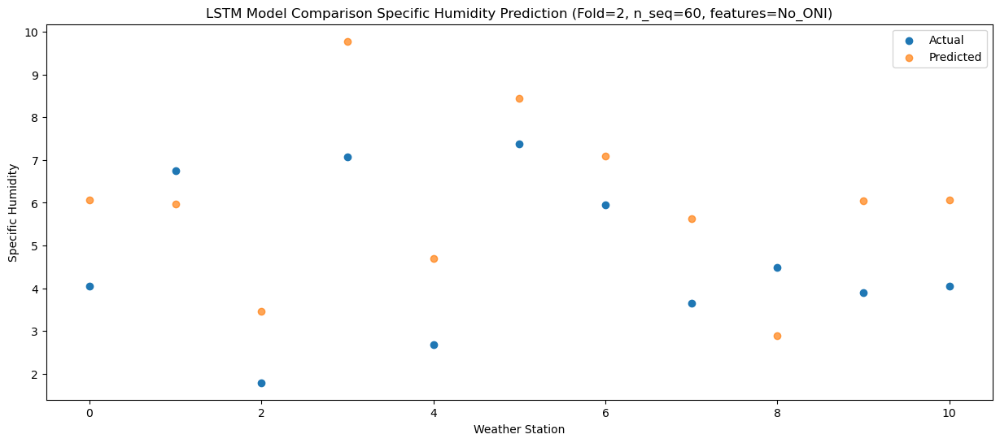

f, t:
[[ 8.500e-01  3.340e+00 -2.460e+00  4.490e+00 -2.070e+00  3.770e+00
   2.890e+00  3.550e+00  2.230e+00 -1.700e-01  5.200e-01]
 [ 1.350e+00  2.830e+00 -2.150e+00  3.930e+00 -1.270e+00  2.580e+00
   1.790e+00  3.100e+00  2.050e+00 -6.000e-02  9.700e-01]
 [ 1.060e+00  2.810e+00 -3.710e+00  3.750e+00 -1.240e+00  3.410e+00
   2.470e+00  2.150e+00  1.840e+00 -8.000e-02  7.700e-01]
 [ 7.400e-01  2.870e+00 -2.830e+00  3.770e+00 -9.200e-01  2.740e+00
   1.910e+00  2.680e+00  1.120e+00  3.100e-01  8.800e-01]
 [ 3.670e+00  4.660e+00 -1.660e+00  4.290e+00  2.570e+00  7.350e+00
   6.130e+00  4.140e+00  2.760e+00  1.940e+00  2.730e+00]
 [ 3.510e+00  4.950e+00 -1.800e-01  4.670e+00  1.610e+00  6.830e+00
   5.710e+00  2.740e+00  4.170e+00  1.850e+00  2.160e+00]
 [ 6.500e+00  7.850e+00  9.300e-01  6.920e+00  3.730e+00  8.910e+00
   8.650e+00  2.980e+00  4.930e+00  5.180e+00  4.950e+00]
 [ 9.650e+00  9.270e+00  4.270e+00  1.093e+01  7.070e+00  1.103e+01
   1.093e+01  4.660e+00  4.910e+00  8.690e+0

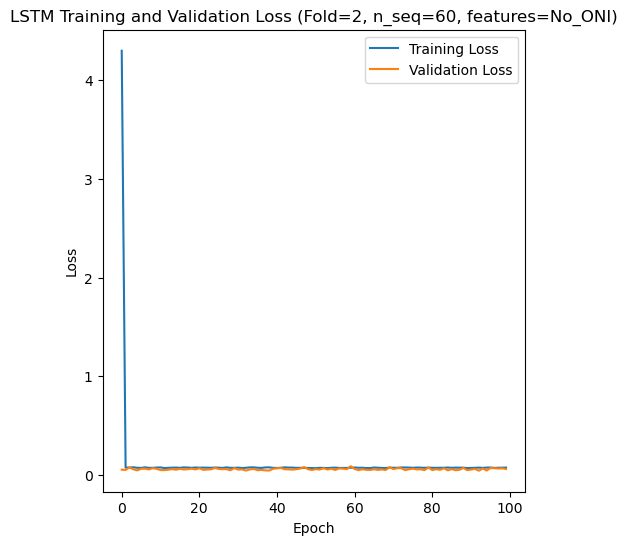

[[ 5.11  3.7   4.74 ... 13.5   8.68  7.66]
 [ 3.73  2.91  5.05 ... 11.19  6.96  6.57]
 [ 5.56  5.41  5.55 ...  8.56  7.45  5.59]
 ...
 [ 2.73  2.21  3.23 ...  5.    3.95  3.09]
 [ 5.93  5.59  5.49 ...  8.63  7.04  6.11]
 [ 3.71  2.55  2.84 ...  9.78  6.68  4.77]]
Epoch 1/100
84/84 [==============================] - 33s 171ms/step - loss: 4.7101 - accuracy: 0.3929 - mae: 4.4992 - rmse: 4.7101 - mape: 1016.4802 - pearson: 0.5680 - val_loss: 0.0771 - val_accuracy: 0.6000 - val_mae: 0.0608 - val_rmse: 0.0771 - val_mape: 13.0482 - val_pearson: 0.7256
Epoch 2/100
84/84 [==============================] - 10s 114ms/step - loss: 0.0703 - accuracy: 0.3929 - mae: 0.0553 - rmse: 0.0703 - mape: 12.5804 - pearson: 0.7738 - val_loss: 0.0760 - val_accuracy: 0.0000e+00 - val_mae: 0.0580 - val_rmse: 0.0760 - val_mape: 12.6595 - val_pearson: 0.6069
Epoch 3/100
84/84 [==============================] - 10s 121ms/step - loss: 0.0712 - accuracy: 0.3929 - mae: 0.0560 - rmse: 0.0712 - mape: 12.9398 - pearson: 

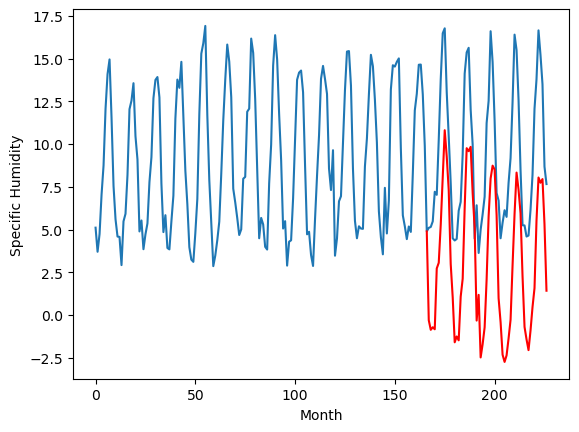

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.24		1.09		-1.15
1.83		0.54		-1.29
1.80		0.69		-1.11
1.44		0.57		-0.87
4.04		4.12		0.08
4.19		4.46		0.27
7.16		6.69		-0.47
10.69		9.46		-1.23
13.43		12.21		-1.22
10.76		10.69		-0.07
9.32		8.71		-0.61
4.75		4.38		-0.37
3.25		2.43		-0.82
1.21		-0.20		-1.41
1.12		0.15		-0.97
0.56		-0.08		-0.64
3.07		2.48		-0.59
4.24		3.52		-0.72
7.76		7.68		-0.08
12.29		11.16		-1.13
13.17		10.98		-2.19
13.34		11.24		-2.10
9.37		8.54		-0.83
7.18		6.49		-0.69
2.75		1.08		-1.67
3.72		2.58		-1.14
0.53		-1.08		-1.61
0.90		-0.30		-1.20
2.37		0.68		-1.69
4.67		3.49		-1.18
9.12		7.18		-1.94
11.74		9.39		-2.35
11.95		10.14		-1.81
12.56		9.91		-2.65
8.71		7.25		-1.46
4.25		2.38		-1.87
3.22		0.98		-2.24
2.03		-0.92		-2.95
1.95		-1.34		-3.29
2.11		-0.96		-3.07
3.05		0.03		-3.02
3.92		1.13		-2.79
8.33		4.31		-4.02
10.97		7.32		-3.65
13.24		9.73		-3.51
13.48		8.72		-4.76
9.41		7.35		-2.06
5.97		3.67		-2.30
3.09		0.70		-2.39


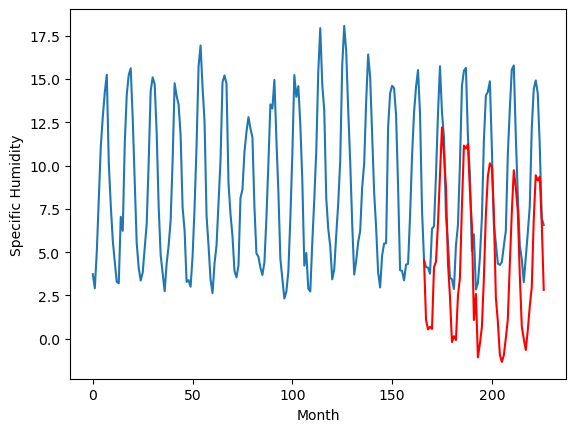

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
3.79		-0.29		-4.08
4.33		-0.84		-5.17
3.95		-0.69		-4.64
3.26		-0.81		-4.07
4.34		2.74		-1.60
5.71		3.08		-2.63
5.52		5.31		-0.21
7.06		8.08		1.02
7.28		10.83		3.55
8.80		9.31		0.51
8.32		7.33		-0.99
6.44		3.00		-3.44
3.75		1.05		-2.70
3.15		-1.58		-4.73
3.59		-1.23		-4.82
3.53		-1.46		-4.99
3.61		1.10		-2.51
4.23		2.14		-2.09
4.63		6.30		1.67
7.08		9.78		2.70
7.78		9.60		1.82
7.31		9.86		2.55
6.02		7.16		1.14
4.88		5.11		0.23
5.46		-0.30		-5.76
3.96		1.20		-2.76
3.68		-2.46		-6.14
2.90		-1.68		-4.58
4.24		-0.70		-4.94
3.91		2.11		-1.80
4.09		5.80		1.71
5.26		8.01		2.75
6.43		8.76		2.33
7.22		8.53		1.31
6.93		5.87		-1.06
5.76		1.00		-4.76
3.04		-0.40		-3.44
3.88		-2.30		-6.18
4.03		-2.72		-6.75
2.90		-2.34		-5.24
4.42		-1.35		-5.77
4.62		-0.25		-4.87
5.56		2.93		-2.63
6.33		5.94		-0.39
7.43		8.35		0.92
8.50		7.34		-1.16
6.96		5.97		-0.99
5.80		2.29		-3.51
3.69		-0.68		-4.37
3.92		-1.40		-5.32

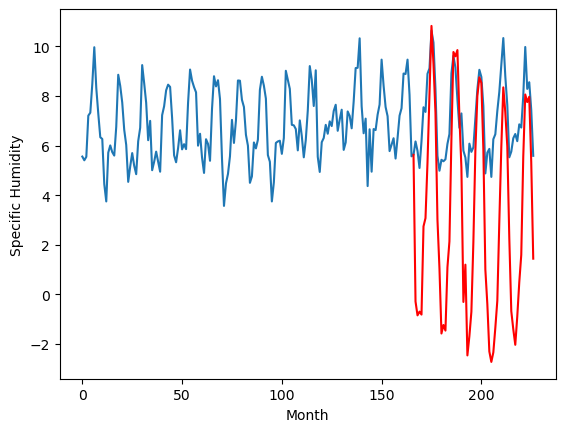

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.02		1.54		0.52
1.55		0.99		-0.56
1.15		1.14		-0.01
0.97		1.02		0.05
2.83		4.57		1.74
2.75		4.91		2.16
6.18		7.14		0.96
9.42		9.91		0.49
12.52		12.66		0.14
11.44		11.14		-0.30
8.87		9.16		0.29
5.18		4.83		-0.35
2.29		2.88		0.59
0.68		0.25		-0.43
0.41		0.60		0.19
0.34		0.37		0.03
1.64		2.93		1.29
2.83		3.97		1.14
5.36		8.13		2.77
10.78		11.61		0.83
11.41		11.43		0.02
12.29		11.69		-0.60
8.82		8.99		0.17
6.76		6.94		0.18
1.07		1.53		0.46
2.21		3.03		0.82
-0.11		-0.63		-0.52
0.41		0.15		-0.26
1.39		1.13		-0.26
2.66		3.94		1.28
7.08		7.63		0.55
9.34		9.84		0.50
12.38		10.59		-1.79
11.25		10.36		-0.89
8.00		7.70		-0.30
2.85		2.83		-0.02
2.04		1.43		-0.61
1.01		-0.47		-1.48
1.55		-0.89		-2.44
1.37		-0.51		-1.88
1.24		0.48		-0.76
2.78		1.58		-1.20
5.69		4.76		-0.93
7.71		7.77		0.06
11.36		10.18		-1.18
10.81		9.17		-1.64
8.34		7.80		-0.54
4.81		4.12		-0.69
1.42		1.15		-0.27
1.44		0.43		-1.01
0.70		-

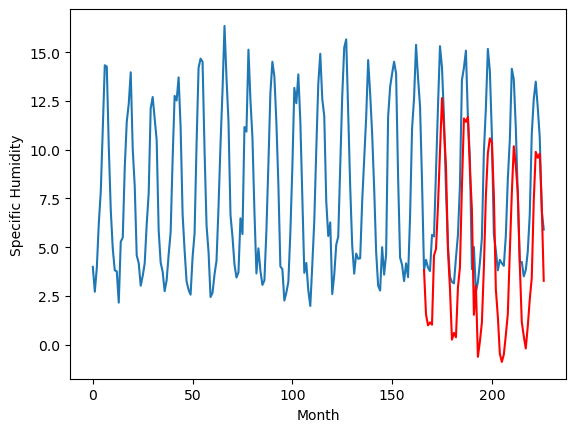

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.49		-0.03		-2.52
0.99		-0.58		-1.57
-1.30		-0.43		0.87
-2.06		-0.55		1.51
0.01		3.00		2.99
0.33		3.34		3.01
4.03		5.57		1.54
7.12		8.34		1.22
11.07		11.09		0.02
8.69		9.57		0.88
5.73		7.59		1.86
1.01		3.26		2.25
-0.09		1.31		1.40
-2.02		-1.32		0.70
-2.22		-0.97		1.25
-3.05		-1.20		1.85
-0.57		1.36		1.93
0.49		2.40		1.91
2.91		6.56		3.65
7.37		10.04		2.67
9.32		9.86		0.54
9.41		10.12		0.71
5.64		7.42		1.78
3.69		5.37		1.68
-1.43		-0.04		1.39
-0.73		1.46		2.19
-3.19		-2.20		0.99
-2.57		-1.42		1.15
-1.00		-0.44		0.56
0.56		2.37		1.81
4.65		6.06		1.41
6.75		8.27		1.52
9.34		9.02		-0.32
8.84		8.79		-0.05
5.74		6.13		0.39
0.74		1.26		0.52
-0.65		-0.14		0.51
-1.77		-2.04		-0.27
-1.39		-2.46		-1.07
-0.51		-2.08		-1.57
-0.84		-1.09		-0.25
0.39		0.01		-0.38
3.57		3.19		-0.38
5.70		6.20		0.50
9.47		8.61		-0.86
9.86		7.60		-2.26
5.75		6.23		0.48
2.13		2.55		0.42
-1.04		-0.42		0.62
-1.45		-1.14		0.31
-2

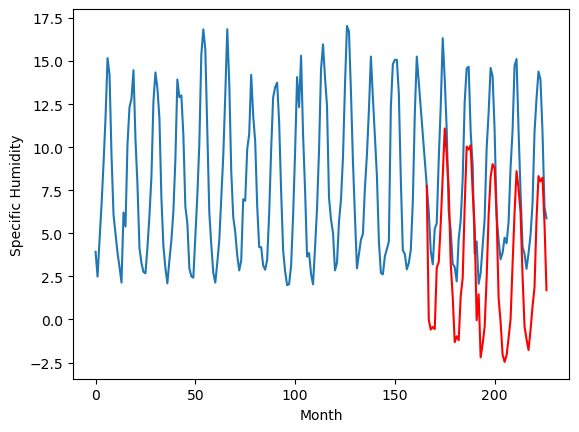

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.44		-0.09		-0.53
0.73		-0.64		-1.37
0.23		-0.49		-0.72
-0.02		-0.61		-0.59
1.97		2.94		0.97
2.09		3.28		1.19
5.30		5.51		0.21
8.03		8.28		0.25
11.19		11.03		-0.16
9.97		9.51		-0.46
6.79		7.53		0.74
3.37		3.20		-0.17
1.60		1.25		-0.35
-0.06		-1.38		-1.32
-0.37		-1.03		-0.66
-0.89		-1.26		-0.37
1.14		1.30		0.16
2.44		2.34		-0.10
4.68		6.50		1.82
9.90		9.98		0.08
11.15		9.80		-1.35
11.32		10.06		-1.26
8.02		7.36		-0.66
6.40		5.31		-1.09
0.53		-0.10		-0.63
1.58		1.40		-0.18
-0.93		-2.26		-1.33
-0.40		-1.48		-1.08
0.91		-0.50		-1.41
2.44		2.31		-0.13
6.67		6.00		-0.67
8.74		8.21		-0.53
11.52		8.96		-2.56
10.32		8.73		-1.59
7.55		6.07		-1.48
2.25		1.20		-1.05
1.03		-0.20		-1.23
0.27		-2.10		-2.37
0.85		-2.52		-3.37
0.52		-2.14		-2.66
0.95		-1.15		-2.10
2.26		-0.05		-2.31
4.86		3.13		-1.73
7.02		6.14		-0.88
11.53		8.55		-2.98
10.65		7.54		-3.11
7.42		6.17		-1.25
4.04		2.49		-1.55
0.85		-0.48		-1.3

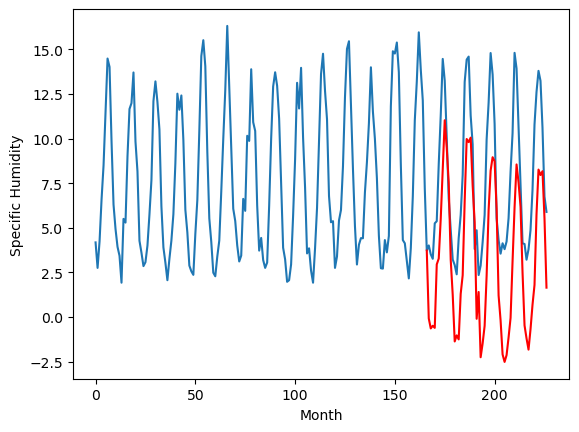

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
4.78		0.16		-4.62
4.41		-0.39		-4.80
4.37		-0.24		-4.61
4.33		-0.36		-4.69
4.96		3.19		-1.77
5.31		3.53		-1.78
6.44		5.76		-0.68
7.50		8.53		1.03
9.02		11.28		2.26
7.81		9.76		1.95
6.67		7.78		1.11
5.02		3.45		-1.57
4.96		1.50		-3.46
4.15		-1.13		-5.28
4.32		-0.78		-5.10
4.38		-1.01		-5.39
4.69		1.55		-3.14
5.16		2.59		-2.57
6.56		6.75		0.19
7.89		10.23		2.34
10.34		10.05		-0.29
8.91		10.31		1.40
7.21		7.61		0.40
6.12		5.56		-0.56
5.41		0.15		-5.26
4.70		1.65		-3.05
4.22		-2.01		-6.23
4.01		-1.23		-5.24
4.69		-0.25		-4.94
5.19		2.56		-2.63
6.00		6.25		0.25
7.94		8.46		0.52
10.93		9.21		-1.72
10.77		8.98		-1.79
7.82		6.32		-1.50
6.21		1.45		-4.76
4.55		0.05		-4.50
4.58		-1.85		-6.43
4.55		-2.27		-6.82
4.17		-1.89		-6.06
4.47		-0.90		-5.37
5.10		0.20		-4.90
7.26		3.38		-3.88
7.49		6.39		-1.10
8.33		8.80		0.47
9.98		7.79		-2.19
7.36		6.42		-0.94
6.11		2.74		-3.37
4.78		-0.23		-5.01
4.65		-0.95		

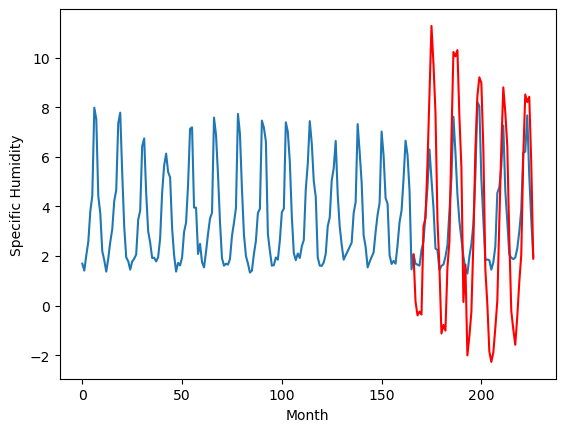

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.69		-2.33		-5.02
3.68		-2.88		-6.56
2.56		-2.73		-5.29
2.14		-2.85		-4.99
3.88		0.70		-3.18
3.69		1.04		-2.65
2.99		3.27		0.28
3.32		6.04		2.72
3.80		8.79		4.99
4.67		7.27		2.60
3.41		5.29		1.88
2.40		0.96		-1.44
2.38		-0.99		-3.37
1.55		-3.62		-5.17
2.36		-3.27		-5.63
1.88		-3.50		-5.38
2.18		-0.94		-3.12
1.87		0.10		-1.77
2.43		4.26		1.83
3.85		7.74		3.89
9.21		7.56		-1.65
6.78		7.82		1.04
5.06		5.12		0.06
3.96		3.07		-0.89
2.69		-2.34		-5.03
2.83		-0.84		-3.67
1.84		-4.50		-6.34
1.41		-3.72		-5.13
2.03		-2.74		-4.77
2.03		0.07		-1.96
2.29		3.76		1.47
4.05		5.97		1.92
7.48		6.72		-0.76
10.55		6.49		-4.06
6.64		3.83		-2.81
3.91		-1.04		-4.95
2.14		-2.44		-4.58
2.89		-4.34		-7.23
3.28		-4.76		-8.04
2.03		-4.38		-6.41
3.07		-3.39		-6.46
2.22		-2.29		-4.51
3.76		0.89		-2.87
4.26		3.90		-0.36
5.23		6.31		1.08
7.81		5.30		-2.51
6.87		3.93		-2.94
3.81		0.25		-3.56
2.80		-2.72		-5.52
2.72		-3.44	

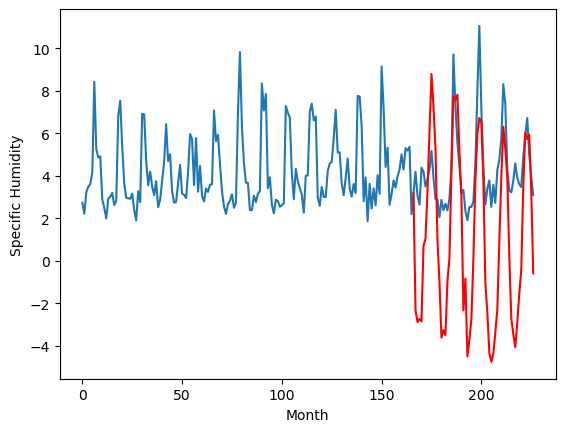

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
3.33		-1.29		-4.62
4.56		-1.84		-6.40
3.88		-1.69		-5.57
2.99		-1.81		-4.80
3.47		1.74		-1.73
4.53		2.08		-2.45
5.39		4.31		-1.08
5.61		7.08		1.47
6.08		9.83		3.75
6.88		8.31		1.43
6.49		6.33		-0.16
4.29		2.00		-2.29
3.13		0.05		-3.08
2.79		-2.58		-5.37
3.46		-2.23		-5.69
3.11		-2.46		-5.57
2.76		0.10		-2.66
3.69		1.14		-2.55
4.13		5.30		1.17
5.56		8.78		3.22
6.04		8.60		2.56
6.43		8.86		2.43
5.79		6.16		0.37
4.76		4.11		-0.65
4.98		-1.30		-6.28
3.73		0.20		-3.53
3.40		-3.46		-6.86
2.56		-2.68		-5.24
3.56		-1.70		-5.26
3.66		1.11		-2.55
4.03		4.80		0.77
5.52		7.01		1.49
6.35		7.76		1.41
6.81		7.53		0.72
6.21		4.87		-1.34
4.90		0.00		-4.90
2.65		-1.40		-4.05
3.44		-3.30		-6.74
3.27		-3.72		-6.99
2.41		-3.34		-5.75
3.21		-2.35		-5.56
3.59		-1.25		-4.84
5.18		1.93		-3.25
5.24		4.94		-0.30
6.08		7.35		1.27
7.35		6.34		-1.01
6.80		4.97		-1.83
5.37		1.29		-4.08
4.28		-1.68		-5.96
4.66		-2.40		-7.06

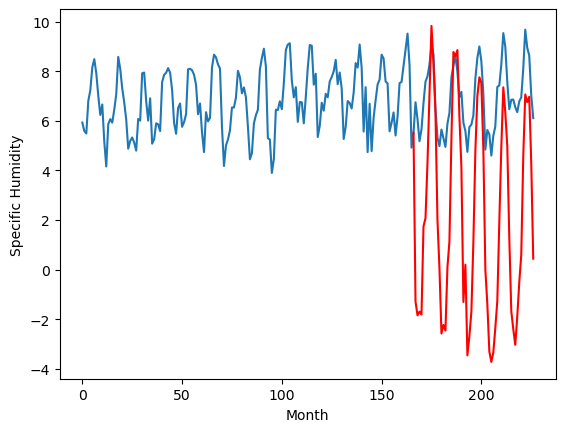

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.25		1.91		-0.34
1.89		1.36		-0.53
1.61		1.51		-0.10
1.69		1.39		-0.30
2.18		4.94		2.76
2.68		5.28		2.60
4.91		7.51		2.60
9.02		10.28		1.26
13.00		13.03		0.03
11.93		11.51		-0.42
8.56		9.53		0.97
6.03		5.20		-0.83
3.87		3.25		-0.62
1.91		0.62		-1.29
0.82		0.97		0.15
0.97		0.74		-0.23
1.75		3.30		1.55
3.13		4.34		1.21
4.70		8.50		3.80
9.60		11.98		2.38
11.81		11.80		-0.01
12.19		12.06		-0.13
9.59		9.36		-0.23
7.05		7.31		0.26
2.52		1.90		-0.62
2.22		3.40		1.18
0.74		-0.26		-1.00
1.33		0.52		-0.81
2.17		1.50		-0.67
2.82		4.31		1.49
6.21		8.00		1.79
8.55		10.21		1.66
11.71		10.96		-0.75
11.85		10.73		-1.12
8.18		8.07		-0.11
5.55		3.20		-2.35
3.70		1.80		-1.90
1.73		-0.10		-1.83
2.30		-0.52		-2.82
1.59		-0.14		-1.73
1.80		0.85		-0.95
4.04		1.95		-2.09
4.56		5.13		0.57
8.26		8.14		-0.12
13.11		10.55		-2.56
10.54		9.54		-1.00
9.57		8.17		-1.40
6.18		4.49		-1.69
2.38		1.52		-0.86
2.71		0.80		-1.91

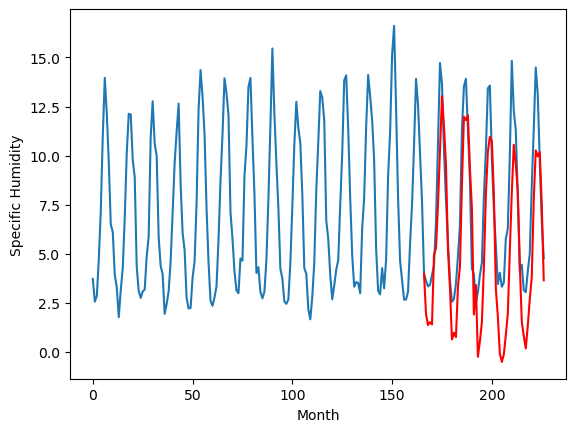

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.54		-0.31		0.23
-0.66		-0.86		-0.20
-0.74		-0.71		0.03
-0.75		-0.83		-0.08
0.21		2.72		2.51
0.64		3.06		2.42
3.17		5.29		2.12
6.74		8.06		1.32
10.09		10.81		0.72
9.45		9.29		-0.16
6.16		7.31		1.15
3.39		2.98		-0.41
1.06		1.03		-0.03
-0.79		-1.60		-0.81
-1.48		-1.25		0.23
-1.62		-1.48		0.14
-0.34		1.08		1.42
1.07		2.12		1.05
2.66		6.28		3.62
7.53		9.76		2.23
9.22		9.58		0.36
9.54		9.84		0.30
6.62		7.14		0.52
4.72		5.09		0.37
-0.20		-0.32		-0.12
-0.30		1.18		1.48
-1.81		-2.48		-0.67
-1.11		-1.70		-0.59
-0.17		-0.72		-0.55
0.47		2.09		1.62
4.65		5.78		1.13
6.05		7.99		1.94
9.03		8.74		-0.29
8.66		8.51		-0.15
5.64		5.85		0.21
2.22		0.98		-1.24
1.00		-0.42		-1.42
-0.92		-2.32		-1.40
-0.14		-2.74		-2.60
-0.89		-2.36		-1.47
-0.76		-1.37		-0.61
1.67		-0.27		-1.94
2.14		2.91		0.77
5.83		5.92		0.09
9.81		8.33		-1.48
8.57		7.32		-1.25
6.88		5.95		-0.93
3.61		2.27		-1.34
-0.07		-0.70		-0.63
0.31		-1.

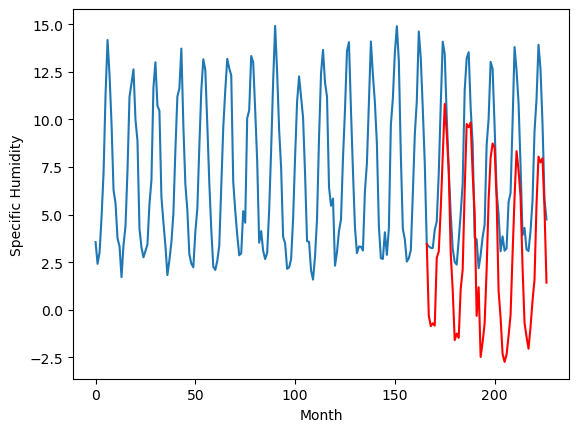

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -1.29  -0.305813
1                 1    2.24   1.094187
2                 2    3.79  -0.285813
3                 3    1.02   1.544187
4                 4    2.49  -0.025813
5                 5    0.44  -0.085813
6                 6    4.78   0.164187
7                 7    2.69  -2.325813
8                 8    3.33  -1.285813
9                 9    2.25   1.914187
10               10   -0.54  -0.305813


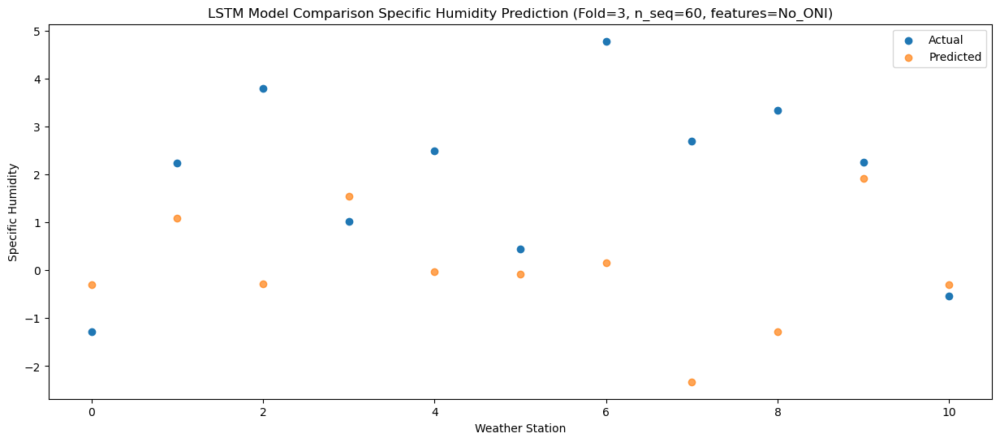

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -1.08  -0.864905
1                 1    1.83   0.535095
2                 2    4.33  -0.844905
3                 3    1.55   0.985095
4                 4    0.99  -0.584905
5                 5    0.73  -0.644905
6                 6    4.41  -0.394905
7                 7    3.68  -2.884905
8                 8    4.56  -1.844905
9                 9    1.89   1.355095
10               10   -0.66  -0.864905


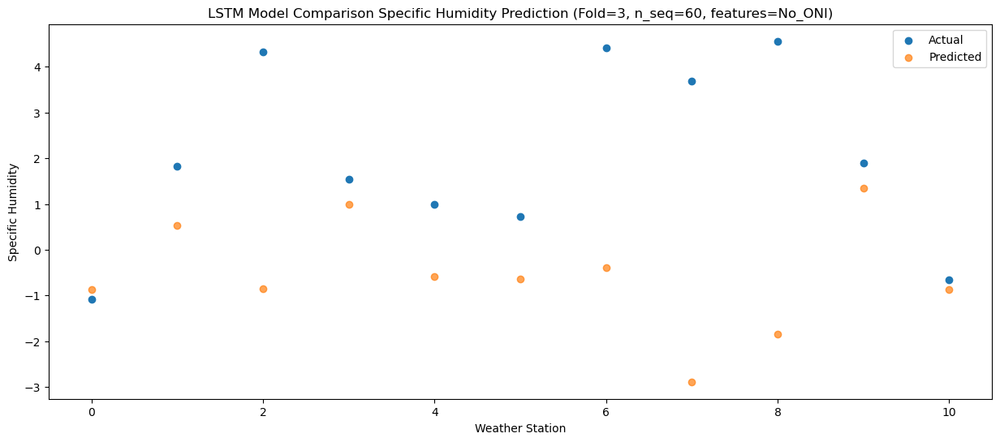

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -1.03  -0.713781
1                 1    1.80   0.686219
2                 2    3.95  -0.693781
3                 3    1.15   1.136219
4                 4   -1.30  -0.433781
5                 5    0.23  -0.493781
6                 6    4.37  -0.243781
7                 7    2.56  -2.733781
8                 8    3.88  -1.693781
9                 9    1.61   1.506219
10               10   -0.74  -0.713781


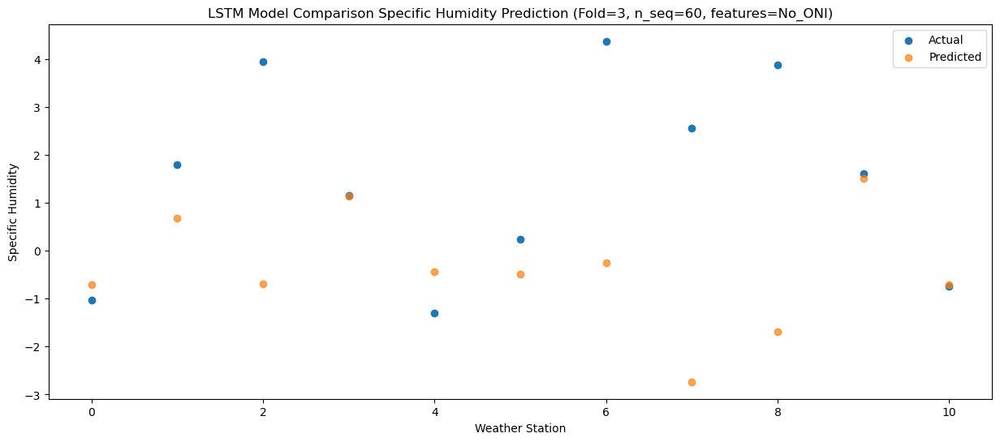

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -0.70  -0.833289
1                 1    1.44   0.566711
2                 2    3.26  -0.813289
3                 3    0.97   1.016711
4                 4   -2.06  -0.553289
5                 5   -0.02  -0.613289
6                 6    4.33  -0.363289
7                 7    2.14  -2.853289
8                 8    2.99  -1.813289
9                 9    1.69   1.386711
10               10   -0.75  -0.833289


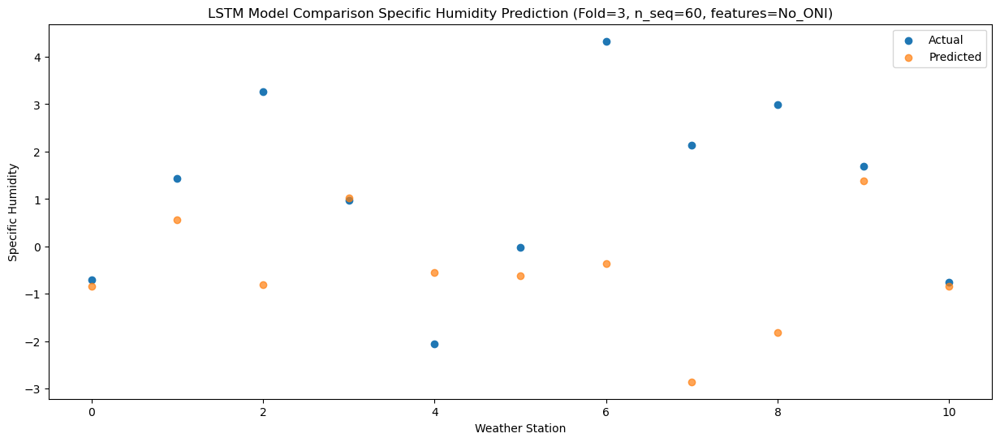

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    1.03   2.724174
1                 1    4.04   4.124174
2                 2    4.34   2.744174
3                 3    2.83   4.574174
4                 4    0.01   3.004174
5                 5    1.97   2.944174
6                 6    4.96   3.194174
7                 7    3.88   0.704174
8                 8    3.47   1.744174
9                 9    2.18   4.944174
10               10    0.21   2.724174


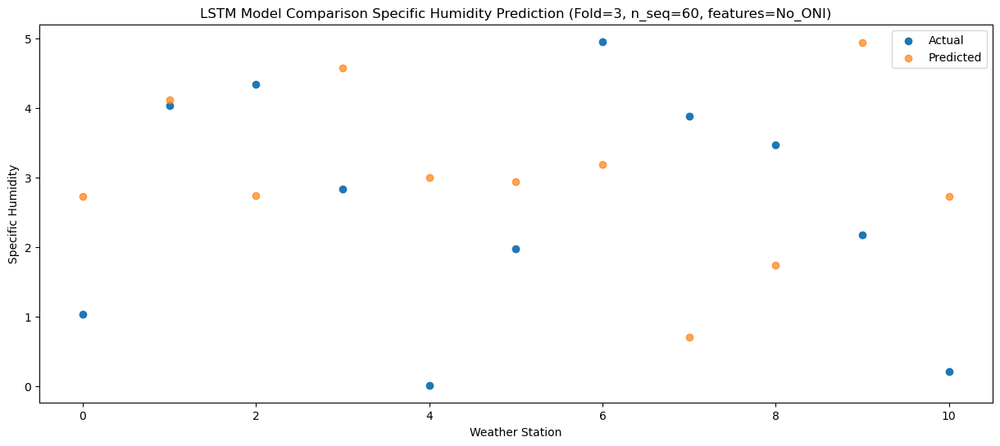

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    0.85   3.055853
1                 1    4.19   4.455853
2                 2    5.71   3.075853
3                 3    2.75   4.905853
4                 4    0.33   3.335853
5                 5    2.09   3.275853
6                 6    5.31   3.525853
7                 7    3.69   1.035853
8                 8    4.53   2.075853
9                 9    2.68   5.275853
10               10    0.64   3.055853


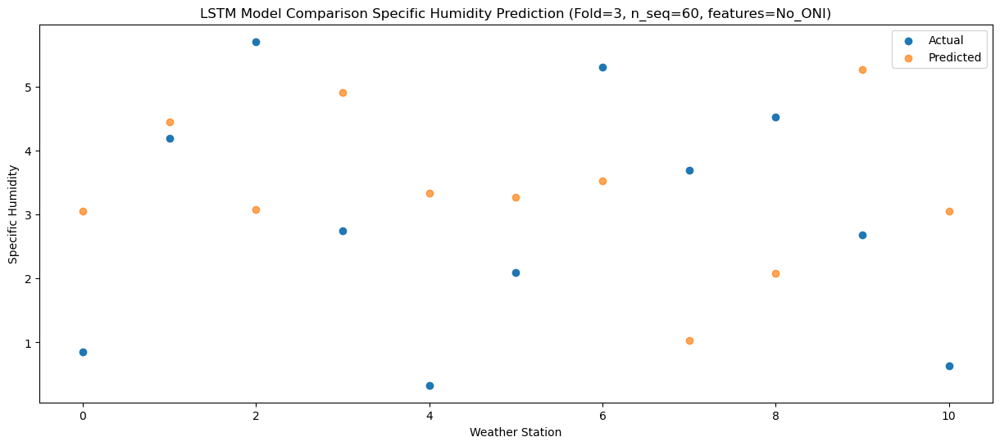

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    4.07   5.287457
1                 1    7.16   6.687457
2                 2    5.52   5.307457
3                 3    6.18   7.137457
4                 4    4.03   5.567457
5                 5    5.30   5.507457
6                 6    6.44   5.757457
7                 7    2.99   3.267457
8                 8    5.39   4.307457
9                 9    4.91   7.507457
10               10    3.17   5.287457


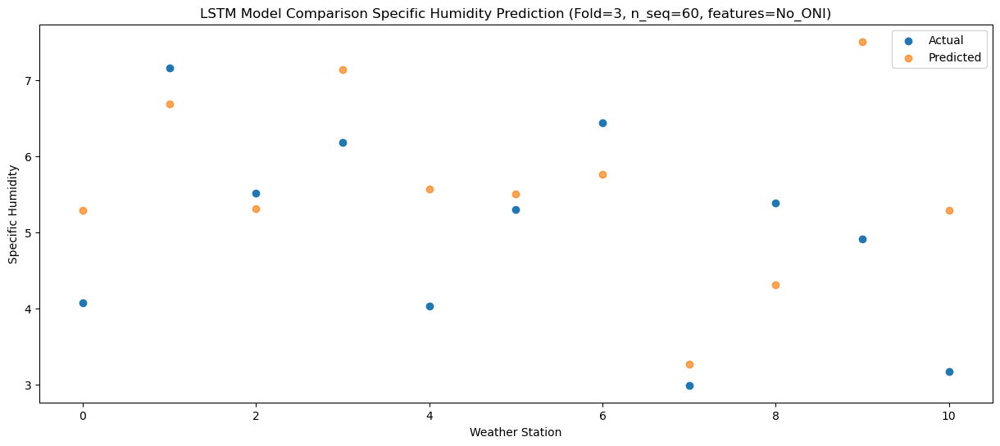

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0    7.61   8.057996
1                 1   10.69   9.457996
2                 2    7.06   8.077996
3                 3    9.42   9.907996
4                 4    7.12   8.337996
5                 5    8.03   8.277996
6                 6    7.50   8.527996
7                 7    3.32   6.037996
8                 8    5.61   7.077996
9                 9    9.02  10.277996
10               10    6.74   8.057996


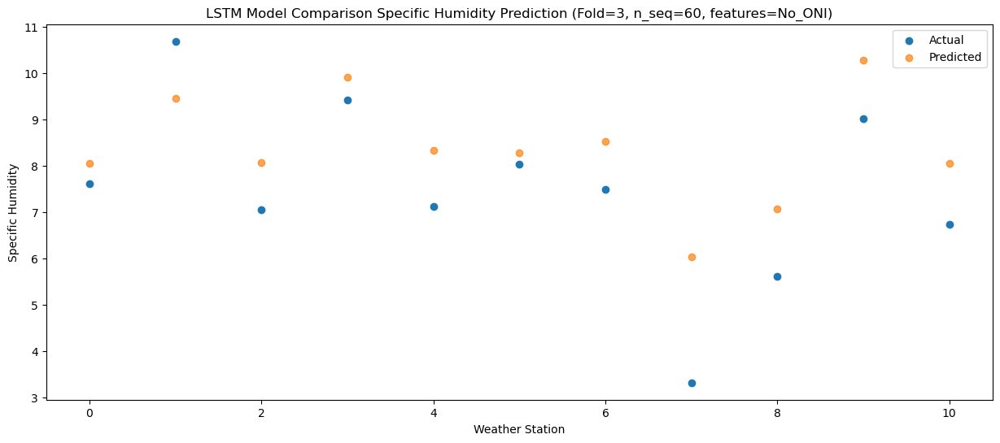

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   10.30  10.809737
1                 1   13.43  12.209737
2                 2    7.28  10.829737
3                 3   12.52  12.659737
4                 4   11.07  11.089737
5                 5   11.19  11.029737
6                 6    9.02  11.279737
7                 7    3.80   8.789737
8                 8    6.08   9.829737
9                 9   13.00  13.029737
10               10   10.09  10.809737


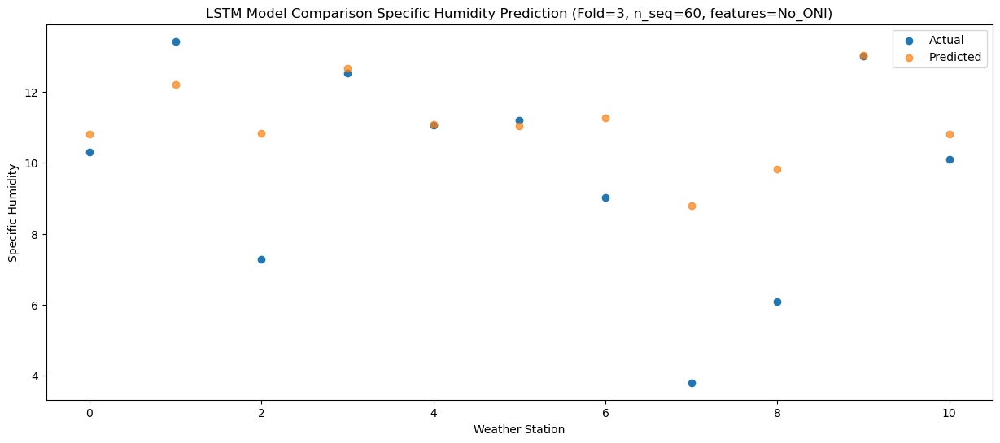

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   10.59   9.285443
1                 1   10.76  10.685443
2                 2    8.80   9.305443
3                 3   11.44  11.135443
4                 4    8.69   9.565443
5                 5    9.97   9.505443
6                 6    7.81   9.755443
7                 7    4.67   7.265443
8                 8    6.88   8.305443
9                 9   11.93  11.505443
10               10    9.45   9.285443


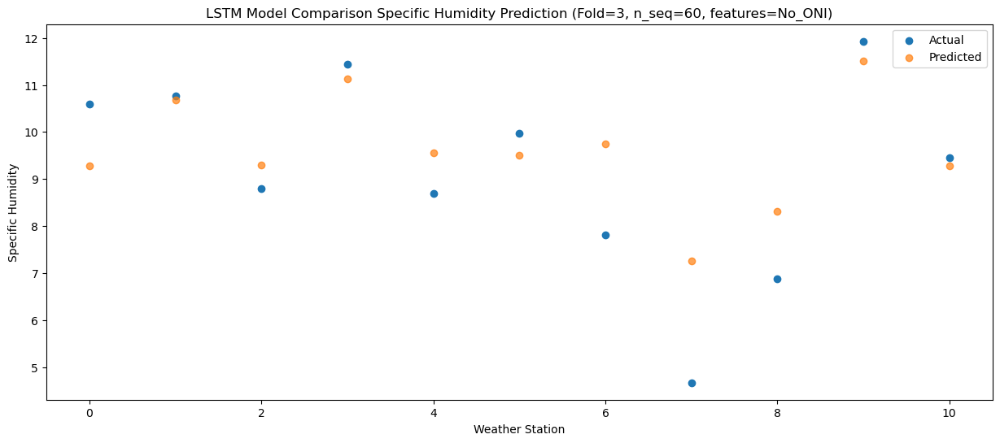

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    6.85   7.311366
1                 1    9.32   8.711366
2                 2    8.32   7.331366
3                 3    8.87   9.161366
4                 4    5.73   7.591366
5                 5    6.79   7.531366
6                 6    6.67   7.781366
7                 7    3.41   5.291366
8                 8    6.49   6.331366
9                 9    8.56   9.531366
10               10    6.16   7.311366


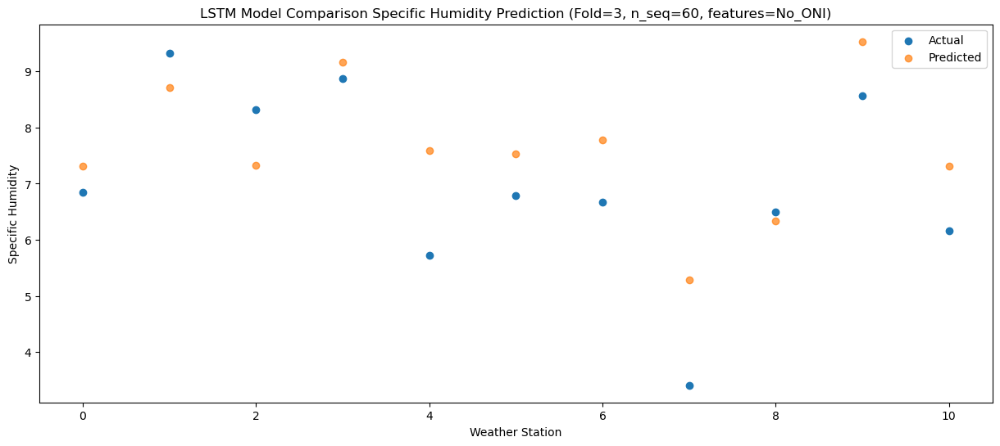

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    4.27   2.984472
1                 1    4.75   4.384472
2                 2    6.44   3.004472
3                 3    5.18   4.834472
4                 4    1.01   3.264472
5                 5    3.37   3.204472
6                 6    5.02   3.454472
7                 7    2.40   0.964472
8                 8    4.29   2.004472
9                 9    6.03   5.204472
10               10    3.39   2.984472


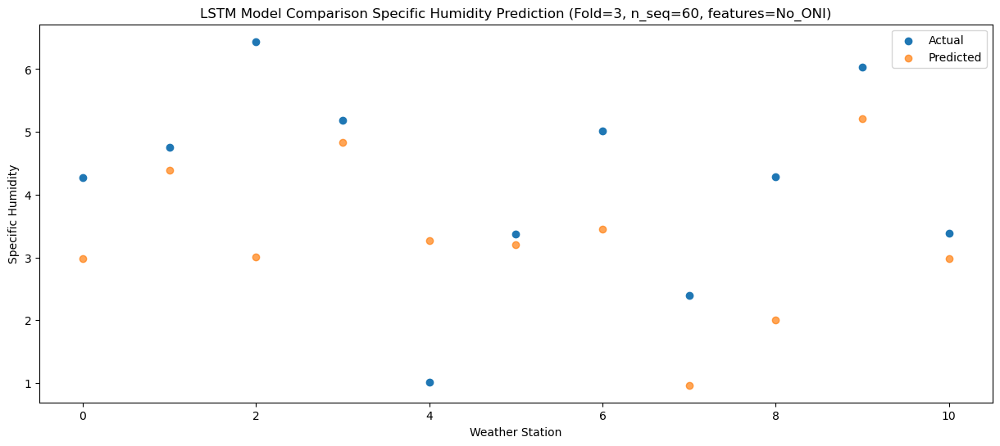

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    1.53   1.028063
1                 1    3.25   2.428063
2                 2    3.75   1.048063
3                 3    2.29   2.878063
4                 4   -0.09   1.308063
5                 5    1.60   1.248063
6                 6    4.96   1.498063
7                 7    2.38  -0.991937
8                 8    3.13   0.048063
9                 9    3.87   3.248063
10               10    1.06   1.028063


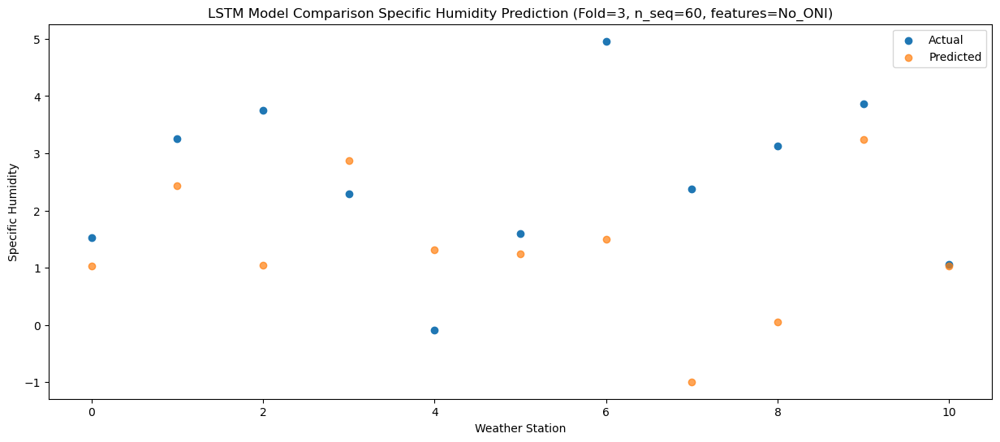

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -1.69  -1.596406
1                 1    1.21  -0.196406
2                 2    3.15  -1.576406
3                 3    0.68   0.253594
4                 4   -2.02  -1.316406
5                 5   -0.06  -1.376406
6                 6    4.15  -1.126406
7                 7    1.55  -3.616406
8                 8    2.79  -2.576406
9                 9    1.91   0.623594
10               10   -0.79  -1.596406


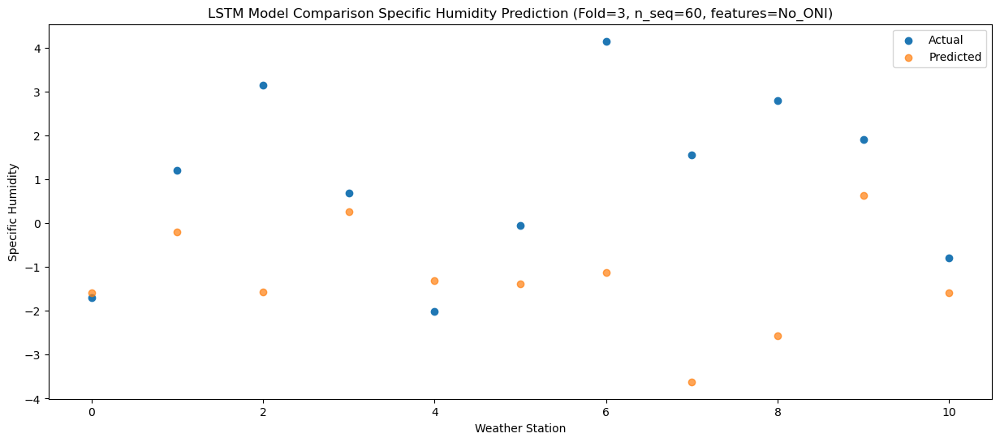

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -1.82  -1.253539
1                 1    1.12   0.146461
2                 2    3.59  -1.233539
3                 3    0.41   0.596461
4                 4   -2.22  -0.973539
5                 5   -0.37  -1.033539
6                 6    4.32  -0.783539
7                 7    2.36  -3.273539
8                 8    3.46  -2.233539
9                 9    0.82   0.966461
10               10   -1.48  -1.253539


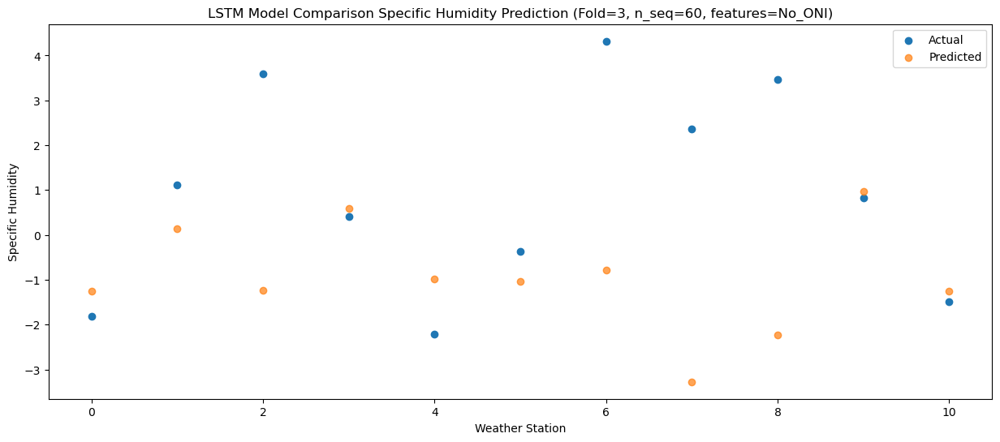

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -1.73  -1.480374
1                 1    0.56  -0.080374
2                 2    3.53  -1.460374
3                 3    0.34   0.369626
4                 4   -3.05  -1.200374
5                 5   -0.89  -1.260374
6                 6    4.38  -1.010374
7                 7    1.88  -3.500374
8                 8    3.11  -2.460374
9                 9    0.97   0.739626
10               10   -1.62  -1.480374


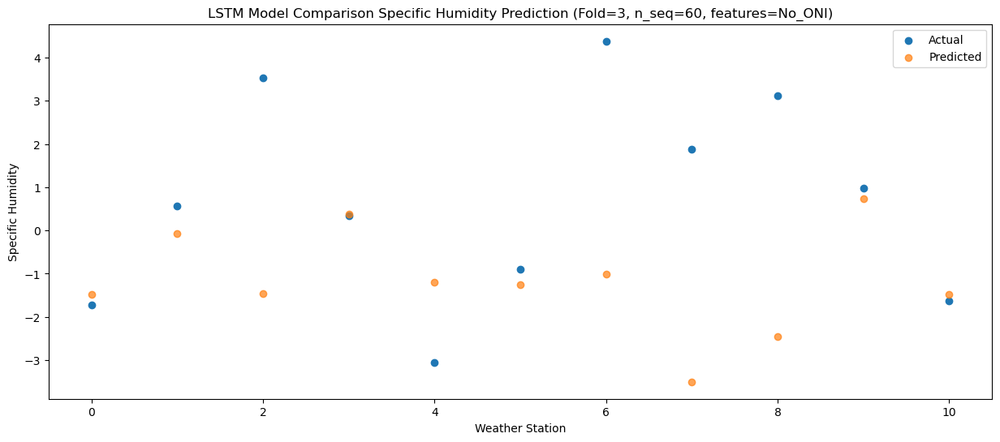

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0   -0.08   1.076697
1                 1    3.07   2.476697
2                 2    3.61   1.096697
3                 3    1.64   2.926697
4                 4   -0.57   1.356697
5                 5    1.14   1.296697
6                 6    4.69   1.546697
7                 7    2.18  -0.943303
8                 8    2.76   0.096697
9                 9    1.75   3.296697
10               10   -0.34   1.076697


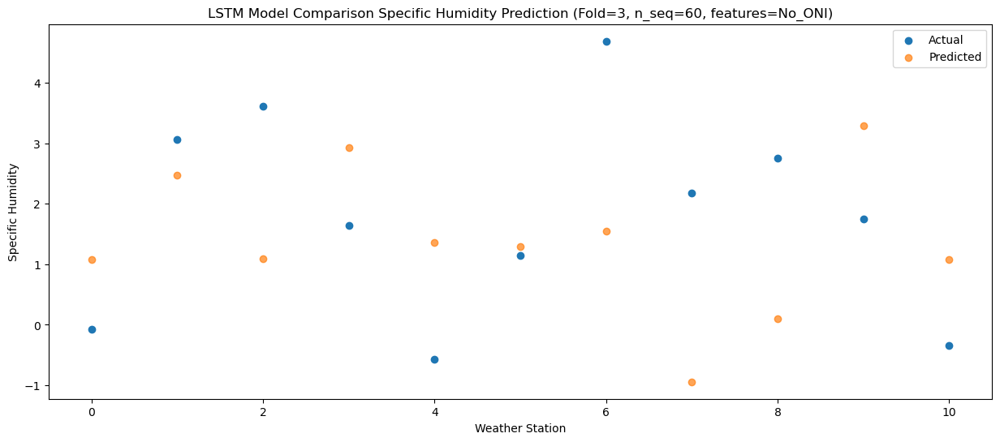

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    0.44   2.120311
1                 1    4.24   3.520311
2                 2    4.23   2.140311
3                 3    2.83   3.970311
4                 4    0.49   2.400311
5                 5    2.44   2.340311
6                 6    5.16   2.590311
7                 7    1.87   0.100311
8                 8    3.69   1.140311
9                 9    3.13   4.340311
10               10    1.07   2.120311


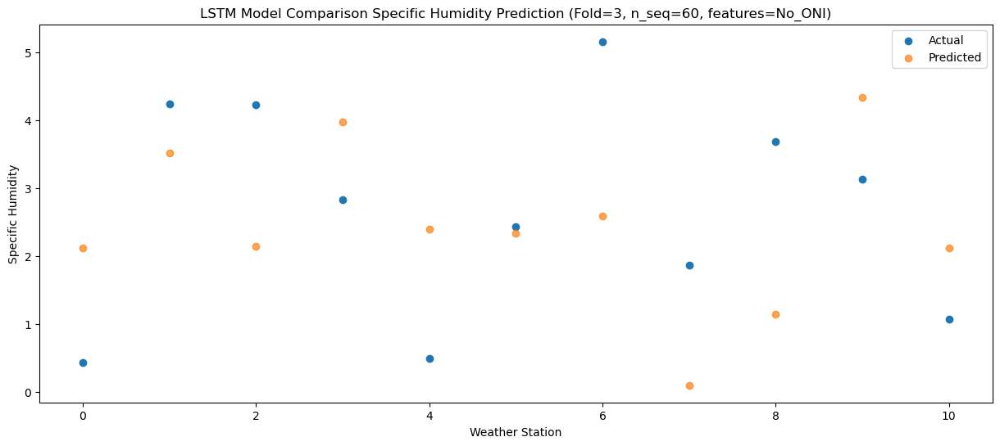

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    3.22   6.280613
1                 1    7.76   7.680613
2                 2    4.63   6.300613
3                 3    5.36   8.130613
4                 4    2.91   6.560613
5                 5    4.68   6.500613
6                 6    6.56   6.750613
7                 7    2.43   4.260613
8                 8    4.13   5.300613
9                 9    4.70   8.500613
10               10    2.66   6.280613


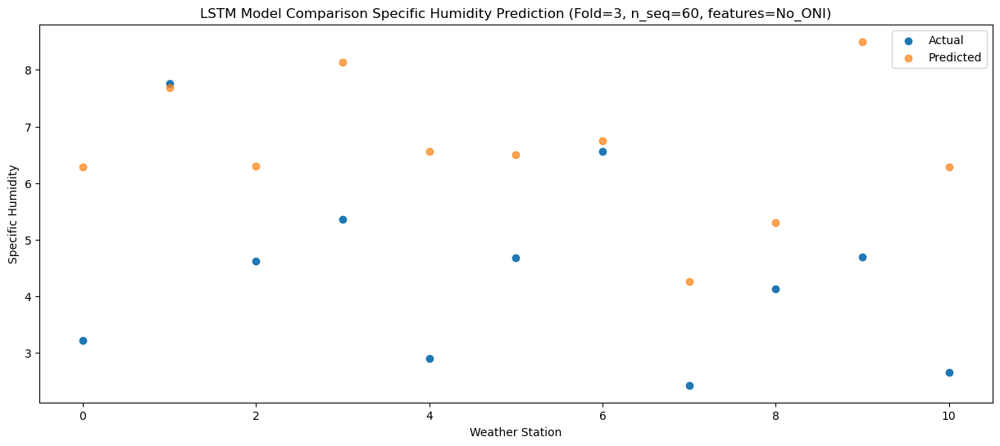

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0    7.94   9.758793
1                 1   12.29  11.158793
2                 2    7.08   9.778793
3                 3   10.78  11.608793
4                 4    7.37  10.038793
5                 5    9.90   9.978793
6                 6    7.89  10.228793
7                 7    3.85   7.738793
8                 8    5.56   8.778793
9                 9    9.60  11.978793
10               10    7.53   9.758793


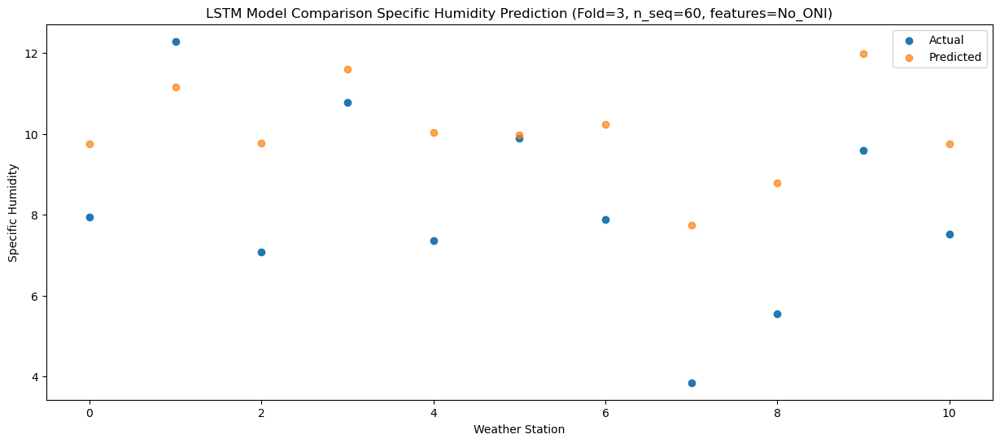

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0    9.18   9.583912
1                 1   13.17  10.983912
2                 2    7.78   9.603912
3                 3   11.41  11.433912
4                 4    9.32   9.863912
5                 5   11.15   9.803912
6                 6   10.34  10.053912
7                 7    9.21   7.563912
8                 8    6.04   8.603912
9                 9   11.81  11.803912
10               10    9.22   9.583912


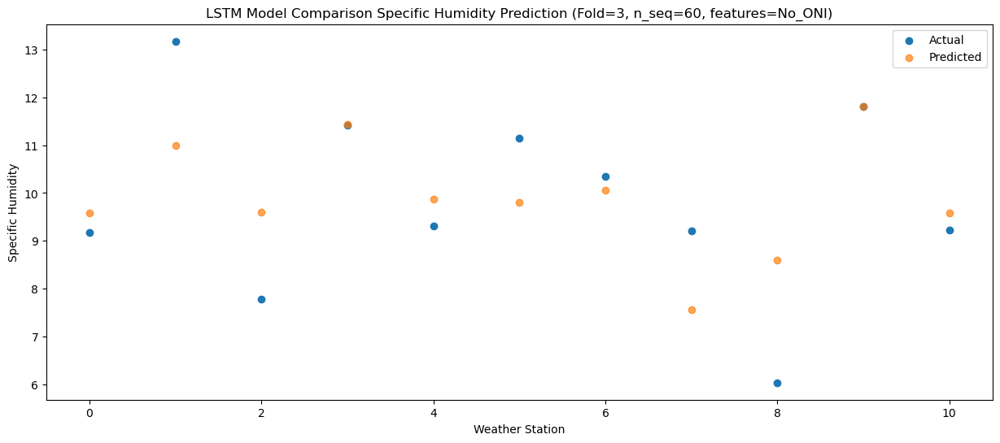

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0    9.45   9.835902
1                 1   13.34  11.235902
2                 2    7.31   9.855902
3                 3   12.29  11.685902
4                 4    9.41  10.115902
5                 5   11.32  10.055902
6                 6    8.91  10.305902
7                 7    6.78   7.815902
8                 8    6.43   8.855902
9                 9   12.19  12.055902
10               10    9.54   9.835902


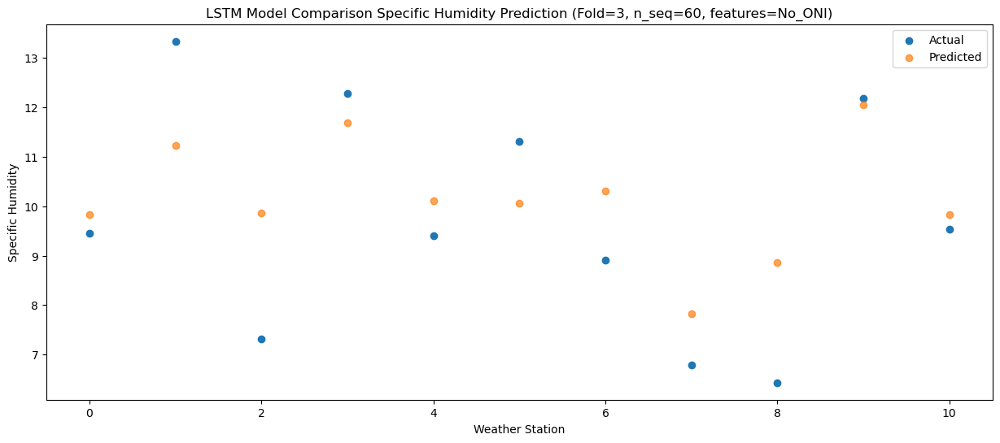

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    5.83   7.137454
1                 1    9.37   8.537454
2                 2    6.02   7.157454
3                 3    8.82   8.987454
4                 4    5.64   7.417454
5                 5    8.02   7.357454
6                 6    7.21   7.607454
7                 7    5.06   5.117454
8                 8    5.79   6.157454
9                 9    9.59   9.357454
10               10    6.62   7.137454


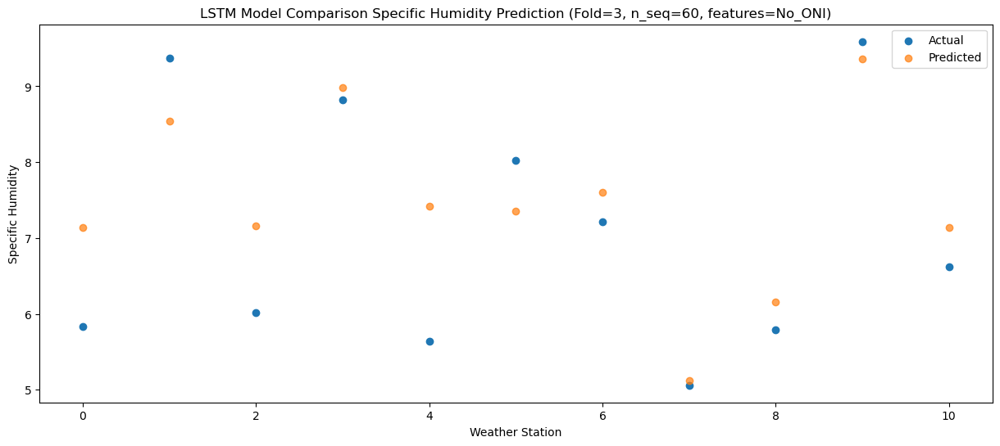

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    3.79   5.093801
1                 1    7.18   6.493801
2                 2    4.88   5.113801
3                 3    6.76   6.943801
4                 4    3.69   5.373801
5                 5    6.40   5.313801
6                 6    6.12   5.563801
7                 7    3.96   3.073801
8                 8    4.76   4.113801
9                 9    7.05   7.313801
10               10    4.72   5.093801


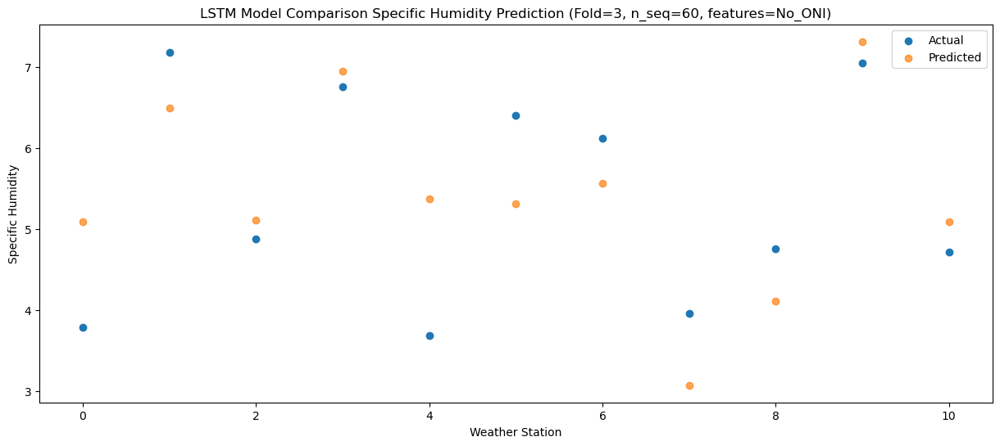

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0   -1.71  -0.324353
1                 1    2.75   1.075647
2                 2    5.46  -0.304353
3                 3    1.07   1.525647
4                 4   -1.43  -0.044353
5                 5    0.53  -0.104353
6                 6    5.41   0.145647
7                 7    2.69  -2.344353
8                 8    4.98  -1.304353
9                 9    2.52   1.895647
10               10   -0.20  -0.324353


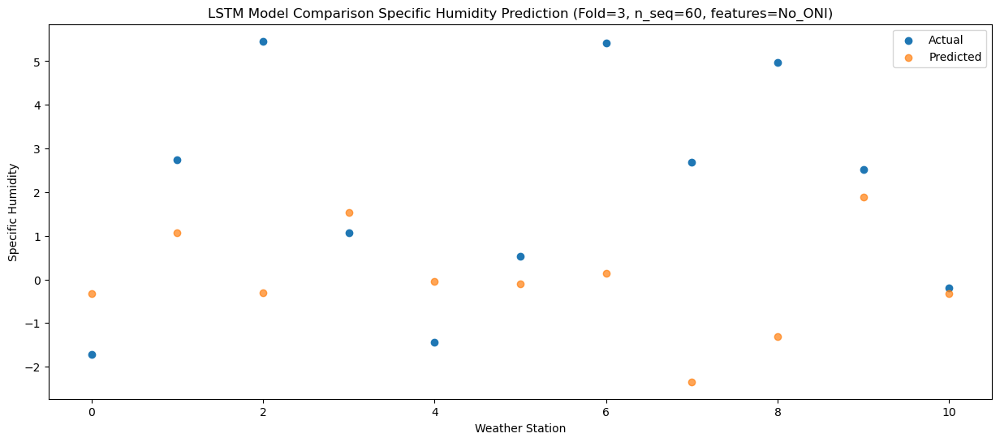

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    0.24   1.179538
1                 1    3.72   2.579538
2                 2    3.96   1.199538
3                 3    2.21   3.029538
4                 4   -0.73   1.459538
5                 5    1.58   1.399538
6                 6    4.70   1.649538
7                 7    2.83  -0.840462
8                 8    3.73   0.199538
9                 9    2.22   3.399538
10               10   -0.30   1.179538


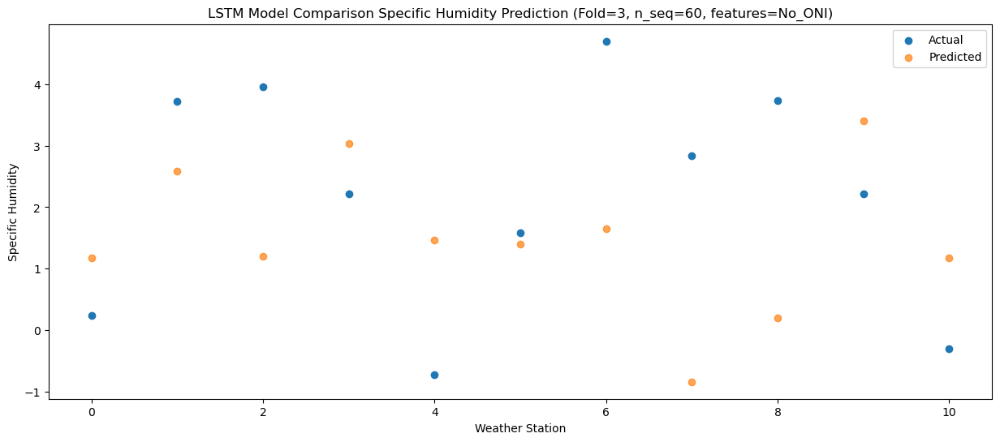

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -2.55   -2.48082
1                 1    0.53   -1.08082
2                 2    3.68   -2.46082
3                 3   -0.11   -0.63082
4                 4   -3.19   -2.20082
5                 5   -0.93   -2.26082
6                 6    4.22   -2.01082
7                 7    1.84   -4.50082
8                 8    3.40   -3.46082
9                 9    0.74   -0.26082
10               10   -1.81   -2.48082


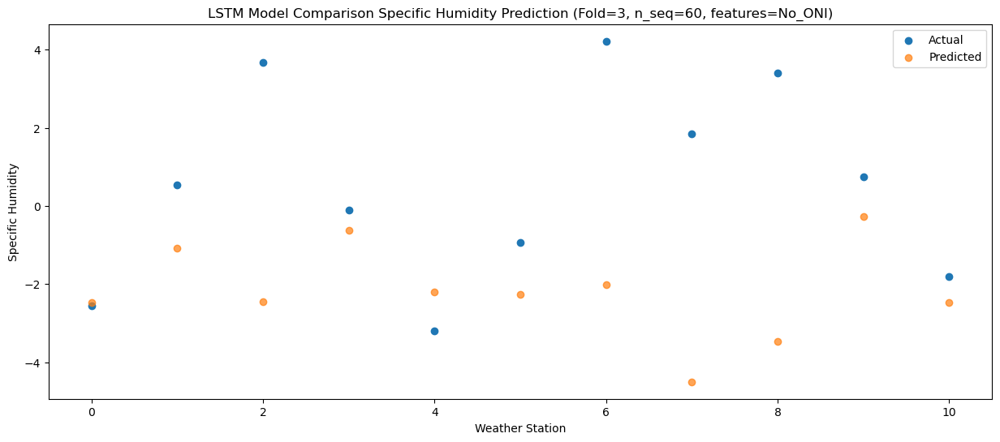

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -1.19  -1.701993
1                 1    0.90  -0.301993
2                 2    2.90  -1.681993
3                 3    0.41   0.148007
4                 4   -2.57  -1.421993
5                 5   -0.40  -1.481993
6                 6    4.01  -1.231993
7                 7    1.41  -3.721993
8                 8    2.56  -2.681993
9                 9    1.33   0.518007
10               10   -1.11  -1.701993


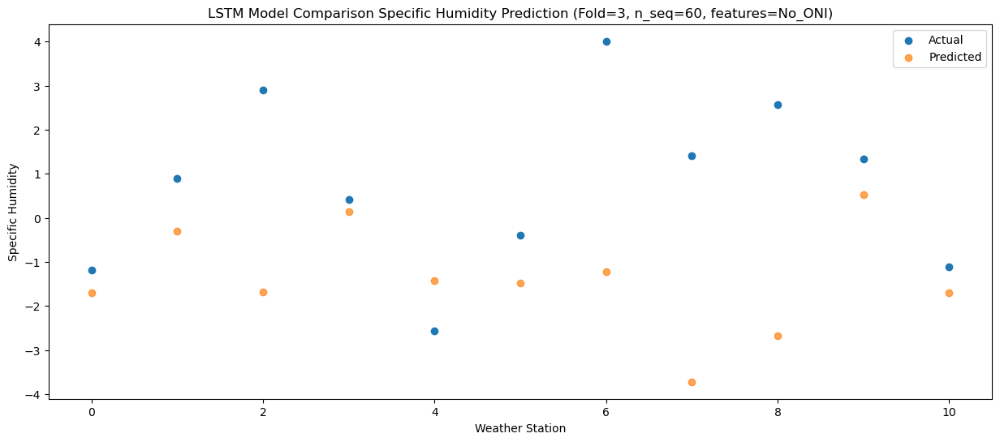

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0   -0.29  -0.721092
1                 1    2.37   0.678908
2                 2    4.24  -0.701092
3                 3    1.39   1.128908
4                 4   -1.00  -0.441092
5                 5    0.91  -0.501092
6                 6    4.69  -0.251092
7                 7    2.03  -2.741092
8                 8    3.56  -1.701092
9                 9    2.17   1.498908
10               10   -0.17  -0.721092


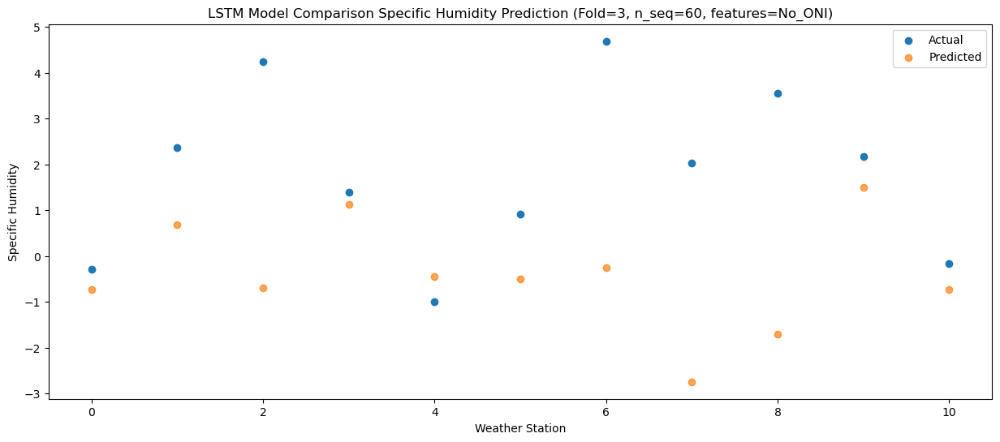

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    0.74   2.093853
1                 1    4.67   3.493853
2                 2    3.91   2.113853
3                 3    2.66   3.943853
4                 4    0.56   2.373853
5                 5    2.44   2.313853
6                 6    5.19   2.563853
7                 7    2.03   0.073853
8                 8    3.66   1.113853
9                 9    2.82   4.313853
10               10    0.47   2.093853


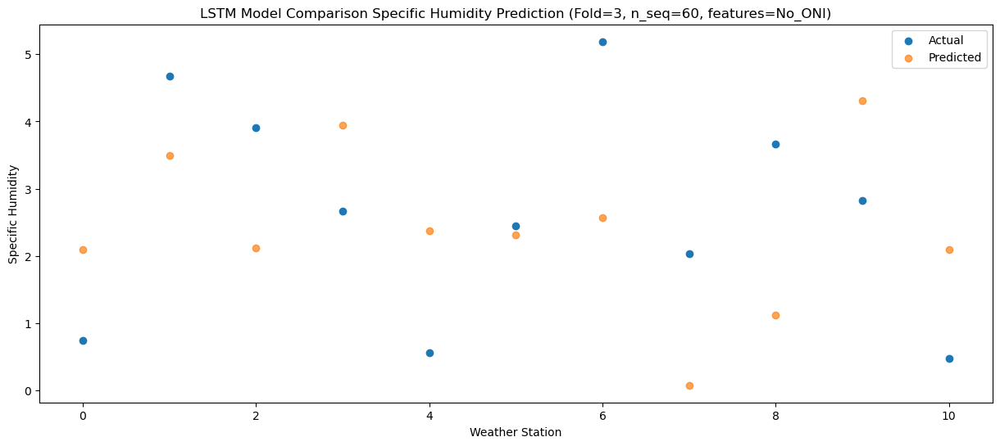

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    5.05   5.778254
1                 1    9.12   7.178254
2                 2    4.09   5.798254
3                 3    7.08   7.628254
4                 4    4.65   6.058254
5                 5    6.67   5.998254
6                 6    6.00   6.248254
7                 7    2.29   3.758254
8                 8    4.03   4.798254
9                 9    6.21   7.998254
10               10    4.65   5.778254


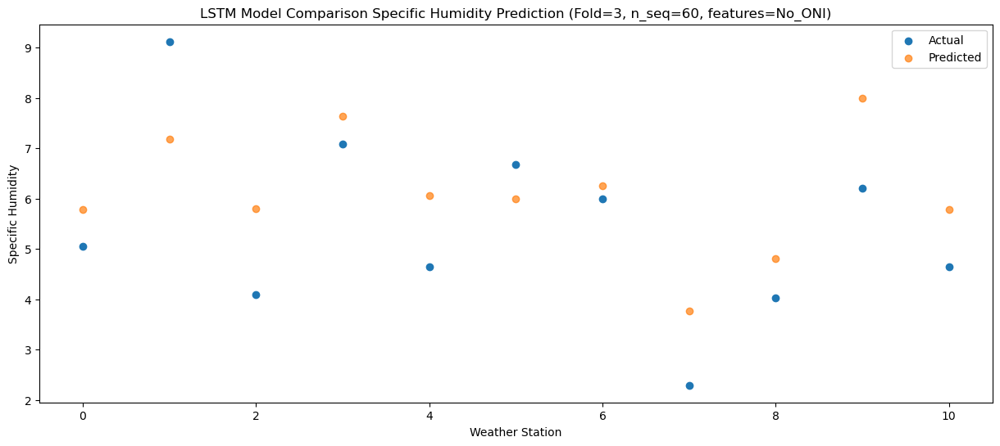

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0    6.35   7.985238
1                 1   11.74   9.385238
2                 2    5.26   8.005238
3                 3    9.34   9.835238
4                 4    6.75   8.265238
5                 5    8.74   8.205238
6                 6    7.94   8.455238
7                 7    4.05   5.965238
8                 8    5.52   7.005238
9                 9    8.55  10.205238
10               10    6.05   7.985238


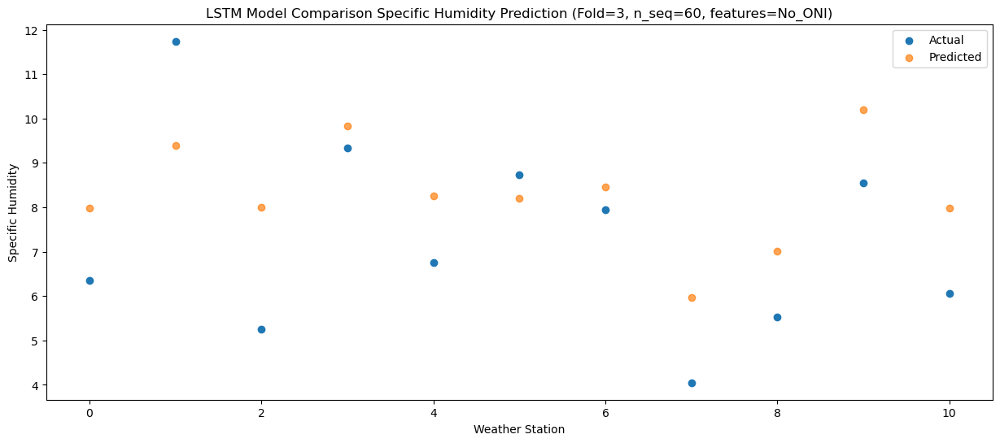

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   10.42   8.737034
1                 1   11.95  10.137034
2                 2    6.43   8.757034
3                 3   12.38  10.587034
4                 4    9.34   9.017034
5                 5   11.52   8.957034
6                 6   10.93   9.207034
7                 7    7.48   6.717034
8                 8    6.35   7.757034
9                 9   11.71  10.957034
10               10    9.03   8.737034


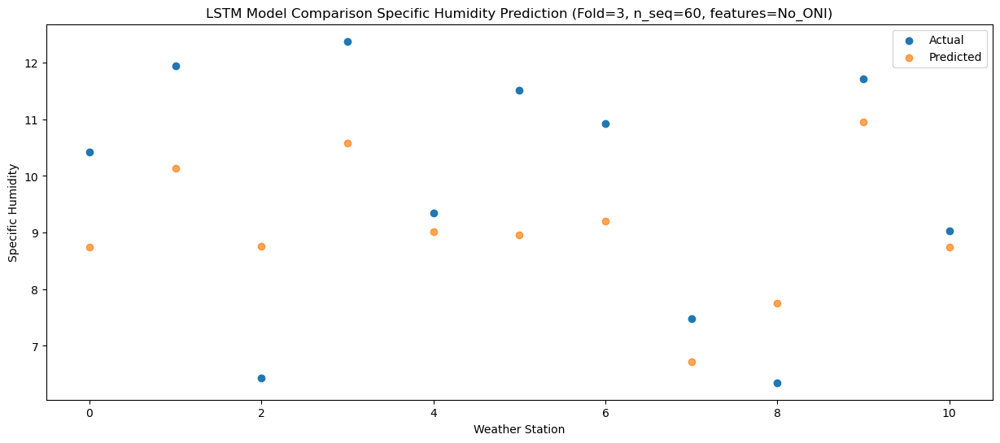

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0    8.61   8.511506
1                 1   12.56   9.911506
2                 2    7.22   8.531506
3                 3   11.25  10.361506
4                 4    8.84   8.791506
5                 5   10.32   8.731506
6                 6   10.77   8.981506
7                 7   10.55   6.491506
8                 8    6.81   7.531506
9                 9   11.85  10.731506
10               10    8.66   8.511506


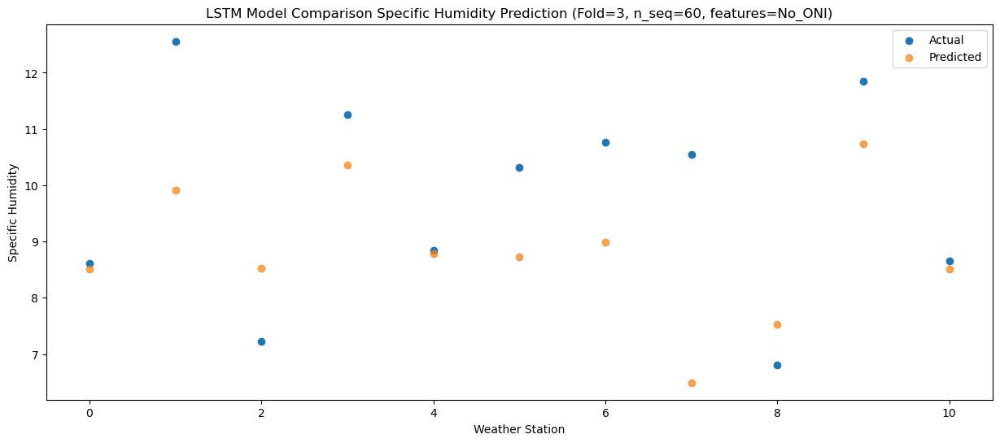

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    5.19   5.845212
1                 1    8.71   7.245212
2                 2    6.93   5.865212
3                 3    8.00   7.695212
4                 4    5.74   6.125212
5                 5    7.55   6.065212
6                 6    7.82   6.315212
7                 7    6.64   3.825212
8                 8    6.21   4.865212
9                 9    8.18   8.065212
10               10    5.64   5.845212


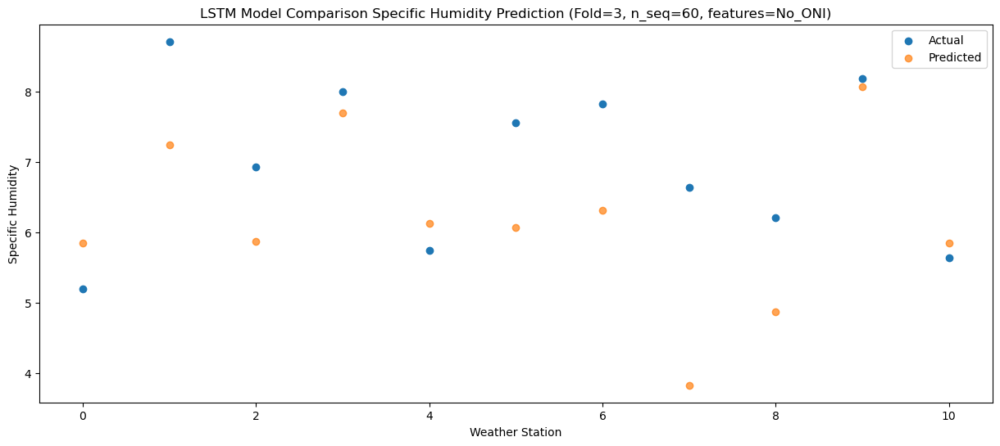

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    0.96   0.982131
1                 1    4.25   2.382131
2                 2    5.76   1.002131
3                 3    2.85   2.832131
4                 4    0.74   1.262131
5                 5    2.25   1.202131
6                 6    6.21   1.452131
7                 7    3.91  -1.037869
8                 8    4.90   0.002131
9                 9    5.55   3.202131
10               10    2.22   0.982131


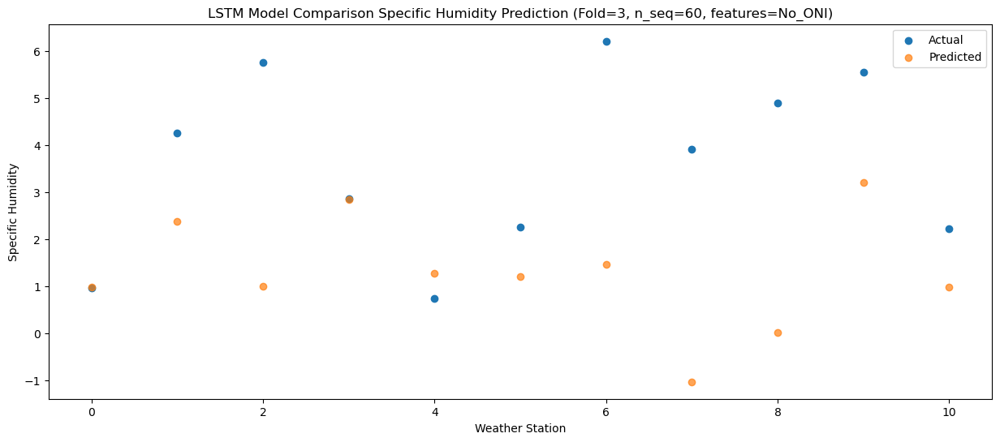

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    0.51  -0.419151
1                 1    3.22   0.980849
2                 2    3.04  -0.399151
3                 3    2.04   1.430849
4                 4   -0.65  -0.139151
5                 5    1.03  -0.199151
6                 6    4.55   0.050849
7                 7    2.14  -2.439151
8                 8    2.65  -1.399151
9                 9    3.70   1.800849
10               10    1.00  -0.419151


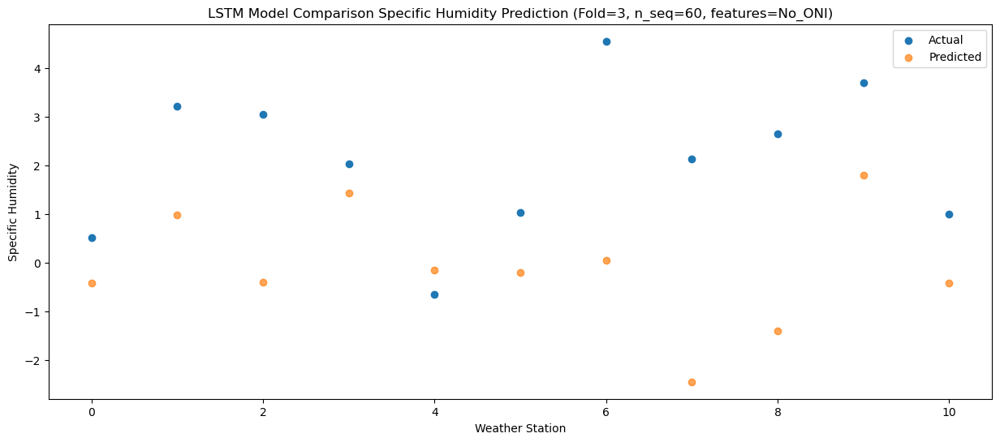

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -1.69  -2.322521
1                 1    2.03  -0.922521
2                 2    3.88  -2.302521
3                 3    1.01  -0.472521
4                 4   -1.77  -2.042521
5                 5    0.27  -2.102521
6                 6    4.58  -1.852521
7                 7    2.89  -4.342521
8                 8    3.44  -3.302521
9                 9    1.73  -0.102521
10               10   -0.92  -2.322521


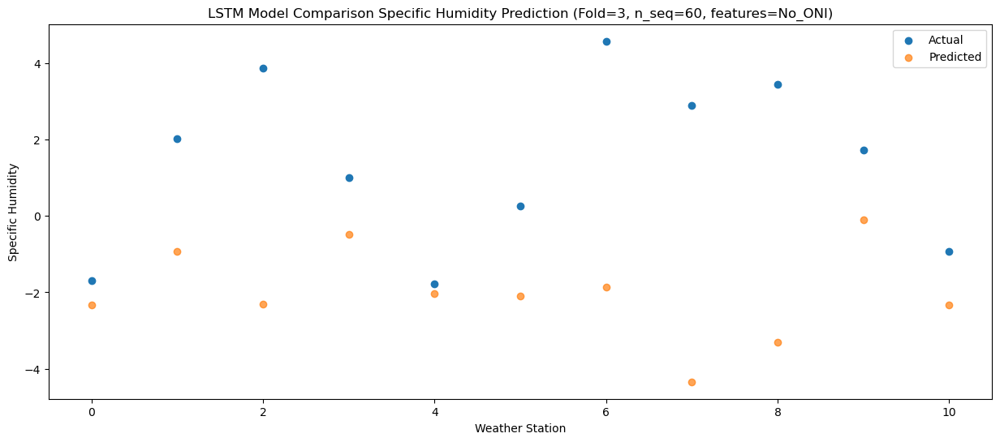

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0   -0.78  -2.743077
1                 1    1.95  -1.343077
2                 2    4.03  -2.723077
3                 3    1.55  -0.893077
4                 4   -1.39  -2.463077
5                 5    0.85  -2.523077
6                 6    4.55  -2.273077
7                 7    3.28  -4.763077
8                 8    3.27  -3.723077
9                 9    2.30  -0.523077
10               10   -0.14  -2.743077


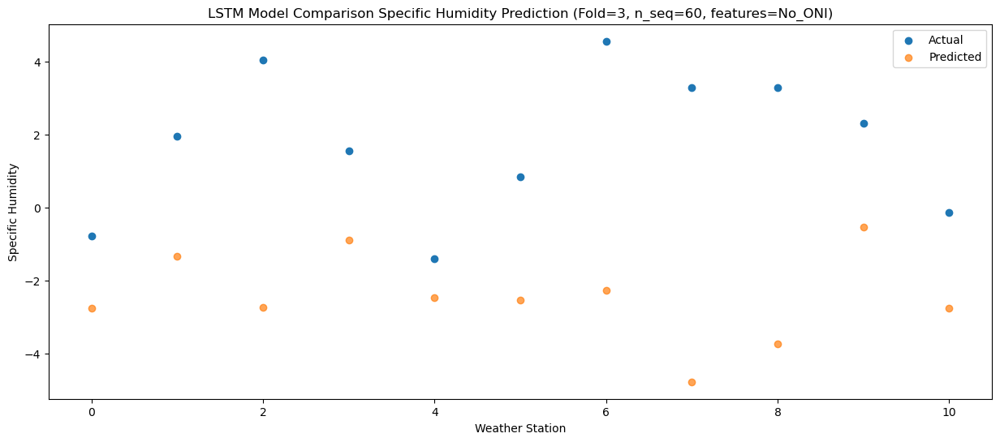

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0   -0.05  -2.359933
1                 1    2.11  -0.959933
2                 2    2.90  -2.339933
3                 3    1.37  -0.509933
4                 4   -0.51  -2.079933
5                 5    0.52  -2.139933
6                 6    4.17  -1.889933
7                 7    2.03  -4.379933
8                 8    2.41  -3.339933
9                 9    1.59  -0.139933
10               10   -0.89  -2.359933


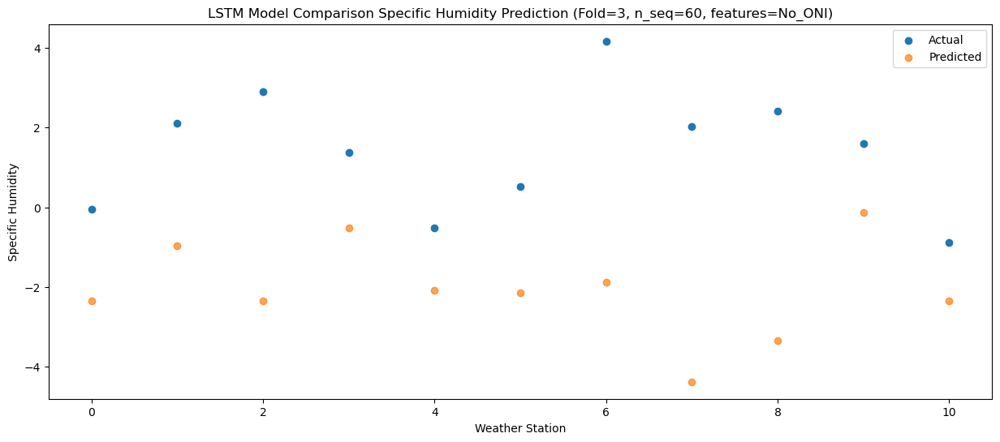

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0   -0.44   -1.36902
1                 1    3.05    0.03098
2                 2    4.42   -1.34902
3                 3    1.24    0.48098
4                 4   -0.84   -1.08902
5                 5    0.95   -1.14902
6                 6    4.47   -0.89902
7                 7    3.07   -3.38902
8                 8    3.21   -2.34902
9                 9    1.80    0.85098
10               10   -0.76   -1.36902


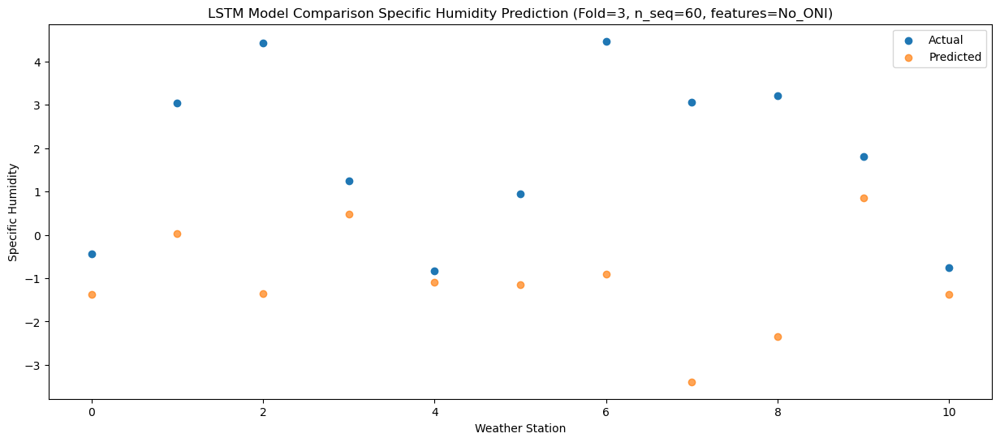

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    1.55   -0.27374
1                 1    3.92    1.12626
2                 2    4.62   -0.25374
3                 3    2.78    1.57626
4                 4    0.39    0.00626
5                 5    2.26   -0.05374
6                 6    5.10    0.19626
7                 7    2.22   -2.29374
8                 8    3.59   -1.25374
9                 9    4.04    1.94626
10               10    1.67   -0.27374


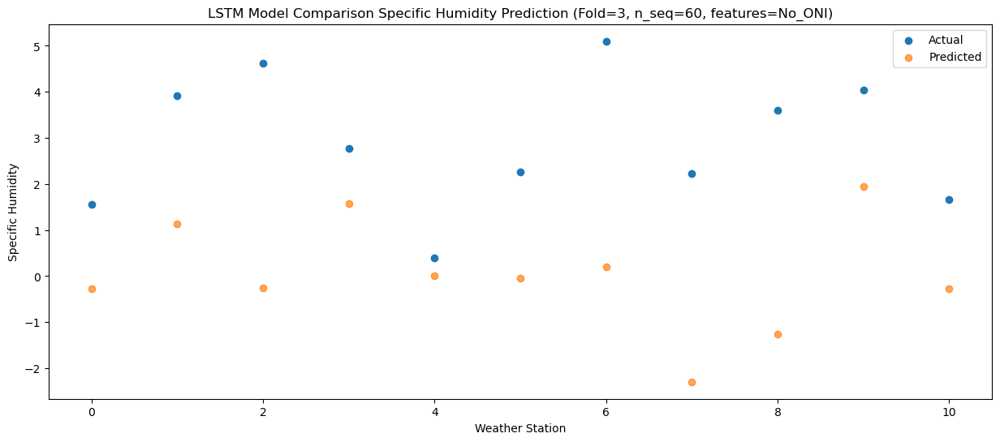

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    3.00   2.907003
1                 1    8.33   4.307003
2                 2    5.56   2.927003
3                 3    5.69   4.757003
4                 4    3.57   3.187003
5                 5    4.86   3.127003
6                 6    7.26   3.377003
7                 7    3.76   0.887003
8                 8    5.18   1.927003
9                 9    4.56   5.127003
10               10    2.14   2.907003


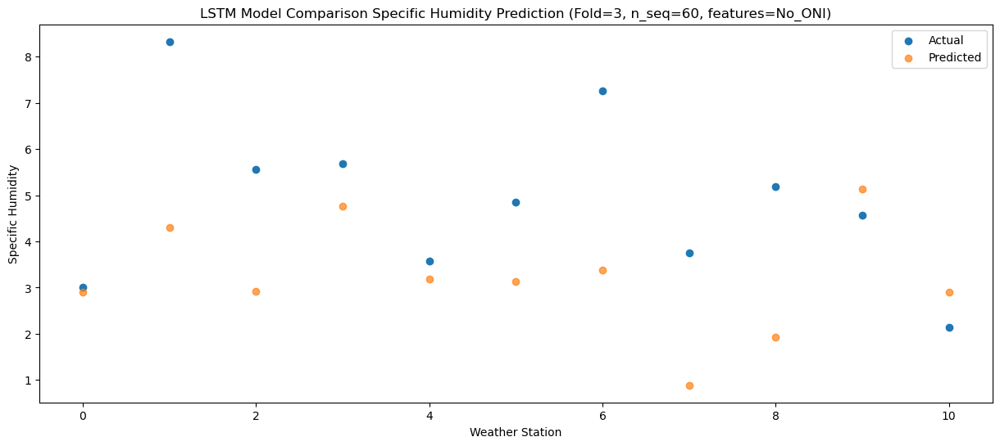

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0    6.27   5.915838
1                 1   10.97   7.315838
2                 2    6.33   5.935838
3                 3    7.71   7.765838
4                 4    5.70   6.195838
5                 5    7.02   6.135838
6                 6    7.49   6.385838
7                 7    4.26   3.895838
8                 8    5.24   4.935838
9                 9    8.26   8.135838
10               10    5.83   5.915838


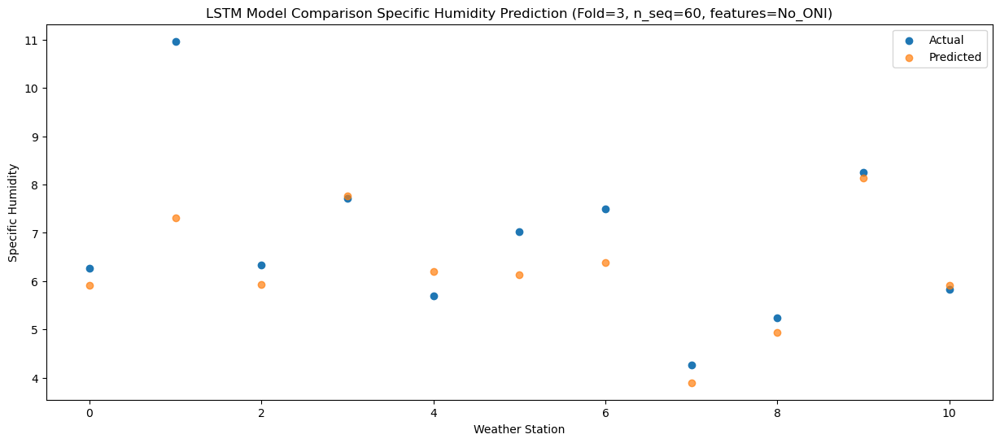

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   10.22   8.331515
1                 1   13.24   9.731515
2                 2    7.43   8.351515
3                 3   11.36  10.181515
4                 4    9.47   8.611515
5                 5   11.53   8.551515
6                 6    8.33   8.801515
7                 7    5.23   6.311515
8                 8    6.08   7.351515
9                 9   13.11  10.551515
10               10    9.81   8.331515


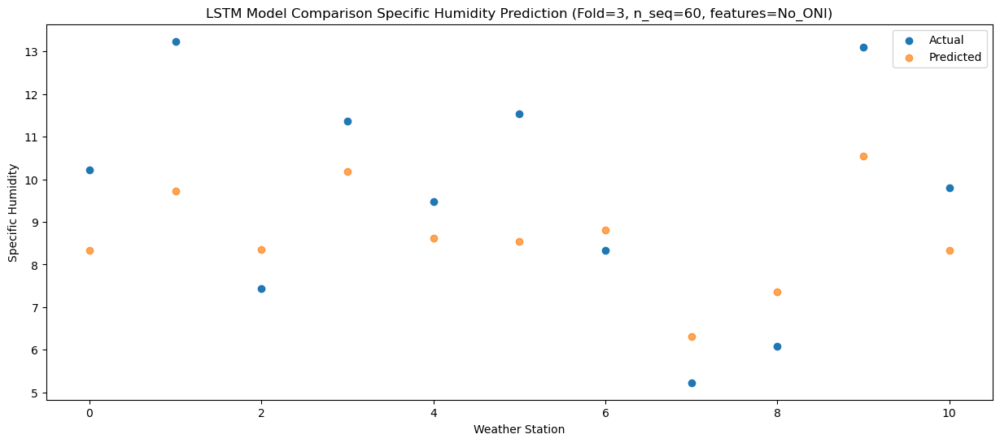

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0    9.32   7.323457
1                 1   13.48   8.723457
2                 2    8.50   7.343457
3                 3   10.81   9.173457
4                 4    9.86   7.603457
5                 5   10.65   7.543457
6                 6    9.98   7.793457
7                 7    7.81   5.303457
8                 8    7.35   6.343457
9                 9   10.54   9.543457
10               10    8.57   7.323457


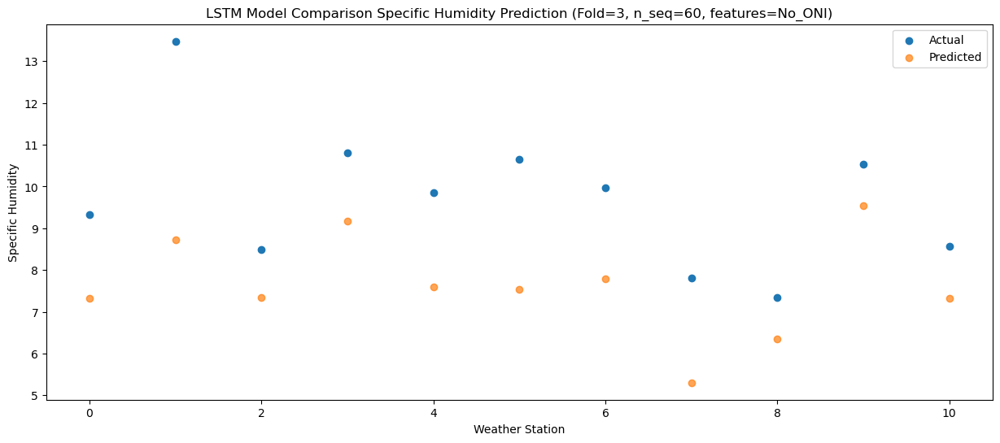

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    6.41   5.952912
1                 1    9.41   7.352912
2                 2    6.96   5.972912
3                 3    8.34   7.802912
4                 4    5.75   6.232912
5                 5    7.42   6.172912
6                 6    7.36   6.422912
7                 7    6.87   3.932912
8                 8    6.80   4.972912
9                 9    9.57   8.172912
10               10    6.88   5.952912


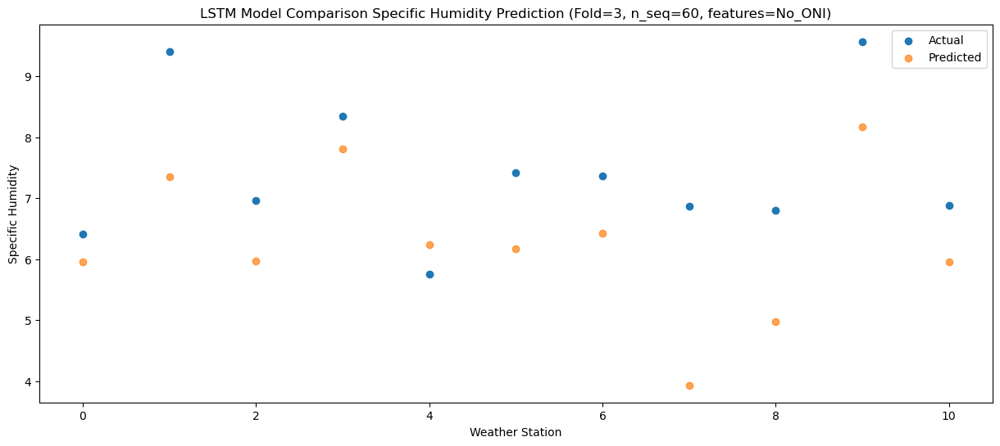

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    2.30   2.266049
1                 1    5.97   3.666049
2                 2    5.80   2.286049
3                 3    4.81   4.116049
4                 4    2.13   2.546049
5                 5    4.04   2.486049
6                 6    6.11   2.736049
7                 7    3.81   0.246049
8                 8    5.37   1.286049
9                 9    6.18   4.486049
10               10    3.61   2.266049


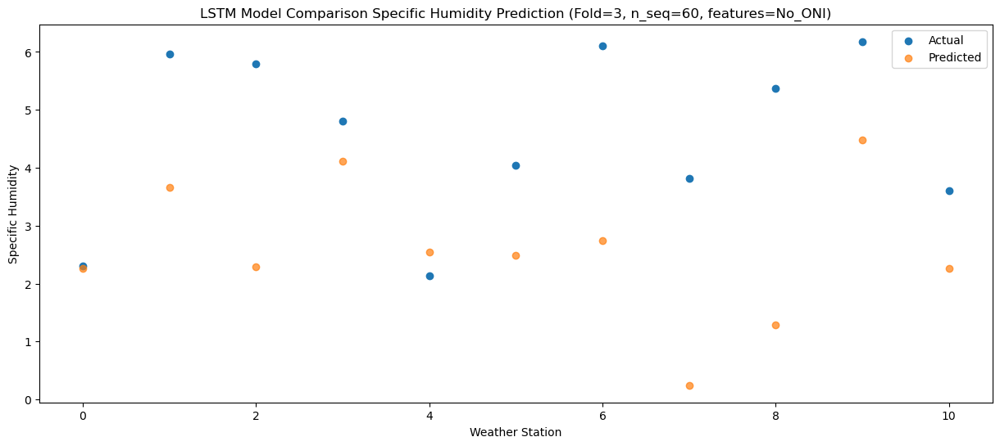

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0   -0.93  -0.695515
1                 1    3.09   0.704485
2                 2    3.69  -0.675515
3                 3    1.42   1.154485
4                 4   -1.04  -0.415515
5                 5    0.85  -0.475515
6                 6    4.78  -0.225515
7                 7    2.80  -2.715515
8                 8    4.28  -1.675515
9                 9    2.38   1.524485
10               10   -0.07  -0.695515


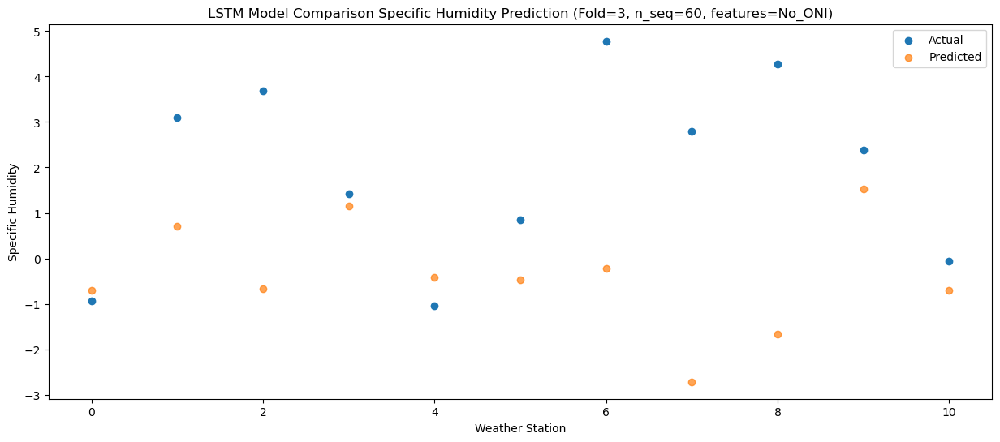

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -0.94  -1.422538
1                 1    2.27  -0.022538
2                 2    3.92  -1.402538
3                 3    1.44   0.427462
4                 4   -1.45  -1.142538
5                 5    0.81  -1.202538
6                 6    4.65  -0.952538
7                 7    2.72  -3.442538
8                 8    4.66  -2.402538
9                 9    2.71   0.797462
10               10    0.31  -1.422538


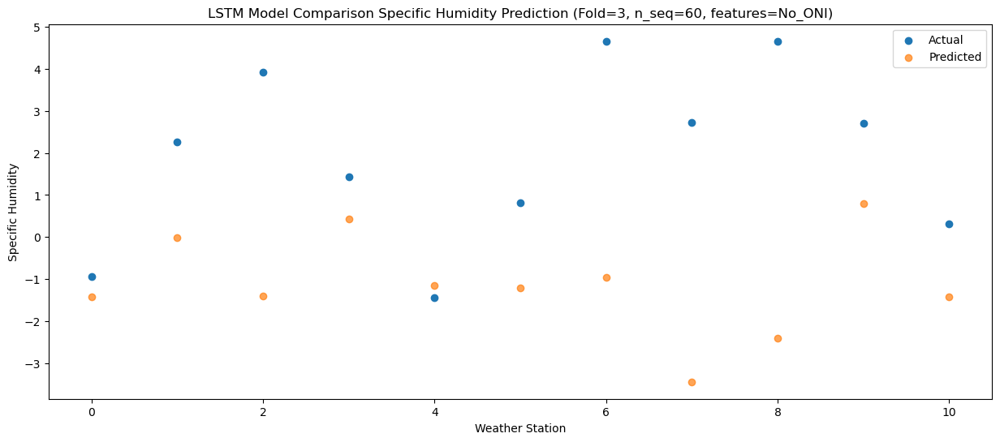

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -1.59  -2.052601
1                 1    0.96  -0.652601
2                 2    4.46  -2.032601
3                 3    0.70  -0.202601
4                 4   -2.32  -1.772601
5                 5   -0.07  -1.832601
6                 6    4.59  -1.582601
7                 7    3.26  -4.072601
8                 8    4.67  -3.032601
9                 9    1.41   0.167399
10               10   -0.82  -2.052601


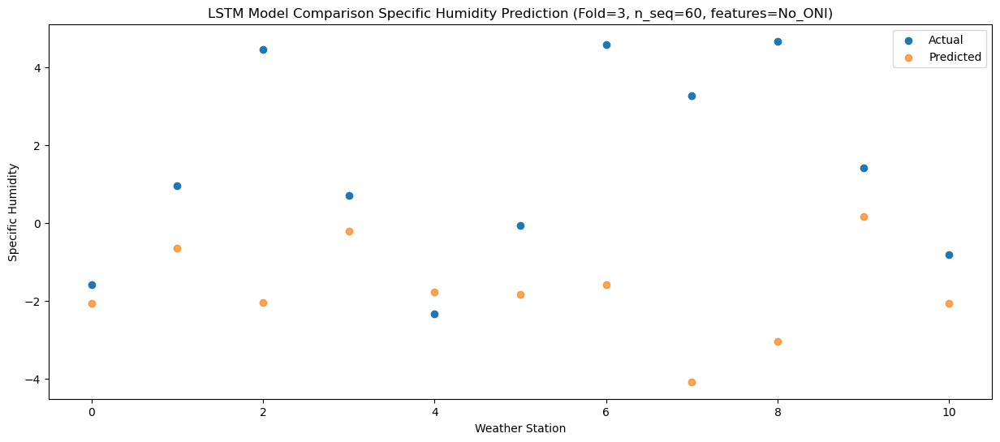

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0   -1.53  -0.909058
1                 1    2.38   0.490942
2                 2    4.63  -0.889058
3                 3    1.02   0.940942
4                 4   -1.41  -0.629058
5                 5    0.51  -0.689058
6                 6    4.66  -0.439058
7                 7    4.08  -2.929058
8                 8    4.36  -1.889058
9                 9    1.31   1.310942
10               10   -0.91  -0.909058


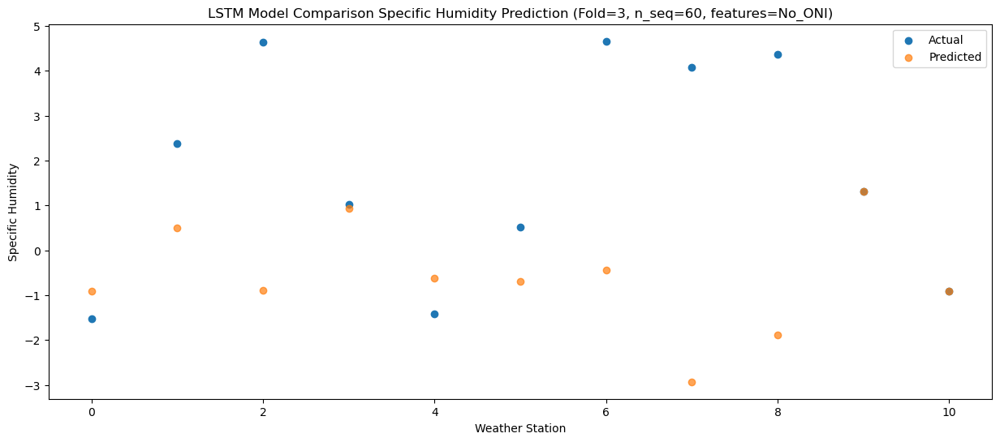

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0   -0.03   0.464384
1                 1    3.80   1.864384
2                 2    4.34   0.484384
3                 3    1.98   2.314384
4                 4   -0.37   0.744384
5                 5    1.59   0.684384
6                 6    5.02   0.934384
7                 7    3.40  -1.555616
8                 8    4.16  -0.515616
9                 9    2.36   2.684384
10               10    0.14   0.464384


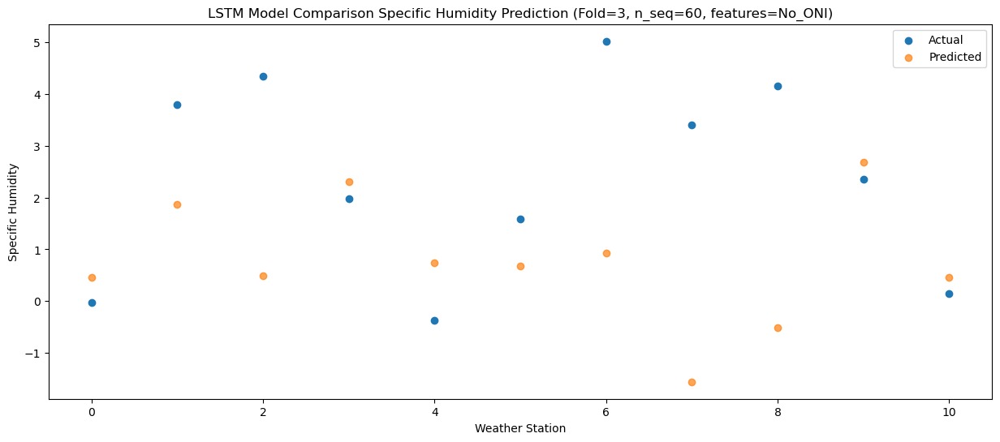

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    2.01   1.573869
1                 1    5.34   2.973869
2                 2    5.02   1.593869
3                 3    3.89   3.423869
4                 4    1.45   1.853869
5                 5    3.84   1.793869
6                 6    5.70   2.043869
7                 7    3.10  -0.446131
8                 8    4.60   0.593869
9                 9    3.27   3.793869
10               10    1.74   1.573869


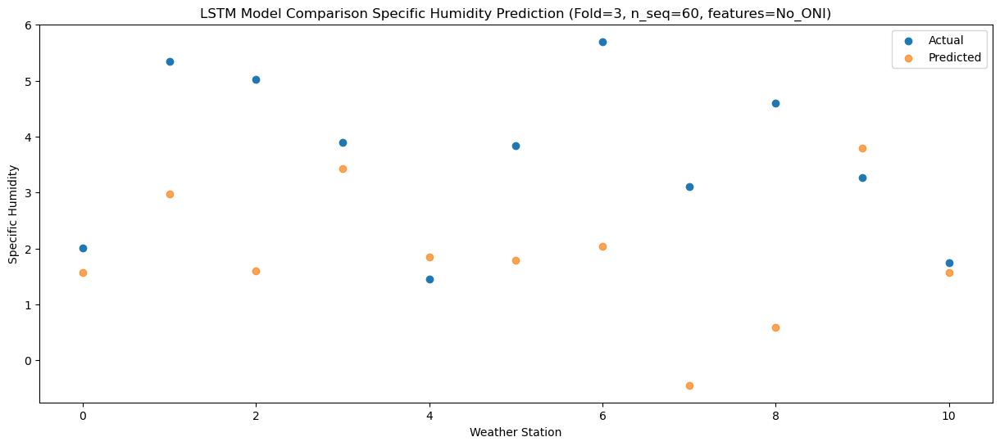

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    5.88   5.528702
1                 1    9.84   6.928702
2                 2    4.89   5.548702
3                 3    8.00   7.378702
4                 4    5.59   5.808702
5                 5    7.51   5.748702
6                 6    6.59   5.998702
7                 7    2.97   3.508702
8                 8    4.76   4.548702
9                 9    6.73   7.748702
10               10    5.37   5.528702


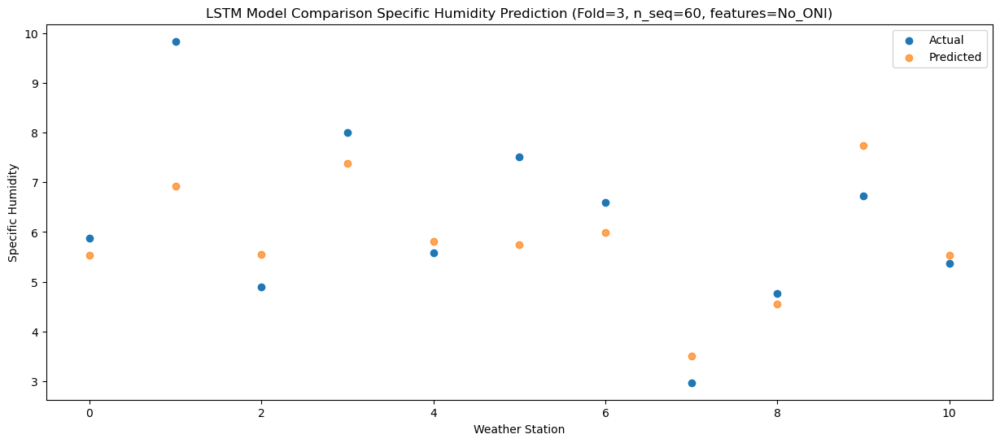

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0    7.61   8.043598
1                 1   12.12   9.443598
2                 2    6.16   8.063598
3                 3    9.80   9.893598
4                 4    7.56   8.323598
5                 5    9.33   8.263598
6                 6    8.88   8.513598
7                 7    4.37   6.023598
8                 8    5.91   7.063598
9                 9    9.60  10.263598
10               10    7.05   8.043598


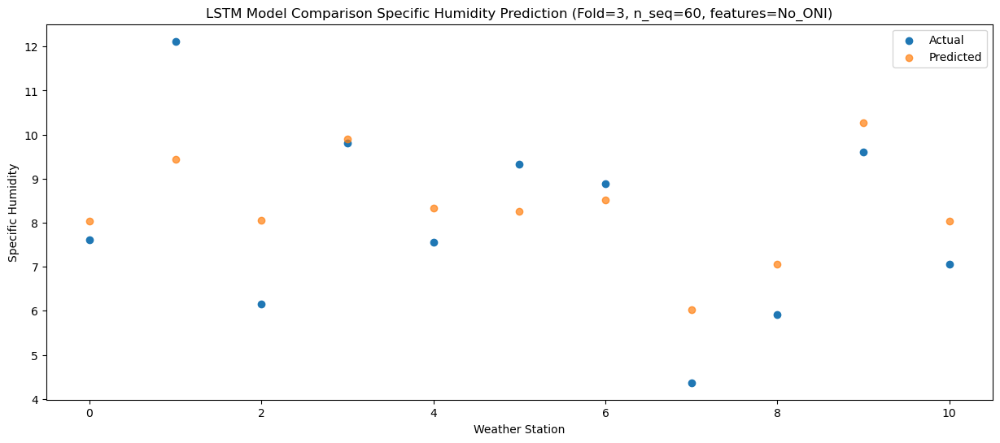

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   10.47   7.738252
1                 1   12.61   9.138252
2                 2    8.14   7.758252
3                 3   10.70   9.588252
4                 4    9.13   8.018252
5                 5   10.52   7.958252
6                 6    8.93   8.208252
7                 7    5.40   5.718252
8                 8    7.49   6.758252
9                 9   12.77   9.958252
10               10    9.93   7.738252


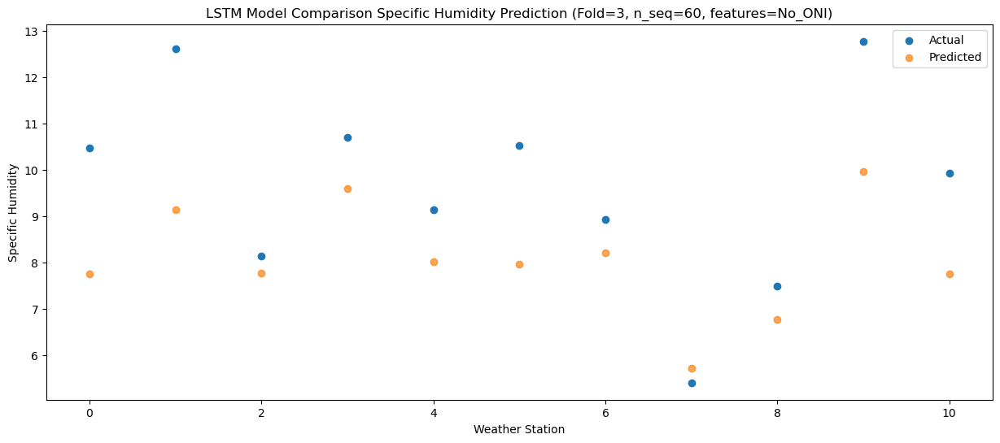

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0    9.03   7.952182
1                 1   11.87   9.352182
2                 2    6.45   7.972182
3                 3    9.38   9.802182
4                 4    8.65   8.232182
5                 5    9.96   8.172182
6                 6   10.39   8.422182
7                 7    6.22   5.932182
8                 8    6.76   6.972182
9                 9   11.42  10.172182
10               10    8.65   7.952182


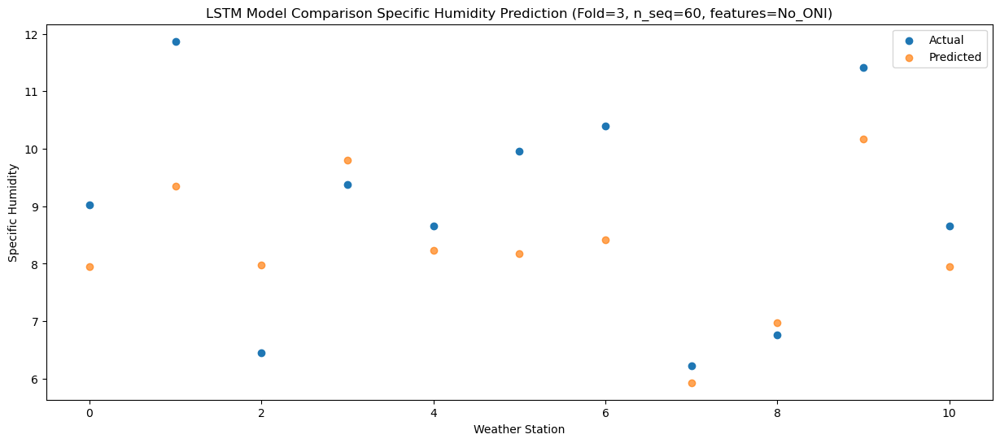

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    7.32   5.321132
1                 1    8.88   6.721132
2                 2    6.72   5.341132
3                 3    7.84   7.171132
4                 4    5.64   5.601132
5                 5    7.34   5.541132
6                 6    7.97   5.791132
7                 7    4.50   3.301132
8                 8    6.44   4.341132
9                 9    8.06   7.541132
10               10    5.83   5.321132


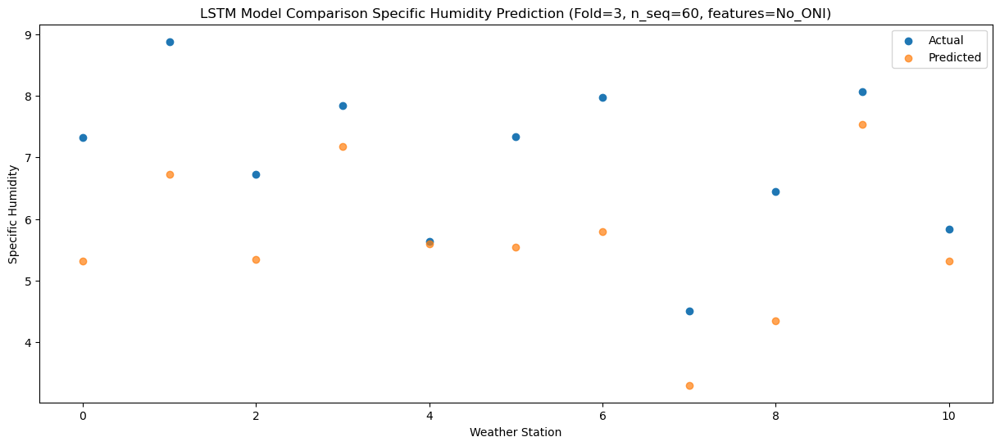

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    2.50   1.421544
1                 1    4.65   2.821544
2                 2    5.61   1.441544
3                 3    4.09   3.271544
4                 4    1.28   1.701544
5                 5    3.47   1.641544
6                 6    6.21   1.891544
7                 7    3.45  -0.598456
8                 8    4.85   0.441544
9                 9    4.96   3.641544
10               10    1.83   1.421544


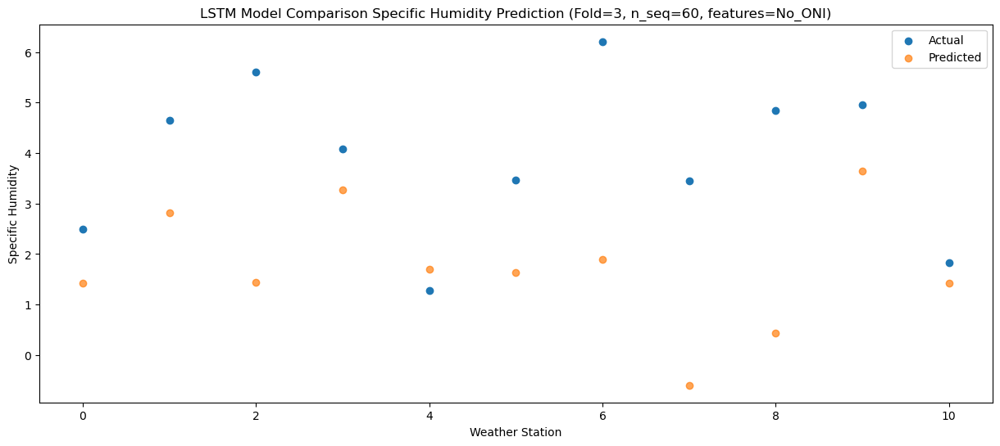

f, t:
[[-1.290e+00  2.240e+00  3.790e+00  1.020e+00  2.490e+00  4.400e-01
   4.780e+00  2.690e+00  3.330e+00  2.250e+00 -5.400e-01]
 [-1.080e+00  1.830e+00  4.330e+00  1.550e+00  9.900e-01  7.300e-01
   4.410e+00  3.680e+00  4.560e+00  1.890e+00 -6.600e-01]
 [-1.030e+00  1.800e+00  3.950e+00  1.150e+00 -1.300e+00  2.300e-01
   4.370e+00  2.560e+00  3.880e+00  1.610e+00 -7.400e-01]
 [-7.000e-01  1.440e+00  3.260e+00  9.700e-01 -2.060e+00 -2.000e-02
   4.330e+00  2.140e+00  2.990e+00  1.690e+00 -7.500e-01]
 [ 1.030e+00  4.040e+00  4.340e+00  2.830e+00  1.000e-02  1.970e+00
   4.960e+00  3.880e+00  3.470e+00  2.180e+00  2.100e-01]
 [ 8.500e-01  4.190e+00  5.710e+00  2.750e+00  3.300e-01  2.090e+00
   5.310e+00  3.690e+00  4.530e+00  2.680e+00  6.400e-01]
 [ 4.070e+00  7.160e+00  5.520e+00  6.180e+00  4.030e+00  5.300e+00
   6.440e+00  2.990e+00  5.390e+00  4.910e+00  3.170e+00]
 [ 7.610e+00  1.069e+01  7.060e+00  9.420e+00  7.120e+00  8.030e+00
   7.500e+00  3.320e+00  5.610e+00  9.020e+0

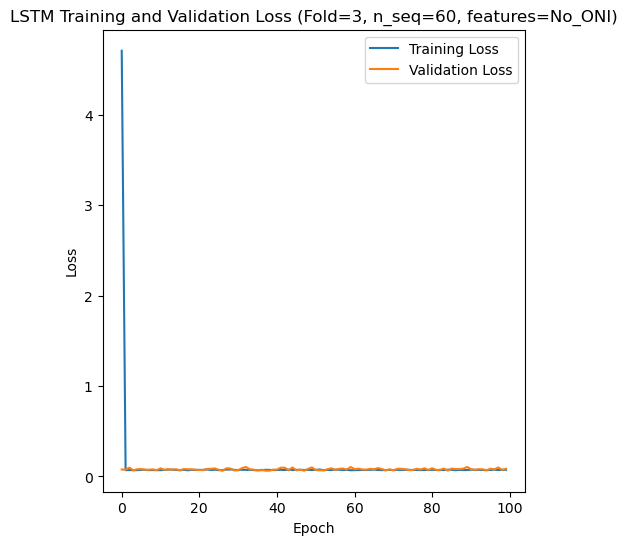

[[ 3.4   2.19  4.28 ... 10.54  6.41  5.39]
 [ 7.94  7.22  7.86 ... 18.27 13.85 11.85]
 [ 5.92  4.91  6.84 ... 14.38  9.59 10.48]
 ...
 [ 3.92  3.    4.93 ... 11.51  7.19  6.46]
 [ 3.98  2.61  4.   ... 10.23  6.65  5.8 ]
 [ 3.84  2.35  4.25 ... 10.6   6.5   5.9 ]]
Epoch 1/100
84/84 [==============================] - 37s 152ms/step - loss: 3.2323 - accuracy: 0.2857 - mae: 3.0066 - rmse: 3.2323 - mape: 652.6304 - pearson: 0.6092 - val_loss: 0.0722 - val_accuracy: 0.7000 - val_mae: 0.0562 - val_rmse: 0.0722 - val_mape: 12.2820 - val_pearson: 0.7151
Epoch 2/100
84/84 [==============================] - 7s 80ms/step - loss: 0.0742 - accuracy: 0.3810 - mae: 0.0584 - rmse: 0.0742 - mape: 13.2935 - pearson: 0.7294 - val_loss: 0.0662 - val_accuracy: 0.7000 - val_mae: 0.0513 - val_rmse: 0.0662 - val_mape: 11.7872 - val_pearson: 0.7572
Epoch 3/100
84/84 [==============================] - 6s 75ms/step - loss: 0.0814 - accuracy: 0.3452 - mae: 0.0634 - rmse: 0.0814 - mape: 14.5739 - pearson: 0.7000 - 

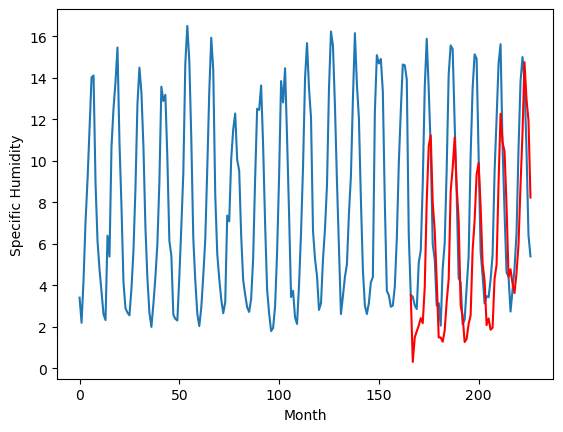

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.88		-0.14		1.74
-1.74		1.05		2.79
-3.30		1.34		4.64
-2.46		1.61		4.07
-1.08		1.97		3.05
0.13		1.73		1.60
0.78		3.46		2.68
4.11		7.64		3.53
5.85		10.27		4.42
6.09		10.78		4.69
5.51		7.53		2.02
3.47		6.20		2.73
0.41		3.79		3.38
-4.33		1.04		5.37
-3.98		1.04		5.02
-1.99		0.83		2.82
-2.02		1.38		3.40
-1.27		2.77		4.04
0.06		3.85		3.79
4.35		8.10		3.75
5.56		9.21		3.65
5.95		10.68		4.73
5.15		8.30		3.15
2.23		6.71		4.48
-2.43		2.59		5.02
-0.69		2.06		2.75
-4.55		0.82		5.37
-2.97		0.97		3.94
-1.44		1.69		3.13
-0.15		2.11		2.26
2.24		5.24		3.00
5.14		6.68		1.54
6.17		8.90		2.73
6.25		9.45		3.20
5.38		7.39		2.01
0.60		4.62		4.02
0.77		3.76		2.99
-2.75		1.64		4.39
-3.26		1.96		5.22
-1.32		1.41		2.73
-0.94		1.51		2.45
0.55		3.87		3.32
1.35		4.54		3.19
4.86		8.51		3.65
6.77		11.82		5.05
7.07		10.46		3.39
4.62		10.01		5.39
1.00		7.38		6.38
-1.30		3.96		5.26
-2.39		4.33		6.72
-3.43		3.64		7.07
-4.12		3

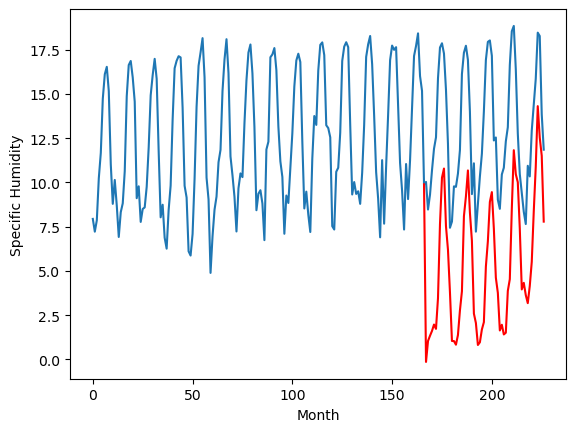

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.90		4.40		1.50
3.74		5.59		1.85
3.60		5.88		2.28
3.41		6.15		2.74
6.96		6.51		-0.45
5.84		6.27		0.43
8.08		8.00		-0.08
11.38		12.18		0.80
14.31		14.81		0.50
12.80		15.32		2.52
10.75		12.07		1.32
7.40		10.74		3.34
4.73		8.33		3.60
2.35		5.58		3.23
2.24		5.58		3.34
2.12		5.37		3.25
5.18		5.92		0.74
5.43		7.31		1.88
8.87		8.39		-0.48
13.11		12.64		-0.47
14.76		13.75		-1.01
14.77		15.22		0.45
11.83		12.84		1.01
9.05		11.25		2.20
3.61		7.13		3.52
6.56		6.60		0.04
1.83		5.36		3.53
2.68		5.51		2.83
3.73		6.23		2.50
6.18		6.65		0.47
10.78		9.78		-1.00
13.16		11.22		-1.94
15.00		13.44		-1.56
14.82		13.99		-0.83
10.58		11.93		1.35
5.62		9.16		3.54
4.87		8.30		3.43
4.33		6.18		1.85
4.23		6.50		2.27
4.90		5.95		1.05
5.23		6.05		0.82
6.07		8.41		2.34
9.45		9.08		-0.37
13.02		13.05		0.03
14.61		16.36		1.75
13.03		15.00		1.97
10.01		14.55		4.54
6.08		11.92		5.84
4.10		8.50		4.40
2.79		8.87		6.08
2.07		8.1

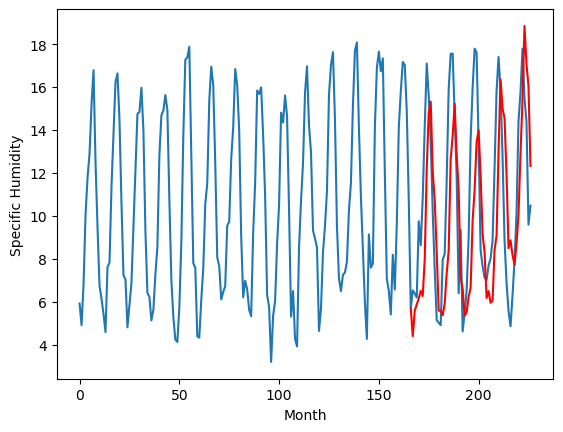

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
3.20		2.38		-0.82
2.20		3.57		1.37
2.84		3.86		1.02
2.22		4.13		1.91
6.17		4.49		-1.68
5.77		4.25		-1.52
8.93		5.98		-2.95
11.09		10.16		-0.93
14.32		12.79		-1.53
11.73		13.30		1.57
10.52		10.05		-0.47
5.95		8.72		2.77
4.31		6.31		2.00
1.71		3.56		1.85
1.60		3.56		1.96
1.28		3.35		2.07
3.94		3.90		-0.04
5.23		5.29		0.06
9.23		6.37		-2.86
12.92		10.62		-2.30
13.49		11.73		-1.76
13.88		13.20		-0.68
9.87		10.82		0.95
7.02		9.23		2.21
3.40		5.11		1.71
5.26		4.58		-0.68
0.60		3.34		2.74
1.13		3.49		2.36
2.72		4.21		1.49
6.23		4.63		-1.60
10.22		7.76		-2.46
11.99		9.20		-2.79
11.41		11.42		0.01
12.42		11.97		-0.45
9.14		9.91		0.77
4.68		7.14		2.46
4.50		6.28		1.78
2.92		4.16		1.24
2.23		4.48		2.25
2.59		3.93		1.34
4.65		4.03		-0.62
5.33		6.39		1.06
9.59		7.06		-2.53
13.53		11.03		-2.50
13.38		14.34		0.96
11.28		12.98		1.70
10.38		12.53		2.15
6.66		9.90		3.24
4.13		6.48		2.35
2.38		6.85		4.47
1.10		

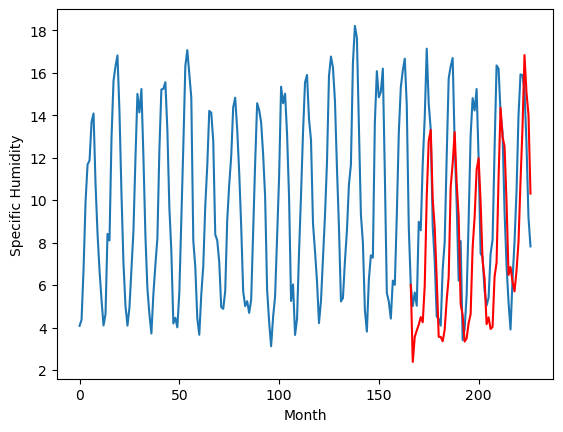

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.29		0.54		-0.75
0.32		1.73		1.41
1.01		2.02		1.01
0.35		2.29		1.94
4.25		2.65		-1.60
3.74		2.41		-1.33
6.98		4.14		-2.84
8.96		8.32		-0.64
12.11		10.95		-1.16
9.46		11.46		2.00
8.57		8.21		-0.36
3.80		6.88		3.08
2.44		4.47		2.03
-0.13		1.72		1.85
-0.17		1.72		1.89
-0.62		1.51		2.13
1.96		2.06		0.10
3.32		3.45		0.13
7.61		4.53		-3.08
11.49		8.78		-2.71
11.87		9.89		-1.98
11.98		11.36		-0.62
8.08		8.98		0.90
5.35		7.39		2.04
1.74		3.27		1.53
3.15		2.74		-0.41
-1.18		1.50		2.68
-0.74		1.65		2.39
0.78		2.37		1.59
4.46		2.79		-1.67
8.34		5.92		-2.42
10.02		7.36		-2.66
9.52		9.58		0.06
10.69		10.13		-0.56
7.54		8.07		0.53
3.08		5.30		2.22
2.66		4.44		1.78
1.07		2.32		1.25
0.32		2.64		2.32
0.72		2.09		1.37
2.69		2.19		-0.50
3.54		4.55		1.01
7.81		5.22		-2.59
11.29		9.19		-2.10
10.39		12.50		2.11
9.01		11.14		2.13
8.68		10.69		2.01
5.02		8.06		3.04
2.60		4.64		2.04
0.84		5.01		4.17
-0.58		4.32		4.9

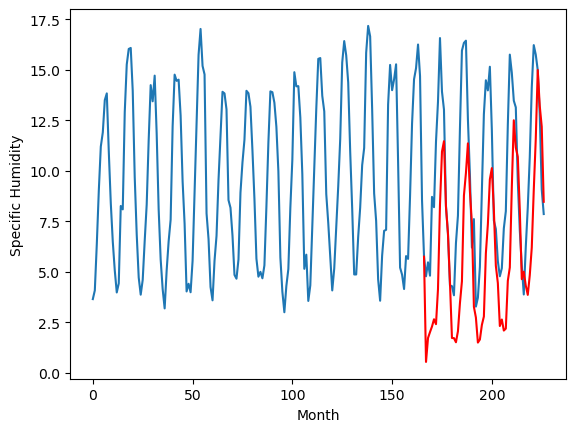

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.63		0.11		-2.52
1.39		1.30		-0.09
1.27		1.59		0.32
1.15		1.86		0.71
3.95		2.22		-1.73
3.20		1.98		-1.22
5.47		3.71		-1.76
7.18		7.89		0.71
8.41		10.52		2.11
7.10		11.03		3.93
6.91		7.78		0.87
3.26		6.45		3.19
2.80		4.04		1.24
0.24		1.29		1.05
0.94		1.29		0.35
0.30		1.08		0.78
1.79		1.63		-0.16
2.75		3.02		0.27
7.30		4.10		-3.20
9.60		8.35		-1.25
10.63		9.46		-1.17
10.35		10.93		0.58
7.10		8.55		1.45
4.05		6.96		2.91
2.33		2.84		0.51
1.48		2.31		0.83
0.02		1.07		1.05
0.01		1.22		1.21
0.60		1.94		1.34
2.63		2.36		-0.27
4.89		5.49		0.60
7.74		6.93		-0.81
8.43		9.15		0.72
10.42		9.70		-0.72
9.17		7.64		-1.53
5.66		4.87		-0.79
2.96		4.01		1.05
2.32		1.89		-0.43
0.77		2.21		1.44
0.89		1.66		0.77
2.18		1.76		-0.42
2.15		4.12		1.97
6.99		4.79		-2.20
10.85		8.76		-2.09
8.52		12.07		3.55
7.66		10.71		3.05
8.17		10.26		2.09
6.04		7.63		1.59
3.74		4.21		0.47
2.16		4.58		2.42
0.89		3.89		3.00
1.24		3.43

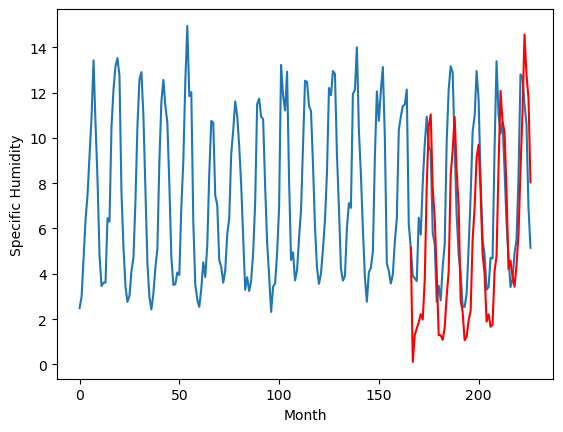

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-2.97		-1.05		1.92
-2.90		0.14		3.04
-3.06		0.43		3.49
-2.48		0.70		3.18
-0.29		1.06		1.35
-0.96		0.82		1.78
2.16		2.55		0.39
5.99		6.73		0.74
8.58		9.36		0.78
8.79		9.87		1.08
4.95		6.62		1.67
2.30		5.29		2.99
-0.53		2.88		3.41
-3.87		0.13		4.00
-3.99		0.13		4.12
-3.74		-0.08		3.66
-2.03		0.47		2.50
-1.62		1.86		3.48
1.36		2.94		1.58
6.05		7.19		1.14
7.65		8.30		0.65
8.03		9.77		1.74
4.45		7.39		2.94
2.24		5.80		3.56
-3.48		1.68		5.16
-1.62		1.15		2.77
-4.60		-0.09		4.51
-3.28		0.06		3.34
-2.44		0.78		3.22
-1.38		1.20		2.58
2.63		4.33		1.70
4.91		5.77		0.86
8.07		7.99		-0.08
6.88		8.54		1.66
3.33		6.48		3.15
-1.35		3.71		5.06
-1.53		2.85		4.38
-3.52		0.73		4.25
-2.89		1.05		3.94
-1.85		0.50		2.35
-2.36		0.60		2.96
-0.76		2.96		3.72
1.46		3.63		2.17
4.51		7.60		3.09
7.90		10.91		3.01
7.44		9.55		2.11
3.99		9.10		5.11
0.08		6.47		6.39
-2.87		3.05		5.92
-3.15		3.42		6.57
-3.93		2.73		6.66
-3.75

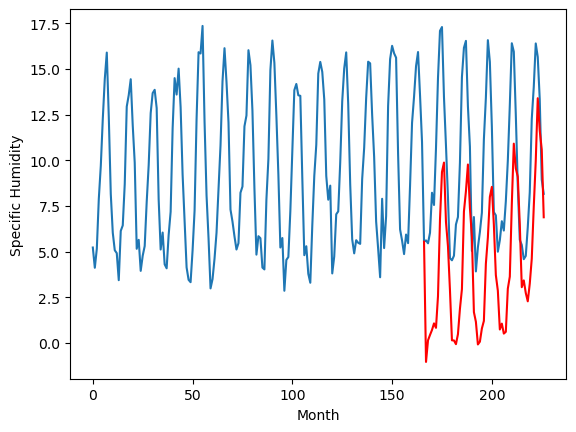

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.81		1.68		-0.13
1.54		2.87		1.33
1.30		3.16		1.86
1.07		3.43		2.36
3.62		3.79		0.17
3.94		3.55		-0.39
7.32		5.28		-2.04
10.93		9.46		-1.47
12.98		12.09		-0.89
10.33		12.60		2.27
8.73		9.35		0.62
4.18		8.02		3.84
2.51		5.61		3.10
0.58		2.86		2.28
0.43		2.86		2.43
-0.20		2.65		2.85
2.17		3.20		1.03
3.09		4.59		1.50
6.25		5.67		-0.58
10.85		9.92		-0.93
11.80		11.03		-0.77
11.54		12.50		0.96
8.28		10.12		1.84
6.19		8.53		2.34
1.50		4.41		2.91
2.97		3.88		0.91
-0.23		2.64		2.87
0.28		2.79		2.51
1.79		3.51		1.72
3.58		3.93		0.35
8.29		7.06		-1.23
10.65		8.50		-2.15
11.45		10.72		-0.73
11.92		11.27		-0.65
8.11		9.21		1.10
3.45		6.44		2.99
2.09		5.58		3.49
1.22		3.46		2.24
1.50		3.78		2.28
1.31		3.23		1.92
2.07		3.33		1.26
2.97		5.69		2.72
7.36		6.36		-1.00
9.92		10.33		0.41
12.71		13.64		0.93
12.99		12.28		-0.71
8.79		11.83		3.04
5.18		9.20		4.02
2.15		5.78		3.63
1.34		6.15		4.81
0.19		5.46		5.27


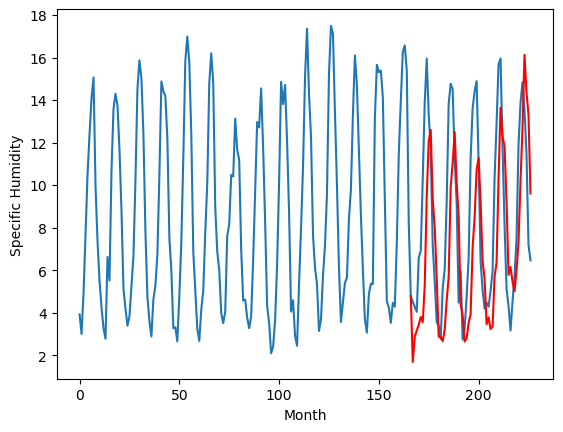

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.40		0.38		-0.02
0.57		1.57		1.00
0.20		1.86		1.66
-0.20		2.13		2.33
1.72		2.49		0.77
2.00		2.25		0.25
5.15		3.98		-1.17
7.89		8.16		0.27
11.11		10.79		-0.32
9.44		11.30		1.86
6.52		8.05		1.53
3.14		6.72		3.58
1.46		4.31		2.85
-0.14		1.56		1.70
-0.49		1.56		2.05
-1.06		1.35		2.41
0.88		1.90		1.02
2.21		3.29		1.08
4.50		4.37		-0.13
9.56		8.62		-0.94
10.82		9.73		-1.09
10.96		11.20		0.24
7.48		8.82		1.34
6.33		7.23		0.90
0.56		3.11		2.55
1.27		2.58		1.31
-1.11		1.34		2.45
-0.53		1.49		2.02
0.78		2.21		1.43
2.27		2.63		0.36
6.29		5.76		-0.53
7.73		7.20		-0.53
10.47		9.42		-1.05
10.11		9.97		-0.14
7.45		7.91		0.46
2.12		5.14		3.02
1.08		4.28		3.20
0.12		2.16		2.04
0.74		2.48		1.74
0.34		1.93		1.59
0.69		2.03		1.34
2.14		4.39		2.25
4.39		5.06		0.67
6.35		9.03		2.68
10.65		12.34		1.69
10.11		10.98		0.87
7.31		10.53		3.22
3.98		7.90		3.92
0.91		4.48		3.57
0.88		4.85		3.97
-0.20		4.16		4.36
0.38		3.

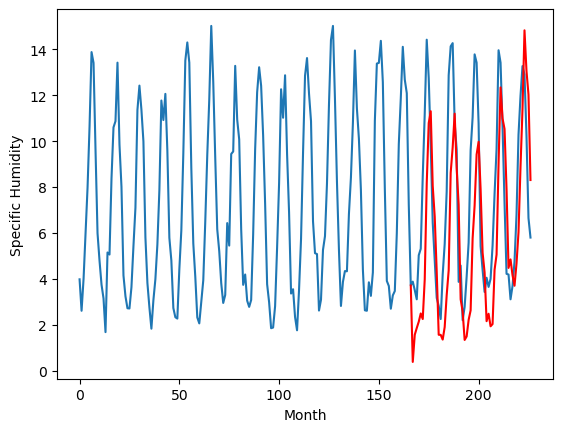

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.95		0.44		-0.51
1.12		1.63		0.51
0.64		1.92		1.28
0.37		2.19		1.82
2.42		2.55		0.13
3.01		2.31		-0.70
6.73		4.04		-2.69
9.21		8.22		-0.99
12.77		10.85		-1.92
10.58		11.36		0.78
7.80		8.11		0.31
3.64		6.78		3.14
2.55		4.37		1.82
0.64		1.62		0.98
0.32		1.62		1.30
-0.32		1.41		1.73
2.05		1.96		-0.09
3.36		3.35		-0.01
5.98		4.43		-1.55
10.73		8.68		-2.05
12.13		9.79		-2.34
12.38		11.26		-1.12
8.35		8.88		0.53
6.48		7.29		0.81
1.19		3.17		1.98
1.73		2.64		0.91
-0.51		1.40		1.91
0.19		1.55		1.36
1.71		2.27		0.56
3.01		2.69		-0.32
7.08		5.82		-1.26
9.32		7.26		-2.06
11.96		9.48		-2.48
11.19		10.03		-1.16
7.82		7.97		0.15
3.06		5.20		2.14
1.69		4.34		2.65
0.58		2.22		1.64
1.10		2.54		1.44
0.87		1.99		1.12
1.48		2.09		0.61
2.99		4.45		1.46
5.77		5.12		-0.65
7.41		9.09		1.68
12.11		12.40		0.29
11.98		11.04		-0.94
8.20		10.59		2.39
4.76		7.96		3.20
1.37		4.54		3.17
1.86		4.91		3.05
0.40		4.22		3.82
1

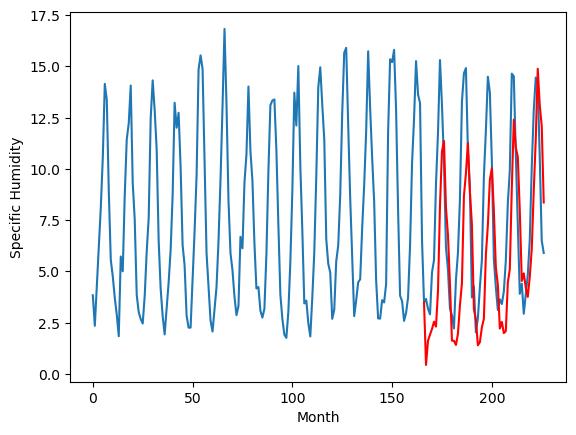

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.15		0.30		0.15
0.30		1.49		1.19
-0.04		1.78		1.82
-0.39		2.05		2.44
1.18		2.41		1.23
1.02		2.17		1.15
3.64		3.90		0.26
6.83		8.08		1.25
9.75		10.71		0.96
8.33		11.22		2.89
6.19		7.97		1.78
3.15		6.64		3.49
1.22		4.23		3.01
-0.11		1.48		1.59
-0.49		1.48		1.97
-1.06		1.27		2.33
0.23		1.82		1.59
1.90		3.21		1.31
3.50		4.29		0.79
8.51		8.54		0.03
9.78		9.65		-0.13
10.65		11.12		0.47
6.89		8.74		1.85
5.88		7.15		1.27
0.64		3.03		2.39
0.60		2.50		1.90
-1.14		1.26		2.40
-0.69		1.41		2.10
0.46		2.13		1.67
1.45		2.55		1.10
4.91		5.68		0.77
6.82		7.12		0.30
8.55		9.34		0.79
9.01		9.89		0.88
7.02		7.83		0.81
2.20		5.06		2.86
1.48		4.20		2.72
0.03		2.08		2.05
0.65		2.40		1.75
-0.10		1.85		1.95
0.11		1.95		1.84
1.81		4.31		2.50
2.71		4.98		2.27
5.95		8.95		3.00
9.57		12.26		2.69
8.77		10.90		2.13
7.06		10.45		3.39
4.00		7.82		3.82
0.56		4.40		3.84
1.08		4.77		3.69
0.01		4.08		4.07
0.03		3.62		3.59
1.10

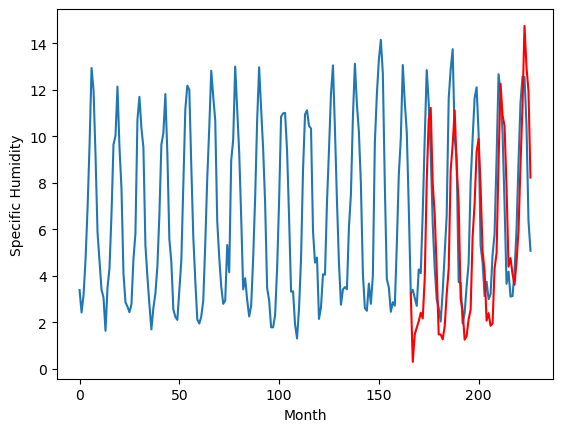

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    0.95   0.301831
1                 1   -1.88  -0.138169
2                 2    2.90   4.401831
3                 3    3.20   2.381831
4                 4    1.29   0.541831
5                 5    2.63   0.111831
6                 6   -2.97  -1.048169
7                 7    1.81   1.681831
8                 8    0.40   0.381831
9                 9    0.95   0.441831
10               10    0.15   0.301831


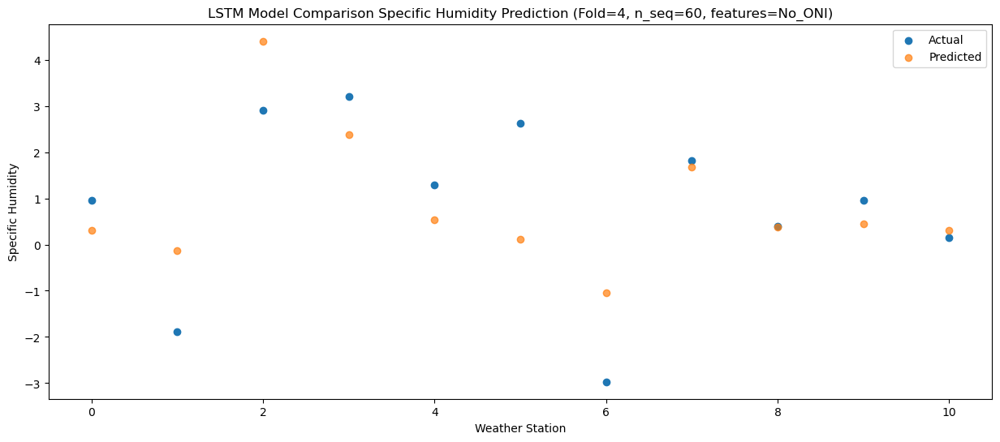

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    0.88   1.485736
1                 1   -1.74   1.045736
2                 2    3.74   5.585736
3                 3    2.20   3.565736
4                 4    0.32   1.725736
5                 5    1.39   1.295736
6                 6   -2.90   0.135736
7                 7    1.54   2.865736
8                 8    0.57   1.565736
9                 9    1.12   1.625736
10               10    0.30   1.485736


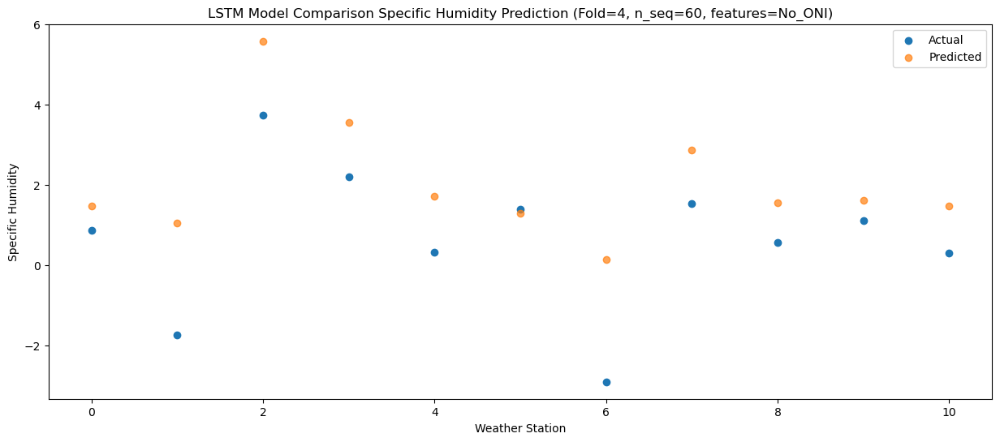

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0    0.46   1.779229
1                 1   -3.30   1.339229
2                 2    3.60   5.879229
3                 3    2.84   3.859229
4                 4    1.01   2.019229
5                 5    1.27   1.589229
6                 6   -3.06   0.429229
7                 7    1.30   3.159229
8                 8    0.20   1.859229
9                 9    0.64   1.919229
10               10   -0.04   1.779229


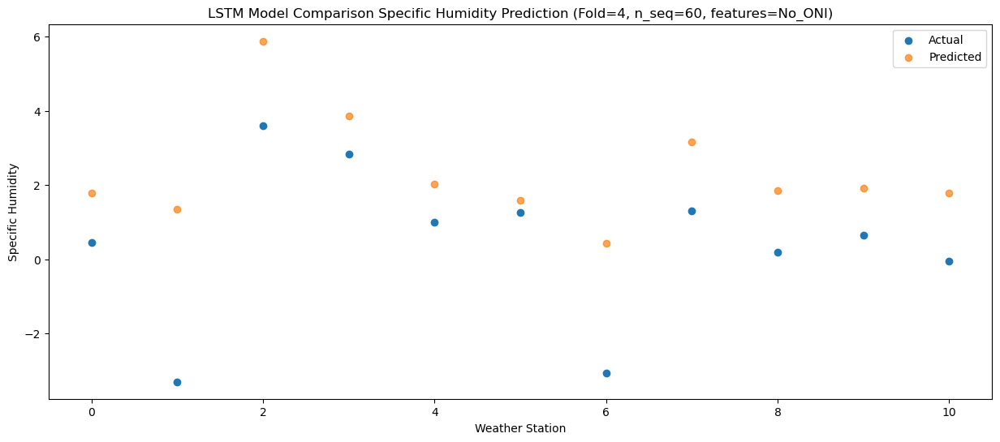

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0    0.28   2.053703
1                 1   -2.46   1.613703
2                 2    3.41   6.153703
3                 3    2.22   4.133703
4                 4    0.35   2.293703
5                 5    1.15   1.863703
6                 6   -2.48   0.703703
7                 7    1.07   3.433703
8                 8   -0.20   2.133703
9                 9    0.37   2.193703
10               10   -0.39   2.053703


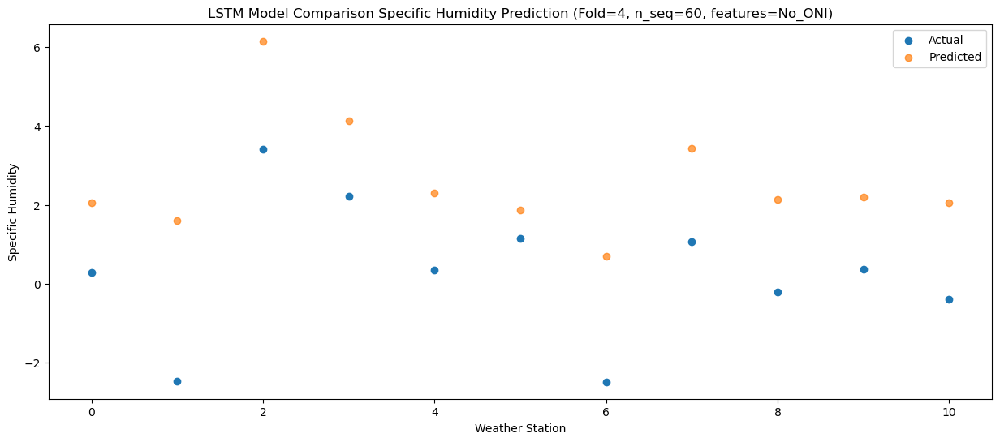

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    2.51   2.413241
1                 1   -1.08   1.973241
2                 2    6.96   6.513241
3                 3    6.17   4.493241
4                 4    4.25   2.653241
5                 5    3.95   2.223241
6                 6   -0.29   1.063241
7                 7    3.62   3.793241
8                 8    1.72   2.493241
9                 9    2.42   2.553241
10               10    1.18   2.413241


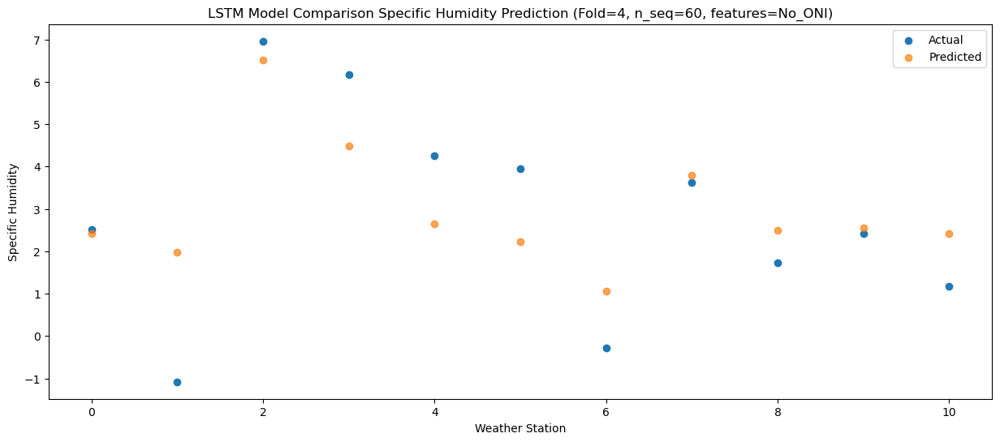

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    3.10   2.169626
1                 1    0.13   1.729626
2                 2    5.84   6.269626
3                 3    5.77   4.249626
4                 4    3.74   2.409626
5                 5    3.20   1.979626
6                 6   -0.96   0.819626
7                 7    3.94   3.549626
8                 8    2.00   2.249626
9                 9    3.01   2.309626
10               10    1.02   2.169626


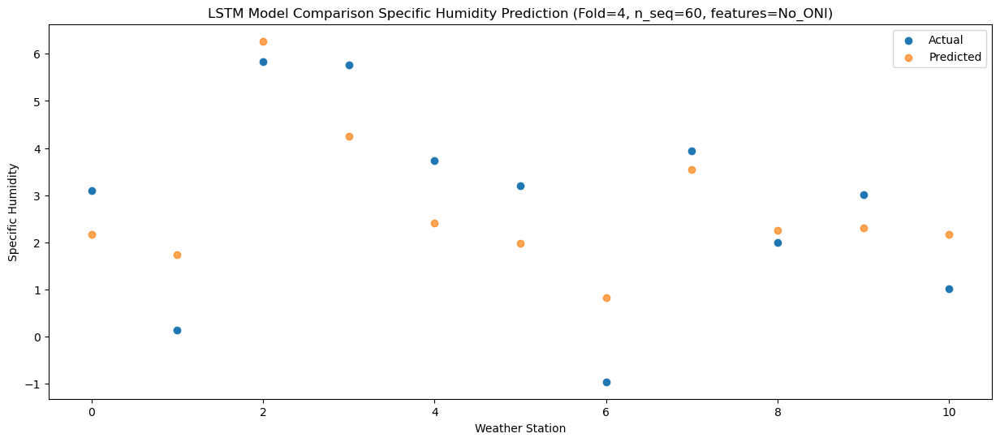

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    6.31   3.902658
1                 1    0.78   3.462658
2                 2    8.08   8.002658
3                 3    8.93   5.982658
4                 4    6.98   4.142658
5                 5    5.47   3.712658
6                 6    2.16   2.552658
7                 7    7.32   5.282658
8                 8    5.15   3.982658
9                 9    6.73   4.042658
10               10    3.64   3.902658


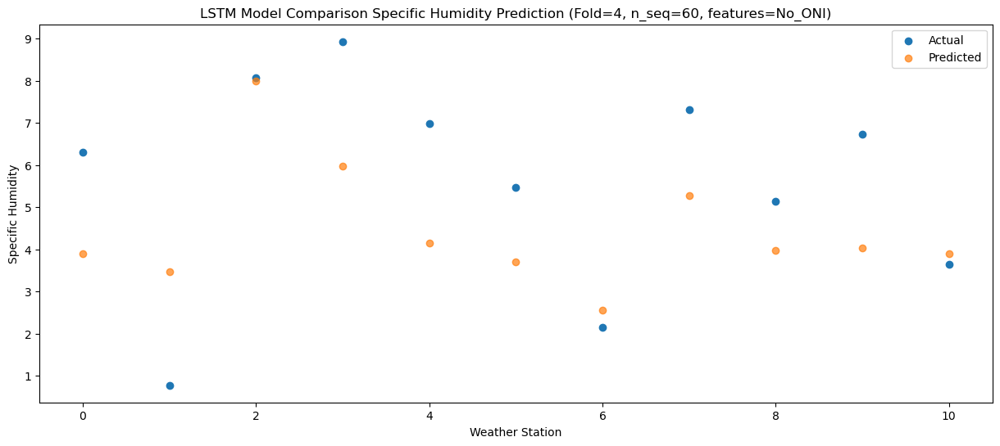

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   10.96   8.083473
1                 1    4.11   7.643473
2                 2   11.38  12.183473
3                 3   11.09  10.163473
4                 4    8.96   8.323473
5                 5    7.18   7.893473
6                 6    5.99   6.733473
7                 7   10.93   9.463473
8                 8    7.89   8.163473
9                 9    9.21   8.223473
10               10    6.83   8.083473


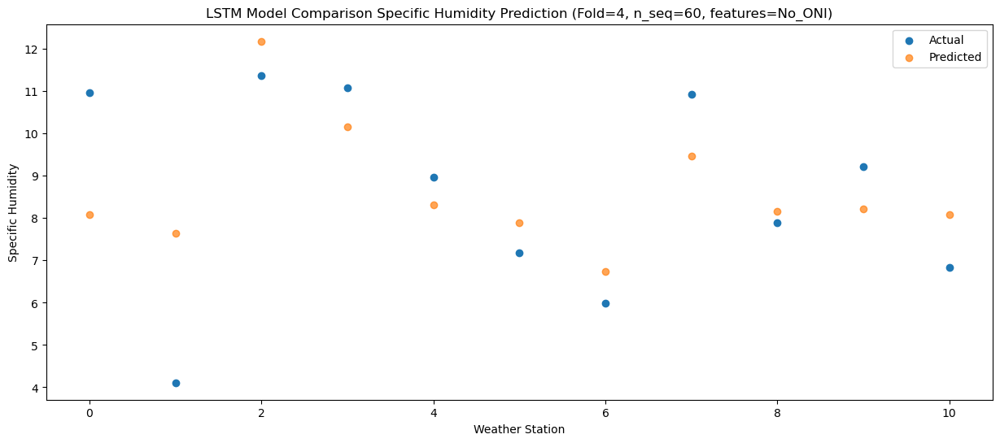

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   13.31  10.709512
1                 1    5.85  10.269512
2                 2   14.31  14.809512
3                 3   14.32  12.789512
4                 4   12.11  10.949512
5                 5    8.41  10.519512
6                 6    8.58   9.359512
7                 7   12.98  12.089512
8                 8   11.11  10.789512
9                 9   12.77  10.849512
10               10    9.75  10.709512


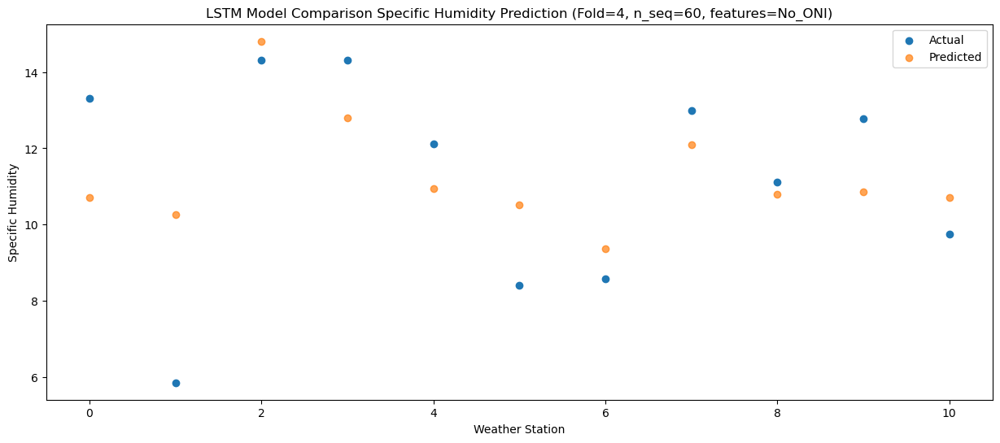

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   10.88  11.223537
1                 1    6.09  10.783537
2                 2   12.80  15.323537
3                 3   11.73  13.303537
4                 4    9.46  11.463537
5                 5    7.10  11.033537
6                 6    8.79   9.873537
7                 7   10.33  12.603537
8                 8    9.44  11.303537
9                 9   10.58  11.363537
10               10    8.33  11.223537


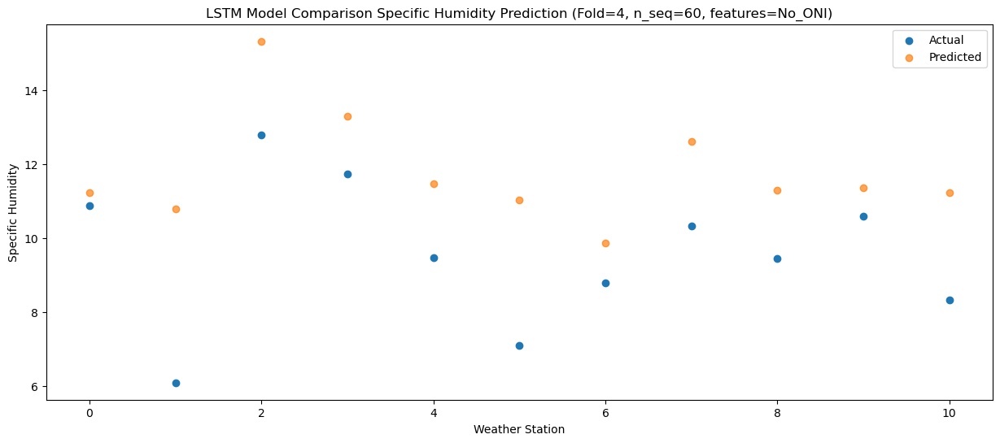

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    7.99   7.971667
1                 1    5.51   7.531667
2                 2   10.75  12.071667
3                 3   10.52  10.051667
4                 4    8.57   8.211667
5                 5    6.91   7.781667
6                 6    4.95   6.621667
7                 7    8.73   9.351667
8                 8    6.52   8.051667
9                 9    7.80   8.111667
10               10    6.19   7.971667


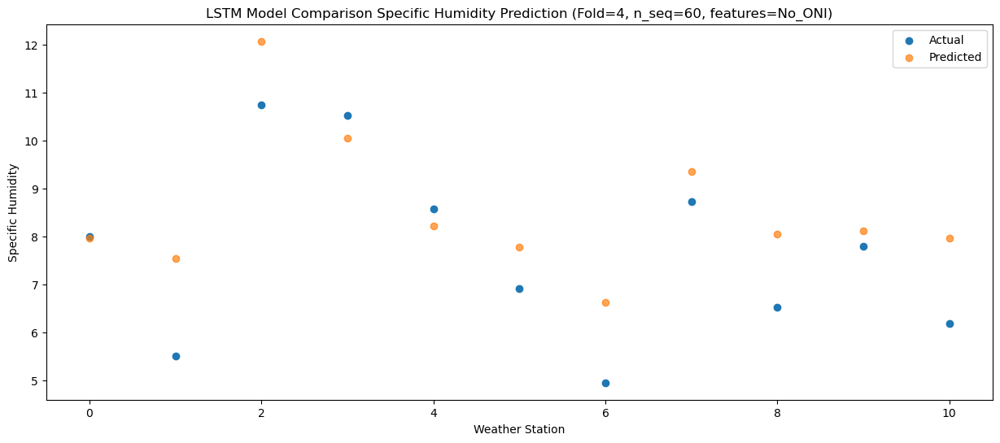

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    3.40   6.638058
1                 1    3.47   6.198058
2                 2    7.40  10.738058
3                 3    5.95   8.718058
4                 4    3.80   6.878058
5                 5    3.26   6.448058
6                 6    2.30   5.288058
7                 7    4.18   8.018058
8                 8    3.14   6.718058
9                 9    3.64   6.778058
10               10    3.15   6.638058


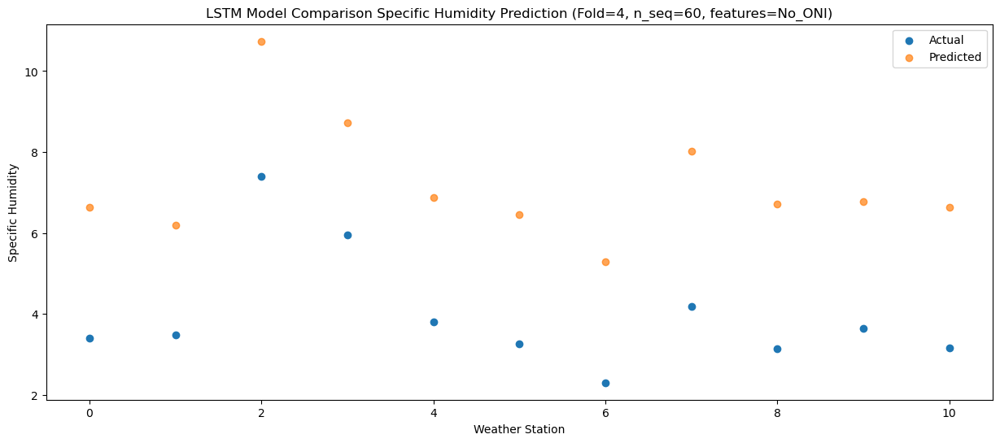

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    2.68   4.232385
1                 1    0.41   3.792385
2                 2    4.73   8.332385
3                 3    4.31   6.312385
4                 4    2.44   4.472385
5                 5    2.80   4.042385
6                 6   -0.53   2.882385
7                 7    2.51   5.612385
8                 8    1.46   4.312385
9                 9    2.55   4.372385
10               10    1.22   4.232385


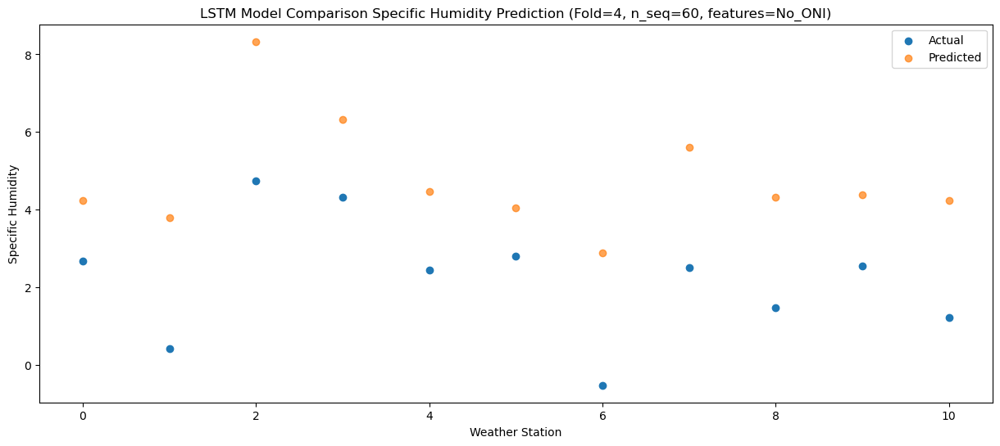

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0    0.45   1.484503
1                 1   -4.33   1.044503
2                 2    2.35   5.584503
3                 3    1.71   3.564503
4                 4   -0.13   1.724503
5                 5    0.24   1.294503
6                 6   -3.87   0.134503
7                 7    0.58   2.864503
8                 8   -0.14   1.564503
9                 9    0.64   1.624503
10               10   -0.11   1.484503


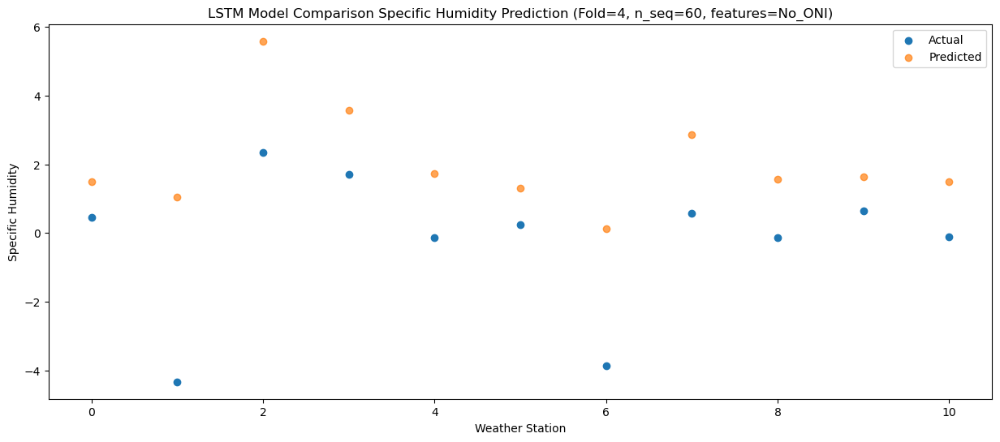

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0    0.57       1.48
1                 1   -3.98       1.04
2                 2    2.24       5.58
3                 3    1.60       3.56
4                 4   -0.17       1.72
5                 5    0.94       1.29
6                 6   -3.99       0.13
7                 7    0.43       2.86
8                 8   -0.49       1.56
9                 9    0.32       1.62
10               10   -0.49       1.48


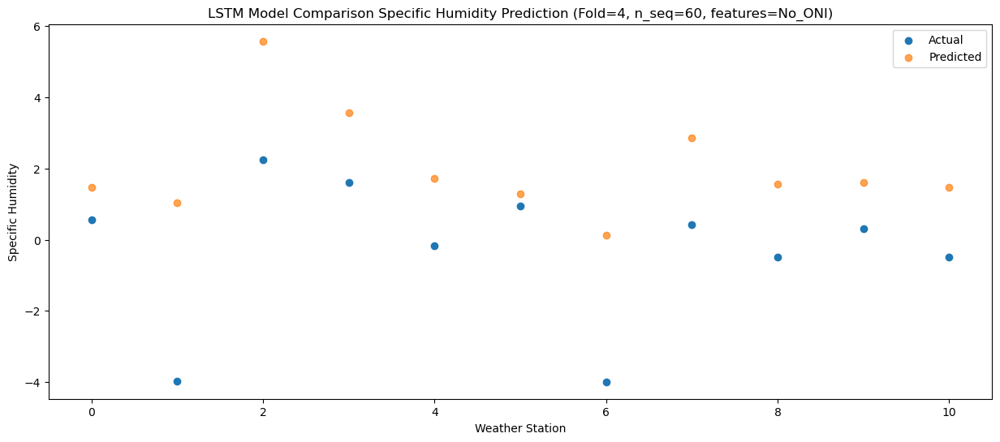

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -0.52   1.274594
1                 1   -1.99   0.834594
2                 2    2.12   5.374594
3                 3    1.28   3.354594
4                 4   -0.62   1.514594
5                 5    0.30   1.084594
6                 6   -3.74  -0.075406
7                 7   -0.20   2.654594
8                 8   -1.06   1.354594
9                 9   -0.32   1.414594
10               10   -1.06   1.274594


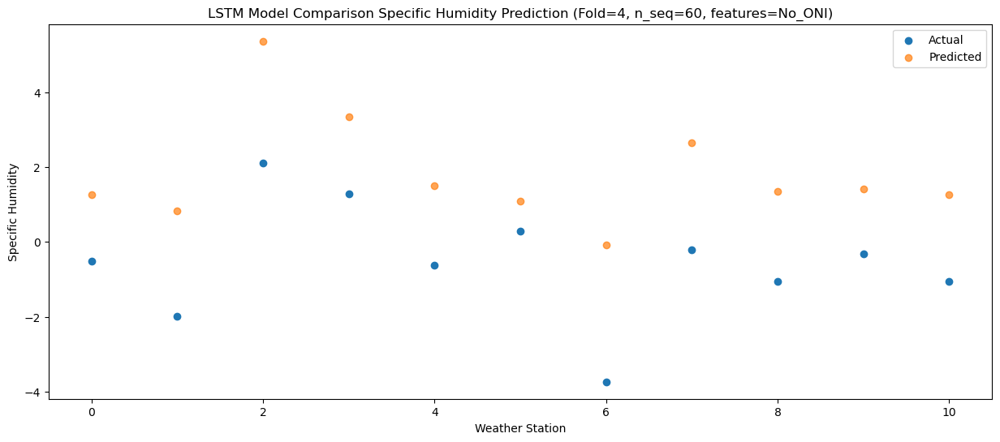

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    2.24   1.821152
1                 1   -2.02   1.381152
2                 2    5.18   5.921152
3                 3    3.94   3.901152
4                 4    1.96   2.061152
5                 5    1.79   1.631152
6                 6   -2.03   0.471152
7                 7    2.17   3.201152
8                 8    0.88   1.901152
9                 9    2.05   1.961152
10               10    0.23   1.821152


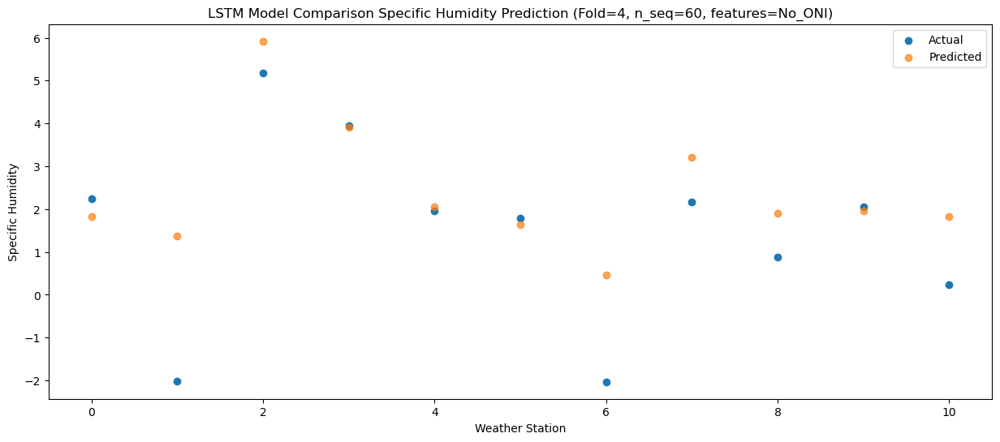

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    3.45   3.209773
1                 1   -1.27   2.769773
2                 2    5.43   7.309773
3                 3    5.23   5.289773
4                 4    3.32   3.449773
5                 5    2.75   3.019773
6                 6   -1.62   1.859773
7                 7    3.09   4.589773
8                 8    2.21   3.289773
9                 9    3.36   3.349773
10               10    1.90   3.209773


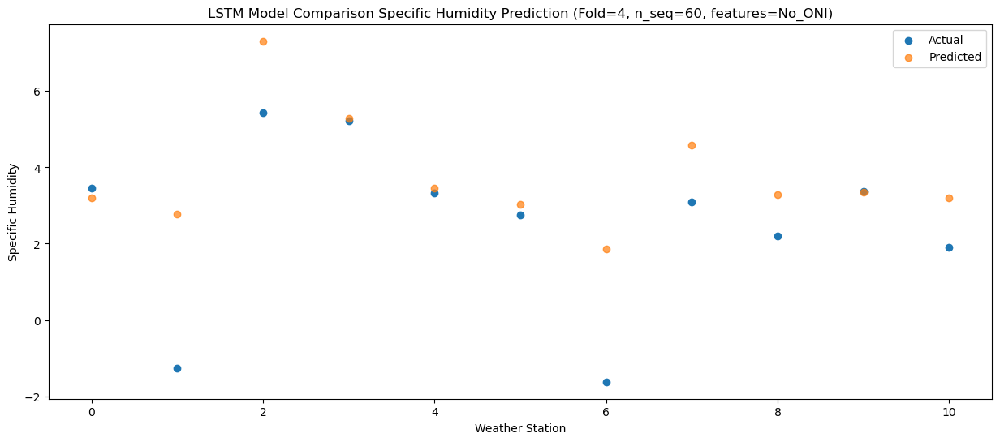

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    7.01   4.292707
1                 1    0.06   3.852707
2                 2    8.87   8.392707
3                 3    9.23   6.372707
4                 4    7.61   4.532707
5                 5    7.30   4.102707
6                 6    1.36   2.942707
7                 7    6.25   5.672707
8                 8    4.50   4.372707
9                 9    5.98   4.432707
10               10    3.50   4.292707


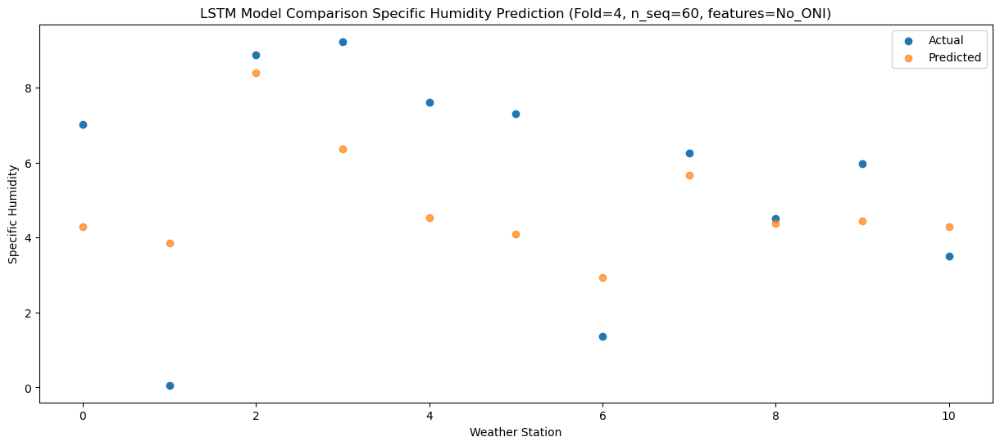

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   11.60   8.535112
1                 1    4.35   8.095112
2                 2   13.11  12.635112
3                 3   12.92  10.615112
4                 4   11.49   8.775112
5                 5    9.60   8.345112
6                 6    6.05   7.185112
7                 7   10.85   9.915112
8                 8    9.56   8.615112
9                 9   10.73   8.675112
10               10    8.51   8.535112


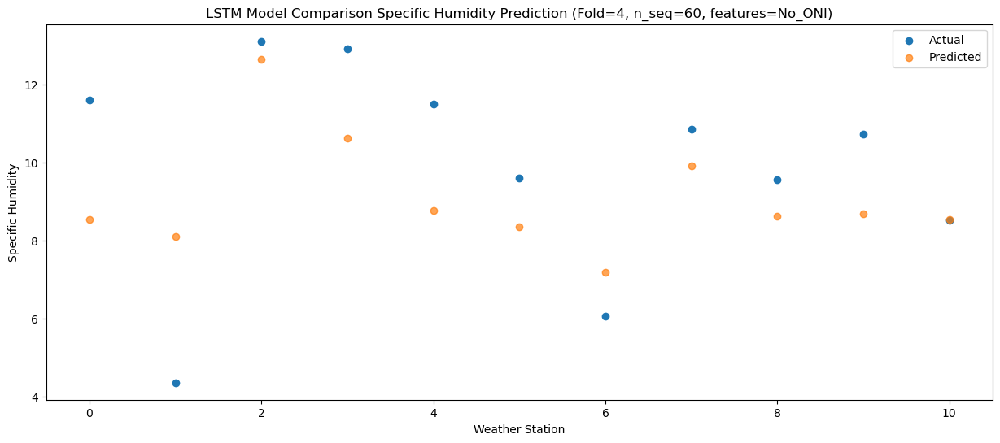

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   12.99    9.64676
1                 1    5.56    9.20676
2                 2   14.76   13.74676
3                 3   13.49   11.72676
4                 4   11.87    9.88676
5                 5   10.63    9.45676
6                 6    7.65    8.29676
7                 7   11.80   11.02676
8                 8   10.82    9.72676
9                 9   12.13    9.78676
10               10    9.78    9.64676


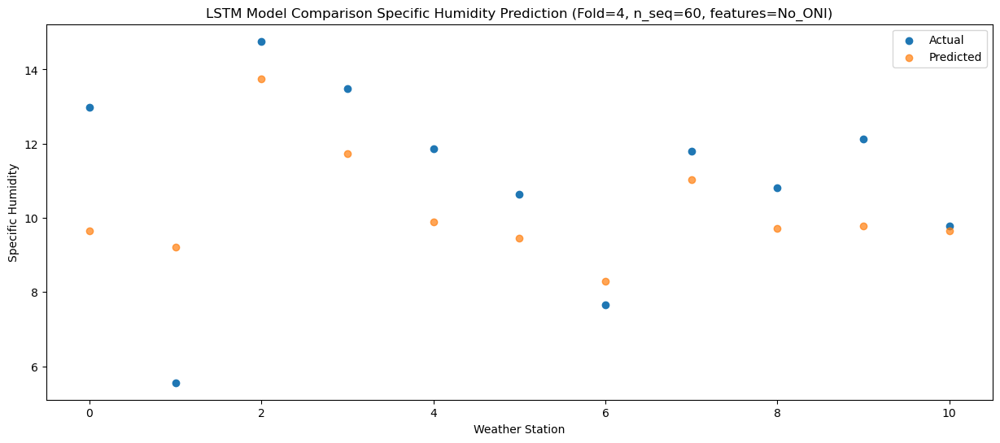

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   12.81  11.117811
1                 1    5.95  10.677811
2                 2   14.77  15.217811
3                 3   13.88  13.197811
4                 4   11.98  11.357811
5                 5   10.35  10.927811
6                 6    8.03   9.767811
7                 7   11.54  12.497811
8                 8   10.96  11.197811
9                 9   12.38  11.257811
10               10   10.65  11.117811


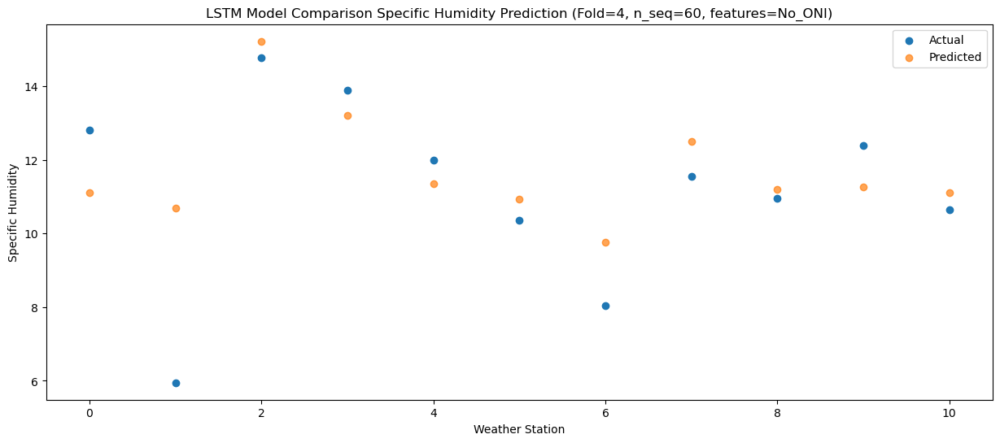

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    9.23   8.740815
1                 1    5.15   8.300815
2                 2   11.83  12.840815
3                 3    9.87  10.820815
4                 4    8.08   8.980815
5                 5    7.10   8.550815
6                 6    4.45   7.390815
7                 7    8.28  10.120815
8                 8    7.48   8.820815
9                 9    8.35   8.880815
10               10    6.89   8.740815


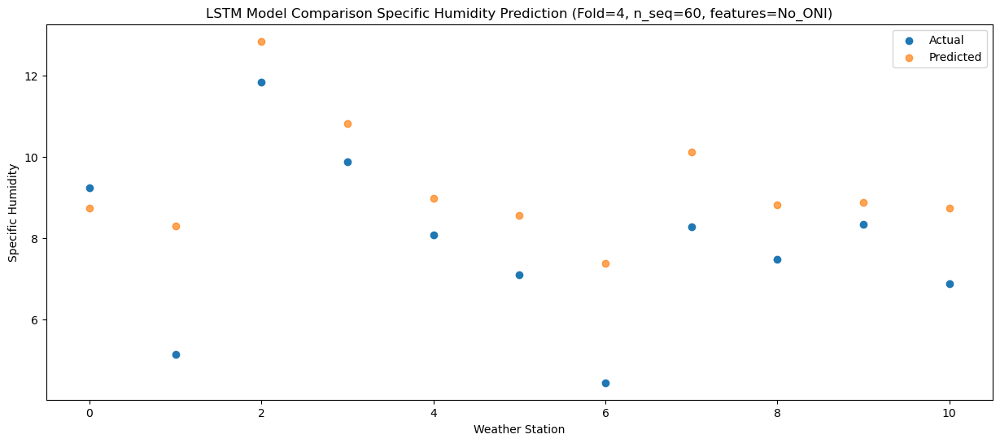

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    5.86   7.149024
1                 1    2.23   6.709024
2                 2    9.05  11.249024
3                 3    7.02   9.229024
4                 4    5.35   7.389024
5                 5    4.05   6.959024
6                 6    2.24   5.799024
7                 7    6.19   8.529024
8                 8    6.33   7.229024
9                 9    6.48   7.289024
10               10    5.88   7.149024


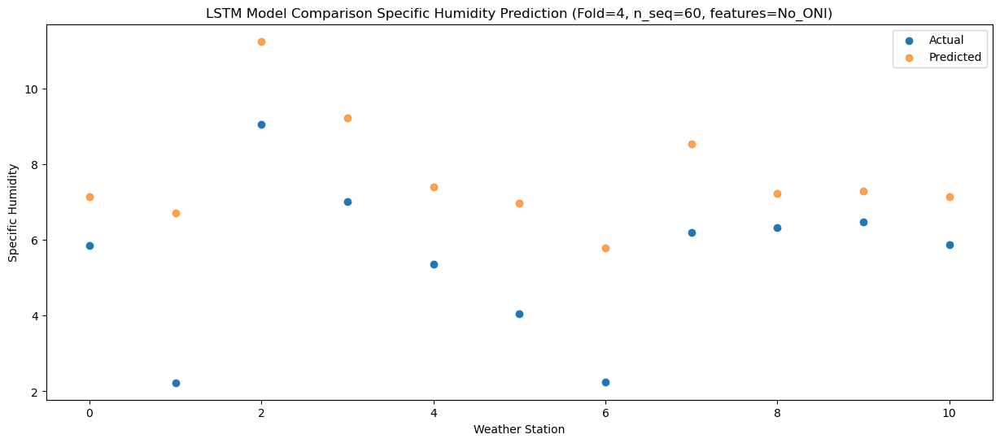

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    1.77    3.02961
1                 1   -2.43    2.58961
2                 2    3.61    7.12961
3                 3    3.40    5.10961
4                 4    1.74    3.26961
5                 5    2.33    2.83961
6                 6   -3.48    1.67961
7                 7    1.50    4.40961
8                 8    0.56    3.10961
9                 9    1.19    3.16961
10               10    0.64    3.02961


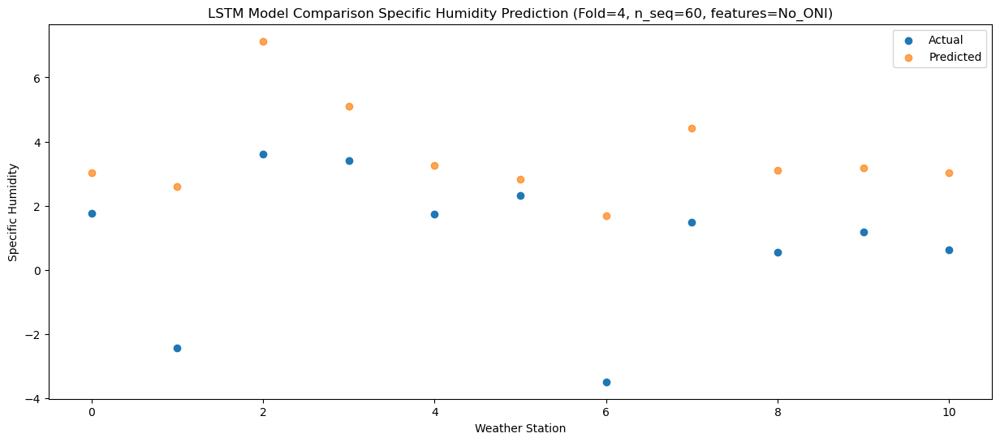

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    1.56   2.499159
1                 1   -0.69   2.059159
2                 2    6.56   6.599159
3                 3    5.26   4.579159
4                 4    3.15   2.739159
5                 5    1.48   2.309159
6                 6   -1.62   1.149159
7                 7    2.97   3.879159
8                 8    1.27   2.579159
9                 9    1.73   2.639159
10               10    0.60   2.499159


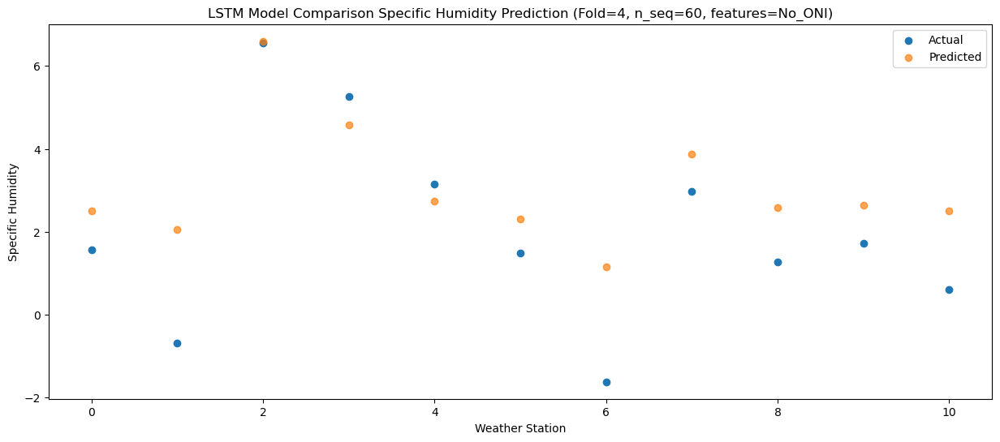

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -0.45   1.258946
1                 1   -4.55   0.818946
2                 2    1.83   5.358946
3                 3    0.60   3.338946
4                 4   -1.18   1.498946
5                 5    0.02   1.068946
6                 6   -4.60  -0.091054
7                 7   -0.23   2.638946
8                 8   -1.11   1.338946
9                 9   -0.51   1.398946
10               10   -1.14   1.258946


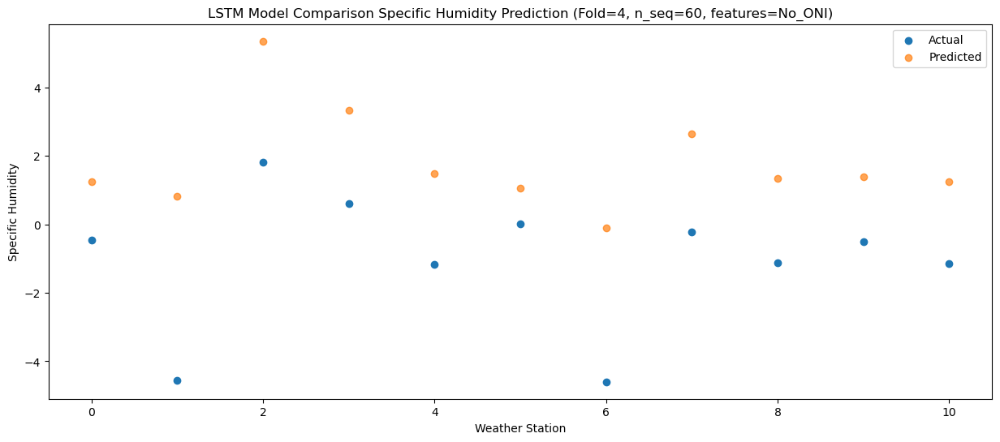

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -0.23   1.411275
1                 1   -2.97   0.971275
2                 2    2.68   5.511275
3                 3    1.13   3.491275
4                 4   -0.74   1.651275
5                 5    0.01   1.221275
6                 6   -3.28   0.061275
7                 7    0.28   2.791275
8                 8   -0.53   1.491275
9                 9    0.19   1.551275
10               10   -0.69   1.411275


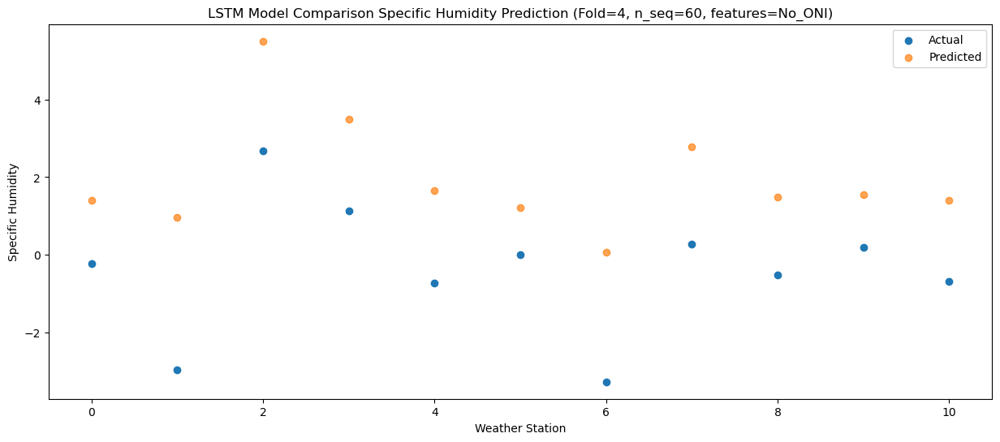

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    1.33    2.13392
1                 1   -1.44    1.69392
2                 2    3.73    6.23392
3                 3    2.72    4.21392
4                 4    0.78    2.37392
5                 5    0.60    1.94392
6                 6   -2.44    0.78392
7                 7    1.79    3.51392
8                 8    0.78    2.21392
9                 9    1.71    2.27392
10               10    0.46    2.13392


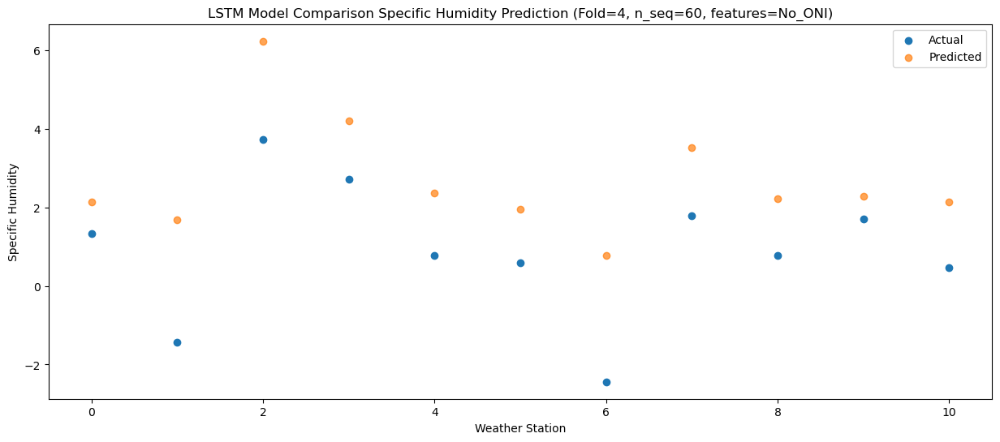

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    2.82   2.547944
1                 1   -0.15   2.107944
2                 2    6.18   6.647944
3                 3    6.23   4.627944
4                 4    4.46   2.787944
5                 5    2.63   2.357944
6                 6   -1.38   1.197944
7                 7    3.58   3.927944
8                 8    2.27   2.627944
9                 9    3.01   2.687944
10               10    1.45   2.547944


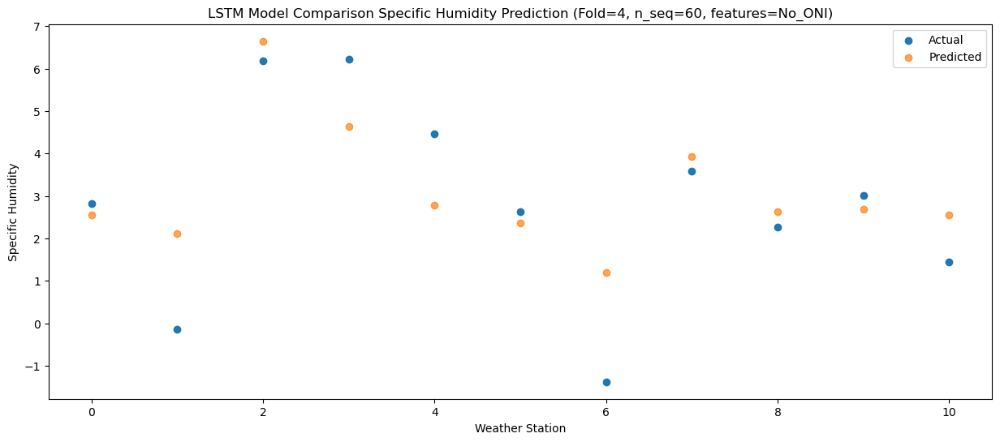

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    7.70    5.68377
1                 1    2.24    5.24377
2                 2   10.78    9.78377
3                 3   10.22    7.76377
4                 4    8.34    5.92377
5                 5    4.89    5.49377
6                 6    2.63    4.33377
7                 7    8.29    7.06377
8                 8    6.29    5.76377
9                 9    7.08    5.82377
10               10    4.91    5.68377


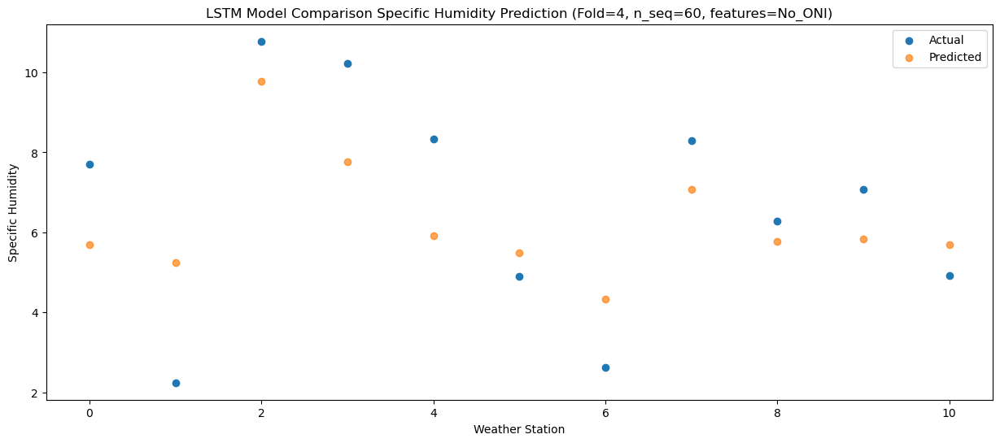

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   10.93    7.11659
1                 1    5.14    6.67659
2                 2   13.16   11.21659
3                 3   11.99    9.19659
4                 4   10.02    7.35659
5                 5    7.74    6.92659
6                 6    4.91    5.76659
7                 7   10.65    8.49659
8                 8    7.73    7.19659
9                 9    9.32    7.25659
10               10    6.82    7.11659


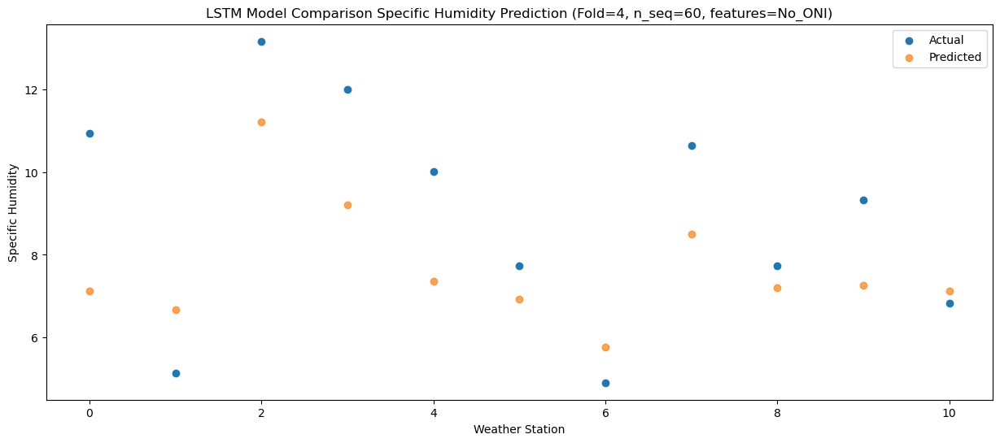

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   12.56   9.338925
1                 1    6.17   8.898925
2                 2   15.00  13.438925
3                 3   11.41  11.418925
4                 4    9.52   9.578925
5                 5    8.43   9.148925
6                 6    8.07   7.988925
7                 7   11.45  10.718925
8                 8   10.47   9.418925
9                 9   11.96   9.478925
10               10    8.55   9.338925


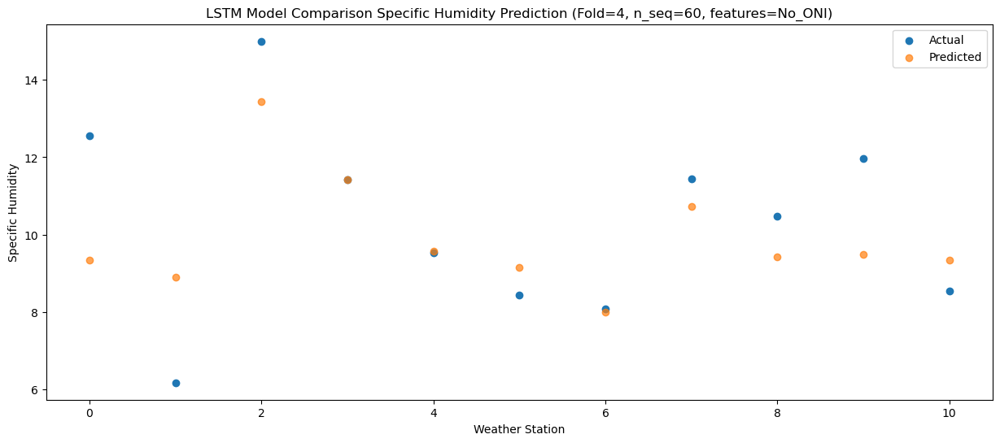

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   12.35   9.892326
1                 1    6.25   9.452326
2                 2   14.82  13.992326
3                 3   12.42  11.972326
4                 4   10.69  10.132326
5                 5   10.42   9.702326
6                 6    6.88   8.542326
7                 7   11.92  11.272326
8                 8   10.11   9.972326
9                 9   11.19  10.032326
10               10    9.01   9.892326


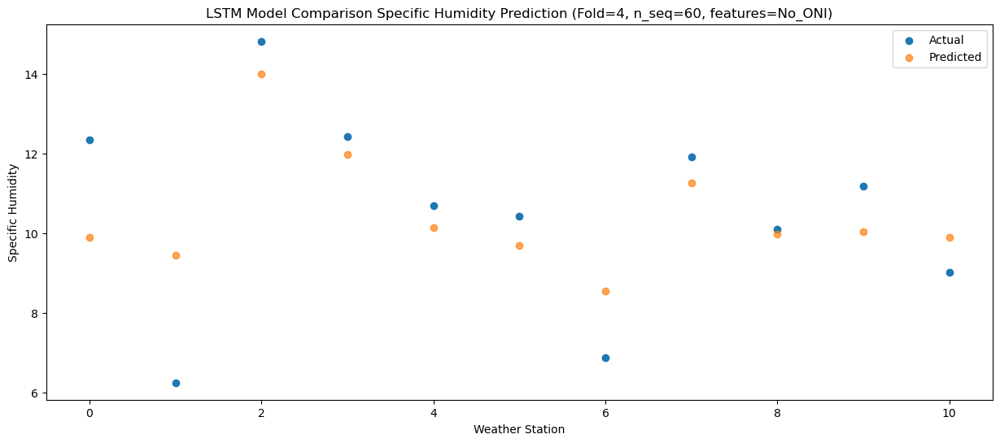

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    7.65   7.830328
1                 1    5.38   7.390328
2                 2   10.58  11.930328
3                 3    9.14   9.910328
4                 4    7.54   8.070328
5                 5    9.17   7.640328
6                 6    3.33   6.480328
7                 7    8.11   9.210328
8                 8    7.45   7.910328
9                 9    7.82   7.970328
10               10    7.02   7.830328


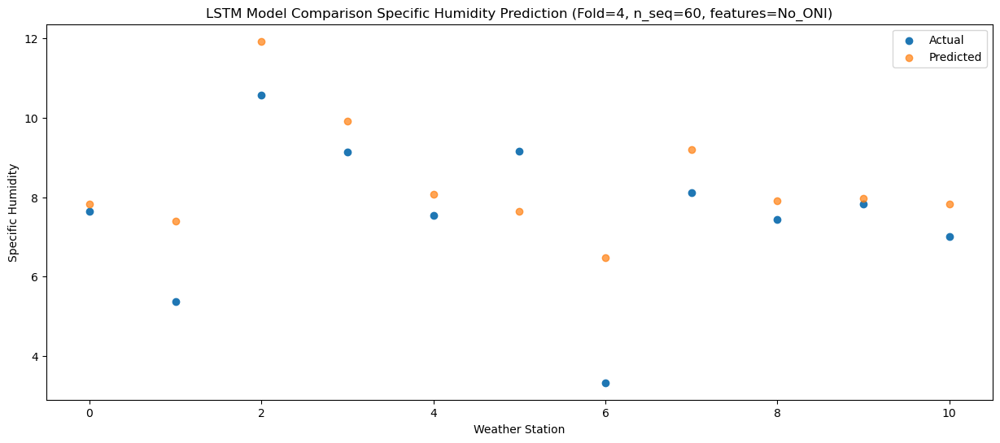

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    3.06   5.058896
1                 1    0.60   4.618896
2                 2    5.62   9.158896
3                 3    4.68   7.138896
4                 4    3.08   5.298896
5                 5    5.66   4.868896
6                 6   -1.35   3.708896
7                 7    3.45   6.438896
8                 8    2.12   5.138896
9                 9    3.06   5.198896
10               10    2.20   5.058896


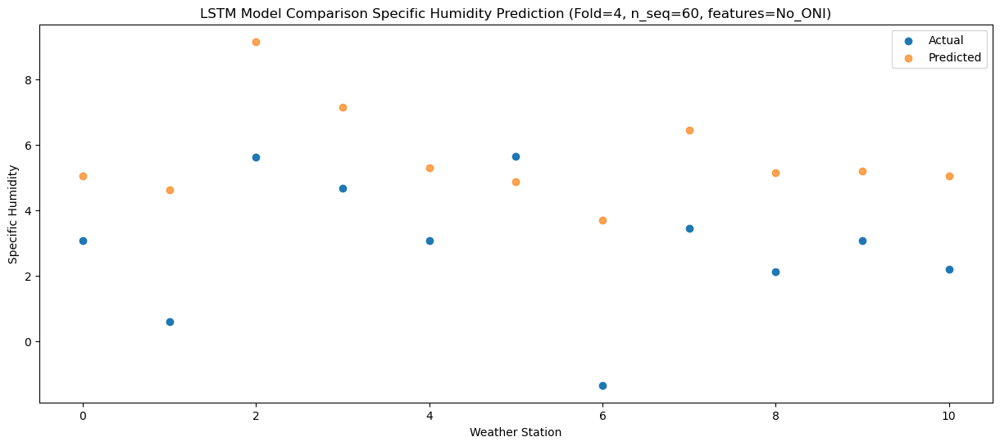

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    1.89   4.204223
1                 1    0.77   3.764223
2                 2    4.87   8.304223
3                 3    4.50   6.284223
4                 4    2.66   4.444223
5                 5    2.96   4.014223
6                 6   -1.53   2.854223
7                 7    2.09   5.584223
8                 8    1.08   4.284223
9                 9    1.69   4.344223
10               10    1.48   4.204223


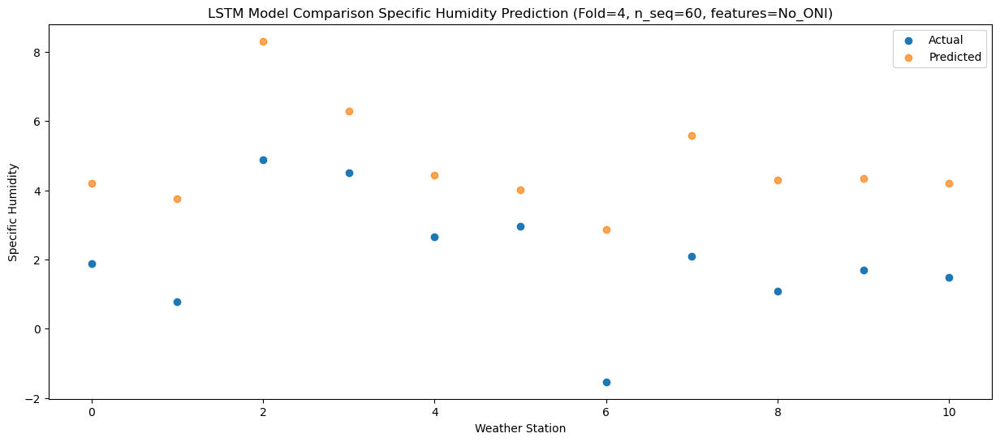

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0    0.55   2.077522
1                 1   -2.75   1.637522
2                 2    4.33   6.177522
3                 3    2.92   4.157522
4                 4    1.07   2.317522
5                 5    2.32   1.887522
6                 6   -3.52   0.727522
7                 7    1.22   3.457522
8                 8    0.12   2.157522
9                 9    0.58   2.217522
10               10    0.03   2.077522


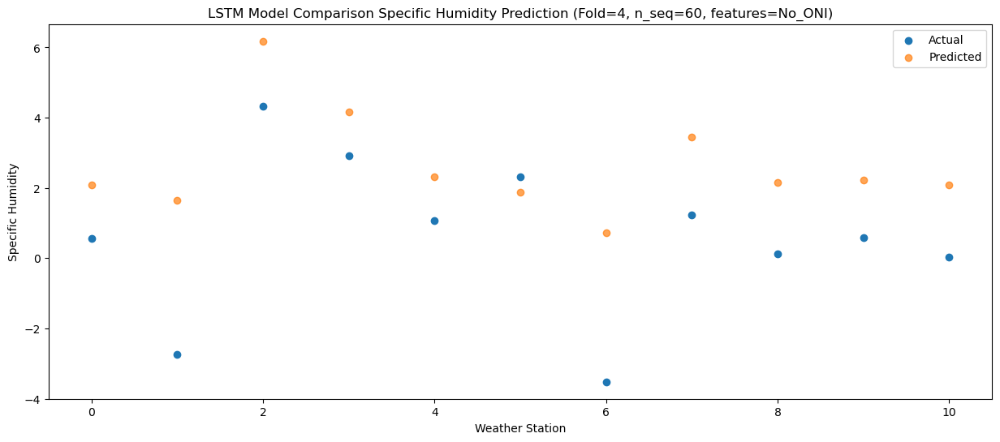

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    0.90   2.401079
1                 1   -3.26   1.961079
2                 2    4.23   6.501079
3                 3    2.23   4.481079
4                 4    0.32   2.641079
5                 5    0.77   2.211079
6                 6   -2.89   1.051079
7                 7    1.50   3.781079
8                 8    0.74   2.481079
9                 9    1.10   2.541079
10               10    0.65   2.401079


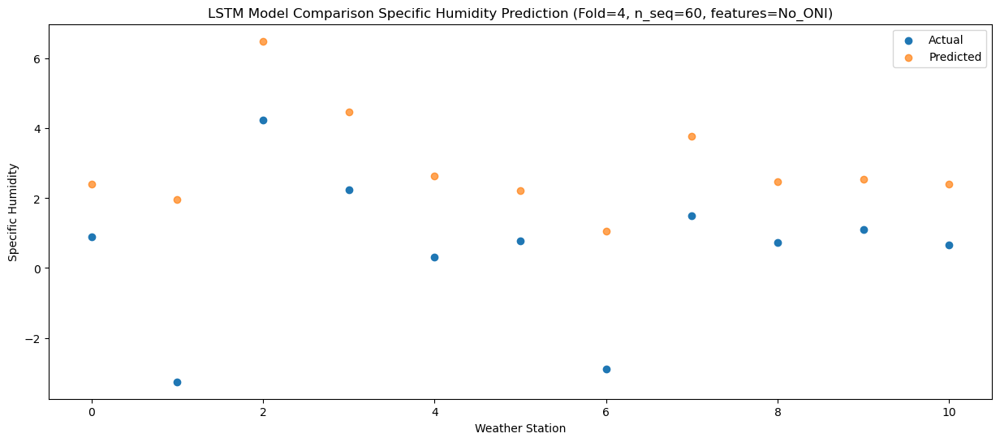

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    0.85   1.853755
1                 1   -1.32   1.413755
2                 2    4.90   5.953755
3                 3    2.59   3.933755
4                 4    0.72   2.093755
5                 5    0.89   1.663755
6                 6   -1.85   0.503755
7                 7    1.31   3.233755
8                 8    0.34   1.933755
9                 9    0.87   1.993755
10               10   -0.10   1.853755


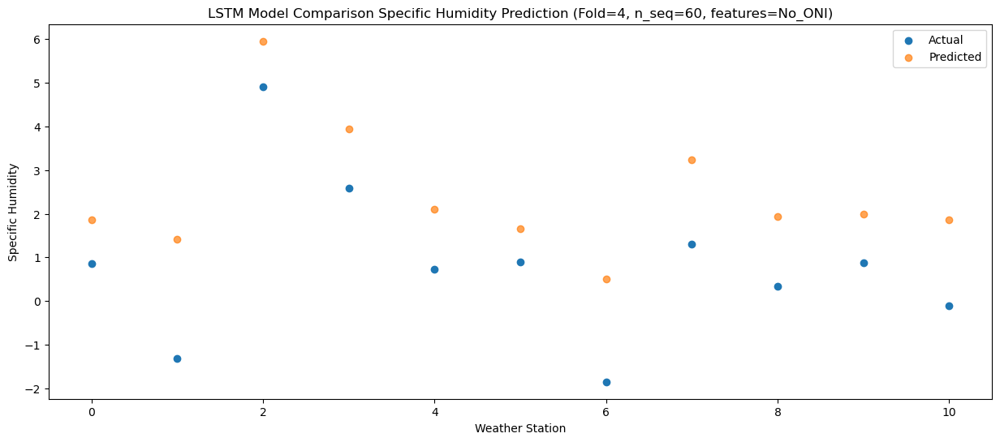

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    1.69   1.950813
1                 1   -0.94   1.510813
2                 2    5.23   6.050813
3                 3    4.65   4.030813
4                 4    2.69   2.190813
5                 5    2.18   1.760813
6                 6   -2.36   0.600813
7                 7    2.07   3.330813
8                 8    0.69   2.030813
9                 9    1.48   2.090813
10               10    0.11   1.950813


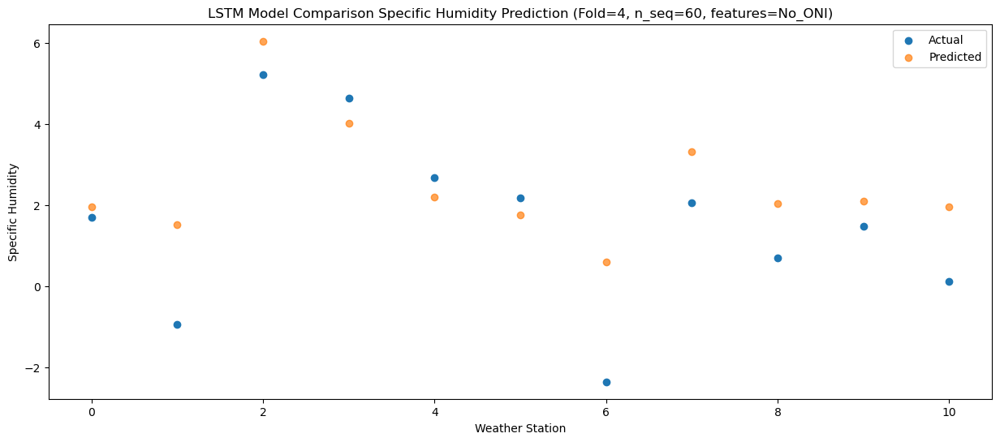

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    2.87   4.314993
1                 1    0.55   3.874993
2                 2    6.07   8.414993
3                 3    5.33   6.394993
4                 4    3.54   4.554993
5                 5    2.15   4.124993
6                 6   -0.76   2.964993
7                 7    2.97   5.694993
8                 8    2.14   4.394993
9                 9    2.99   4.454993
10               10    1.81   4.314993


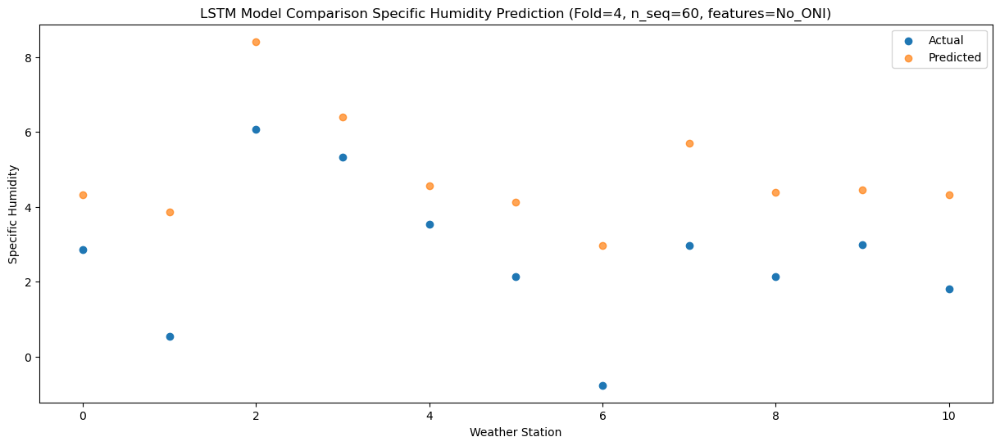

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    6.89   4.976336
1                 1    1.35   4.536336
2                 2    9.45   9.076336
3                 3    9.59   7.056336
4                 4    7.81   5.216336
5                 5    6.99   4.786336
6                 6    1.46   3.626336
7                 7    7.36   6.356336
8                 8    4.39   5.056336
9                 9    5.77   5.116336
10               10    2.71   4.976336


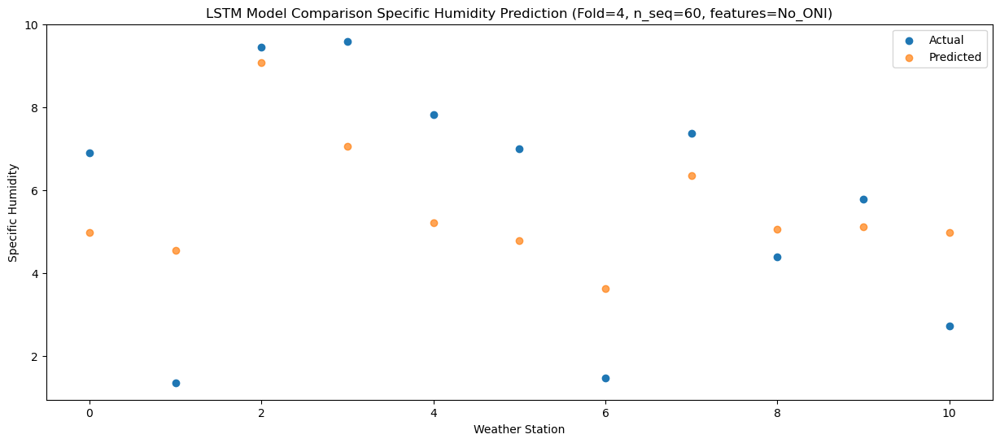

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0    9.43   8.948918
1                 1    4.86   8.508918
2                 2   13.02  13.048918
3                 3   13.53  11.028918
4                 4   11.29   9.188918
5                 5   10.85   8.758918
6                 6    4.51   7.598918
7                 7    9.92  10.328918
8                 8    6.35   9.028918
9                 9    7.41   9.088918
10               10    5.95   8.948918


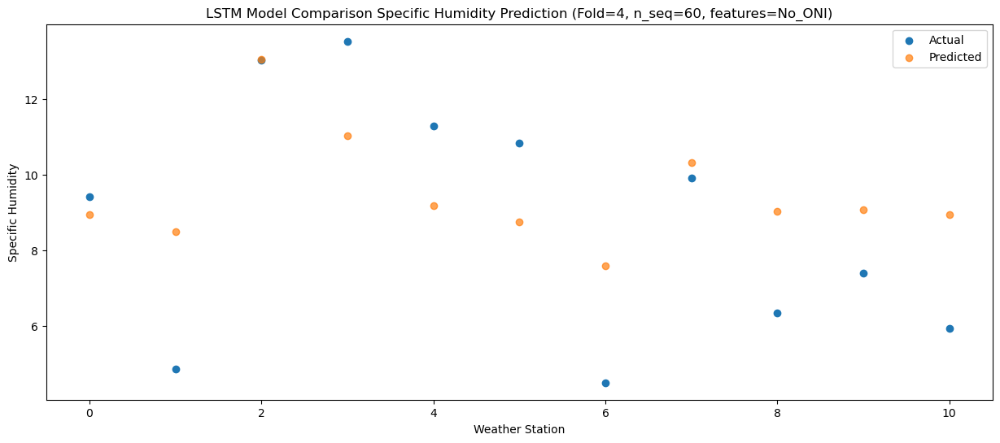

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   12.12  12.260406
1                 1    6.77  11.820406
2                 2   14.61  16.360406
3                 3   13.38  14.340406
4                 4   10.39  12.500406
5                 5    8.52  12.070406
6                 6    7.90  10.910406
7                 7   12.71  13.640406
8                 8   10.65  12.340406
9                 9   12.11  12.400406
10               10    9.57  12.260406


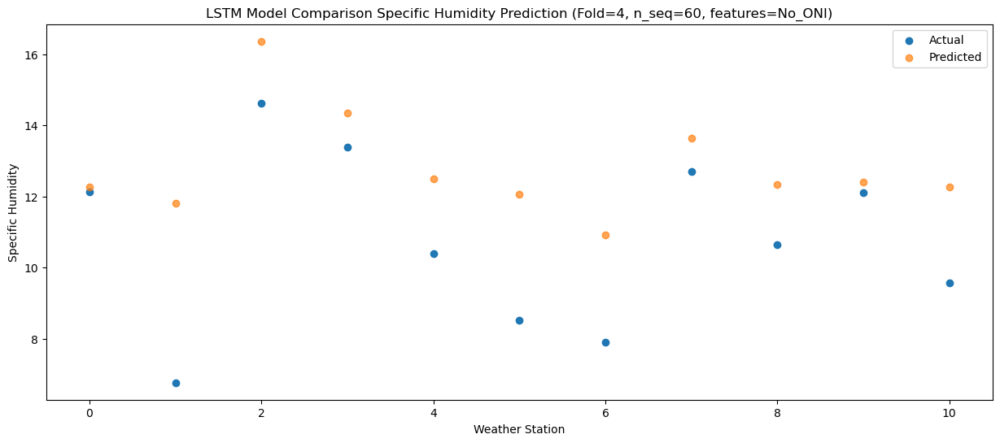

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   13.05  10.904899
1                 1    7.07  10.464899
2                 2   13.03  15.004899
3                 3   11.28  12.984899
4                 4    9.01  11.144899
5                 5    7.66  10.714899
6                 6    7.44   9.554899
7                 7   12.99  12.284899
8                 8   10.11  10.984899
9                 9   11.98  11.044899
10               10    8.77  10.904899


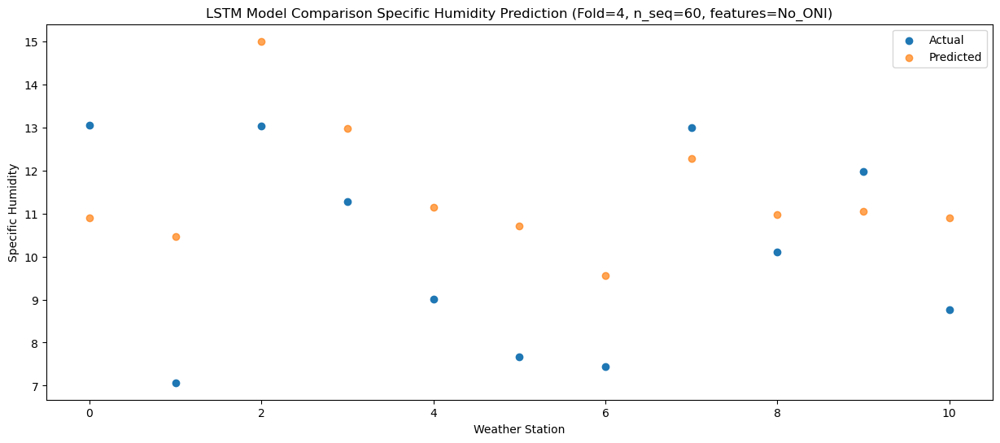

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    8.13  10.450016
1                 1    4.62  10.010016
2                 2   10.01  14.550016
3                 3   10.38  12.530016
4                 4    8.68  10.690016
5                 5    8.17  10.260016
6                 6    3.99   9.100016
7                 7    8.79  11.830016
8                 8    7.31  10.530016
9                 9    8.20  10.590016
10               10    7.06  10.450016


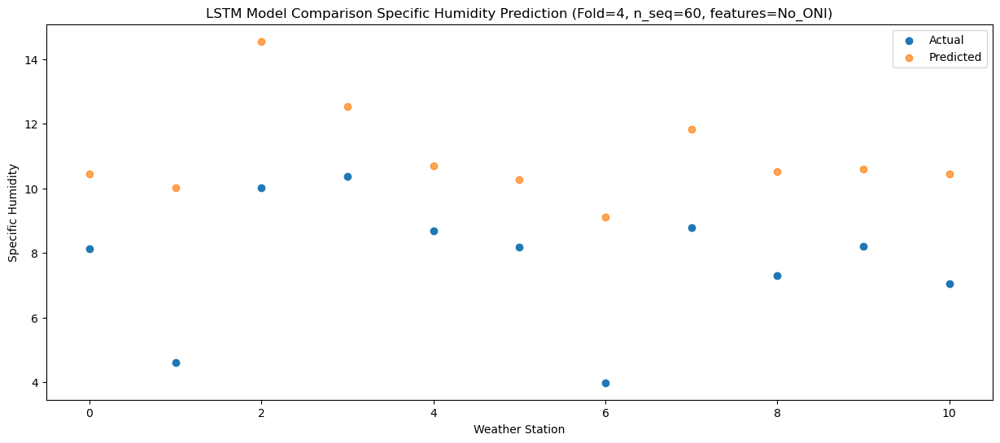

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    4.94   7.824665
1                 1    1.00   7.384665
2                 2    6.08  11.924665
3                 3    6.66   9.904665
4                 4    5.02   8.064665
5                 5    6.04   7.634665
6                 6    0.08   6.474665
7                 7    5.18   9.204665
8                 8    3.98   7.904665
9                 9    4.76   7.964665
10               10    4.00   7.824665


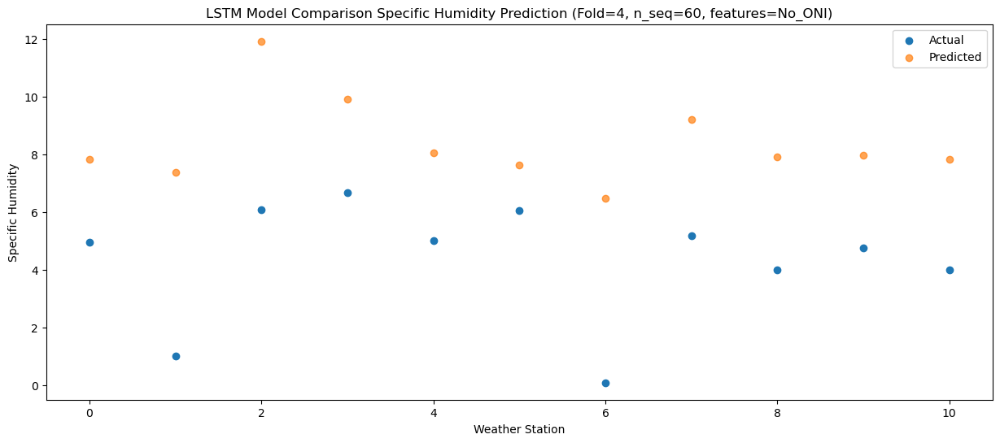

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    2.04   4.397498
1                 1   -1.30   3.957498
2                 2    4.10   8.497498
3                 3    4.13   6.477498
4                 4    2.60   4.637498
5                 5    3.74   4.207498
6                 6   -2.87   3.047498
7                 7    2.15   5.777498
8                 8    0.91   4.477498
9                 9    1.37   4.537498
10               10    0.56   4.397498


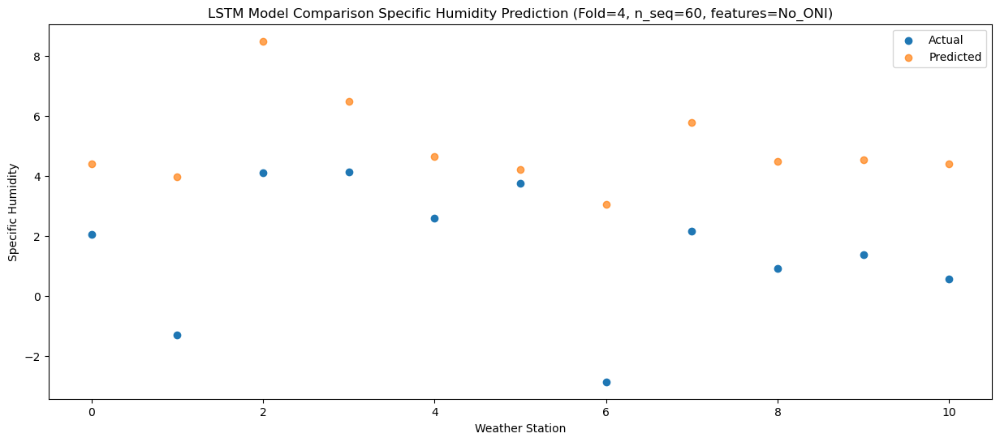

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0    1.86   4.768863
1                 1   -2.39   4.328863
2                 2    2.79   8.868863
3                 3    2.38   6.848863
4                 4    0.84   5.008863
5                 5    2.16   4.578863
6                 6   -3.15   3.418863
7                 7    1.34   6.148863
8                 8    0.88   4.848863
9                 9    1.86   4.908863
10               10    1.08   4.768863


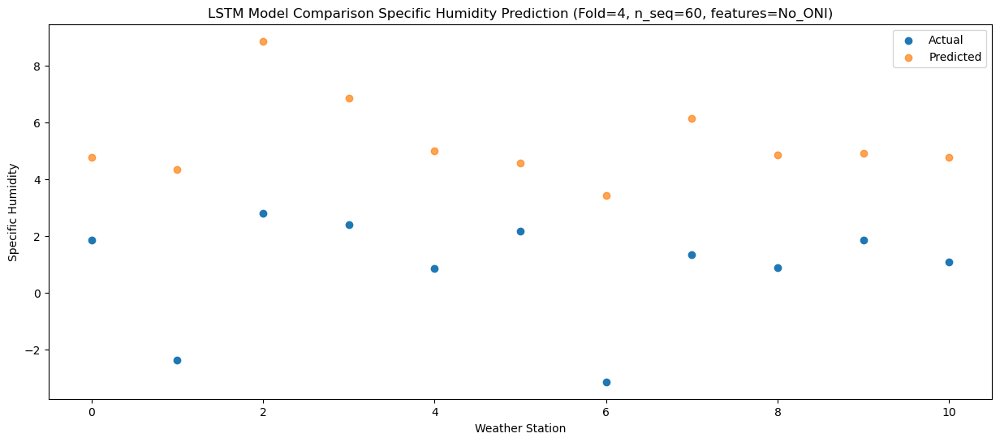

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0    0.16   4.079787
1                 1   -3.43   3.639787
2                 2    2.07   8.179787
3                 3    1.10   6.159787
4                 4   -0.58   4.319787
5                 5    0.89   3.889787
6                 6   -3.93   2.729787
7                 7    0.19   5.459787
8                 8   -0.20   4.159787
9                 9    0.40   4.219787
10               10    0.01   4.079787


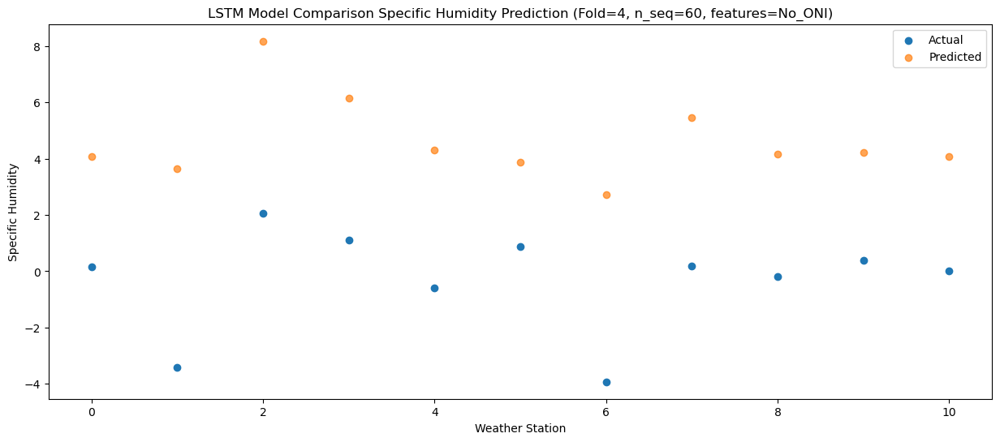

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    1.17   3.620692
1                 1   -4.12   3.180692
2                 2    3.50   7.720692
3                 3    3.44   5.700692
4                 4    1.77   3.860692
5                 5    1.24   3.430692
6                 6   -3.75   2.270692
7                 7    1.55   5.000692
8                 8    0.38   3.700692
9                 9    1.32   3.760692
10               10    0.03   3.620692


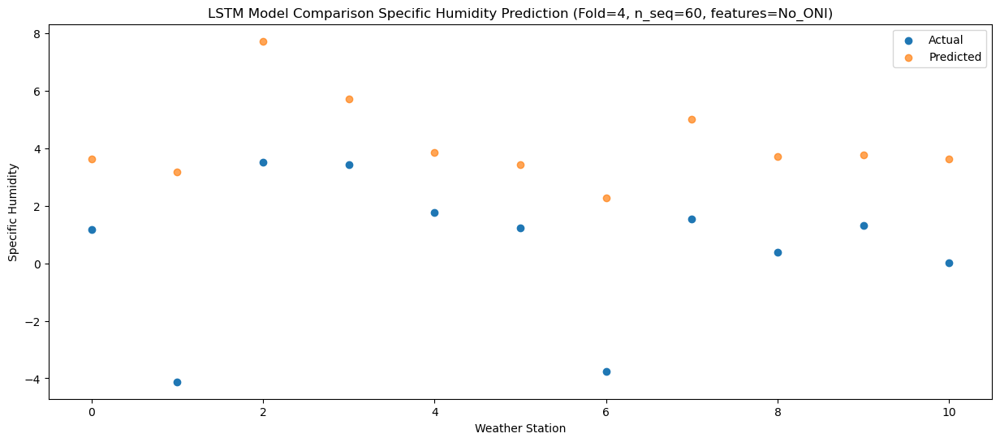

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    2.23   4.589544
1                 1   -0.83   4.149544
2                 2    5.13   8.689544
3                 3    5.23   6.669544
4                 4    3.72   4.829544
5                 5    2.38   4.399544
6                 6   -2.18   3.239544
7                 7    2.76   5.969544
8                 8    1.45   4.669544
9                 9    2.29   4.729544
10               10    1.10   4.589544


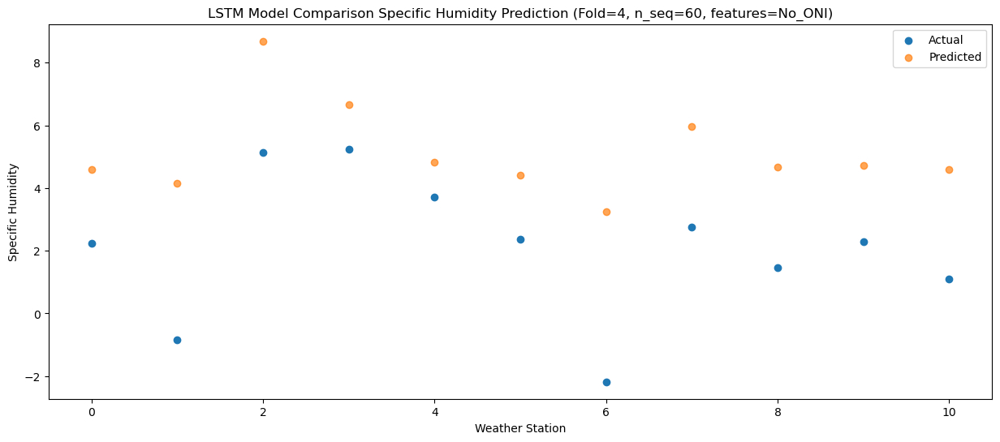

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    3.91   5.956976
1                 1   -1.43   5.516976
2                 2    7.31  10.056976
3                 3    7.60   8.036976
4                 4    6.22   6.196976
5                 5    2.98   5.766976
6                 6   -0.26   4.606976
7                 7    4.49   7.336976
8                 8    3.48   6.036976
9                 9    4.01   6.096976
10               10    2.88   5.956976


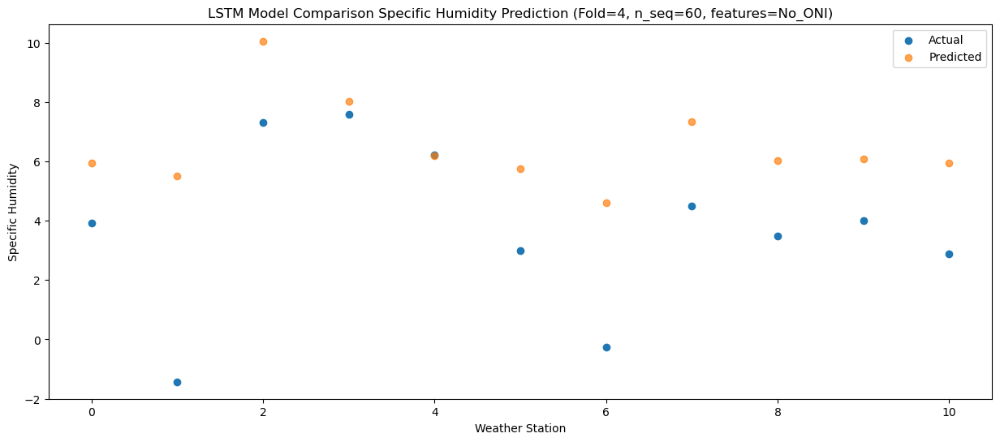

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    7.98   8.796579
1                 1    1.16   8.356579
2                 2   11.63  12.896579
3                 3   11.17  10.876579
4                 4    9.65   9.036579
5                 5    5.74   8.606579
6                 6    3.74   7.446579
7                 7    8.91  10.176579
8                 8    6.97   8.876579
9                 9    7.55   8.936579
10               10    5.80   8.796579


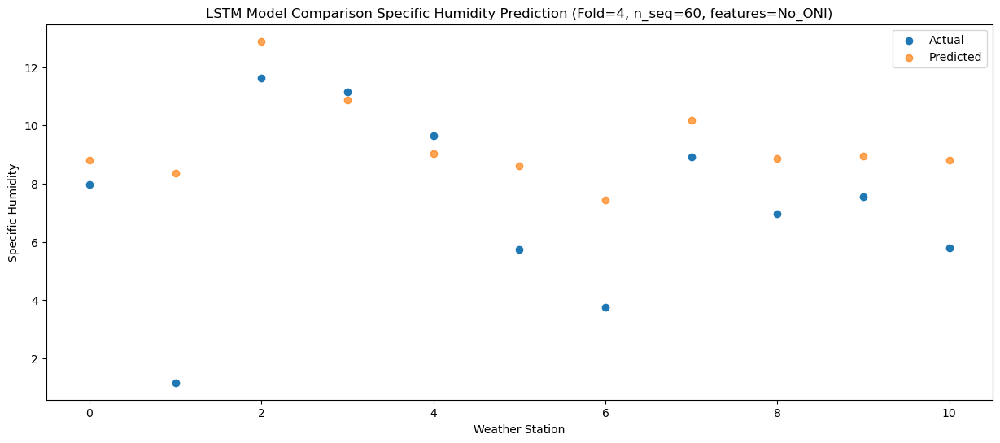

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   11.24   11.32124
1                 1    2.62   10.88124
2                 2   12.97   15.42124
3                 3   13.11   13.40124
4                 4   11.76   11.56124
5                 5   10.27   11.13124
6                 6    5.50    9.97124
7                 7   10.89   12.70124
8                 8    8.66   11.40124
9                 9   10.31   11.46124
10               10    8.35   11.32124


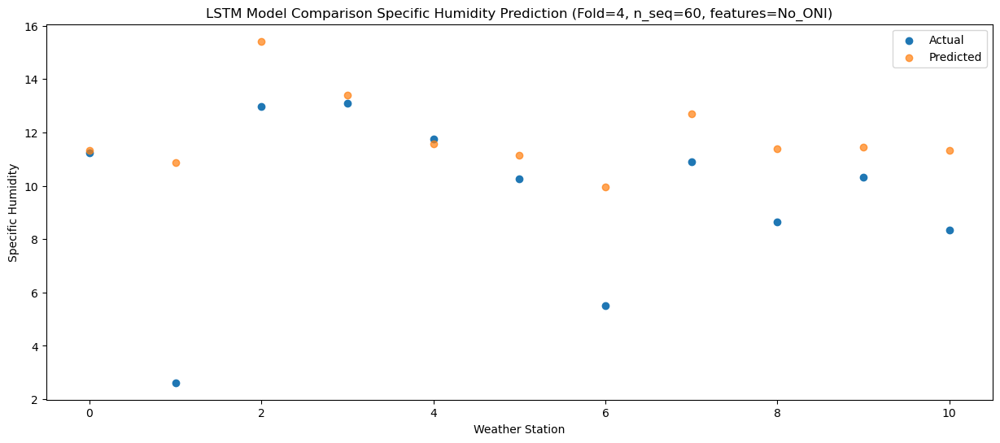

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   12.43   14.74867
1                 1    4.08   14.30867
2                 2   15.00   18.84867
3                 3   13.07   16.82867
4                 4   11.29   14.98867
5                 5   10.15   14.55867
6                 6    7.89   13.39867
7                 7   11.87   16.12867
8                 8    9.96   14.82867
9                 9   11.92   14.88867
10               10    9.47   14.74867


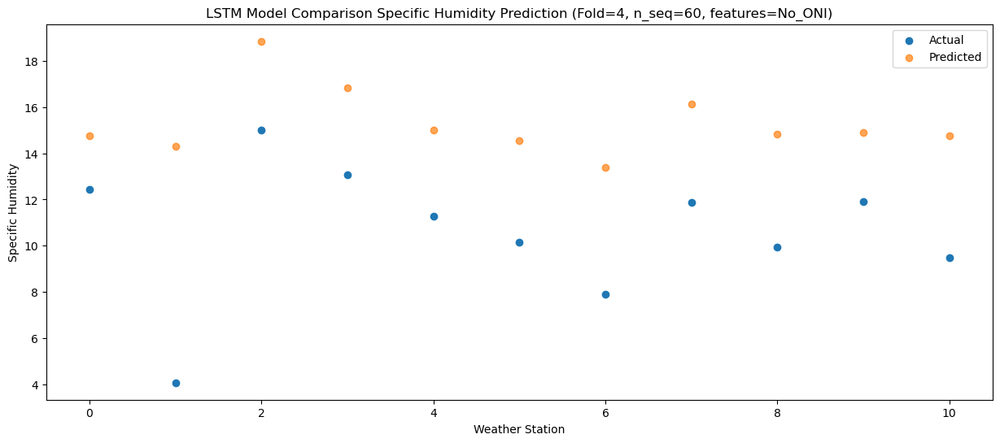

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   11.27  12.973671
1                 1    6.69  12.533671
2                 2   12.69  17.073671
3                 3   12.36  15.053671
4                 4   10.52  13.213671
5                 5    8.95  12.783671
6                 6    7.15  11.623671
7                 7   10.58  14.353671
8                 8    9.60  13.053671
9                 9   11.56  13.113671
10               10    9.45  12.973671


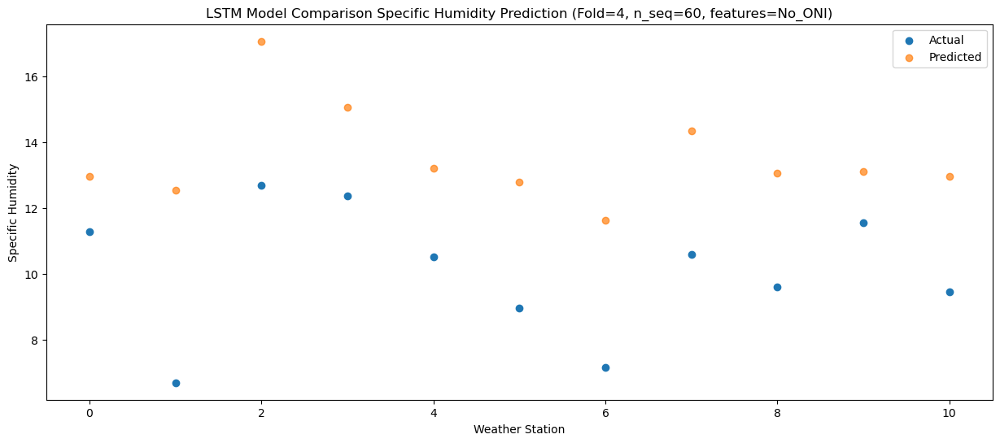

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    7.97  11.945968
1                 1    6.50  11.505968
2                 2   11.59  16.045968
3                 3    9.83  14.025968
4                 4    8.36  12.185968
5                 5    8.07  11.755968
6                 6    4.83  10.595968
7                 7    8.54  13.325968
8                 8    6.92  12.025968
9                 9    8.06  12.085968
10               10    7.38  11.945968


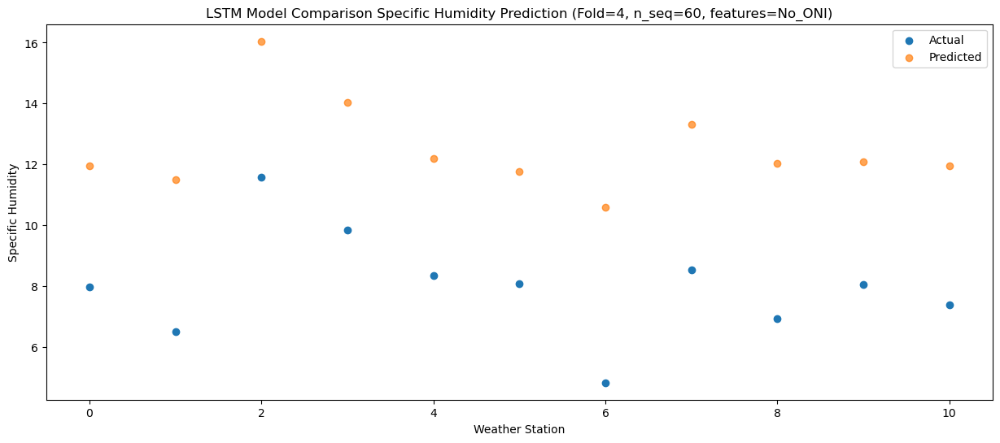

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    3.84   8.226309
1                 1    2.08   7.786309
2                 2    6.80  12.326309
3                 3    6.37  10.306309
4                 4    4.62   8.466309
5                 5    4.38   8.036309
6                 6    0.43   6.876309
7                 7    4.22   9.606309
8                 8    3.34   8.306309
9                 9    3.96   8.366309
10               10    3.27   8.226309


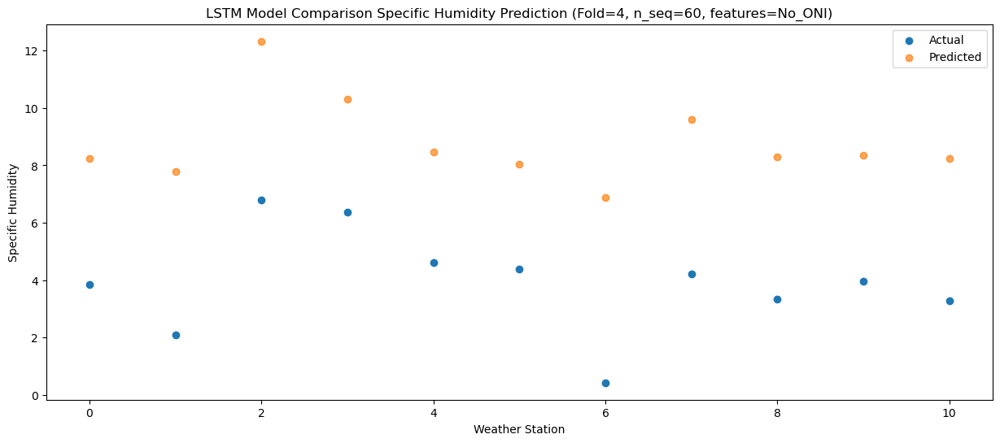

f, t:
[[ 9.500e-01 -1.880e+00  2.900e+00  3.200e+00  1.290e+00  2.630e+00
  -2.970e+00  1.810e+00  4.000e-01  9.500e-01  1.500e-01]
 [ 8.800e-01 -1.740e+00  3.740e+00  2.200e+00  3.200e-01  1.390e+00
  -2.900e+00  1.540e+00  5.700e-01  1.120e+00  3.000e-01]
 [ 4.600e-01 -3.300e+00  3.600e+00  2.840e+00  1.010e+00  1.270e+00
  -3.060e+00  1.300e+00  2.000e-01  6.400e-01 -4.000e-02]
 [ 2.800e-01 -2.460e+00  3.410e+00  2.220e+00  3.500e-01  1.150e+00
  -2.480e+00  1.070e+00 -2.000e-01  3.700e-01 -3.900e-01]
 [ 2.510e+00 -1.080e+00  6.960e+00  6.170e+00  4.250e+00  3.950e+00
  -2.900e-01  3.620e+00  1.720e+00  2.420e+00  1.180e+00]
 [ 3.100e+00  1.300e-01  5.840e+00  5.770e+00  3.740e+00  3.200e+00
  -9.600e-01  3.940e+00  2.000e+00  3.010e+00  1.020e+00]
 [ 6.310e+00  7.800e-01  8.080e+00  8.930e+00  6.980e+00  5.470e+00
   2.160e+00  7.320e+00  5.150e+00  6.730e+00  3.640e+00]
 [ 1.096e+01  4.110e+00  1.138e+01  1.109e+01  8.960e+00  7.180e+00
   5.990e+00  1.093e+01  7.890e+00  9.210e+0

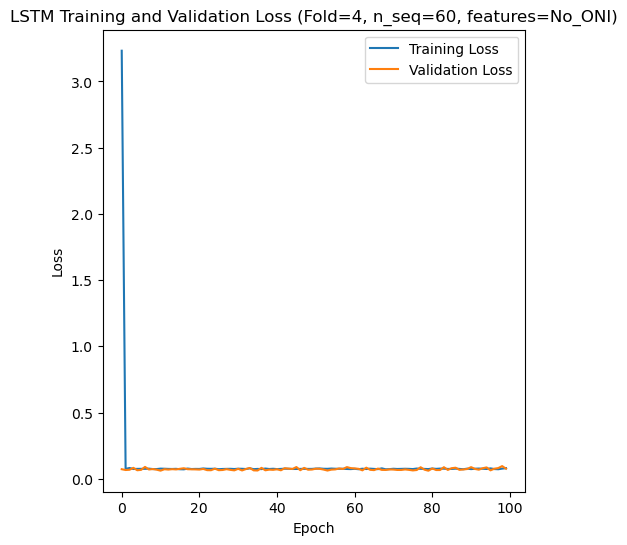

[[3.252763398772628], [1.5833647224285514], [2.8161407259157474], [2.5859592368127897], [2.711310219653449]]
[[array(3.2527634)], [array(1.58336472)], [array(2.81614073)], [array(2.58595924)], [array(2.71131022)]]
[[2.747150314009098], [1.304951809418818], [2.380403460748833], [1.9074873381383488], [2.233541488883566]]
[[2.6955037437765164], [1.3456224644007193], [1.983073931696441], [1.4713023896271213], [2.918071805084292]]
[[0.4517603867130958], [0.8733083826679929], [0.5720895556600929], [0.48390356096374465], [0.634873001153641]]
[[array(0.26773429)], [array(0.18399412)], [array(0.33016138)], [array(0.67726744)], [array(1.71229765)]]
[[array(0.81421781)], [array(0.89588787)], [array(0.83102365)], [array(0.69825205)], [array(0.77981918)]]
[0.03 0.46 0.37 ... 9.45 7.38 3.27]
[ 1.00117983  0.58053829  0.61514675 ... 12.9736713  11.94596801
  8.22630892]
Accuracy Results:
RMSE for each fold:
[[3.252763398772628], [1.5833647224285514], [2.8161407259157474], [2.5859592368127897], [2.711

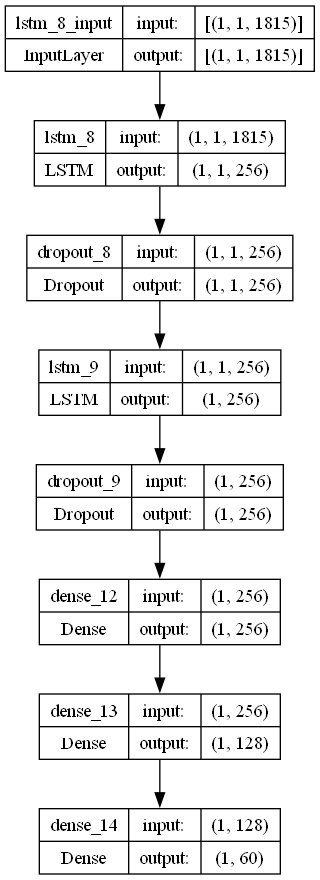

In [2]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, mean_absolute_percentage_error, r2_score
from tensorflow.keras.utils import plot_model

def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))

def kmape (y_true, y_pred):
    return K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def kpearson (y_true, y_pred):
    mean_true = K.mean(y_true)
    mean_pred = K.mean(y_pred)
    return (K.square(K.mean((y_true - mean_true)*(y_pred - mean_pred))))/(K.mean(K.square(y_true - mean_true))*K.mean(K.square(y_pred - mean_pred)))

# fit the best LSTM model using parameters found by Optuna
def create_best_model(X, y, n_lag, n_seq, n_batch, nb_epoch):
    
    #Parameters:
    #trial (array-like): Optuna parameters.
    #train (array-like): Target values.
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations
    #nb_epoch (int): Maximum number of epochs
    
    # Hyperparameters from the best model
    lr = 0.09825191604018559
    optimizer = Adam(learning_rate = lr)
    activation_function = 'relu'
    lstm_units = 256
    dropout_rate = 0.3346525619313015

    # design network
    model = Sequential()
    model.add(LSTM(lstm_units, return_sequences=True, batch_input_shape=(n_batch, X.shape[1], X.shape[2]), stateful=True))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units))
    model.add(Dropout(dropout_rate))
    model.add(Dense(256, input_dim=y.shape[1], activation=activation_function))
    model.add(Dense(128, activation=activation_function))
    model.add(Dense(n_seq))
    model.compile(loss=rmse, optimizer=optimizer, metrics=['accuracy', 'mae', rmse, mape, pearson])
        
    return model

# Make one forecast with a LSTM
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def forecast_lstm(model, X, n_seq, n_test):
    # reshape input pattern to [samples, timesteps, features]
    X = X.reshape(1, 1, X.shape[1])
    # make forecast
    forecast = model.predict(X)
    # convert to array
    return forecast
     
# Evaluate the persistence model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def make_forecasts(model, X_test, y_test, n_lag, n_seq, n_test):
    forecasts = list()
    for i in range(len(X_test)):
        X, y = X_test[i, :], y_test[i, :]
        # make forecast
        forecast = forecast_lstm(model, X, n_seq, n_test)
        # store the forecast
        forecasts.append(forecast)
    return forecasts
     
# Invert differenced forecast
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_difference(last_ob, forecast):
    # Invert the first forecast
    inverted = list()
    inverted.append(forecast[0] + last_ob)
    # Propagate the difference forecast using the inverted first value
    for i in range(1, len(forecast)):
        inverted.append(forecast[i] + inverted[i-1])
    return inverted
     
# Inverse data transform on forecasts
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_transform(series, forecasts, scaler, n_test, n_seq):
    inverted = list()
    for i in range(len(forecasts)):
        # create an array from the forecast
        forecast = forecasts[i]
        forecast = forecast.reshape(1, n_seq)
        # invert scaling
        inv_scale = scaler.inverse_transform(forecast)
        inv_scale = inv_scale[0, :]
        # invert differencing
        index = len(series) - n_test + i
        last_ob = series.values[index]
        inv_diff = inverse_difference(last_ob, inv_scale)
        # store
        inverted.append(inv_diff)
    return inverted
     
# Evaluate the RMSE for each forecast time step
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def evaluate_forecasts(actual, forecasts, n_lag, n_seq):

    t = np.array(actual).transpose()
    f = np.array(forecasts).transpose()

    print("f, t:")
    print(t)
    print(f)
    rmse_list = []
    mae_list = []
    skmape_list = []
    mape_list = []
    r2_list = []
    pearson_list = []
    actual_list = []

    for i in range(n_seq):
        act = [row for row in t[i]]
        predicted = [forecast for forecast in f[i]]
        rmse1 = sqrt(mean_squared_error(act, predicted))
        rmse2 = np.array(rmse(tf.convert_to_tensor(np.array(act)), tf.convert_to_tensor(np.array(predicted))))
        mae = mean_absolute_error(act, predicted)
        mse = mean_squared_error(act, predicted)
        skmape = mean_absolute_percentage_error(act, predicted)
        kmape1 = np.array(kmape(tf.convert_to_tensor(np.array(act)), tf.convert_to_tensor(np.array(predicted))))
        kpearson1 = np.array(kpearson(tf.convert_to_tensor(np.array(act)), tf.convert_to_tensor(np.array(predicted))))
        r2 = r2_score(act, predicted) 
        avg_actual = np.mean(act)
        print("Year at t+"+str(i+1)+":")
        print('t+%d SKRMSE: %f' % ((i+1), rmse1))
        print('t+%d KRMSE: %f' % ((i+1), rmse2))        
        print('t+%d MAE: %f' % ((i+1), mae))
        print('t+%d SKMAPE: %f' % ((i+1), skmape))
        print('t+%d R2_SCORE: %f' % ((i+1), r2))
        print('t+%d KMAPE: %f' % ((i+1), kmape1))
        print('t+%d PEARSON: %f' % ((i+1), kpearson1))
        print('t+%d AVERAGE ACTUAL: %f' % ((i+1), avg_actual))

    y_true = tf.convert_to_tensor(np.array(actual).flatten())
    y_pred = tf.convert_to_tensor(np.array(forecasts).flatten())

    rmse1 = sqrt(mean_squared_error(np.array(y_true), np.array(y_pred)))
    rmse2 = np.array(rmse(y_true, y_pred))
    mae = mean_absolute_error(np.array(y_true), np.array(y_pred))
    mse = mean_squared_error(np.array(y_true), np.array(y_pred))
    skmape = mean_absolute_percentage_error(np.array(y_true), np.array(y_pred))
    kmape1 = np.array(kmape(y_true, y_pred))
    kpearson1 = np.array(kpearson(y_true, y_pred))
    r2 = r2_score(np.array(y_true), np.array(y_pred)) 
    avg_actual = np.mean(np.array(y_true))
    rmse1_list.append(rmse1)
    rmse2_list.append(rmse2)
    mae_list.append(mae)
    skmape_list.append(skmape)
    pearson_list.append(kpearson1)
    mape_list.append(kmape1)
    r2_list.append(r2)
    actual_list.append(avg_actual)
    print("Metrics for this Fold:")
    print('SKRMSE: %f' % (rmse1))
    print('KRMSE: %f' % (rmse2))        
    print('MAE: %f' % (mae))
    print('SKMAPE: %f' % (skmape))
    print('R2_SCORE: %f' % (r2))
    print('KMAPE: %f' % (kmape1))
    print('PEARSON: %f' % (kpearson1))
    print('AVERAGE ACTUAL: %f' % (avg_actual))

    return rmse1_list, rmse2_list, mae_list, skmape_list, r2_list, mape_list, pearson_list, actual_list
     
# plot the forecasts in the context of the original dataset
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def plot_forecasts(series, forecasts, actual, n_test, n_seq, n_lag):
    # plot the entire dataset in blue
    plt.plot(series[:n_lag+2+len(forecasts)].values)
    # plot the forecasts in red
    off_s = n_lag + 1
    off_e = off_s + len(forecasts) + 1
    xaxis = [x for x in range(off_s, off_e)]
    yaxis = [series.values[off_s]] + forecasts
    print(xaxis)
    print(yaxis)
    plt.plot(xaxis, yaxis, color='red')
    plt.xlabel("Month")
    plt.ylabel("Specific Humidity")
    # show the plot
    plt.show()

n_batch = 1
n_test = 11
nb_epoch = 100
    
rmse1_avg_list = []
rmse2_avg_list = []
mae_avg_list = []
skmape_avg_list = []
r2_score_avg_list = []
mape_avg_list = []
pearson_avg_list = []
actual_avg_list = []
forecast_results = []
actual_results = []
    
for i in range(5):
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]

    X = train1[:, 0:-n_seq]
    y = train1[:, -n_seq:]
    X_test = test1[:, 0:-n_seq]
    y_test = test1[:, -n_seq:]
    X_val = validation1[:, 0:-n_seq]
    y_val = validation1[:, -n_seq:]
    
    dataset_df = pd.DataFrame(val_y[i])
    dataset_df = dataset_df.iloc[0:10, :]
    dataset = dataset_df.values

    print(dataset)

    series = pd.Series(dataset[:, 0]) # Using first column (specific_humidity)

    X = X.reshape(X.shape[0], 1, X.shape[1])
    X1 = X_test
    X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
    X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])

    best_model = create_best_model(X, y, n_lag, n_seq, n_batch, nb_epoch)
    history = best_model.fit(X, y, epochs=100, batch_size=n_batch, validation_data=(X_val, y_val))
    
    # Evaluate the model
    loss = best_model.evaluate(X_test, y_test, verbose=2)
    print(f'Test Loss: {loss}')

    # make forecasts
    forecasts = make_forecasts(best_model, X_test, y_test, n_lag, n_seq, n_test)
    
    # inverse transform forecasts and test
    forecasts = inverse_transform(series, forecasts, scaler[i], n_test, n_seq)
    actual = [row[-n_seq:] for row in test1]
    actual = inverse_transform(series, actual, scaler[i], n_test, n_seq)

    # Print out plots of actual and predicted values for weather stations
    ws = df.index[1:12]
    print(ws)
    a = []
    f = []
    for q in range(len(actual)):
        x = actual[q]
        a.append(x[0])
    for q in range(len(forecasts)):
        x = forecasts[q]
        f.append(x[0])
    print(a)
    print(f)
    # Create a DataFrame for plotting
    results_df = pd.DataFrame({
        'ws': ws,
        'Actual': a,
        'Predicted': f
    })

    print(results_df)
    
    print("Actual and Forecasts:")
    print(actual)
    print(forecasts)
    
    for j in range(11):
        print("Weather Station "+str(j+1)+":")
        print("Actual S.H.\tPredicted S.H.\tDifference")
        print("-----------\t--------------\t----------")
        for k in range(n_seq):
            diff = forecasts[j][k] - actual[j][k]
            print(f"{actual[j][k]:.2f}\t\t{forecasts[j][k]:.2f}\t\t{diff:.2f}")
    
        # plot forecasts
        dataset_df = pd.DataFrame(val_y[i])
        dataset_df = dataset_df.iloc[0:11, :]
        dataset_df = dataset_df.transpose()
        dataset = dataset_df.values

        series_ws = pd.Series(dataset[:, j]) # Using first column (temperatures)
        forecasts_ws = forecasts[j]
        actual_ws = actual[j]
        
        plot_forecasts(series_ws, forecasts_ws, actual_ws, n_test, n_seq, n_lag)

    for k in range(n_seq):
        print("Predictions for (t+"+str(k)+"):")
        # Print out plots of actual and predicted values for each weather station
        results = []

        # Create a DataFrame for plotting
        for j in range(11):
            results.append([j, actual[j][k], forecasts[j][k]])
               
        results_df = pd.DataFrame(results)
        results_df.columns = ['Weather_Station', 'Actual', 'Predicted']

        print(results_df)

        # Plotting the results
        plt.figure(figsize=(15, 6))
        plt.scatter(results_df['Weather_Station'], results_df['Actual'], label='Actual')
        plt.scatter(results_df['Weather_Station'], results_df['Predicted'], label='Predicted', alpha=0.7)
        title1='LSTM Model Comparison Specific Humidity Prediction (Fold='+str(i)+', n_seq='+str(n_seq)+', features=No_ONI)'
        plt.title(title1)
        plt.xlabel('Weather Station')
        plt.ylabel('Specific Humidity')
        plt.legend()
        plt.show()

    rmse1_list = [] # list stores sklearn's root mean squared errors for each future time prediction
    rmse2_list = [] # list stores root mean squared errors for each future time prediction
    mae_list = [] # list stores mean absolute errors for each future time prediction
    skmape_list = [] # list stores sklearn's mean squared percentage errors for each future time prediction
    r2_list = [] # list stores sklearn's r2 pearson values for each future time prediction
    mape_list = [] # list stores mean squared percentage errors for each future time prediction
    pearson_list = [] # list stores r2 pearson values for each future time prediction
    actual_list = [] # list stores average actual values for each future time prediction

    # evaluate forecasts
    rmse1_list, rmse2_list, mae_list, skmape_list, r2_list, mape_list, pearson_list, actual_list = evaluate_forecasts(actual, forecasts, n_lag, n_seq)

    rmse1_avg_list.append(rmse1_list)
    rmse2_avg_list.append(rmse2_list)
    mae_avg_list.append(mae_list)
    skmape_avg_list.append(skmape_list)
    r2_score_avg_list.append(r2_list)
    mape_avg_list.append(mape_list)
    pearson_avg_list.append(pearson_list)
    actual_avg_list.append(actual_list)
    forecast_results.append(forecasts)
    actual_results.append(actual)
            
    best_model.summary()

    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    title2 = 'LSTM Training and Validation Loss (Fold='+str(i)+', n_seq='+str(n_seq)+', features=No_ONI)'
    plt.title(title2)
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(loc='upper right')
    plt.show()

print(rmse1_avg_list)
print(rmse2_avg_list)
print(mae_avg_list)
print(skmape_avg_list)
print(r2_score_avg_list)
print(mape_avg_list)
print(pearson_avg_list)
print(np.array(actual_results).flatten())
print(np.array(forecast_results).flatten())
a2 = np.array(actual_results).flatten()
f2 = np.array(forecast_results).flatten()
p1 = np.array(pearson(tf.convert_to_tensor(a2), tf.convert_to_tensor(f2)))
print("Accuracy Results:")
print("RMSE for each fold:")
print(rmse1_avg_list)
print("Average SKRMSE:"+str(np.mean(rmse1_avg_list)))
print("Average KRMSE:"+str(np.mean(rmse2_avg_list)))
print("Average MAE:"+str(np.mean(mae_avg_list)))
print("Average SKMAPE:"+str(np.mean(skmape_avg_list)))
print("Average MAPE:"+str(np.mean(mape_avg_list)))
print("Average PEARSON:"+str(p1))
print("Average R2 Score:"+str(np.mean(r2_score_avg_list)))
print("")
print("Average Specific Humidity:"+str(np.mean(actual_avg_list)))
print("RMSE % of Specific Humidity:"+str(np.mean(rmse2_avg_list)/np.mean(actual_avg_list)))

# Plot model architecture
filename = "lstm_model_optimized_SH_S60_No_ONI.png"
plot_model(best_model, to_file=filename, show_shapes=True, show_layer_names=True)